# Simplified-Workflow ver11

eyes open


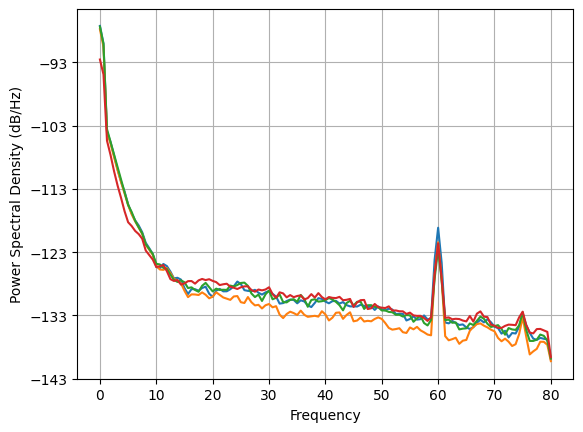

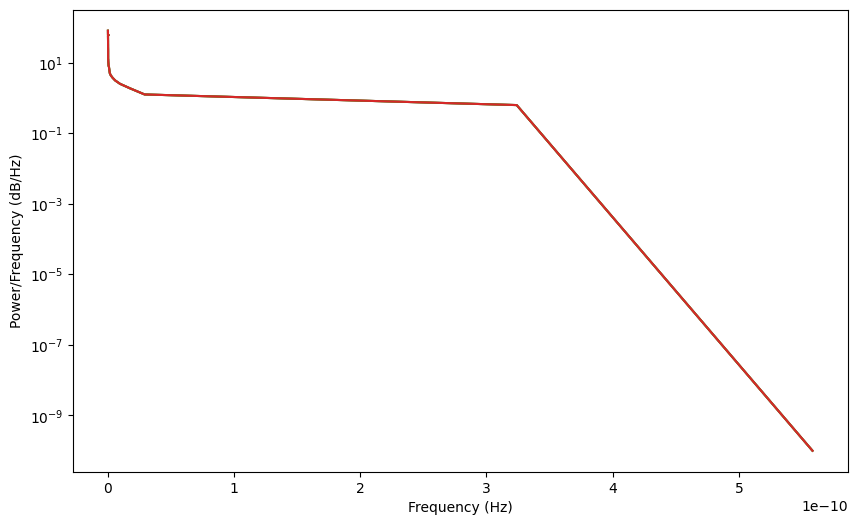

eyes closed


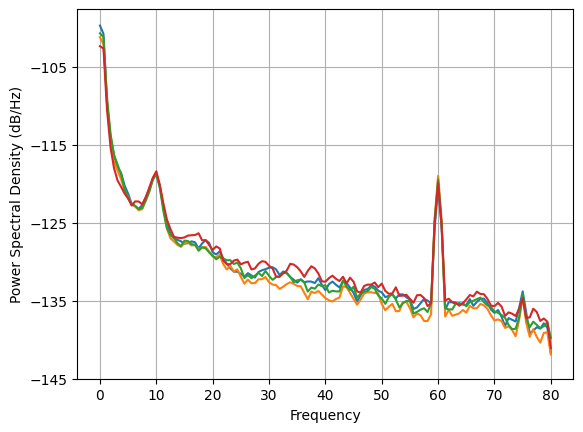

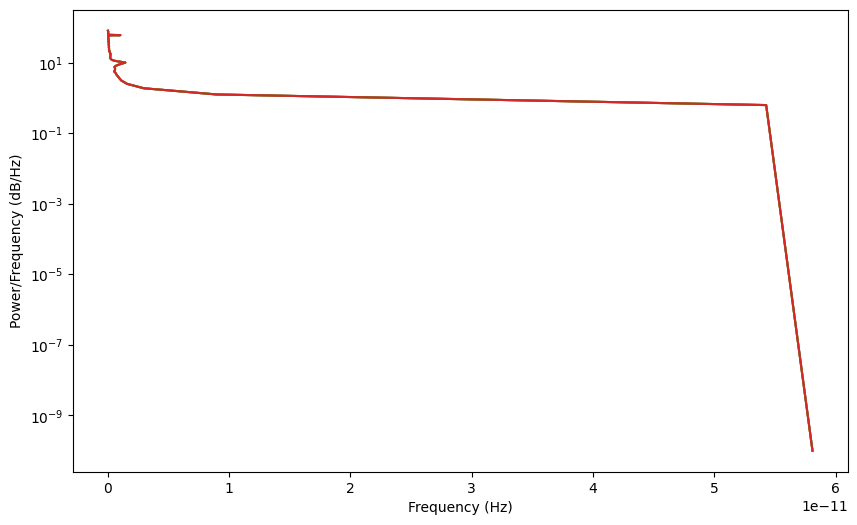

In [13]:
import mne
import numpy as np 
import matplotlib.pyplot as plt
import torch
import os
import sklearn
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from sklearn.preprocessing import MinMaxScaler
from torch.utils.data import TensorDataset, DataLoader
import torch.nn.functional as F
from torch.fft import rfft, irfft
from torch.nn.functional import normalize
from scipy.signal import welch
from scipy import signal


eyes_open = np.load('training_open.npy')
eyes_closed = np.load('training_closed.npy')

training_data_open = []
training_data_closed = []

for i in range(len(eyes_open)):
    aux = []
    for ch in [21,22,23,27]:
        aux.append(eyes_open[i,ch,:])
    training_data_open.append(aux)

for i in range(len(eyes_closed)):
    aux = []
    for ch in [21,22,23,27]:
        aux.append(eyes_closed[i,ch,:])
    training_data_closed.append(aux)


eyes_open = None
eyes_closed = None

NUM_CHANNELS = 4
SEQUENCE_LENGTH = 9760
LAMBDA_GP = 5

def compute_psd(data, fs, nperseg=256, noverlap=None):
    """
    Compute Power Spectral Density (PSD) using the Welch method.

    Parameters:
        data (array): EEG data array with shape (n_channels, n_samples).
        fs (float): Sampling frequency.
        nperseg (int): Length of each segment for PSD estimation.
        noverlap (int): Number of overlapping samples between segments.
    
    Returns:
        freqs (array): Frequency values.
        psd (array): Power Spectral Density values.
    """
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = plt.psd(data[ch_idx], Fs=fs, NFFT=256, noverlap=128, window=np.hanning(256), scale_by_freq=True)
        # Add a small epsilon to avoid zero values
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def average_across_arrays(generated_data):
    return generated_data.mean(dim=0)

# Set the sampling frequency
fs = 160.0

## open data
averaged_data = average_across_arrays(torch.tensor(training_data_open).detach())
freqs, psd = compute_psd(averaged_data, fs)
plt.figure(figsize=(10, 6))  # Add this line to create a single figure
for ch_idx in range(NUM_CHANNELS):
    plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')

print("eyes open")
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power/Frequency (dB/Hz)')
plt.show()



## closed data
averaged_data = average_across_arrays(torch.tensor(training_data_closed).detach())
freqs, psd = compute_psd(averaged_data, fs)
plt.figure(figsize=(10, 6))  # Add this line to create a single figure
for ch_idx in range(NUM_CHANNELS):
    plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')

print("eyes closed")
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power/Frequency (dB/Hz)')
plt.show()


def weights_init(model):
    for m in model.modules():
      if isinstance(m, (nn.Conv1d, nn.ConvTranspose1d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# Gaussian normal distribution
def sample_normal_distribution(i, j, k):
    mu = 0
    sigma = 0.02
    return torch.Tensor(np.random.normal(mu, sigma, (i, j, k)))

def gradient_penalty(D, real, fake):
    alpha = torch.rand((BATCH_SIZE, 1, 1)).repeat(1, NUM_CHANNELS, SEQUENCE_LENGTH)
    interpolated_seq = real * alpha + fake * (1 - alpha)

    # Calculate discriminator scores
    mixed_scores = D(interpolated_seq)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_seq,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty

def plot_everything(generated_data, gen_err, critic_err):
    generated_data = generated_data.detach()
    
    # plotting generated data
    values = generated_data[0, 0, :]
    plt.plot(values.tolist())
    plt.show()

    # plotting PSD
    averaged_data = average_across_arrays(generated_data)
    freqs, psd = compute_psd(averaged_data, fs)
    plt.figure(figsize=(10, 6))  # Add this line to create a single figure
    for ch_idx in range(NUM_CHANNELS):
        plt.semilogy(freqs, psd[ch_idx], label=f'Channel {ch_idx + 1}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power/Frequency (dB/Hz)')
    plt.show()

    # plotting G vs D losses
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(gen_err,label="Generator")
    plt.plot(critic_err,label="Critic")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()
    

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(200, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(200, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(200, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(200, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(200, affine=True),
            nn.LeakyReLU(0.2),
            nn.Upsample(scale_factor=2),
            nn.ConvTranspose1d(200, NUM_CHANNELS, kernel_size=9, stride=1, padding=4),
            nn.BatchNorm1d(NUM_CHANNELS, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x):
        x = self.block(x)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            nn.Conv1d(NUM_CHANNELS, 200, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(200, 200, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.AvgPool1d(kernel_size=2, stride=2),
            nn.Conv1d(200, NUM_CHANNELS, kernel_size=9, stride=1, padding=4),
            nn.LeakyReLU(0.2),
            nn.Linear(305, 1)
        )

    def forward(self, x):
        x = x.float()
        x = self.block(x)
        return x

# Normalized spectral loss term

Epoch 0: Critic error ([0.2250743167988345]) Generator err ([0.2233773022890091])


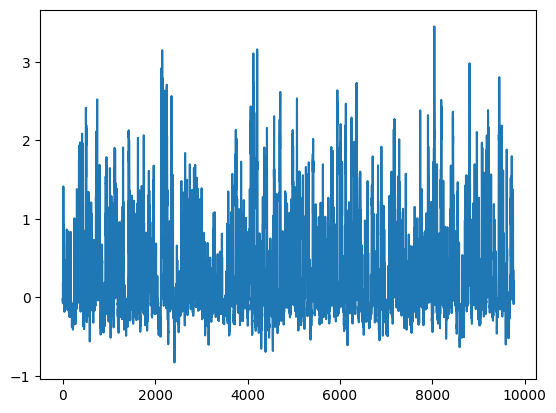

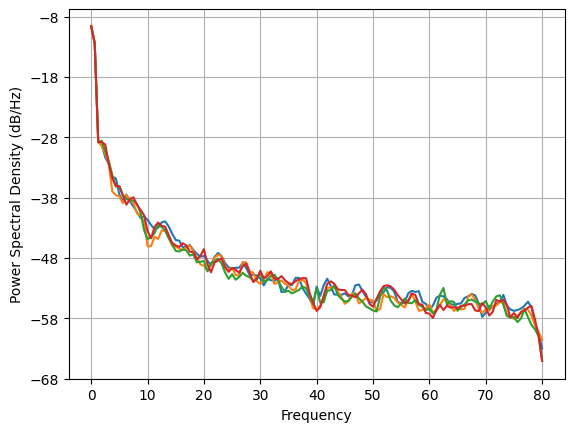

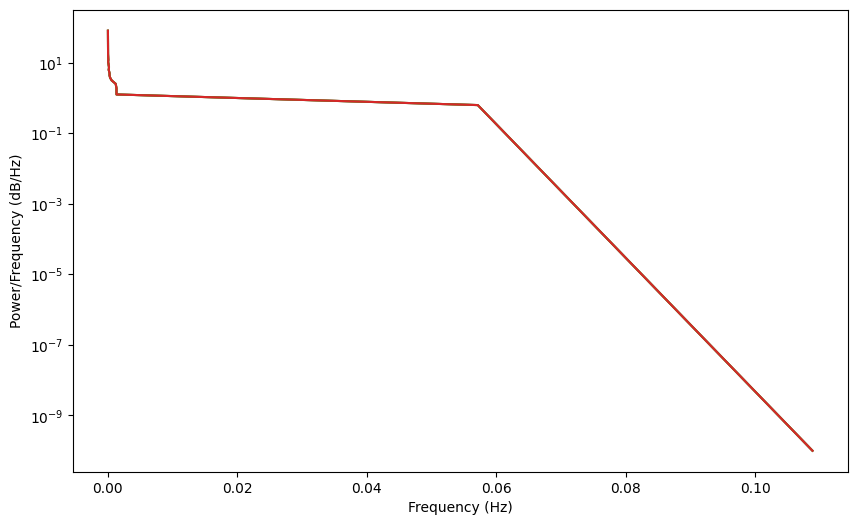

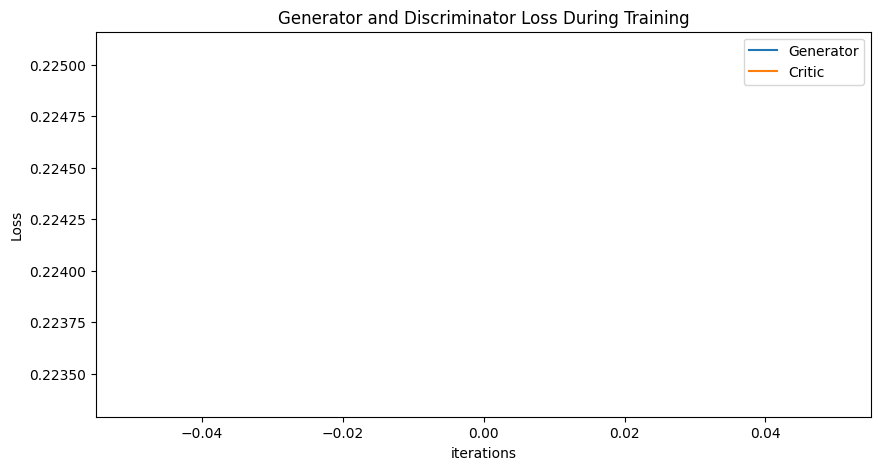

Epoch 10: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736]) Generator err ([0.2233773022890091, 0.47255823016166687, 0.8503849506378174, 1.4800779819488525, 2.4727039337158203, 3.477853775024414, 5.641024589538574, 8.405522346496582, 15.18578815460205, 18.781661987304688, 30.000057220458984])


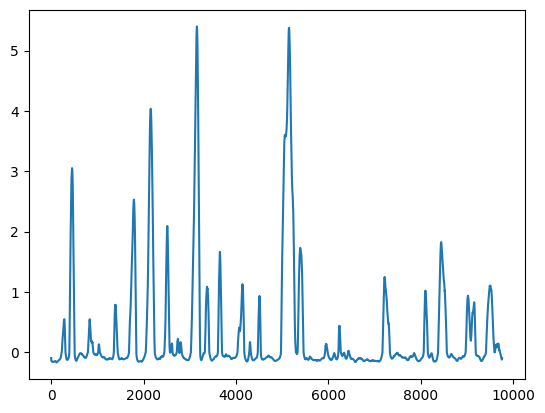

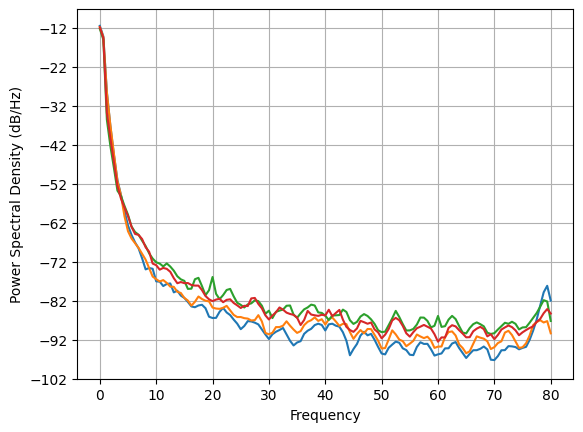

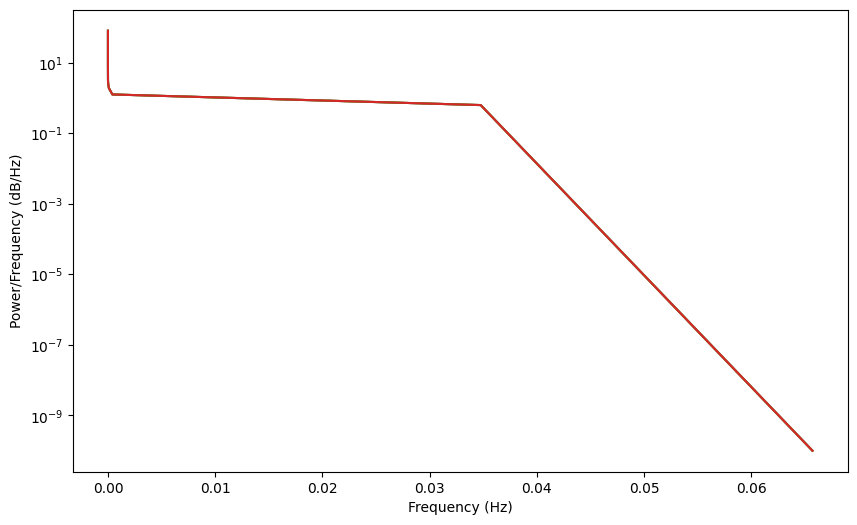

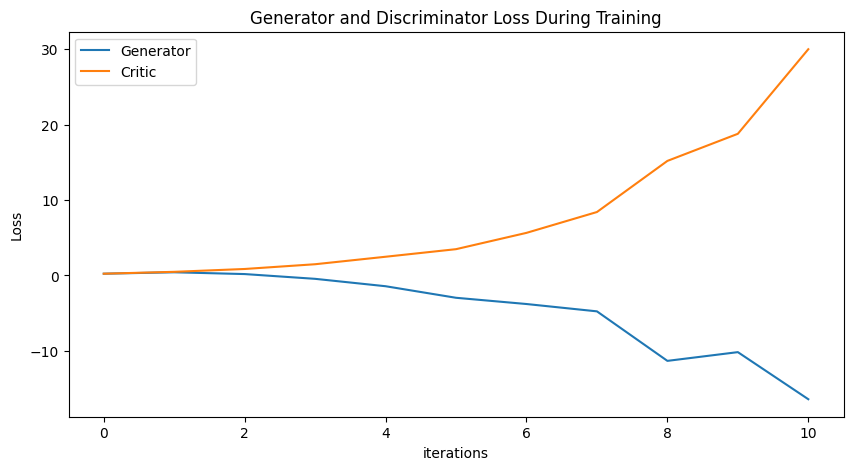

Epoch 20: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288]) Generator err ([0.2233773022890091, 0.47255823016166687, 0.8503849506378174, 1.4800779819488525, 2.4727039337158203, 3.477853775024414, 5.641024589538574, 8.405522346496582, 15.18578815460205, 18.781661987304688, 30.000057220458984, 33.97393798828125, 30.948816299438477, 32.8751106262207, 40.167320251464844, 43.58986282348633, 42.34260177612305, 46.739173889160156, 51.40739440917969, 60.1455192565918, 49.528255462646484])


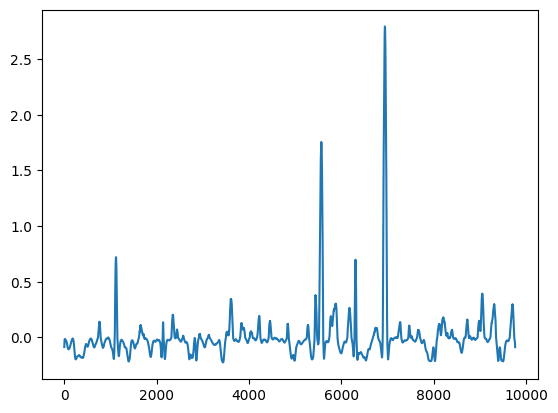

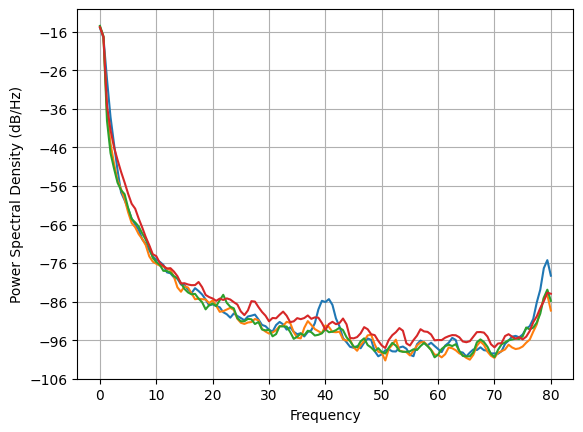

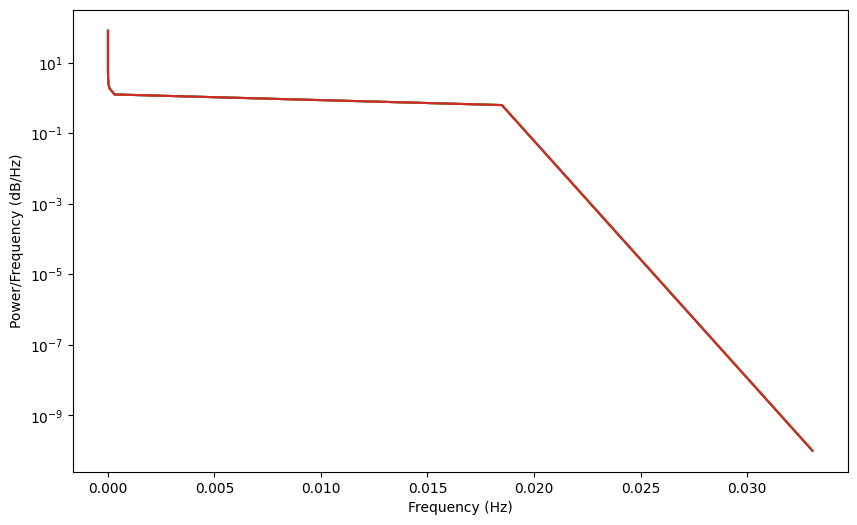

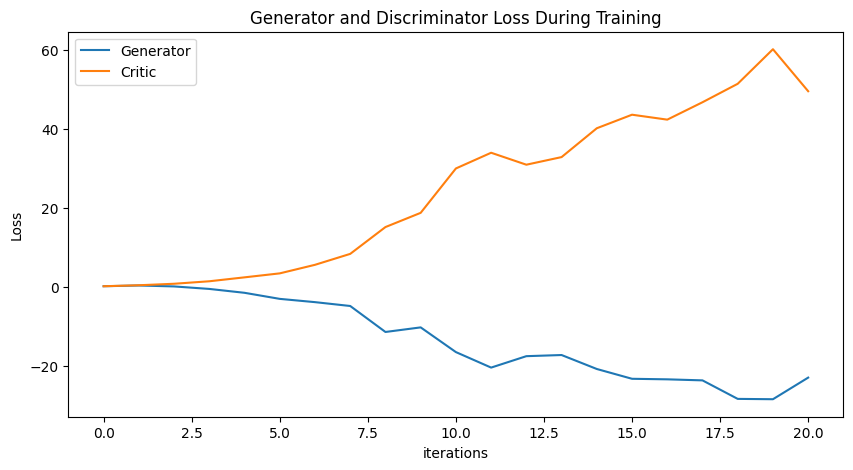

Epoch 30: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122]) Generator err ([0.2233773022890091, 0.47255823016166687, 0.8503849506378174, 1.4800779819488525, 2.4727039337158203, 3.477853775024414, 5.641024589538574, 8.405522346496582, 15.18578815460205, 18.781661987304688, 30.000057220458984, 33.97393798828125, 30.948816299438477, 32.8751106262207, 40.167320251464844, 43.58986282348633, 42.3426

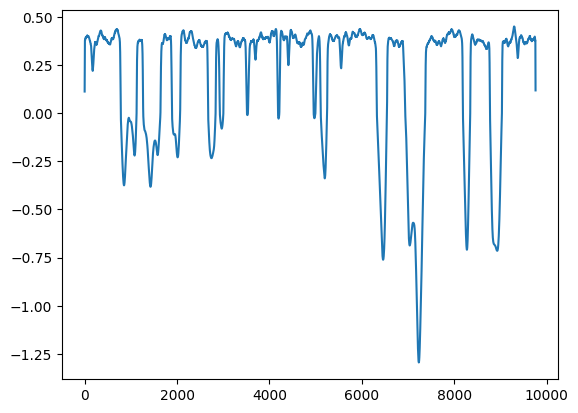

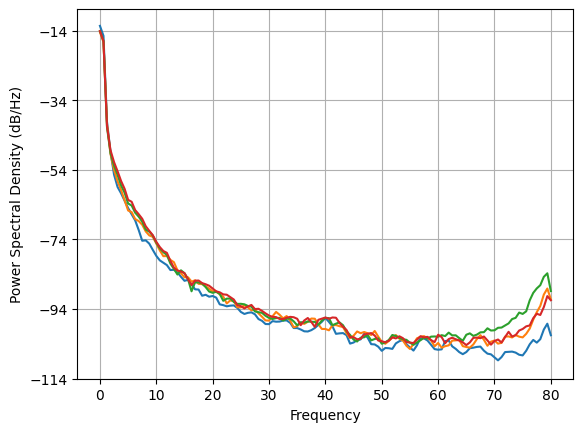

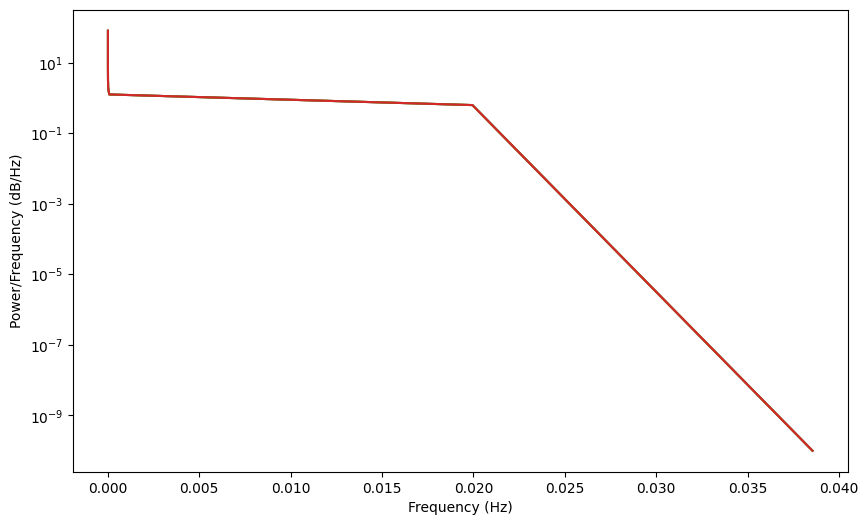

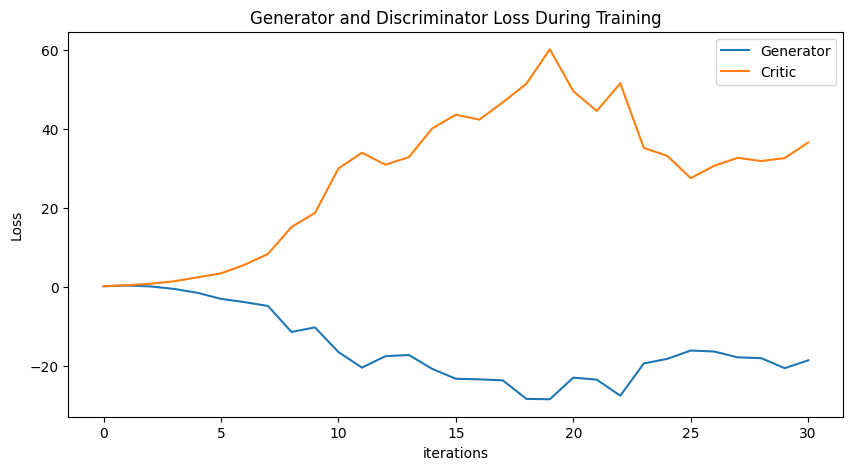

Epoch 40: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433]) Generator err ([0.2233773022890091, 0.47255823016166687, 0.8503849506378174, 1.4800779819488525, 2.4727039337158203, 3.47785377

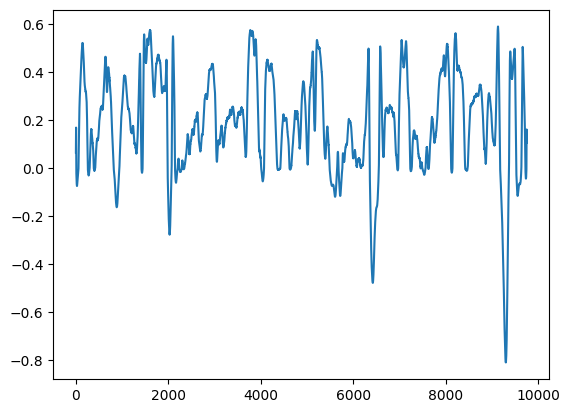

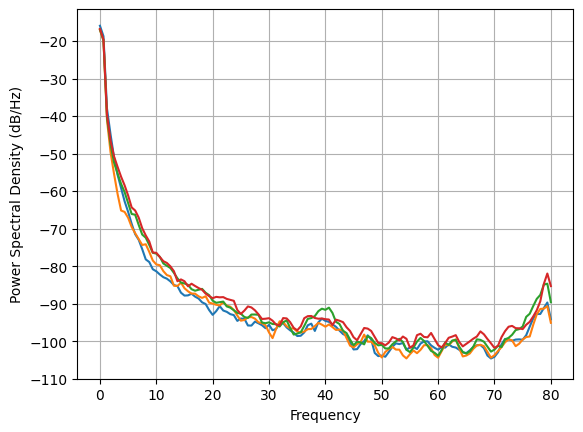

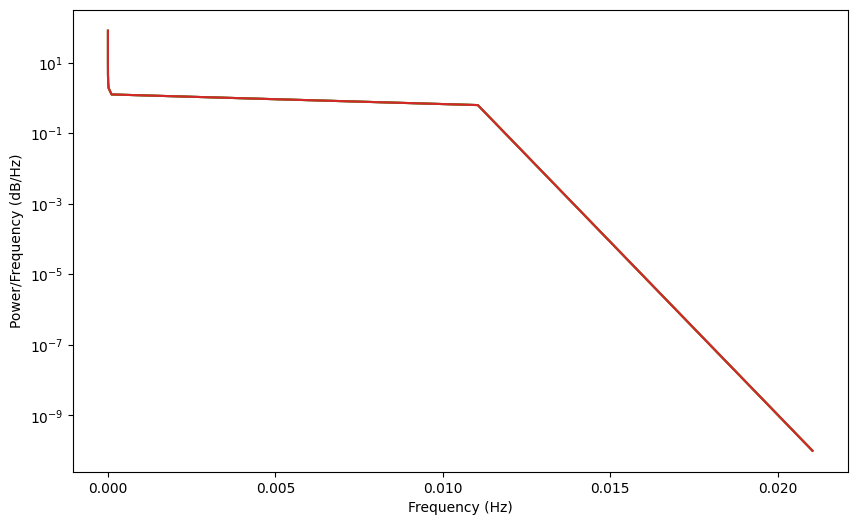

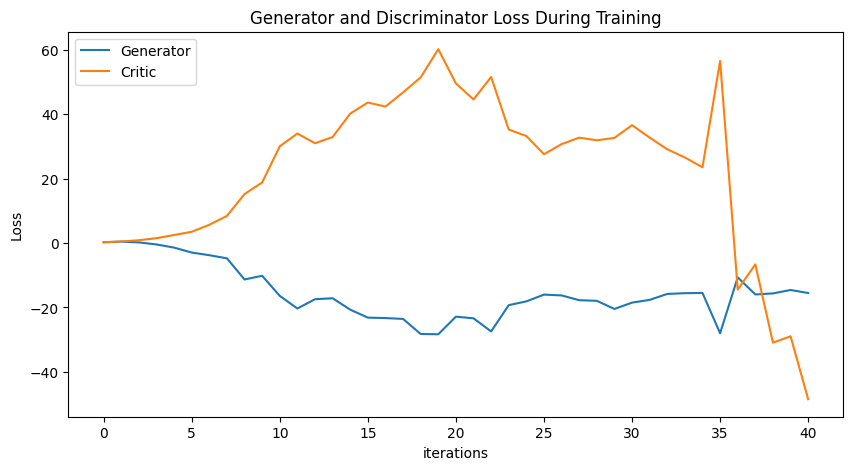

Epoch 50: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17.

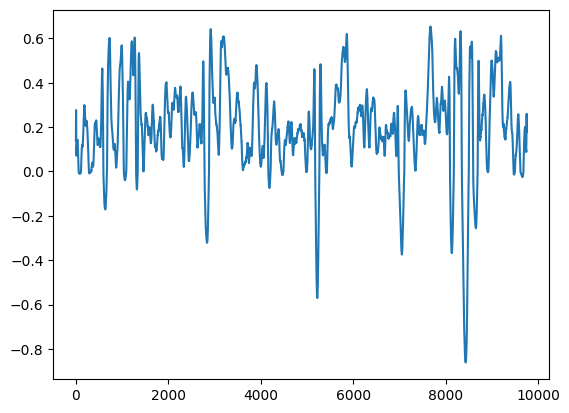

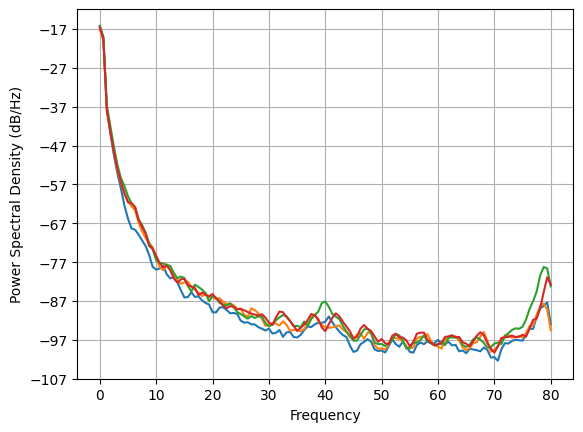

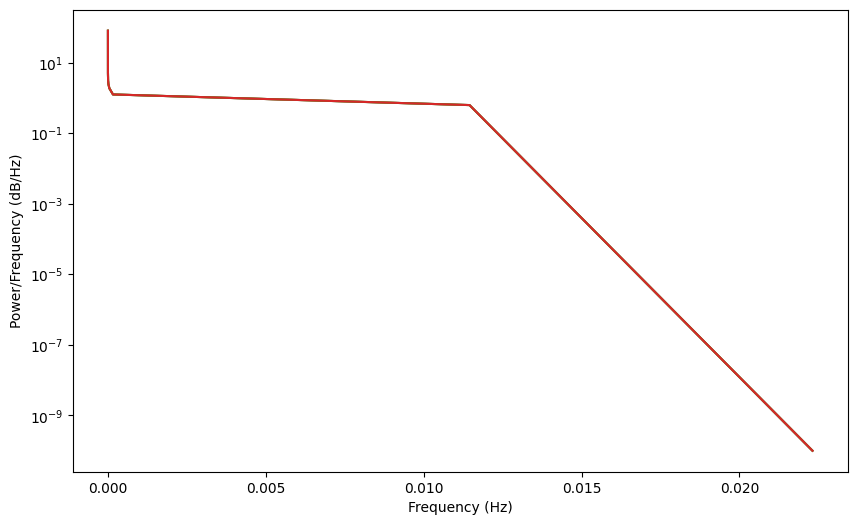

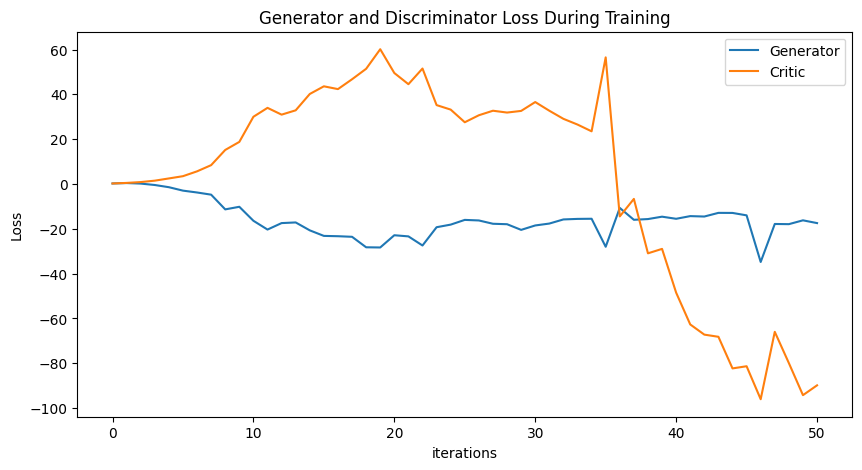

Epoch 60: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17.

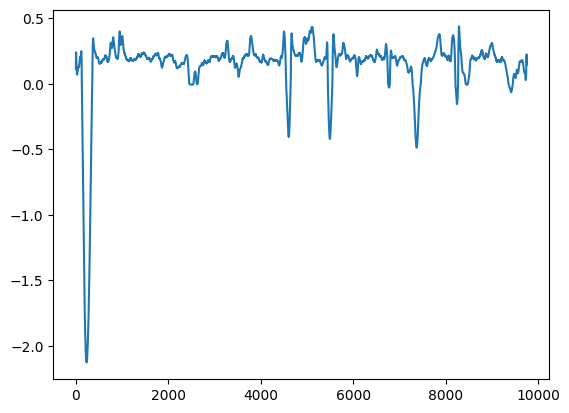

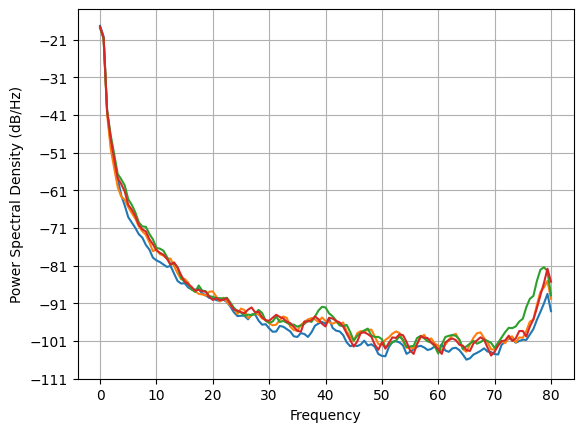

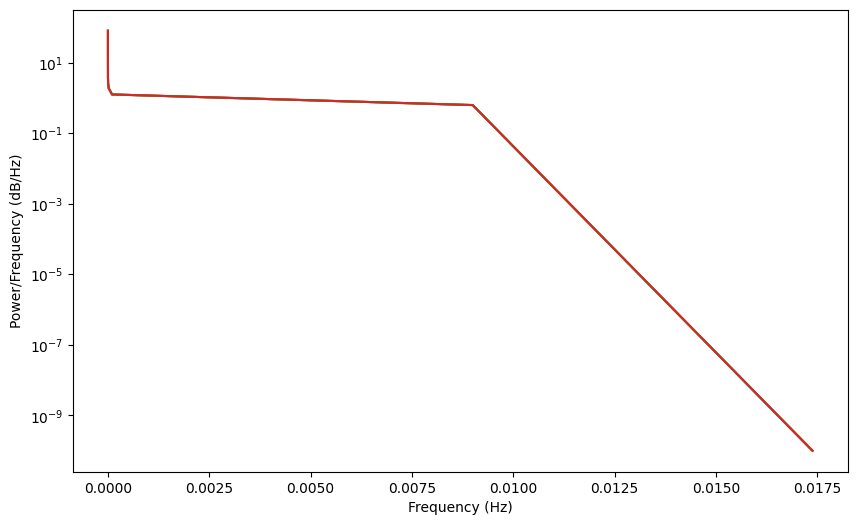

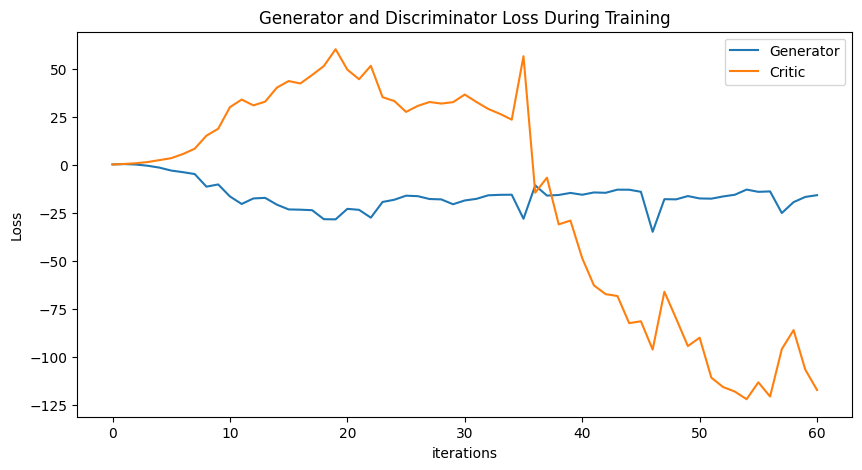

Epoch 70: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17.

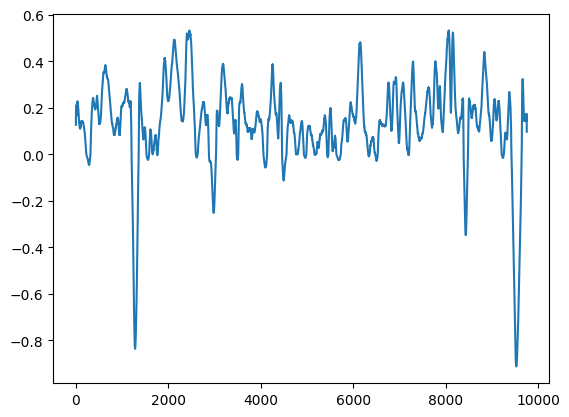

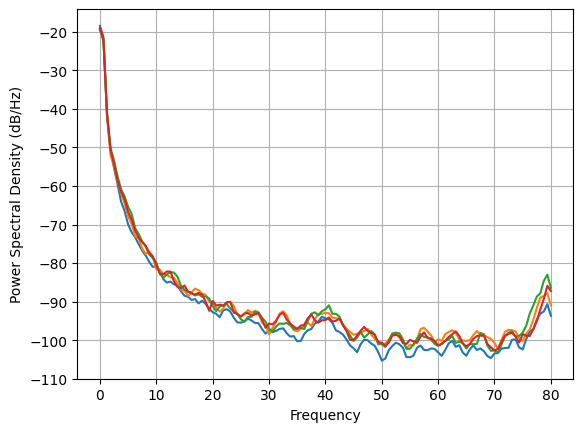

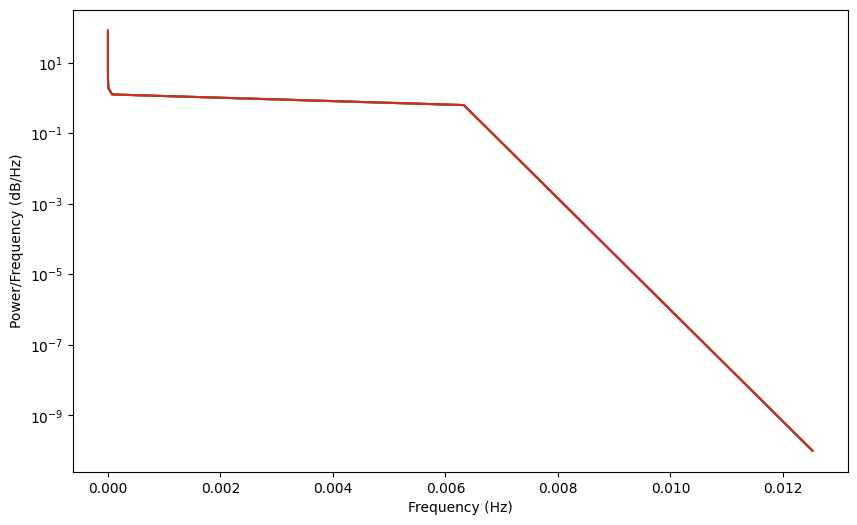

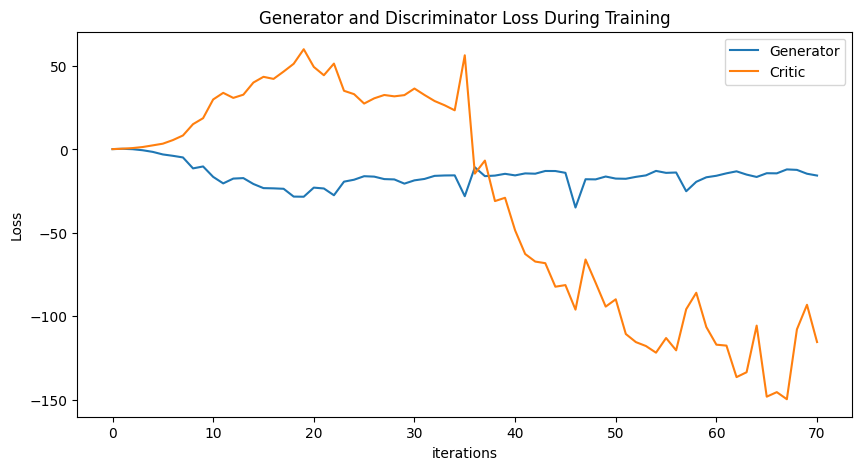

Epoch 80: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17.

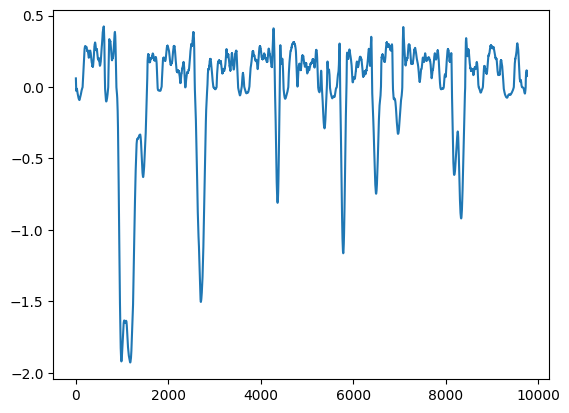

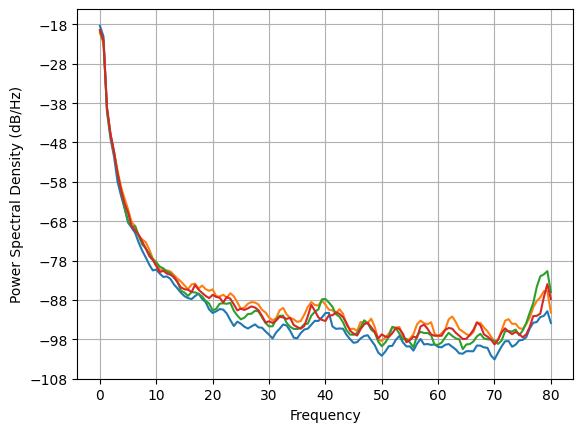

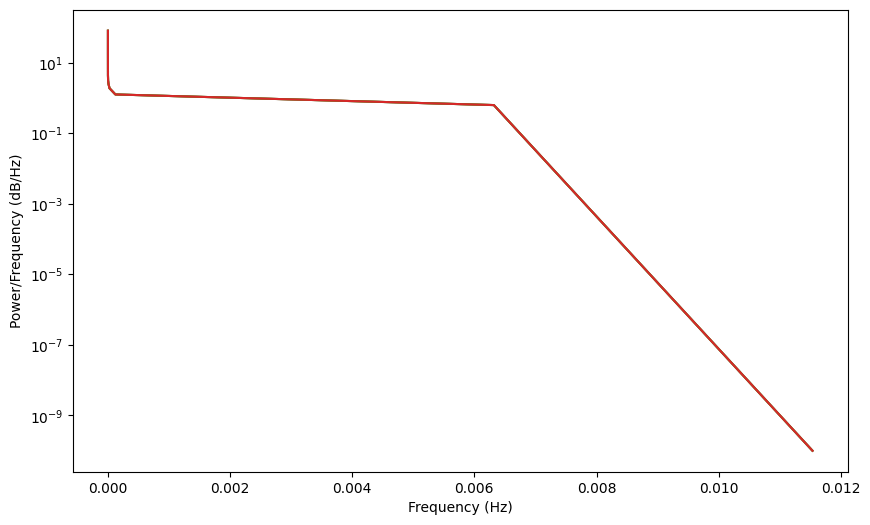

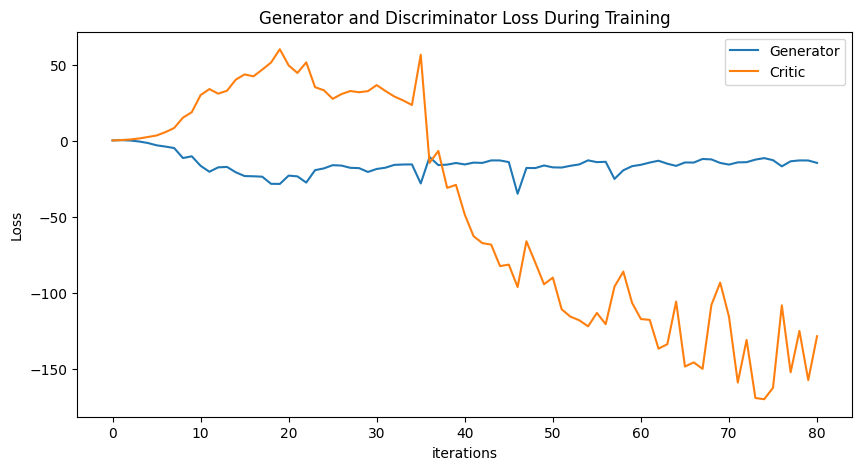

Epoch 90: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17.

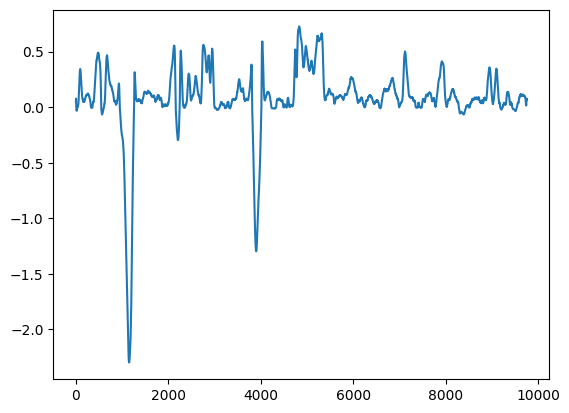

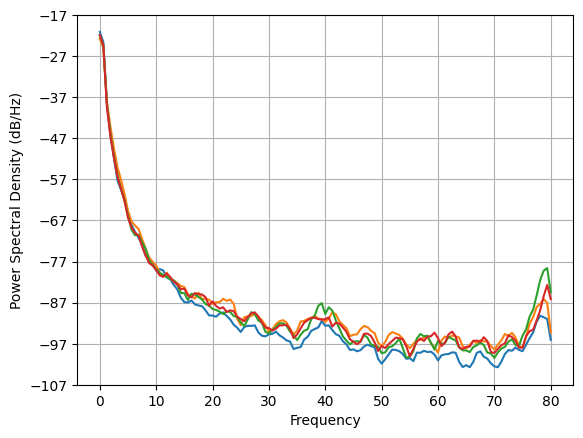

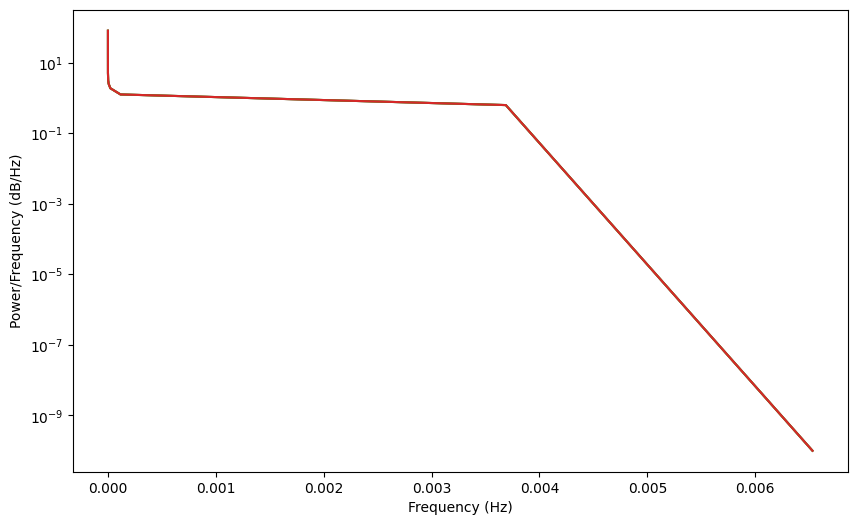

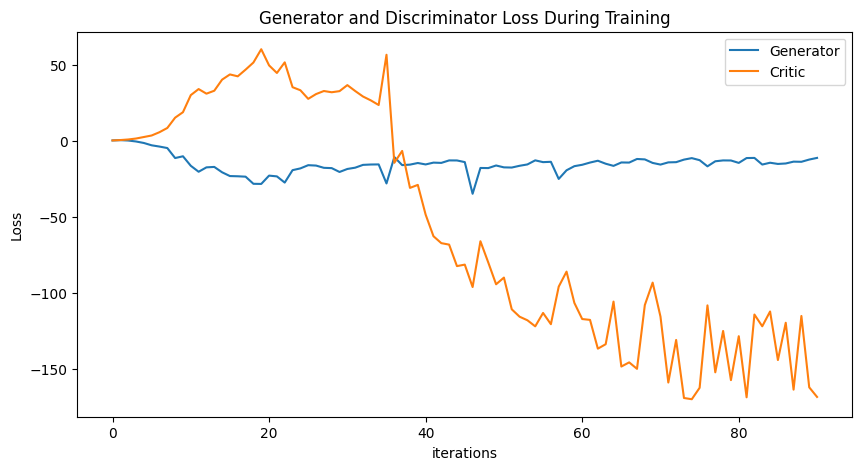

Epoch 100: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17

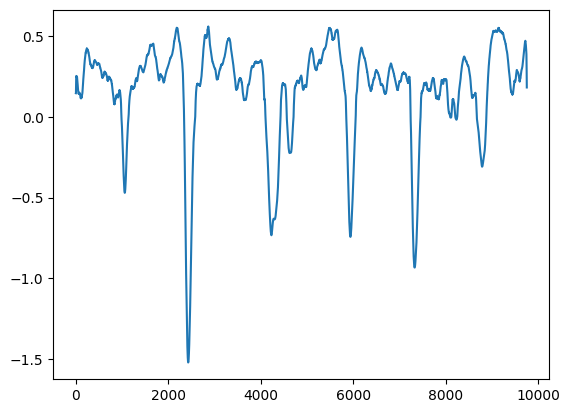

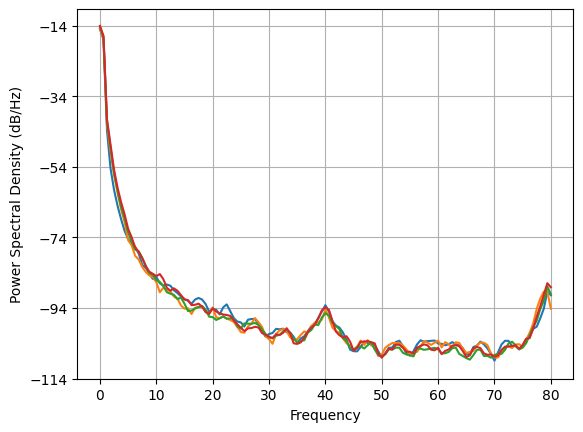

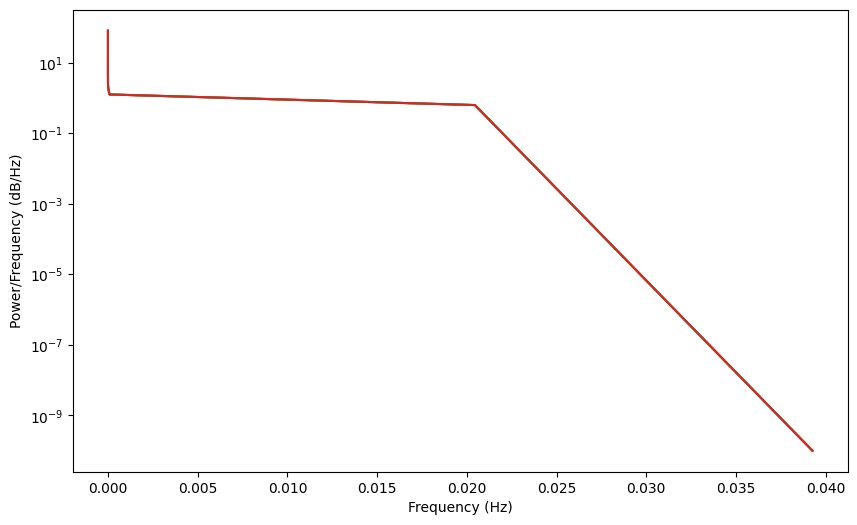

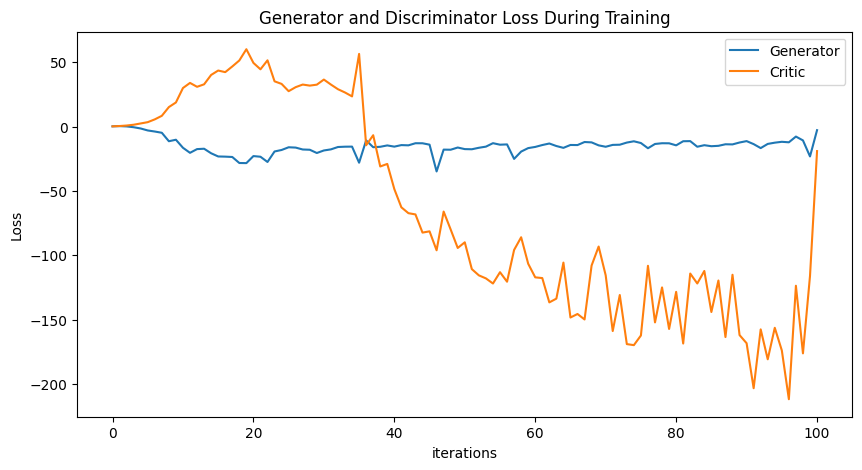

Epoch 110: Critic error ([0.2250743167988345, 0.4124061196242504, 0.1755304011597018, -0.4563675635633832, -1.4370071533947253, -2.969744505038502, -3.7969555202564518, -4.769781939561516, -11.338060336694351, -10.17923347707283, -16.425172170494736, -20.34331529754867, -17.45622358946077, -17.167462673111213, -20.698002200962065, -23.174181990717113, -23.31242420148524, -23.575977990684233, -28.255786567715447, -28.33995357414068, -22.877039964247288, -23.388639933805724, -27.455091847501926, -19.29674998617902, -18.136970222557668, -16.028366001458764, -16.280165776840484, -17.7590540410101, -17.958299172487287, -20.483400942242195, -18.512889531262122, -17.66548936262812, -15.825018860114552, -15.585487510092918, -15.522190686010473, -28.026293330914804, -10.685216122765965, -15.985290287791797, -15.659355965150922, -14.595321667616455, -15.536939393770433, -14.343835575294333, -14.527295687641795, -12.893896331385255, -12.92174264239915, -14.00301899044953, -34.809719511501214, -17

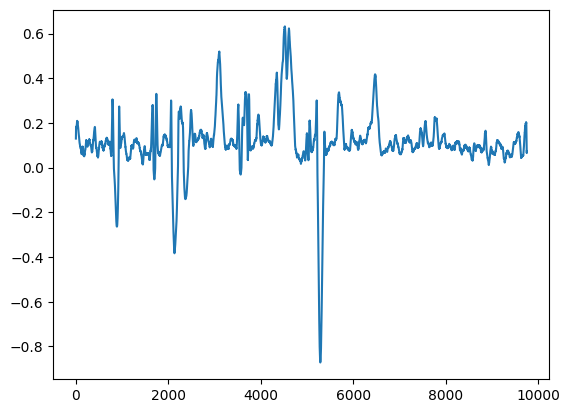

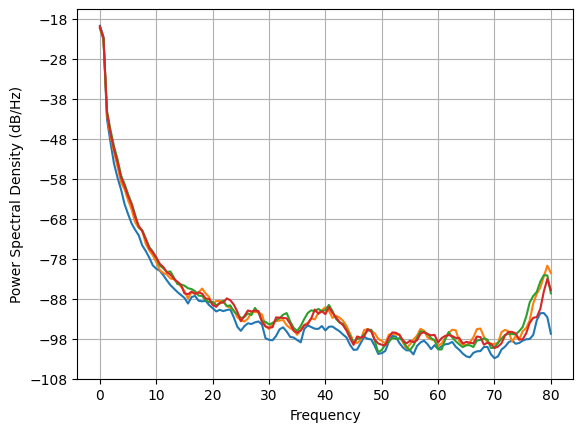

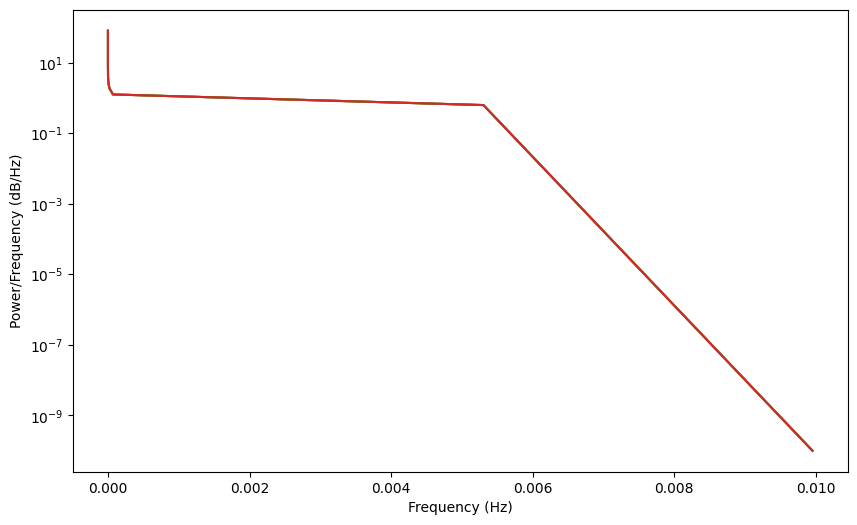

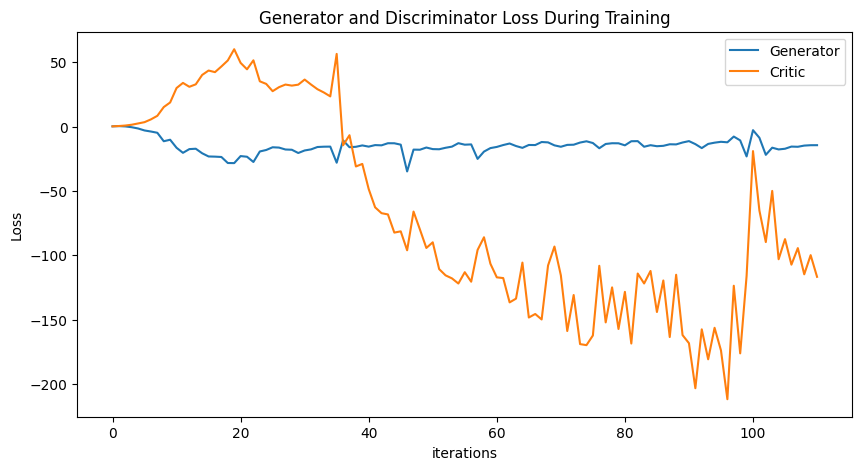

In [ ]:
SPECTRAL_LOSS_FACTOR = 0.001
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def spectral_loss(real_data, fake_data):
    fft_real = torch.fft.fft(real_data)
    fft_fake = torch.fft.fft(fake_data)
    magnitude_real = torch.sqrt(fft_real.real**2 + fft_real.imag**2)
    magnitude_fake = torch.sqrt(fft_fake.real**2 + fft_fake.imag**2)
    magnitude_real = normalize(magnitude_real, dim=0)
    magnitude_fake = normalize(magnitude_fake, dim=0)
    return F.mse_loss(magnitude_real, magnitude_fake)

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            spectral_loss_val = spectral_loss(real.data, fake.data)
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp + (spectral_loss_val * SPECTRAL_LOSS_FACTOR)
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-1.pt')
torch.save(disc, 'discriminator-v11-1.pt')
np.save('closed-v11-1.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Normalized spectral loss term 

In [ ]:
SPECTRAL_LOSS_FACTOR = 0.0005
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)

def spectral_loss(real_data, fake_data):
    fft_real = torch.fft.fft(real_data)
    fft_fake = torch.fft.fft(fake_data)
    magnitude_real = torch.sqrt(fft_real.real**2 + fft_real.imag**2)
    magnitude_fake = torch.sqrt(fft_fake.real**2 + fft_fake.imag**2)
    magnitude_real = normalize(magnitude_real, dim=0)
    magnitude_fake = normalize(magnitude_fake, dim=0)
    return F.mse_loss(magnitude_real, magnitude_fake)

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            spectral_loss_val = spectral_loss(real.data, fake.data)
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp + (spectral_loss_val * SPECTRAL_LOSS_FACTOR)
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-2.pt')
torch.save(disc, 'discriminator-v11-2.pt')
np.save('closed-v11-2.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Normalized spectral loss term (peak 10,60)

Epoch 0: Critic error ([4.490429807678288]) Generator err ([2.6891448497772217])


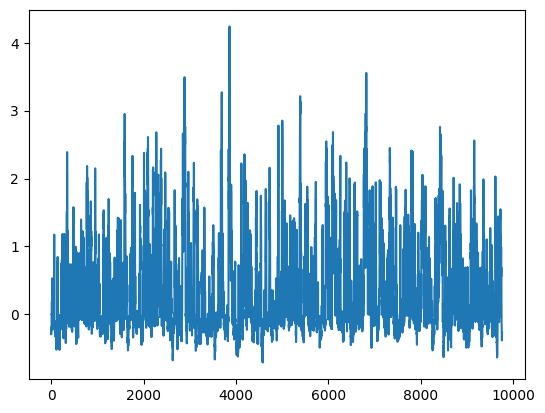

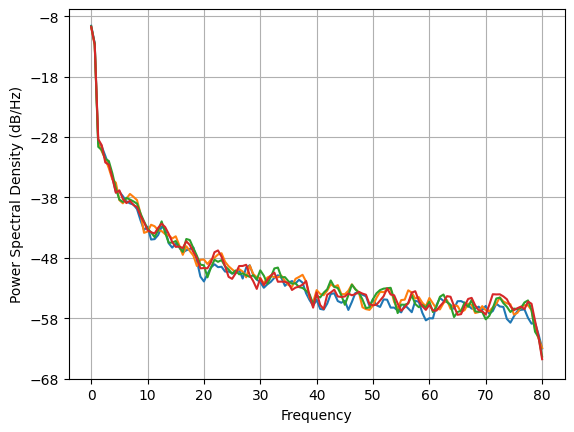

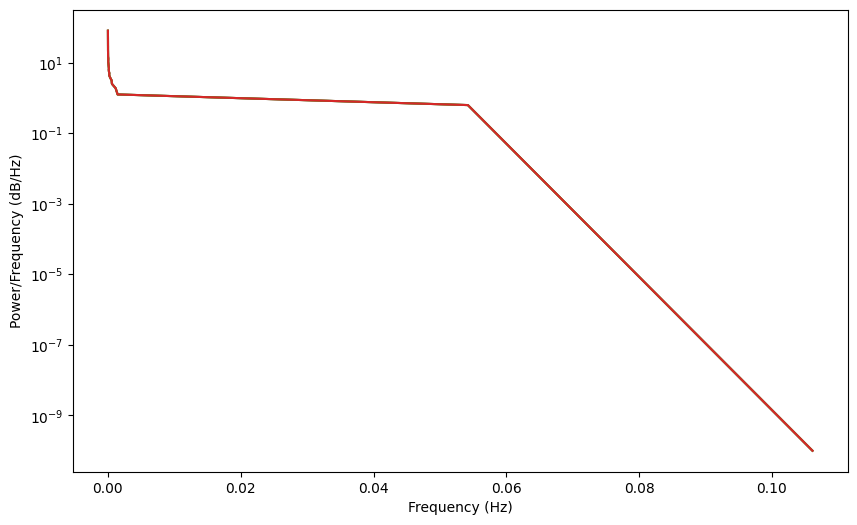

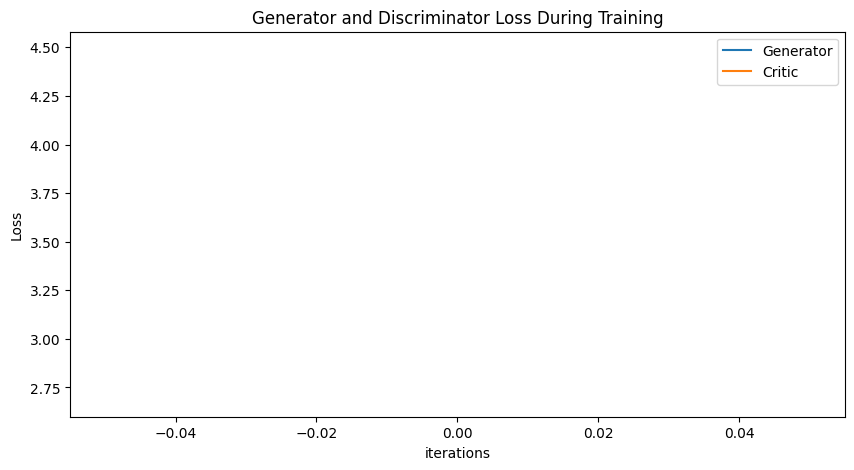

Epoch 10: Critic error ([4.490429807678288, 2.3666742302086905, 1.4458891334536559, 0.04808462679811722, -1.5441048256294865, -5.377275859863585, -6.537643265233514, -3.602727378342924, -5.100536827554222, -15.630169692549334, -12.982818846222509]) Generator err ([2.6891448497772217, 3.117480516433716, 3.7243568897247314, 4.099313259124756, 5.622639179229736, 7.9299397468566895, 10.360343933105469, 6.134427547454834, 7.425856590270996, 20.39596939086914, 18.442584991455078])


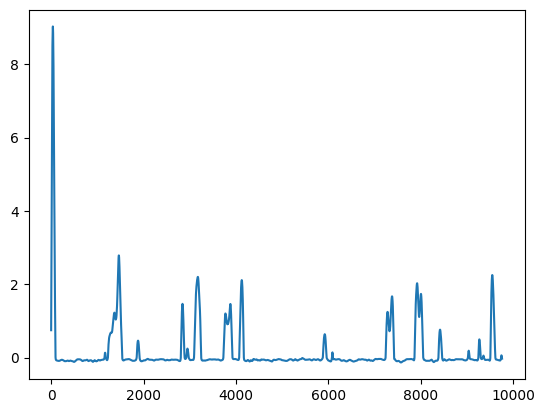

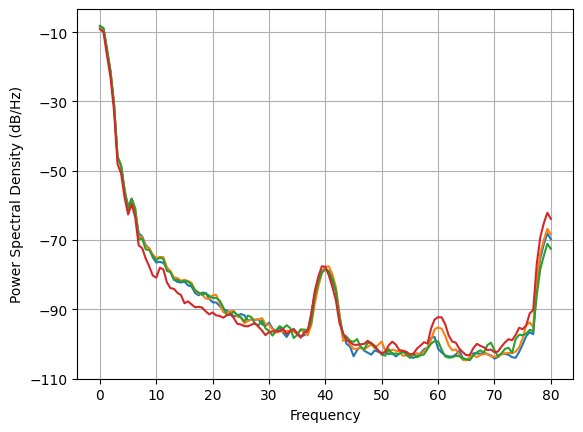

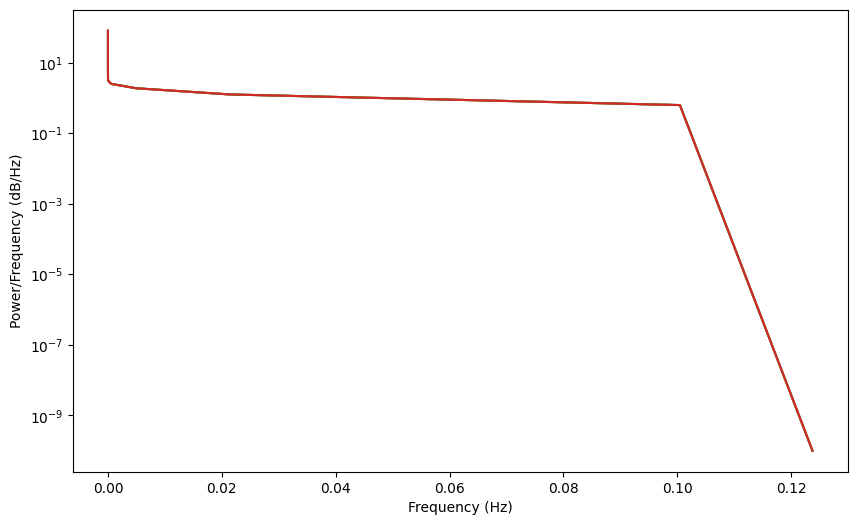

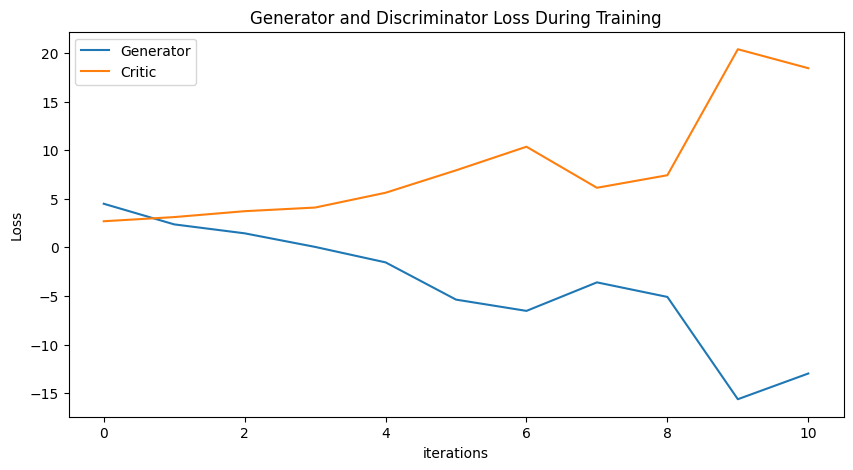

Epoch 20: Critic error ([4.490429807678288, 2.3666742302086905, 1.4458891334536559, 0.04808462679811722, -1.5441048256294865, -5.377275859863585, -6.537643265233514, -3.602727378342924, -5.100536827554222, -15.630169692549334, -12.982818846222509, -20.135922249499583, -18.121875698575188, -17.251918289925765, -23.072714576132856, -25.750864846406465, -19.007815132797774, -23.66446191769219, -19.936913313765558, -15.75695212901958, -15.063937358939558]) Generator err ([2.6891448497772217, 3.117480516433716, 3.7243568897247314, 4.099313259124756, 5.622639179229736, 7.9299397468566895, 10.360343933105469, 6.134427547454834, 7.425856590270996, 20.39596939086914, 18.442584991455078, 33.56557846069336, -17.473604202270508, -22.809602737426758, -42.30864334106445, -37.600791931152344, -106.0018539428711, -99.8857421875, -165.02297973632812, -120.11365509033203, -136.9984130859375])


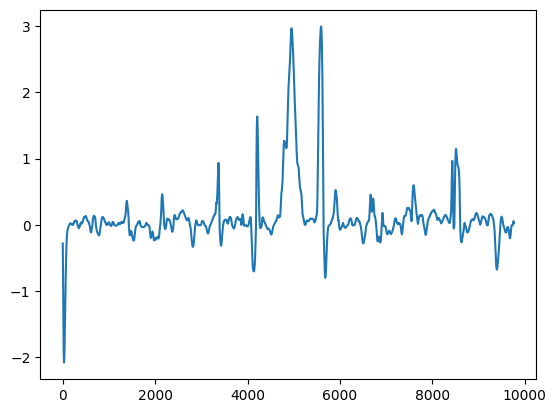

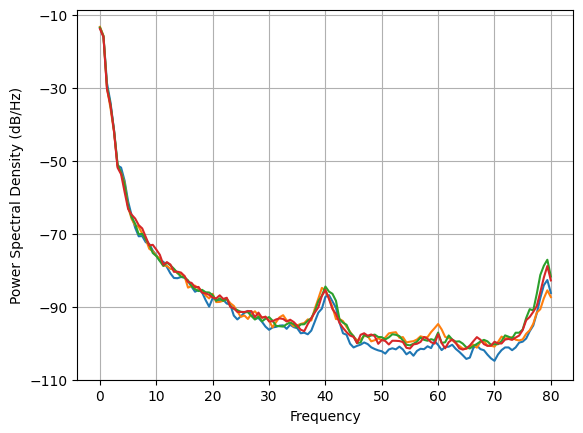

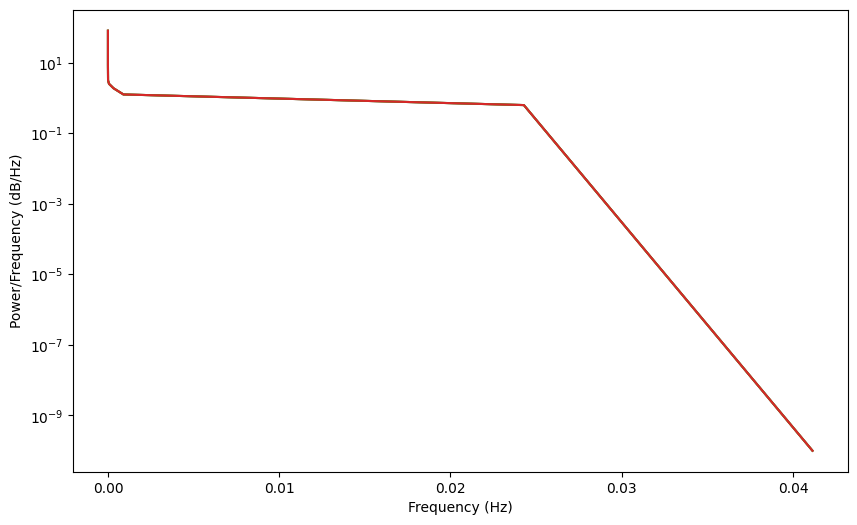

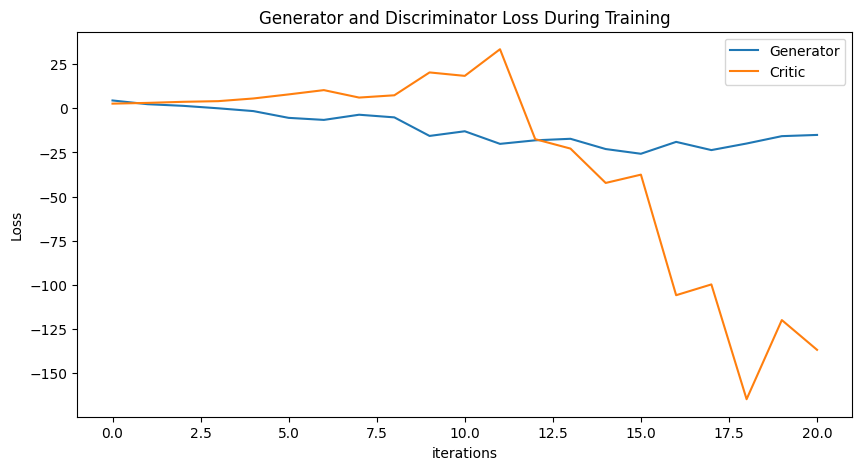

Epoch 30: Critic error ([4.490429807678288, 2.3666742302086905, 1.4458891334536559, 0.04808462679811722, -1.5441048256294865, -5.377275859863585, -6.537643265233514, -3.602727378342924, -5.100536827554222, -15.630169692549334, -12.982818846222509, -20.135922249499583, -18.121875698575188, -17.251918289925765, -23.072714576132856, -25.750864846406465, -19.007815132797774, -23.66446191769219, -19.936913313765558, -15.75695212901958, -15.063937358939558, -14.815741694461899, -17.1507891001037, -15.420265503681373, -12.607068857441531, -12.506884693202668, -12.972351485817853, -12.59228365577491, -13.55752298605722, -12.796285046258458, -13.112526131312064]) Generator err ([2.6891448497772217, 3.117480516433716, 3.7243568897247314, 4.099313259124756, 5.622639179229736, 7.9299397468566895, 10.360343933105469, 6.134427547454834, 7.425856590270996, 20.39596939086914, 18.442584991455078, 33.56557846069336, -17.473604202270508, -22.809602737426758, -42.30864334106445, -37.600791931152344, -106.

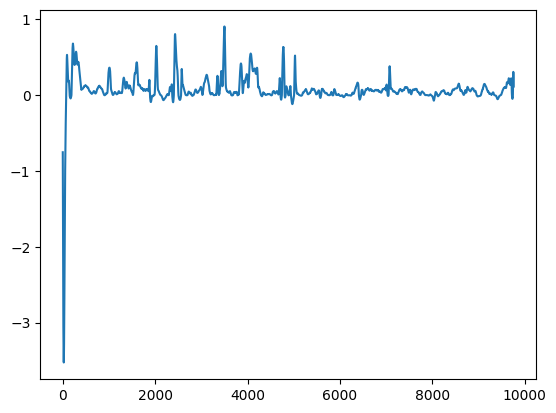

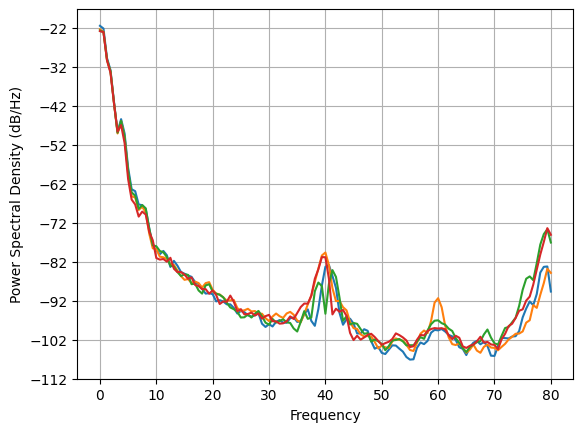

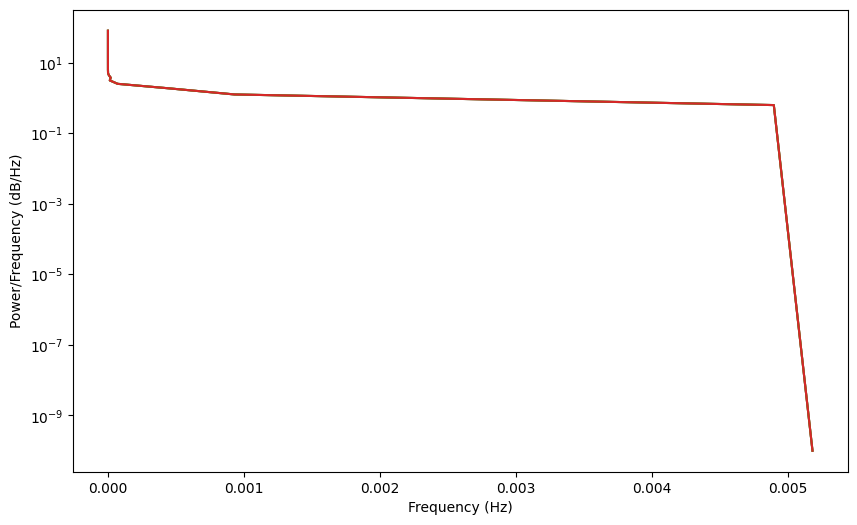

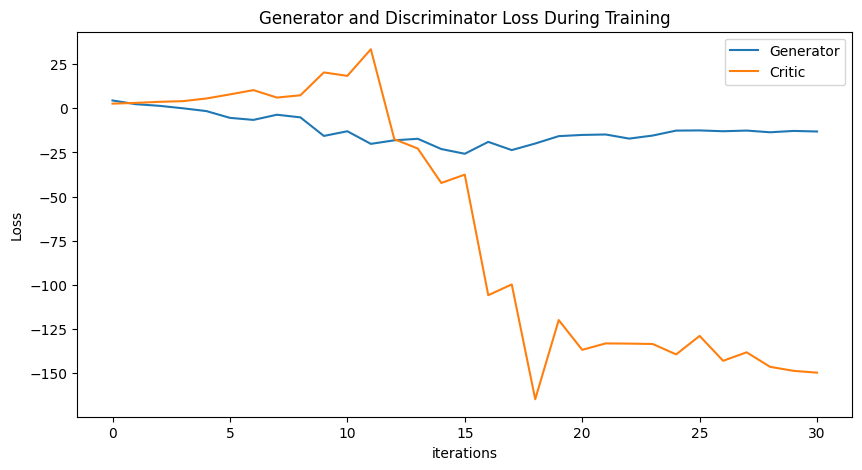

Epoch 40: Critic error ([4.490429807678288, 2.3666742302086905, 1.4458891334536559, 0.04808462679811722, -1.5441048256294865, -5.377275859863585, -6.537643265233514, -3.602727378342924, -5.100536827554222, -15.630169692549334, -12.982818846222509, -20.135922249499583, -18.121875698575188, -17.251918289925765, -23.072714576132856, -25.750864846406465, -19.007815132797774, -23.66446191769219, -19.936913313765558, -15.75695212901958, -15.063937358939558, -14.815741694461899, -17.1507891001037, -15.420265503681373, -12.607068857441531, -12.506884693202668, -12.972351485817853, -12.59228365577491, -13.55752298605722, -12.796285046258458, -13.112526131312064, -13.487046274381928, -13.856944092581832, -14.025950255275202, -12.454633876587149, -13.459627576083264, -13.971921546324397, -13.597933250085545, -13.731564454624865, -13.586450353933747, -13.457834769318797]) Generator err ([2.6891448497772217, 3.117480516433716, 3.7243568897247314, 4.099313259124756, 5.622639179229736, 7.929939746856

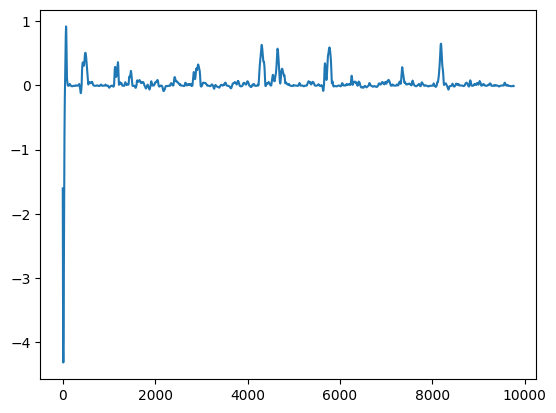

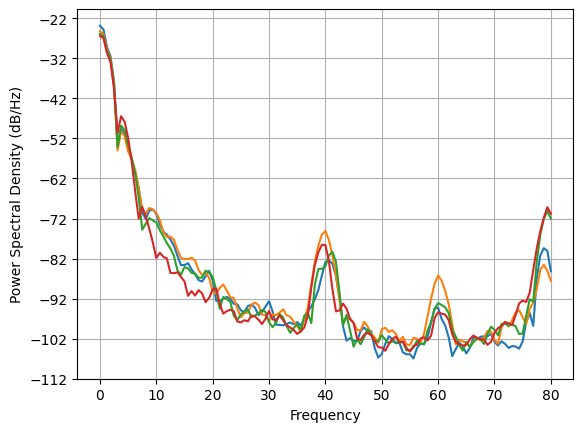

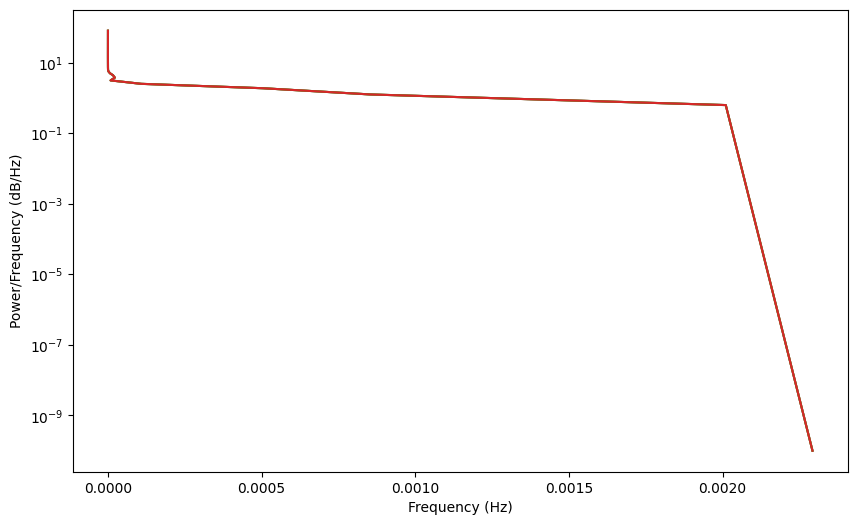

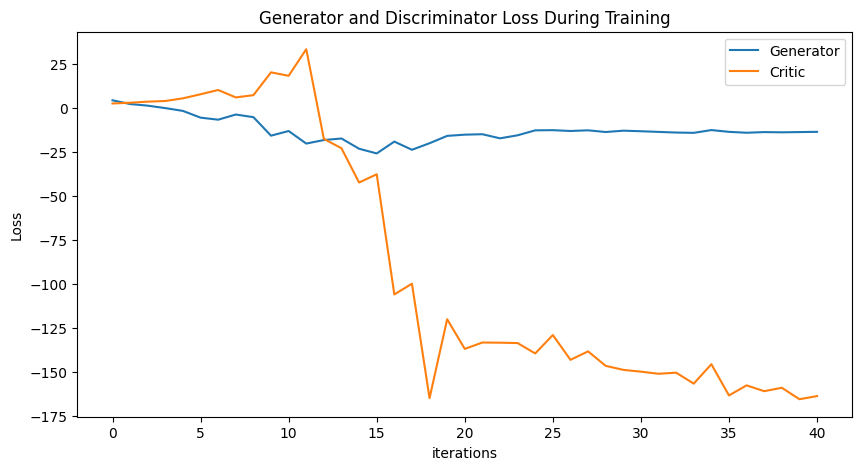

Epoch 50: Critic error ([4.490429807678288, 2.3666742302086905, 1.4458891334536559, 0.04808462679811722, -1.5441048256294865, -5.377275859863585, -6.537643265233514, -3.602727378342924, -5.100536827554222, -15.630169692549334, -12.982818846222509, -20.135922249499583, -18.121875698575188, -17.251918289925765, -23.072714576132856, -25.750864846406465, -19.007815132797774, -23.66446191769219, -19.936913313765558, -15.75695212901958, -15.063937358939558, -14.815741694461899, -17.1507891001037, -15.420265503681373, -12.607068857441531, -12.506884693202668, -12.972351485817853, -12.59228365577491, -13.55752298605722, -12.796285046258458, -13.112526131312064, -13.487046274381928, -13.856944092581832, -14.025950255275202, -12.454633876587149, -13.459627576083264, -13.971921546324397, -13.597933250085545, -13.731564454624865, -13.586450353933747, -13.457834769318797, -13.789770816508874, -13.450647684531033, -13.612303282099788, -13.488910674865156, -13.828315994753765, -13.950884962569486, -1

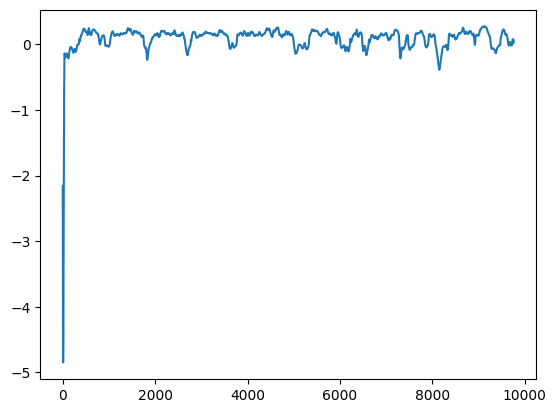

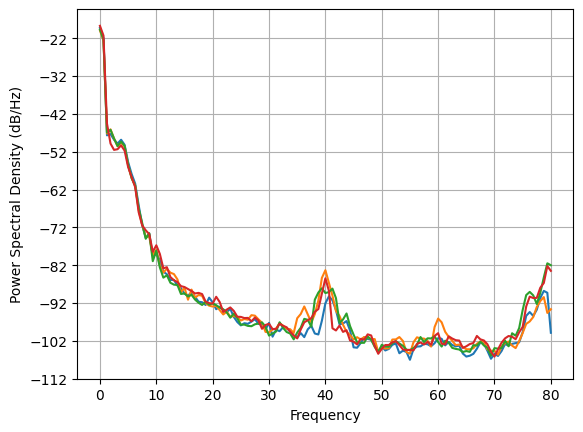

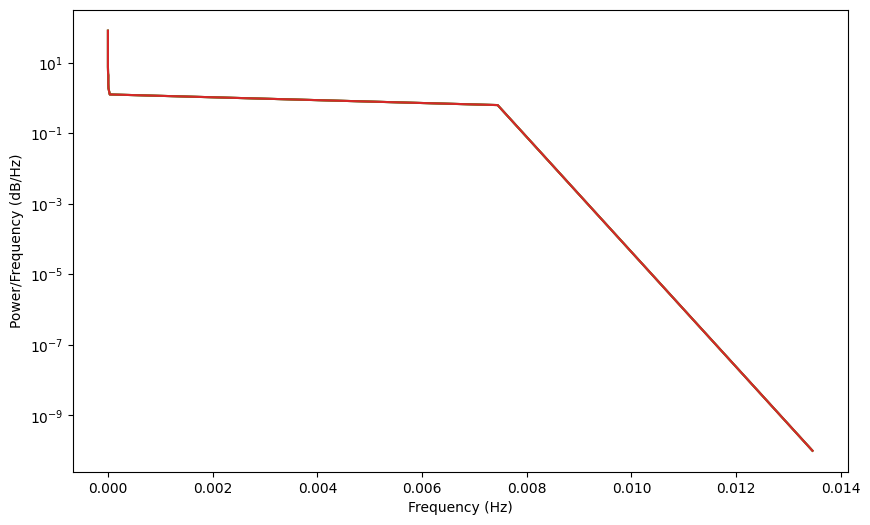

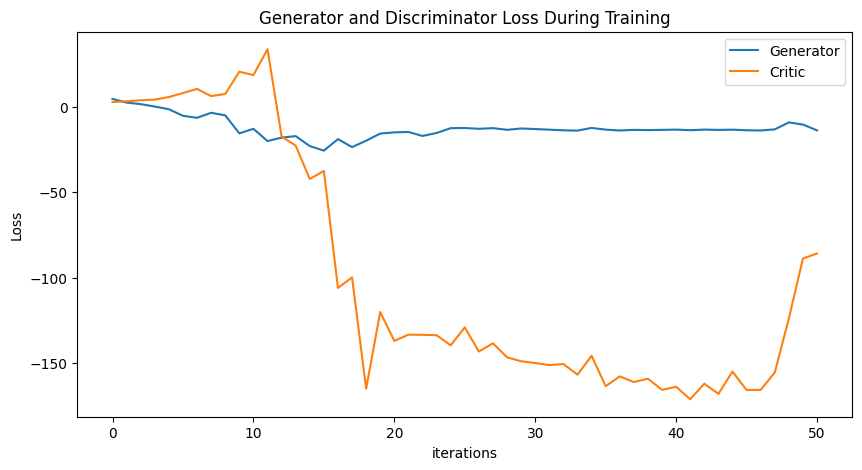

KeyboardInterrupt: 

In [14]:
SPECTRAL_LOSS_FACTOR = 0.001
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)

def spectral_loss(real_data, fake_data, peak_freqs, fs):
    # FFT
    fft_real = torch.fft.fft(real_data)
    fft_fake = torch.fft.fft(fake_data)

    # Compute frequency axis
    freqs = torch.fft.fftfreq(real_data.shape[-1], d=1/fs)

    # Select magnitudes at target frequencies
    target_idx = [(torch.abs(freqs - f)).argmin() for f in peak_freqs]
    mag_real = torch.sqrt(fft_real.real**2 + fft_real.imag**2)[..., target_idx]
    mag_fake = torch.sqrt(fft_fake.real**2 + fft_fake.imag**2)[..., target_idx]

    return F.mse_loss(mag_real, mag_fake)

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.mean(critic_fake)
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            spectral_loss_val = spectral_loss(real.data, fake.data, peak_freqs=[10, 60], fs=fs)
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp + (spectral_loss_val * SPECTRAL_LOSS_FACTOR)
            loss_critic.backward()
            critic_optimizer.step()  

        noise = sample_normal_distribution(BATCH_SIZE, 400, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-3.pt')
torch.save(disc, 'discriminator-v11-3.pt')
np.save('closed-v11-3.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Spectral loss with sqrt loss

In [ ]:
SPECTRAL_LOSS_FACTOR = 0.001
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)

def spectral_loss(real_data, fake_data):
    fft_real = torch.fft.fft(real_data)
    fft_fake = torch.fft.fft(fake_data)
    magnitude_real = torch.sqrt(fft_real.real**2 + fft_real.imag**2)
    magnitude_fake = torch.sqrt(fft_fake.real**2 + fft_fake.imag**2)
    magnitude_real = normalize(magnitude_real, dim=0)
    magnitude_fake = normalize(magnitude_fake, dim=0)
    return F.mse_loss(magnitude_real, magnitude_fake)

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))
            real.requires_grad=True
            critic_real = D(real).reshape(-1)
            loss_critic_real = -torch.sqrt(torch.mean(critic_real**2))  # Replacing mean with Root Mean Squared
            noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
            fake = G(noise)
            critic_fake = D(fake).reshape(-1)
            loss_critic_fake = torch.sqrt(torch.mean(critic_fake**2))  # Replacing mean with Root Mean Squared
            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            spectral_loss_val = spectral_loss(real.data, fake.data)
            D.zero_grad()
            loss_critic = loss_critic_real + loss_critic_fake + gp + (spectral_loss_val * SPECTRAL_LOSS_FACTOR) 
            loss_critic.backward()
            critic_optimizer.step()

        noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.sqrt(torch.mean(gen_fake**2))  # Replacing mean with Root Mean Squared
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-4.pt')
torch.save(disc, 'discriminator-v11-4.pt')
np.save('closed-v11-4.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Spectral loss with power_spectrum

Epoch 0: Critic error ([10564305937.648941]) Generator err ([-0.7603557705879211])


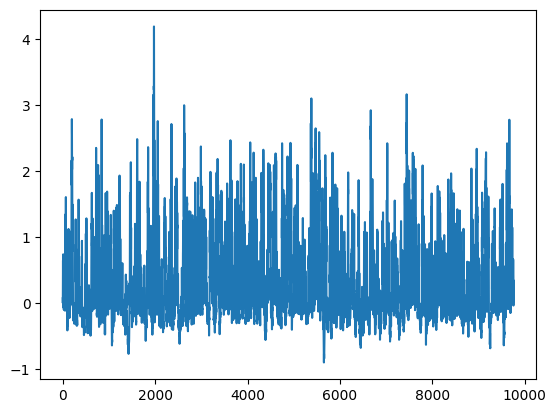

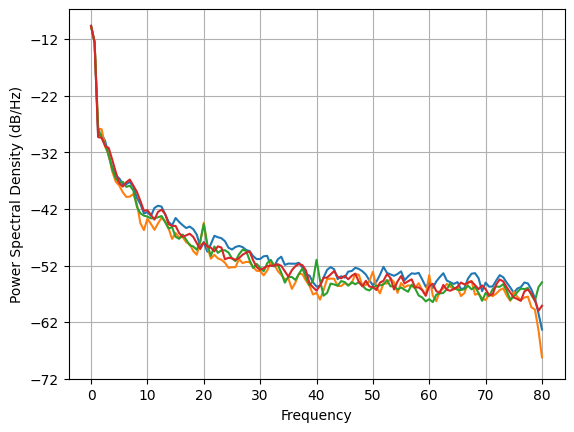

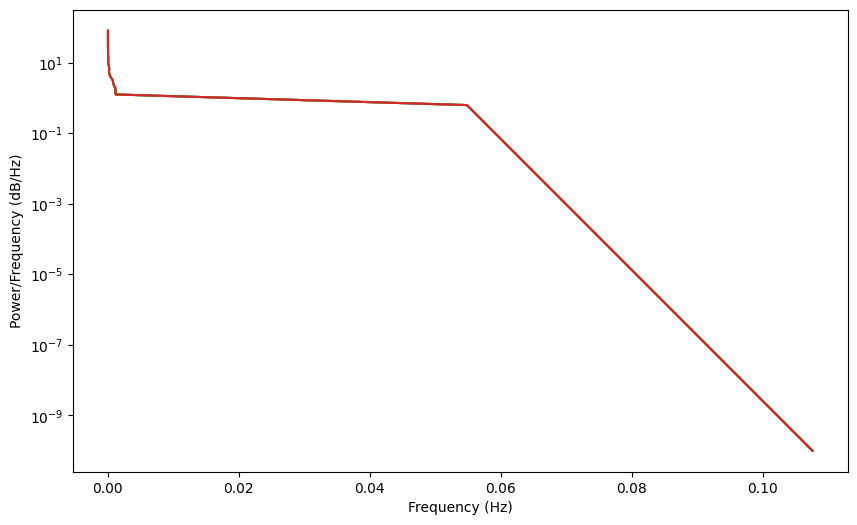

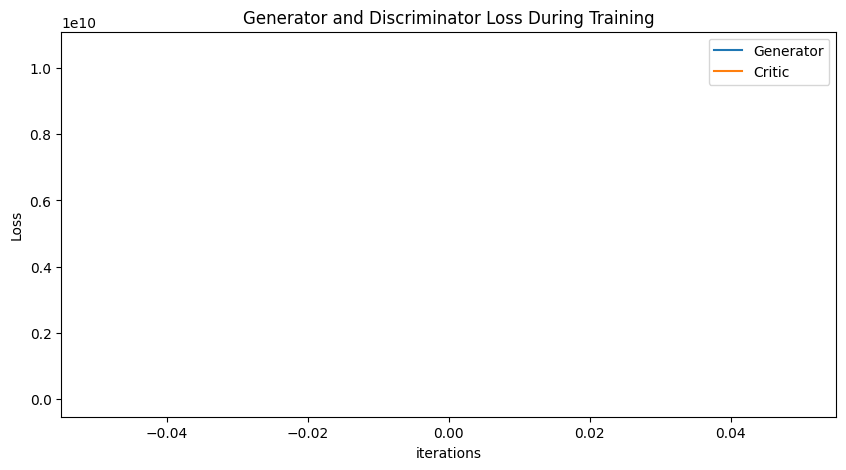

Epoch 10: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883]) Generator err ([-0.7603557705879211, -17.117334365844727, -82.98562622070312, 85.10123443603516, 208.71975708007812, 92.67327117919922, -18.931753158569336, 123.64112854003906, 140.70042419433594, 153.0950927734375, 167.7135009765625])


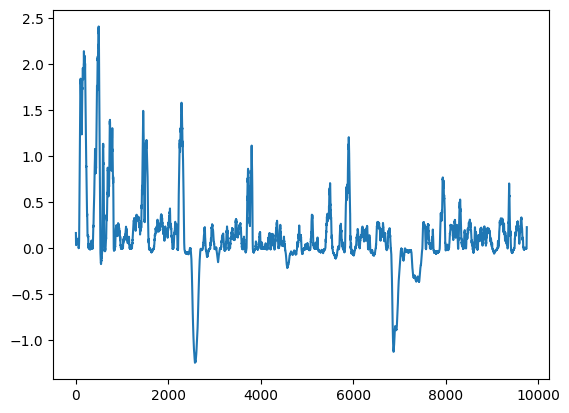

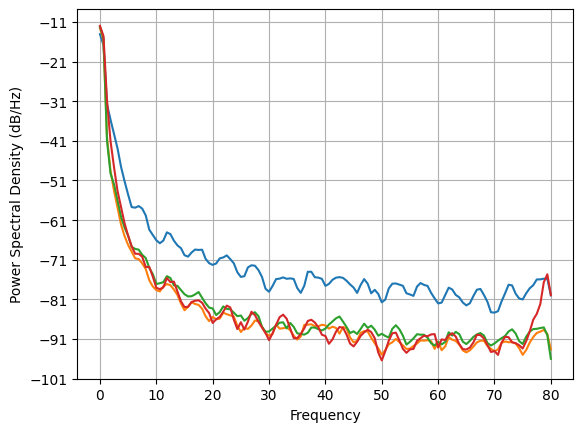

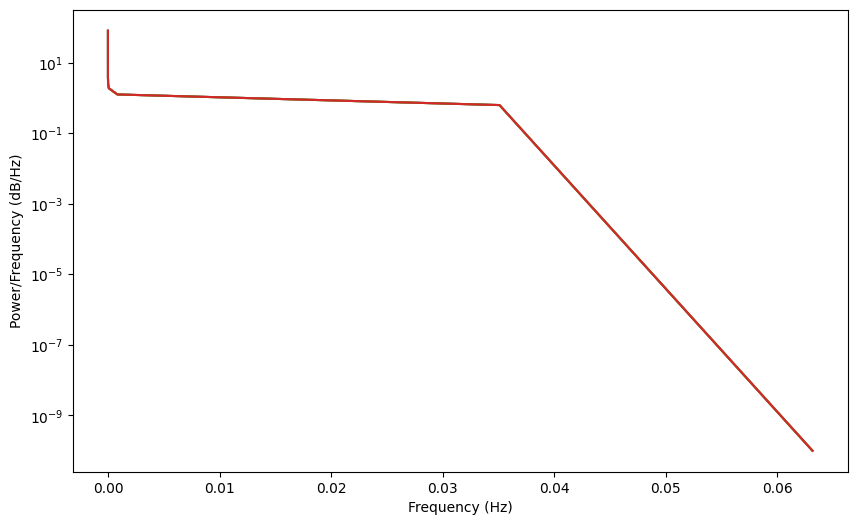

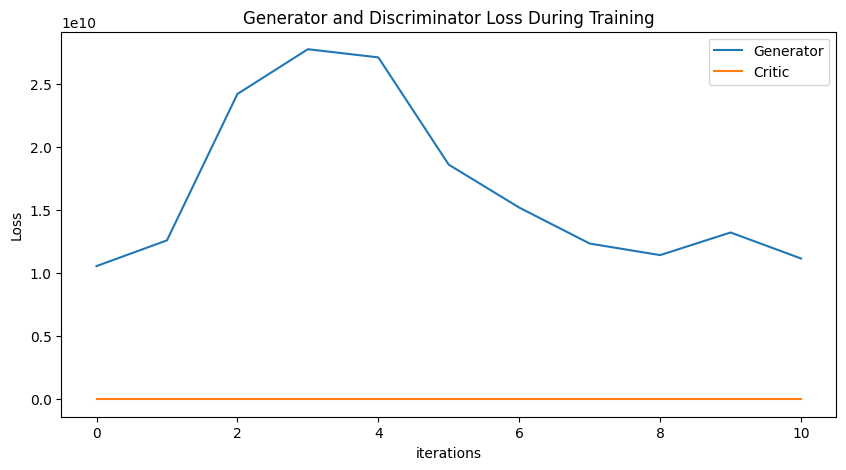

Epoch 20: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787]) Generator err ([-0.7603557705879211, -17.117334365844727, -82.98562622070312, 85.10123443603516, 208.71975708007812, 92.67327117919922, -18.931753158569336, 123.64112854003906, 140.70042419433594, 153.0950927734375, 167.7135009765625, 107.66421508789062, 161.28665161132812, 93.10649871826172, 63.7250862121582, 70.00619506835938, 90.57025146484375, 88.23239135742188, 92.37216186523438, 104.08934783935547, 73.73333740234375])


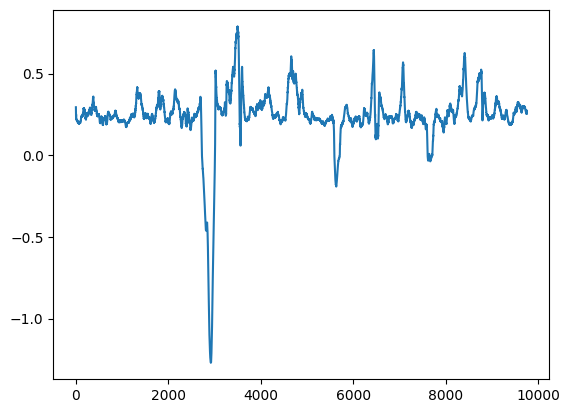

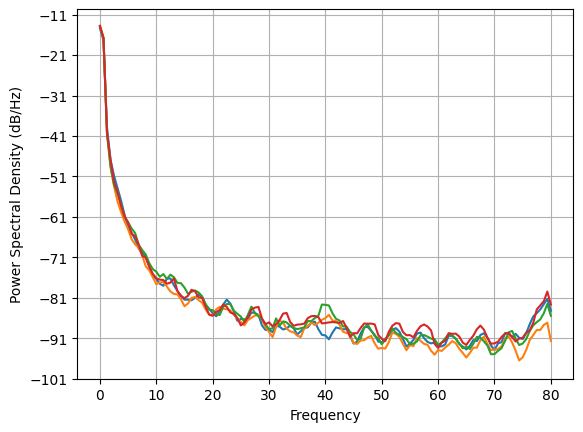

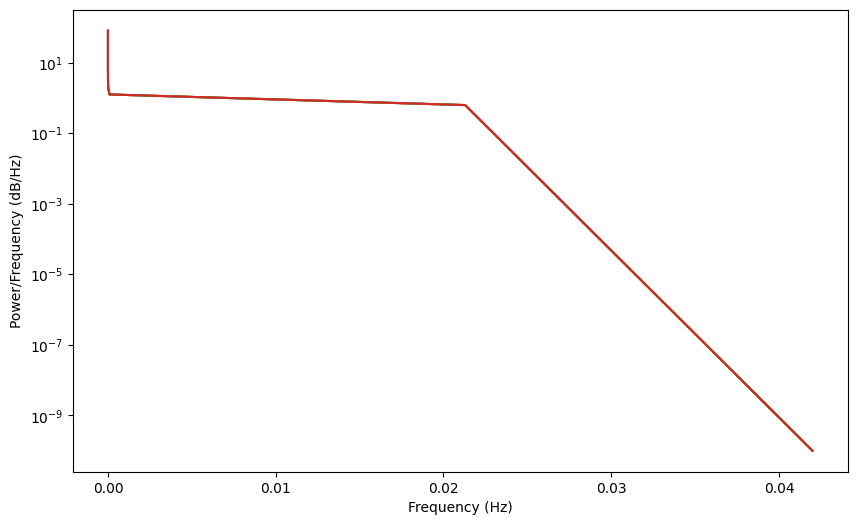

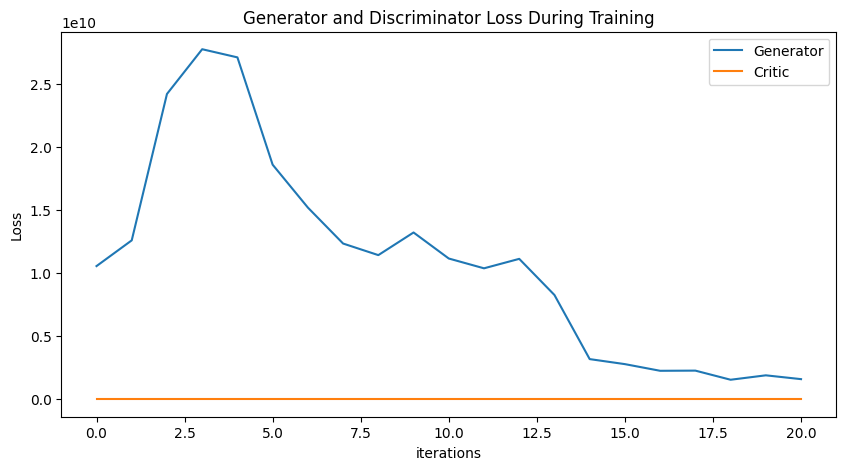

Epoch 30: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038]) Generator err ([-0.7603557705879211, -17.117334365844727, -82.98562622070312, 85.10123443603516, 208.71975708007812, 92.67327117919922, -18.931753158569336, 123.64112854003906, 140.70042419433594, 153.0950927734375, 167.7135009765625, 107.66421508789062, 161.28665161132812, 93.10649871826172, 63.7250862121582, 70.00619506835938, 90.57025146484375, 88.23239135742188,

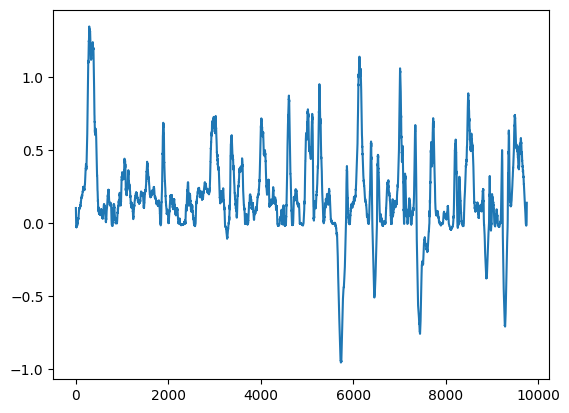

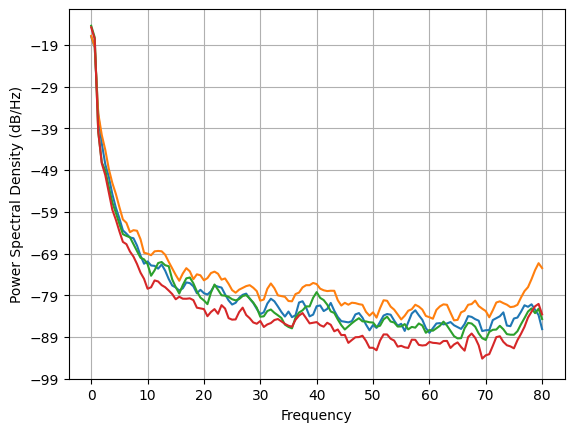

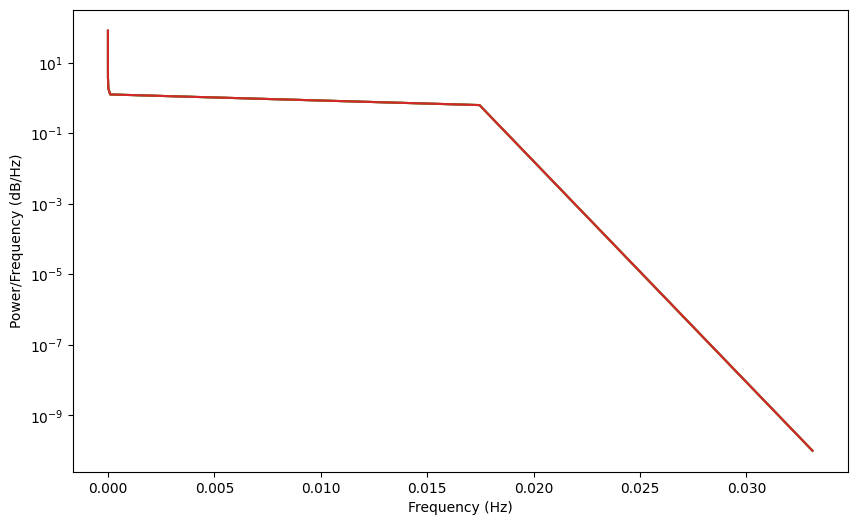

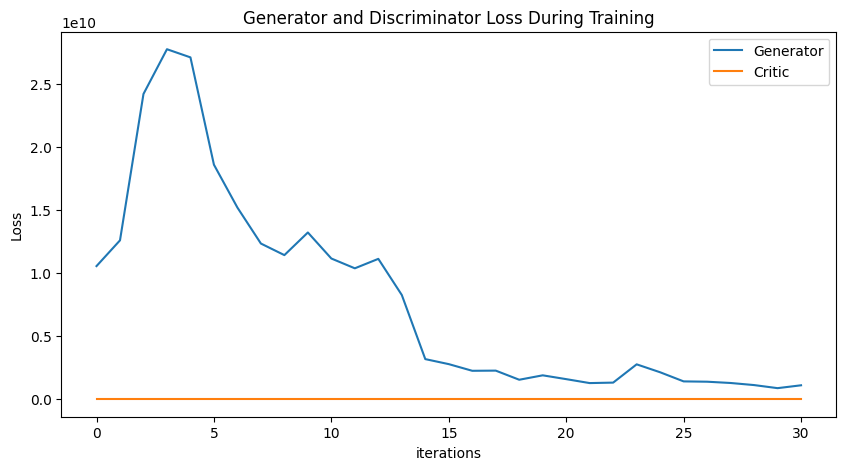

Epoch 40: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742]) Generator err ([-0.7603557705879211, -17.117334365844727, -82.98562622070312, 85.10123443603516, 208.71975708007812, 92.67327117919922, -18.931753158569336, 123.64112854003906

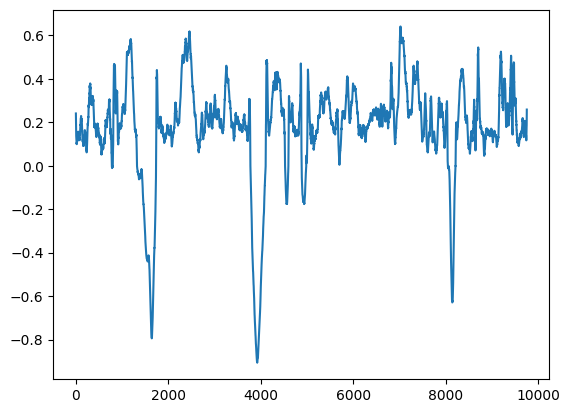

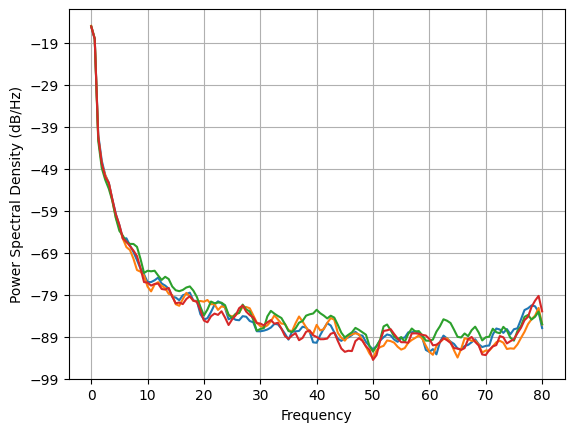

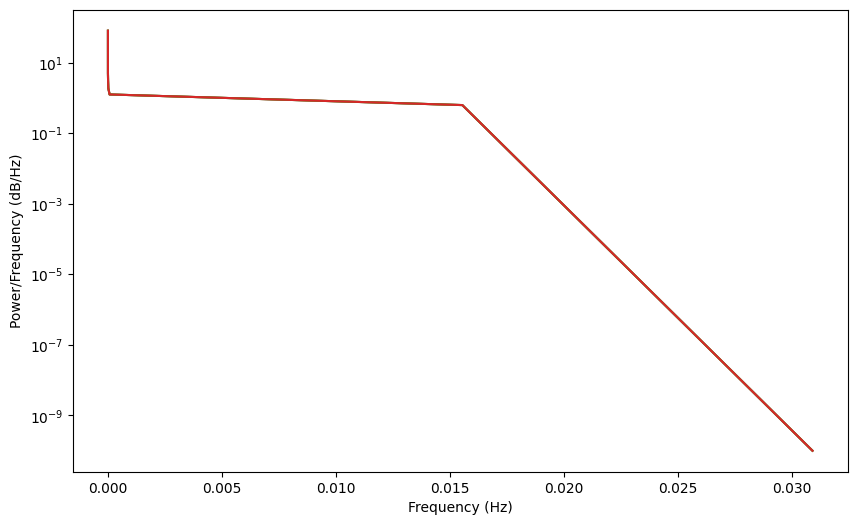

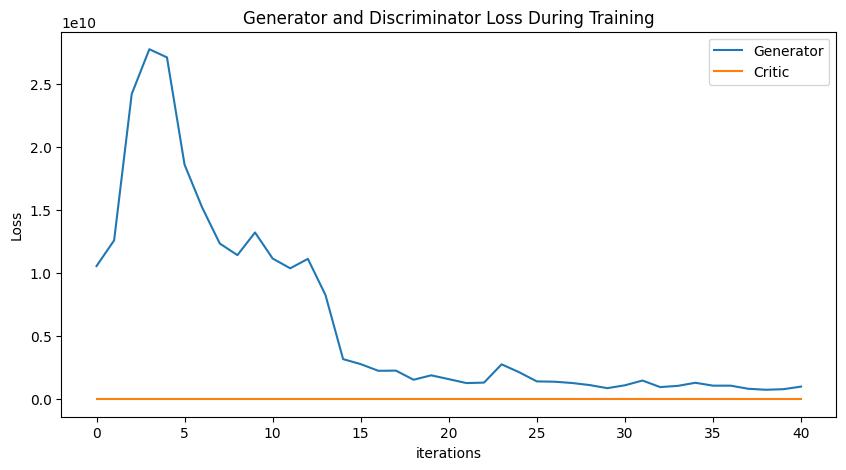

Epoch 50: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 52

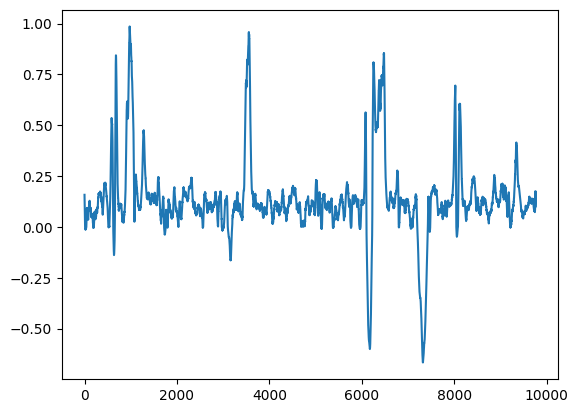

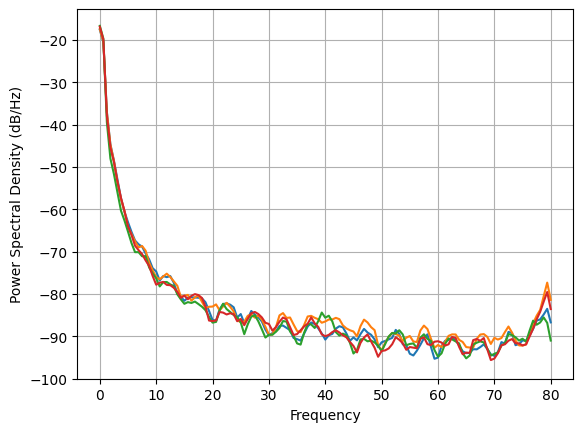

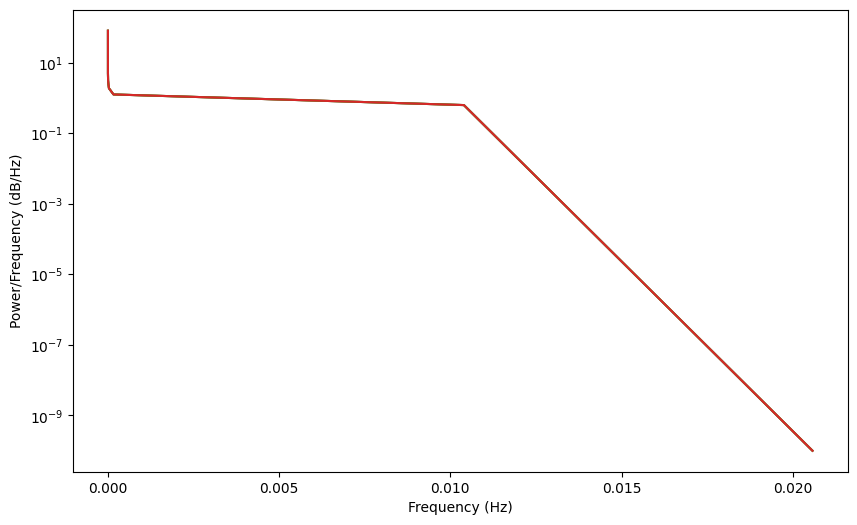

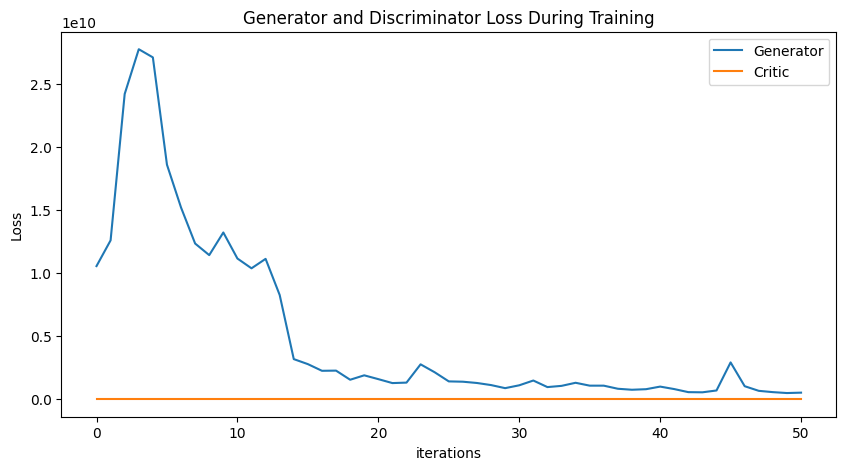

Epoch 60: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 52

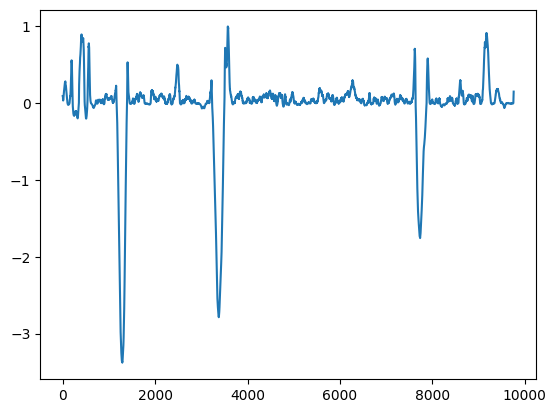

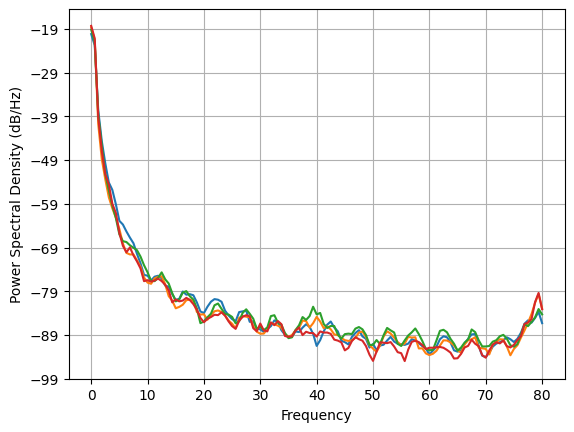

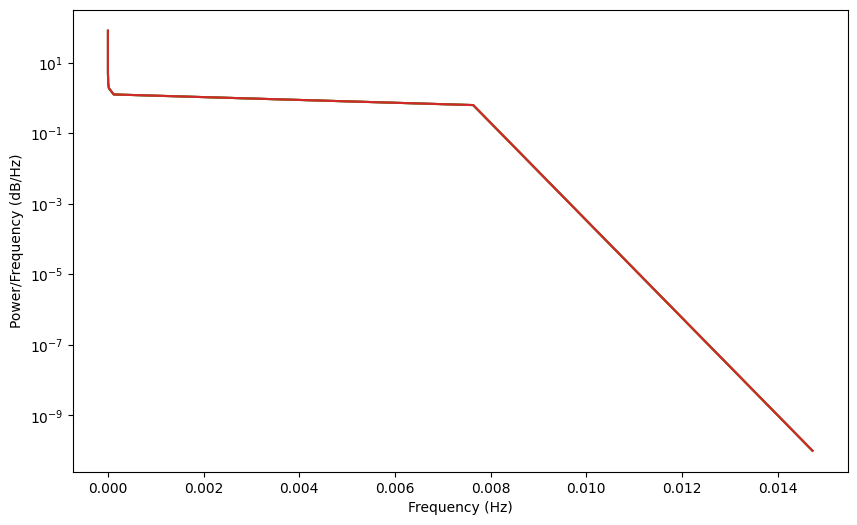

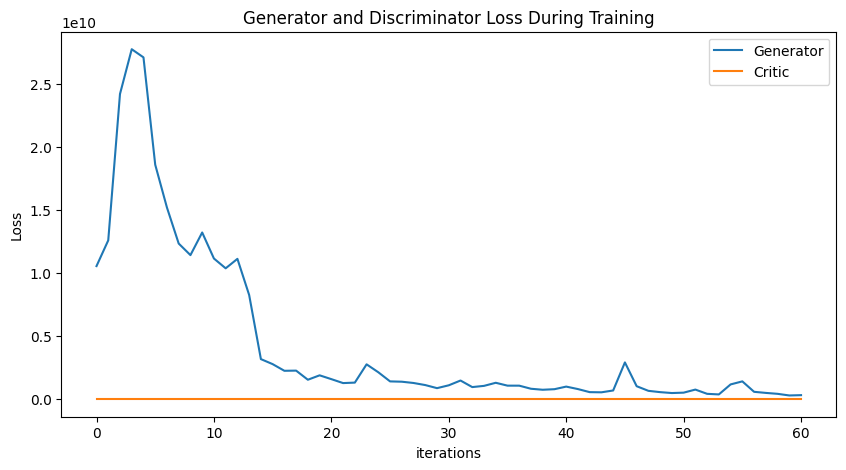

Epoch 70: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 52

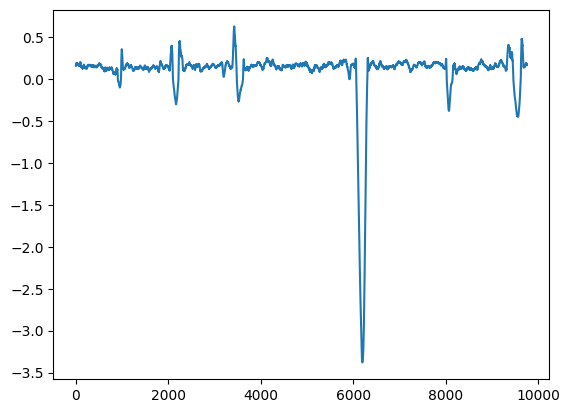

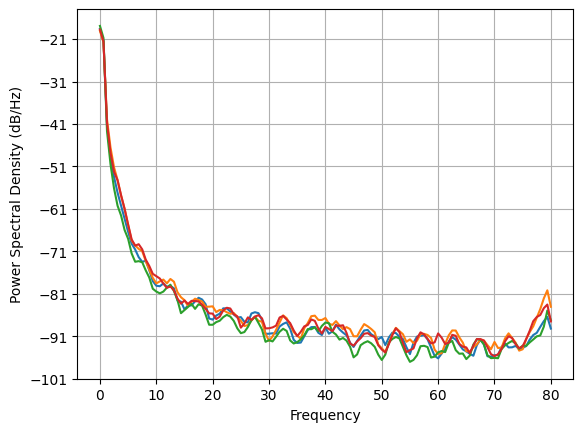

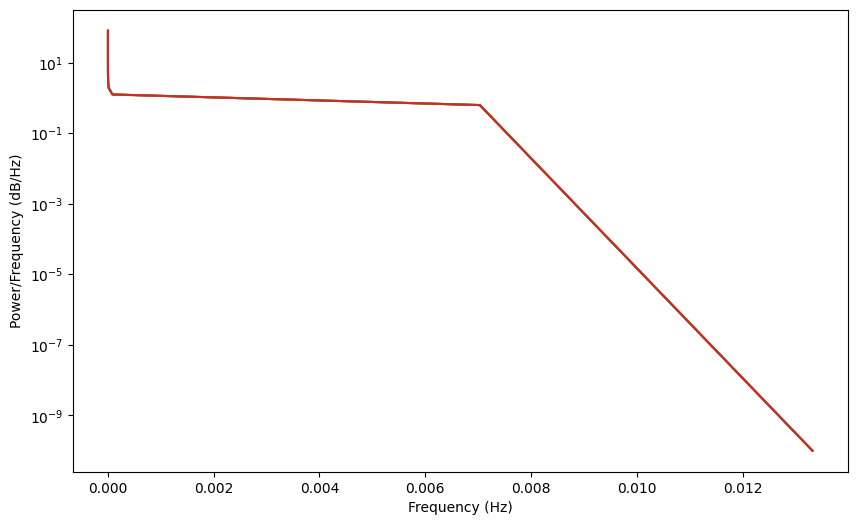

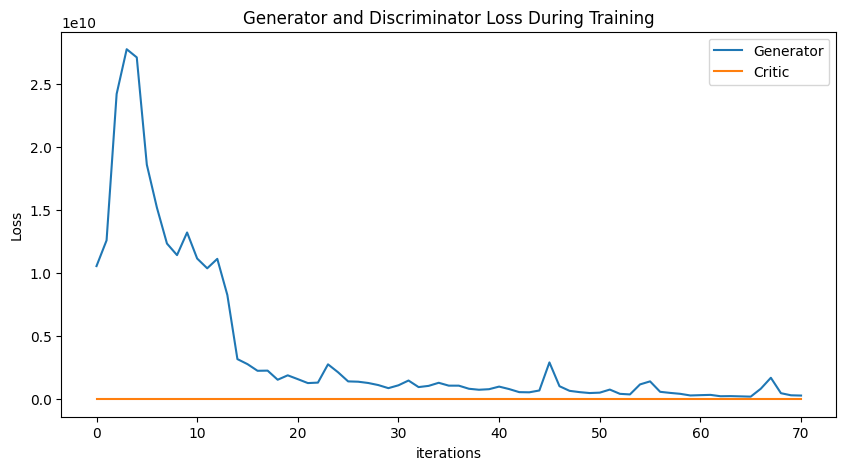

Epoch 80: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 52

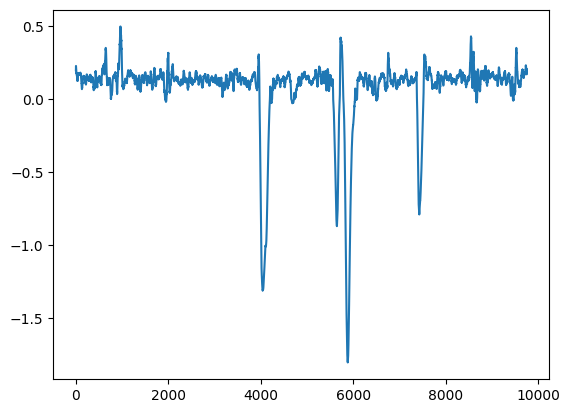

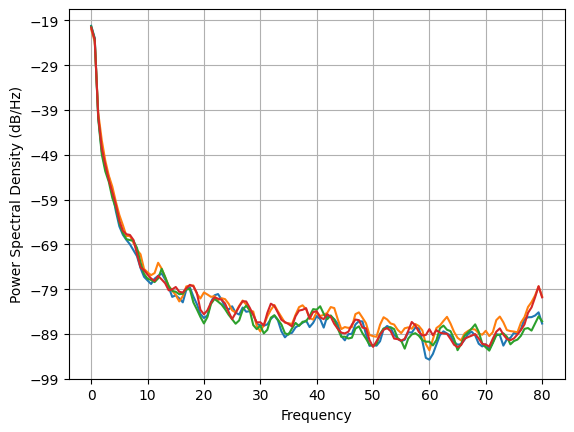

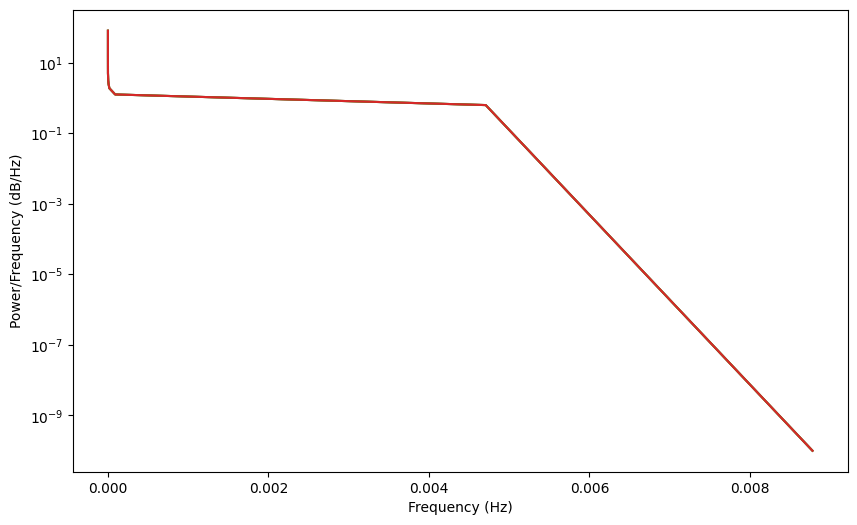

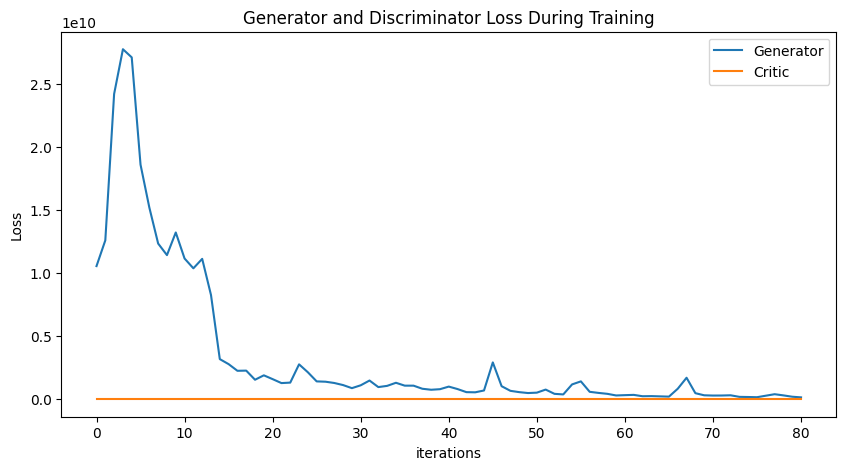

Epoch 90: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 52

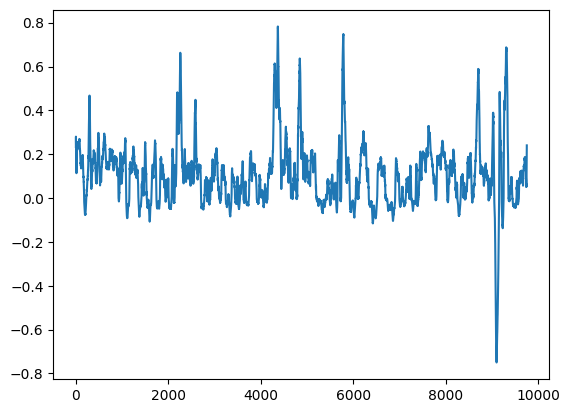

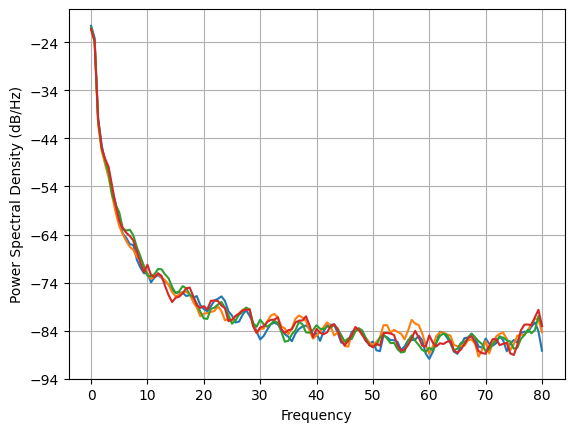

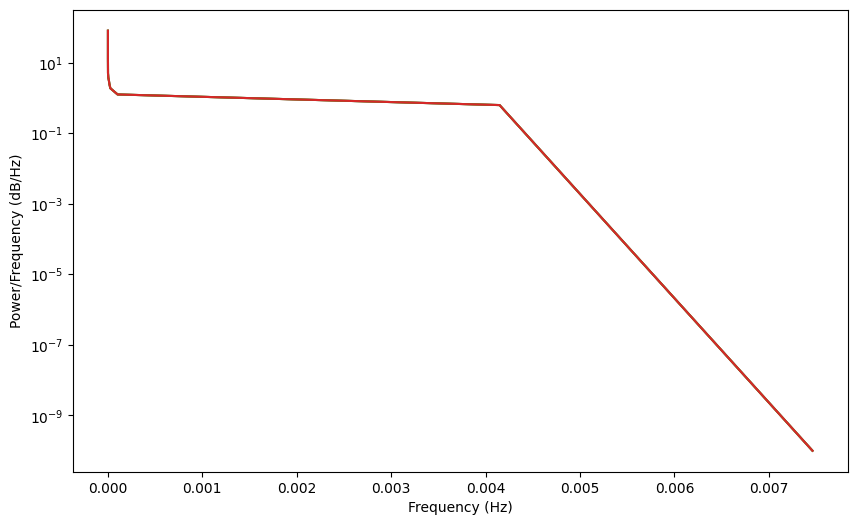

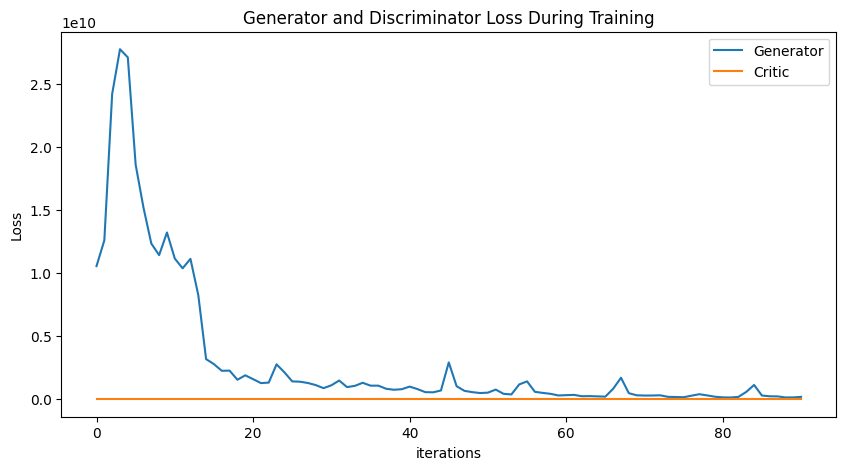

Epoch 100: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

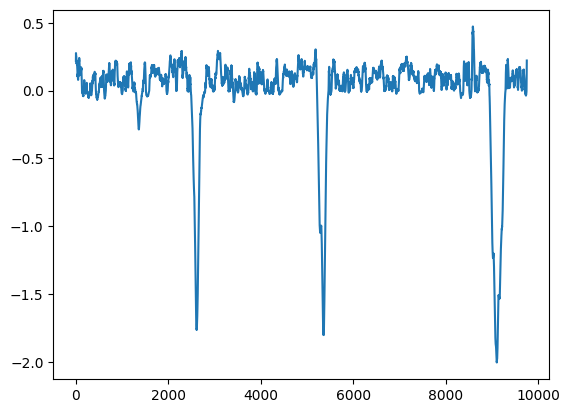

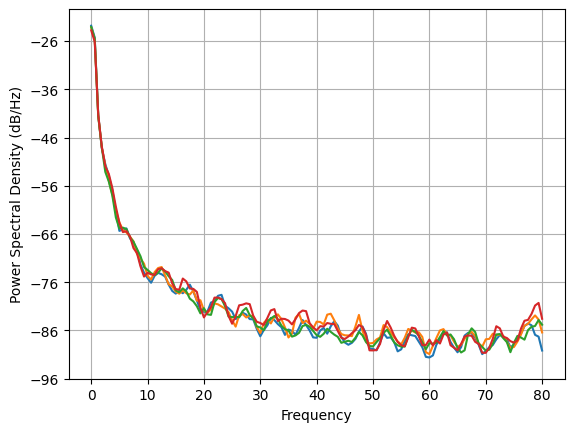

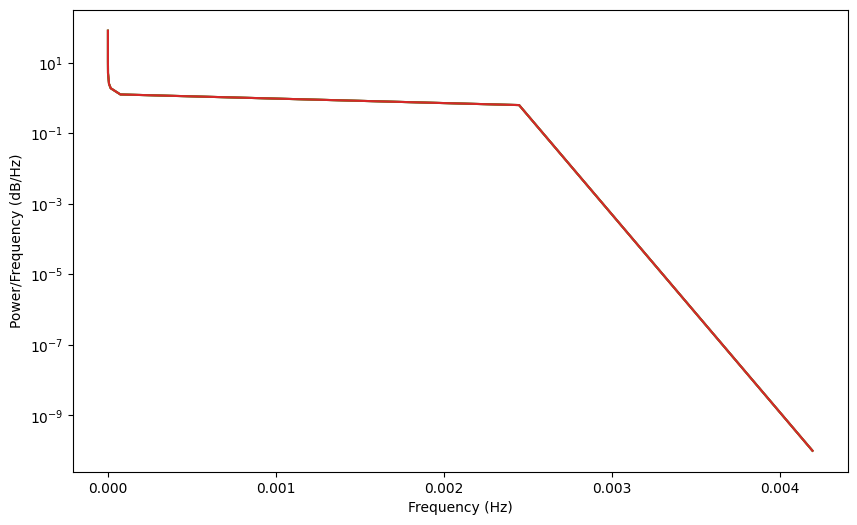

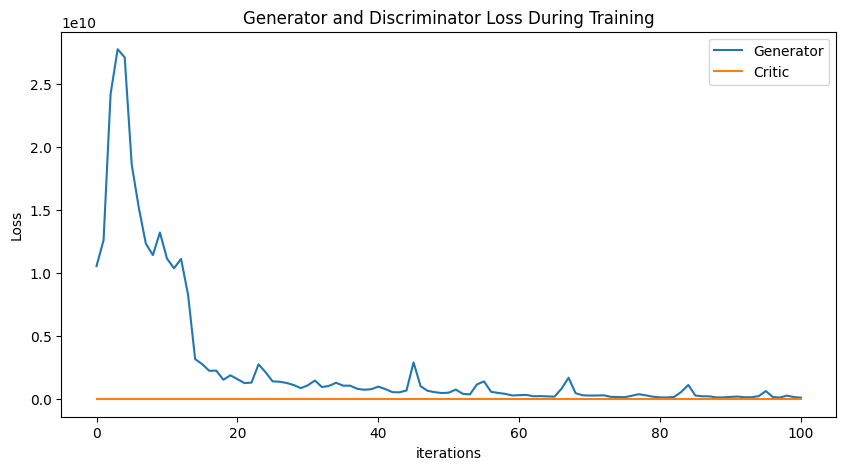

Epoch 110: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

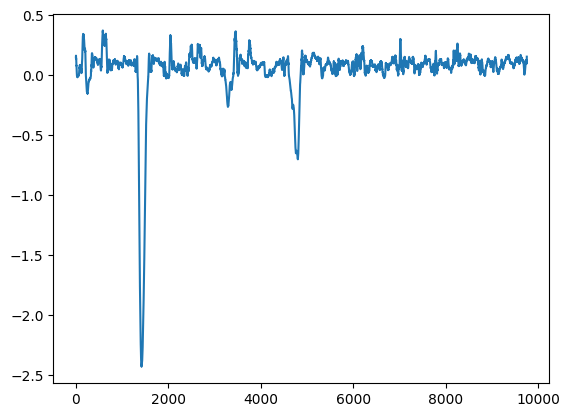

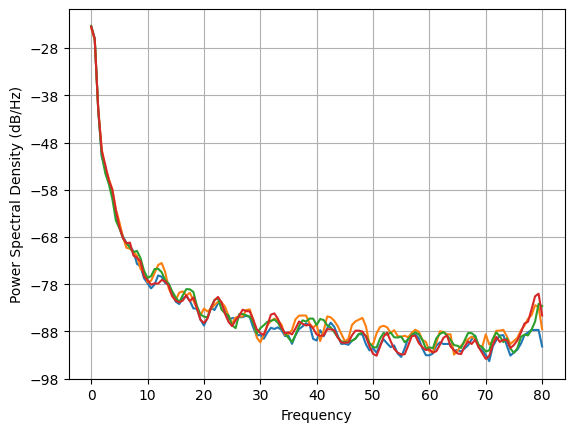

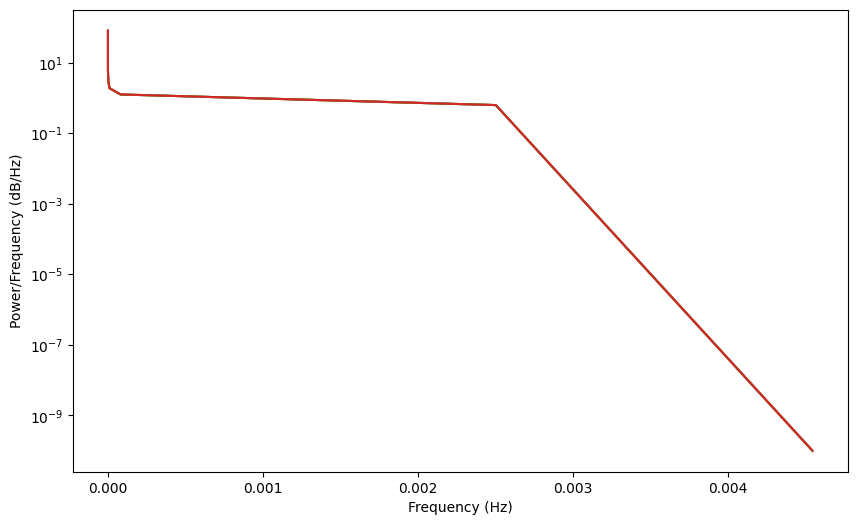

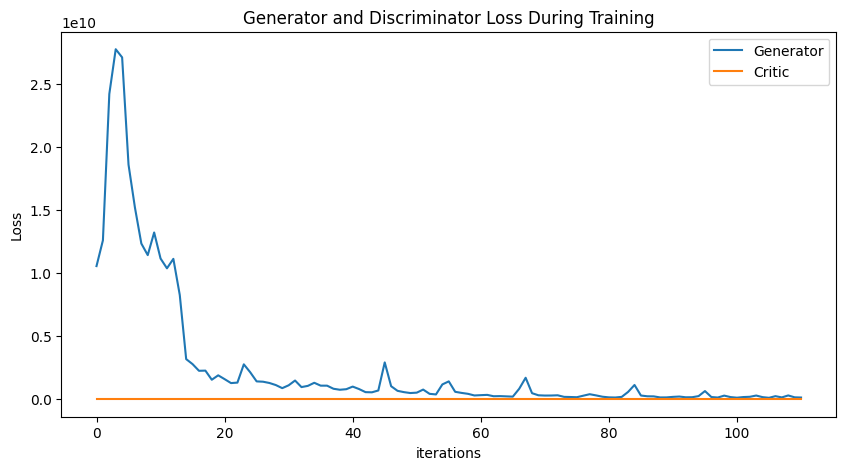

Epoch 120: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

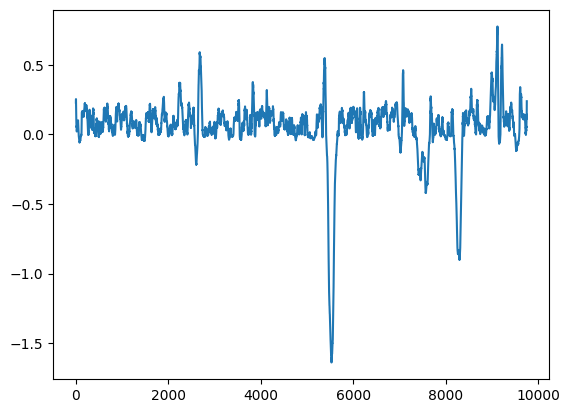

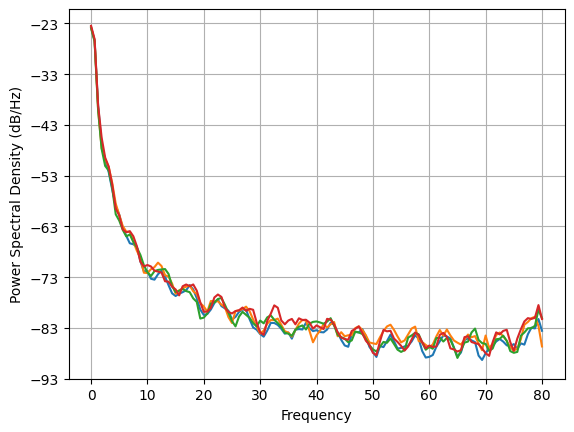

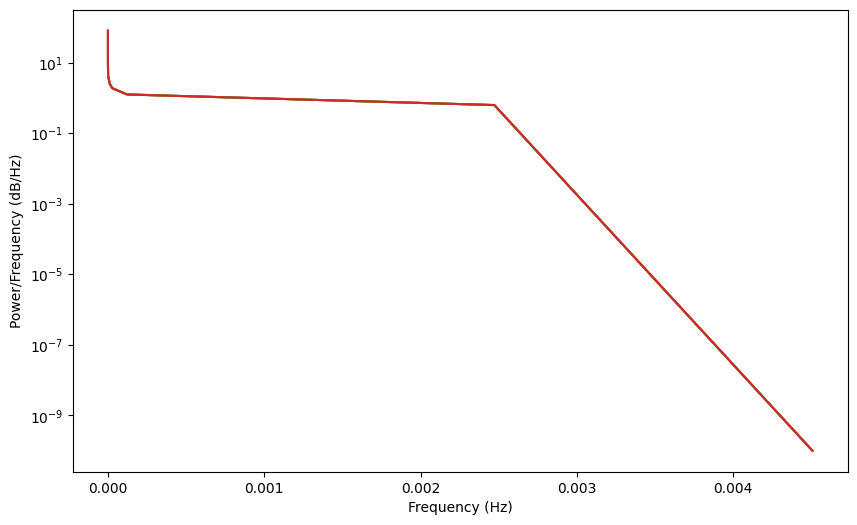

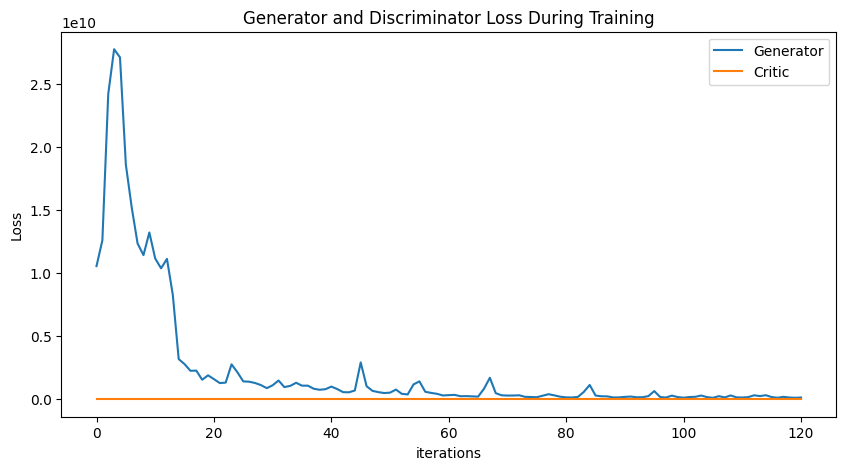

Epoch 130: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

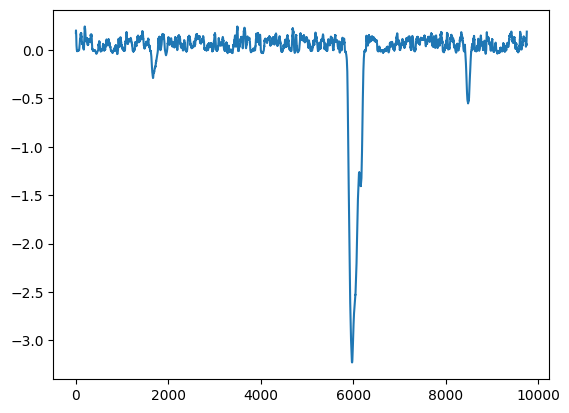

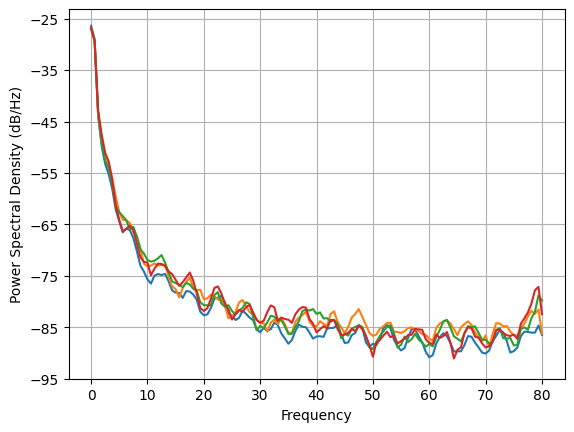

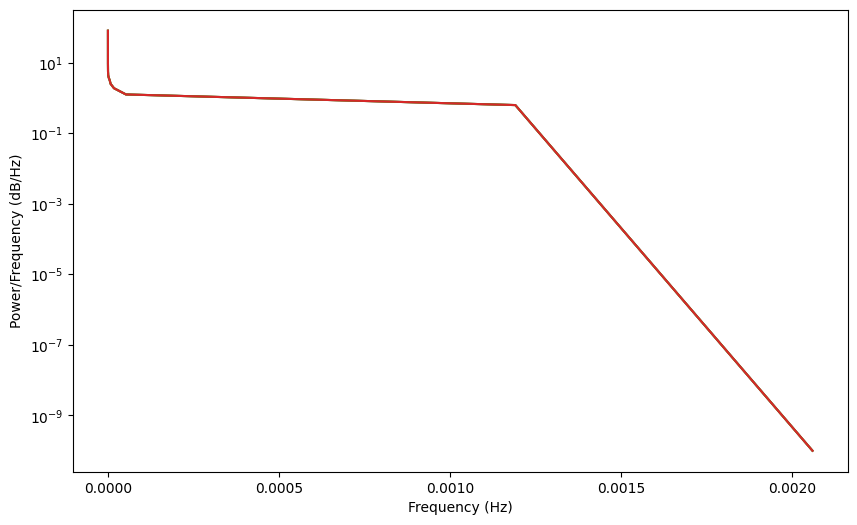

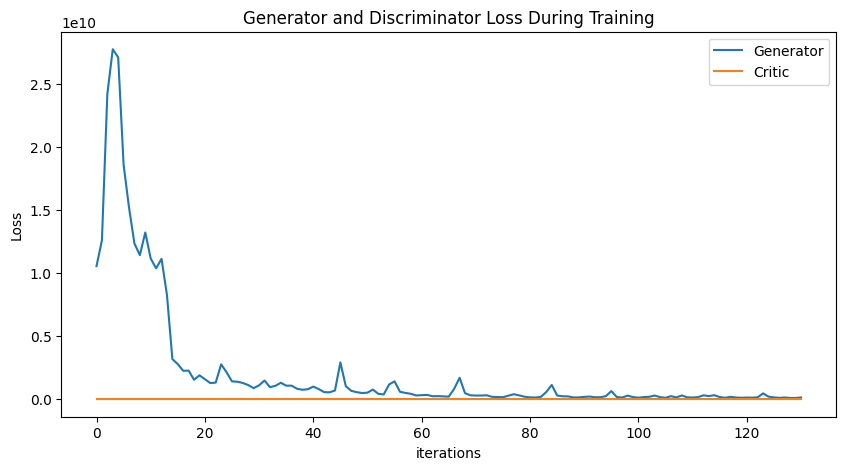

Epoch 140: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

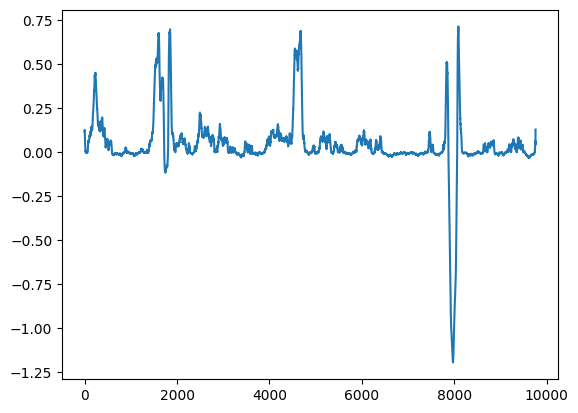

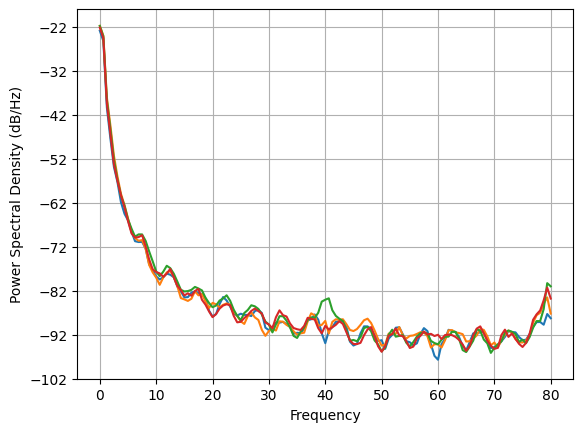

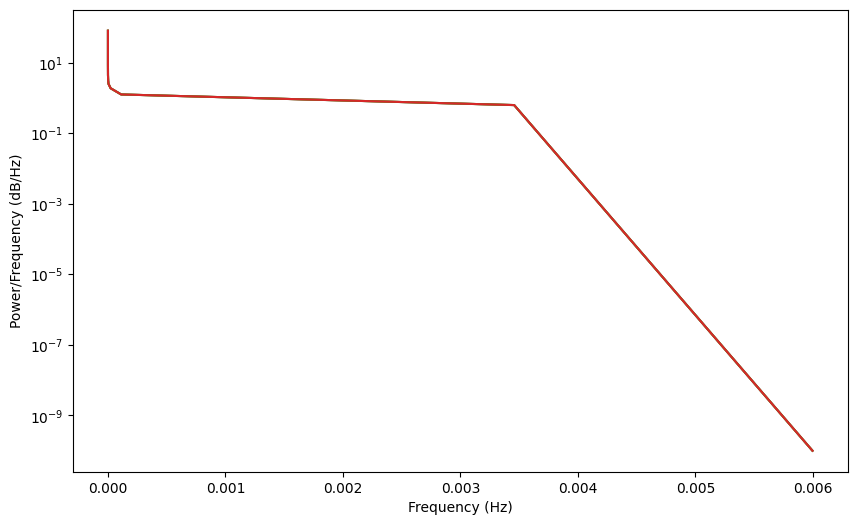

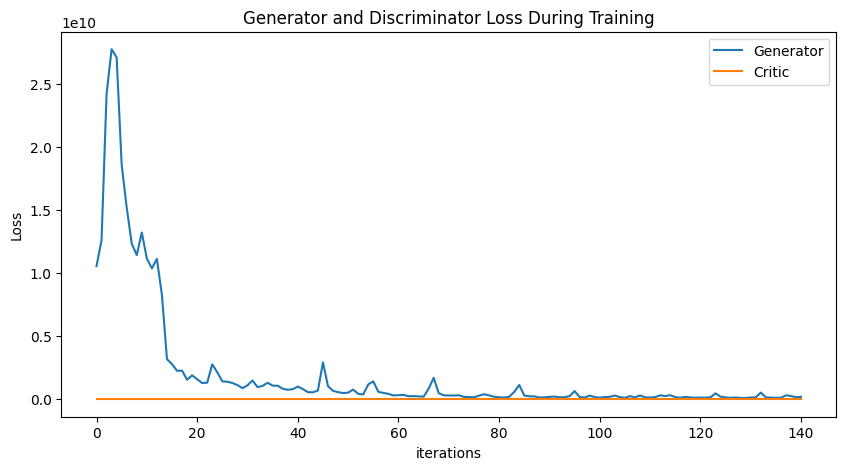

Epoch 150: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

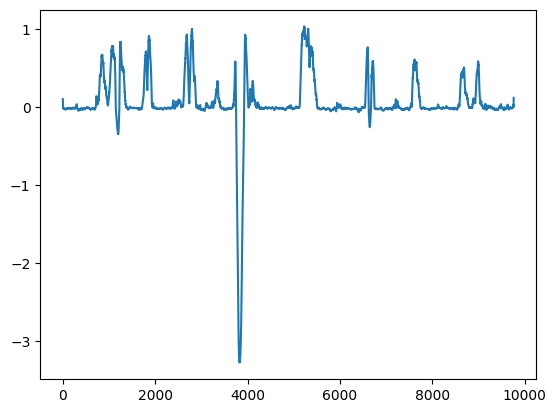

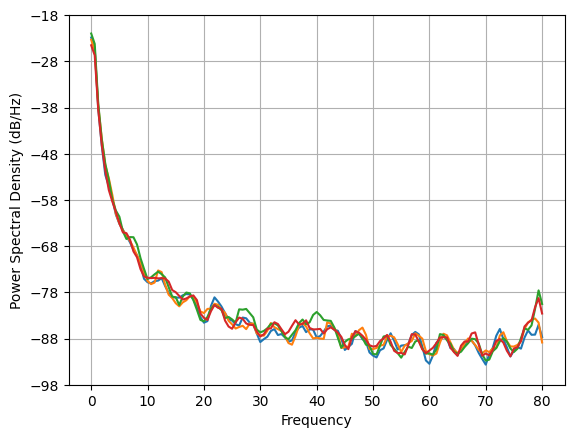

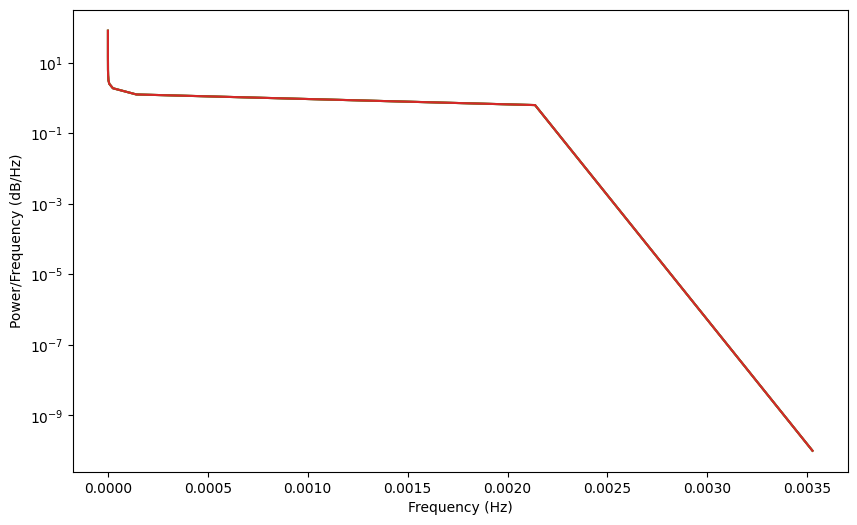

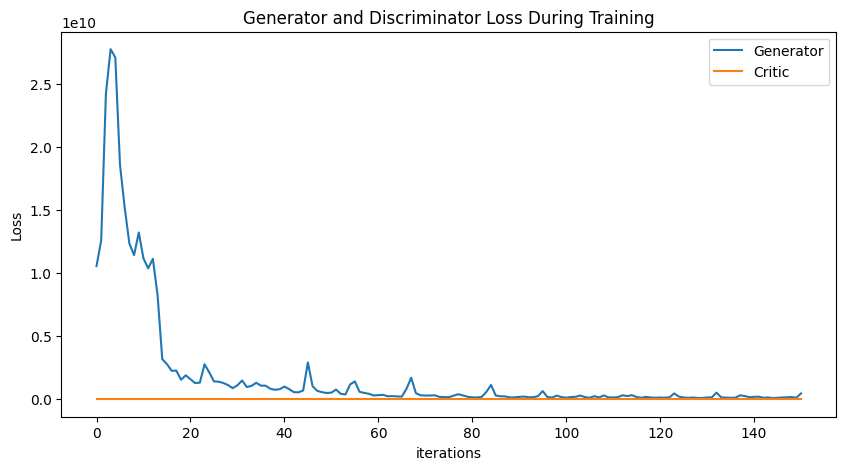

Epoch 160: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

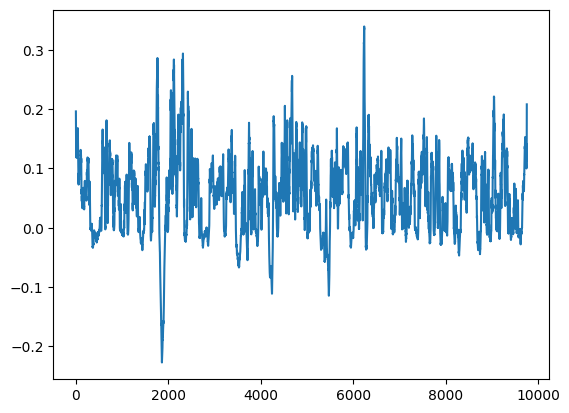

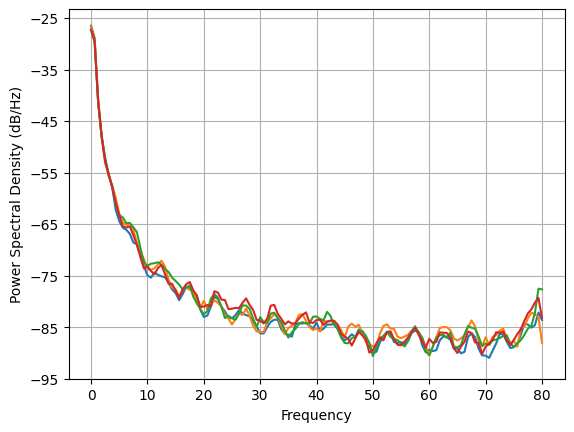

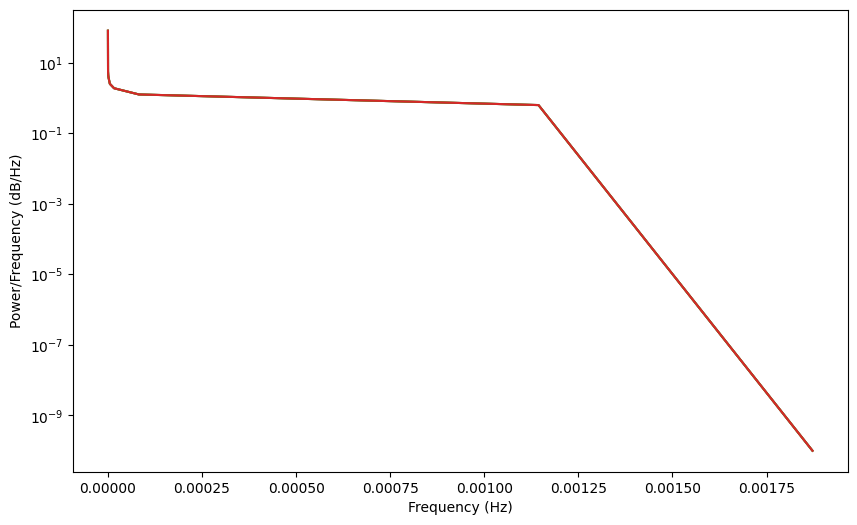

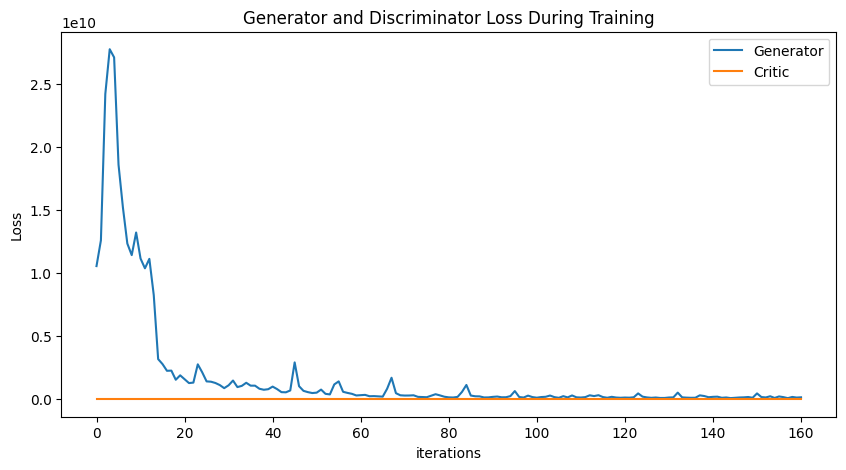

Epoch 170: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

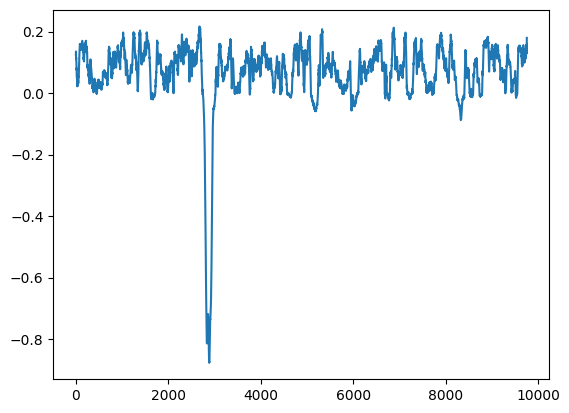

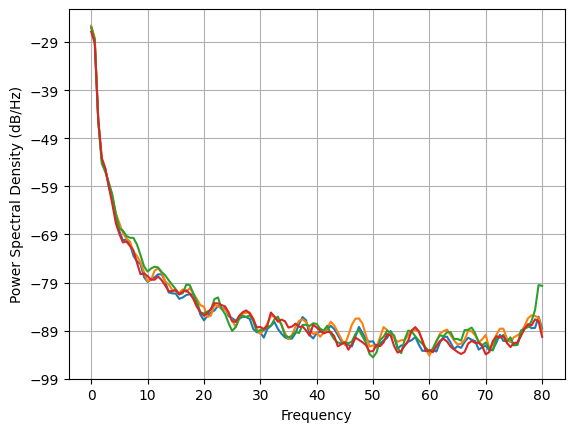

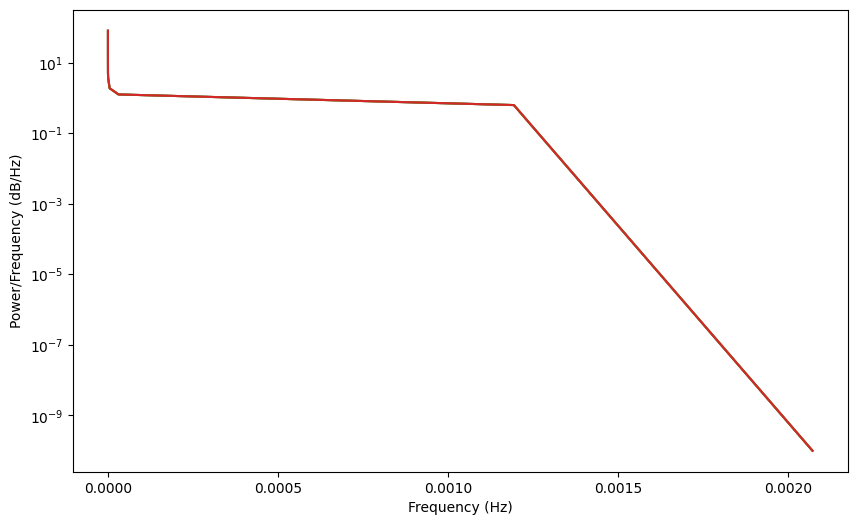

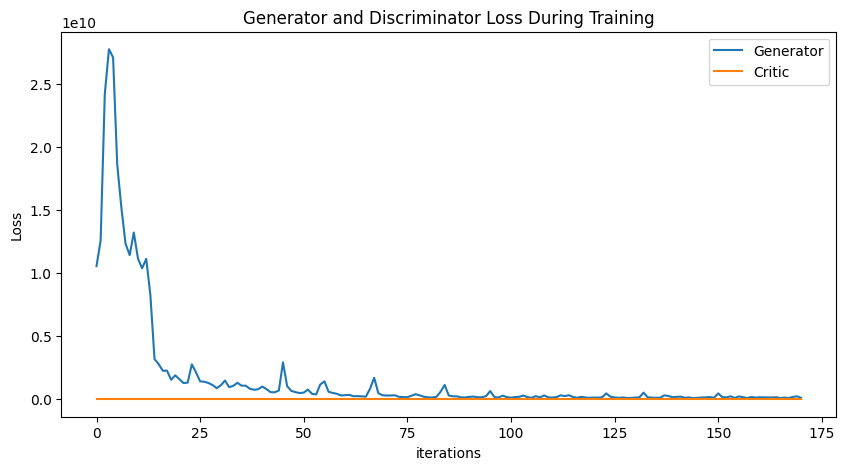

Epoch 180: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

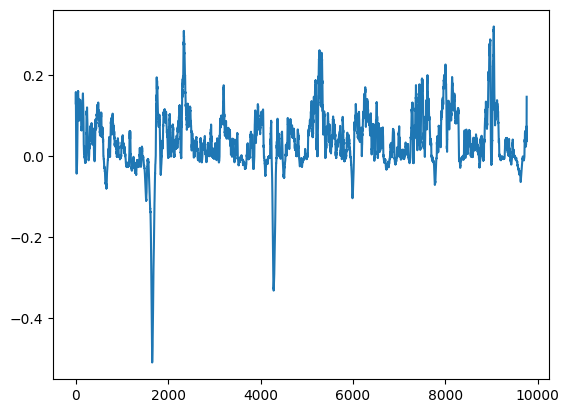

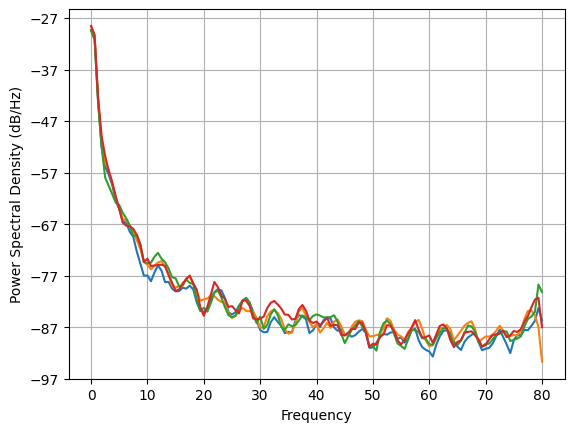

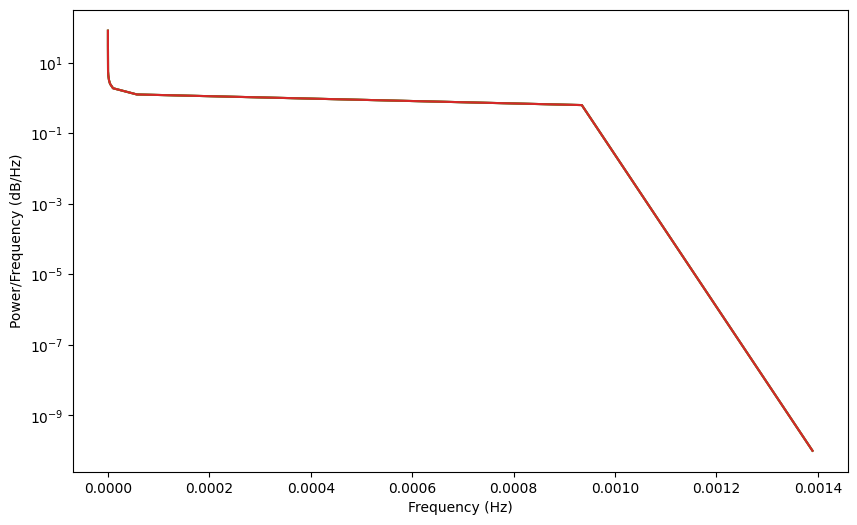

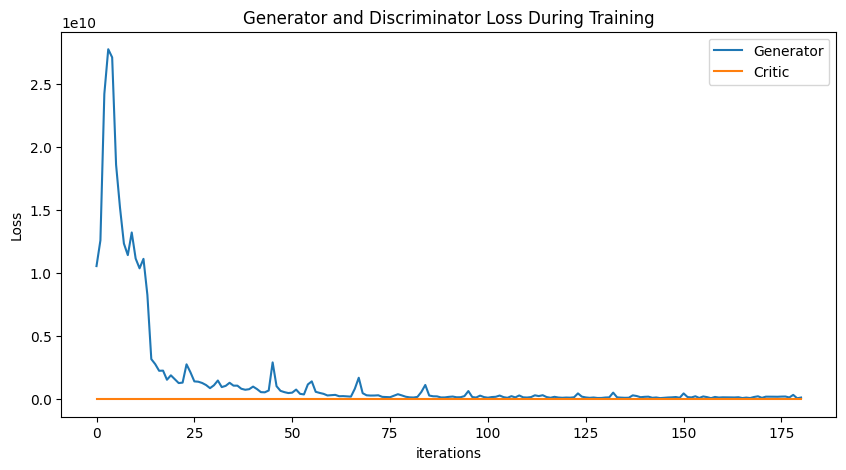

Epoch 190: Critic error ([10564305937.648941, 12606944958.33802, 24222591293.209103, 27774114126.606827, 27126736511.8926, 18611588604.05181, 15208340399.019918, 12353962303.781307, 11435342214.010141, 13231428895.828346, 11165704277.267883, 10388289156.578968, 11138913878.012499, 8270026104.889866, 3183276115.075173, 2784675566.9809146, 2256013321.4808416, 2269547226.118494, 1545710350.827309, 1896375780.0203907, 1593600652.2885787, 1280822125.0054371, 1318232819.9155915, 2768344660.63698, 2138730811.665571, 1415004331.439836, 1389822094.9145453, 1288192743.810575, 1122836831.7211018, 878404478.5009758, 1105127231.0495038, 1483778194.5590868, 963019699.1524658, 1059581922.4639521, 1304828093.9982412, 1077016974.127225, 1076115594.1549435, 830352238.088123, 751671722.9880369, 795575581.075651, 1001774906.8065742, 805230804.2097625, 561846782.4027677, 548235087.3470279, 693992661.7259419, 2921094141.2914095, 1032959368.7154156, 665392456.0285842, 562202414.7001715, 490557944.85791695, 5

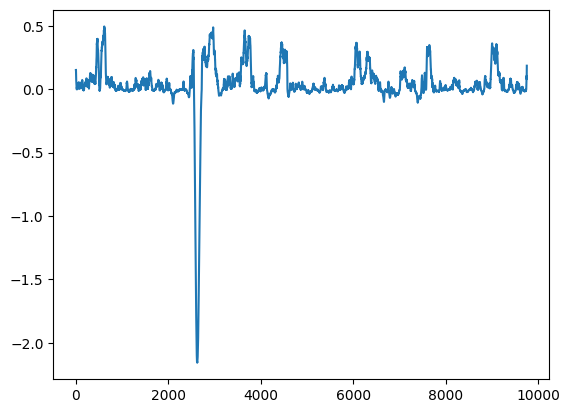

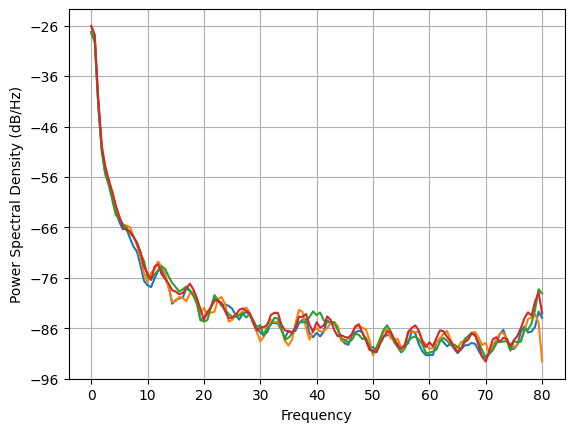

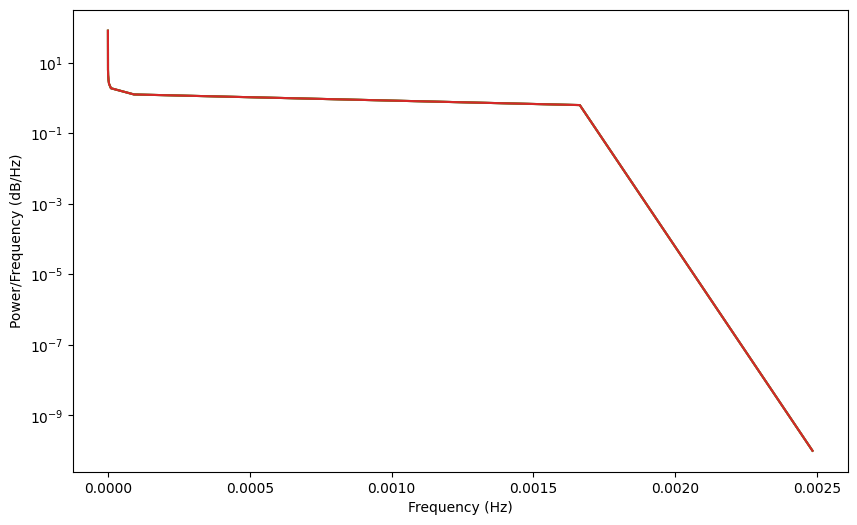

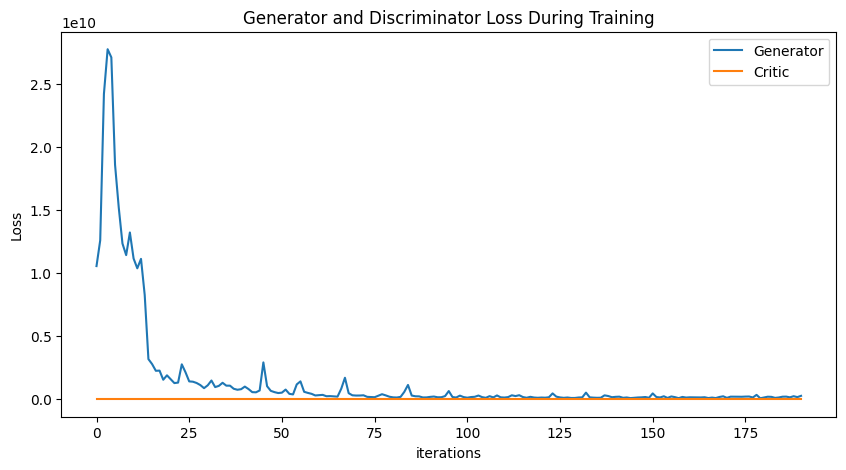

KeyboardInterrupt: 

In [20]:
SPECTRAL_LOSS_FACTOR = 0.001
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)

def spectral_loss(real_data, fake_data):
    fft_real = torch.fft.fft(real_data)
    fft_fake = torch.fft.fft(fake_data)
    magnitude_real = torch.sqrt(fft_real.real**2 + fft_real.imag**2)
    magnitude_fake = torch.sqrt(fft_fake.real**2 + fft_fake.imag**2)
    magnitude_real = normalize(magnitude_real, dim=0)
    magnitude_fake = normalize(magnitude_fake, dim=0)
    return F.mse_loss(magnitude_real, magnitude_fake)

def power_spectrum(x):
    fft_result = torch.fft.fft(x)
    return torch.abs(fft_result)**2

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))
            real.requires_grad=True
            psd_real = power_spectrum(real)

            noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
            fake = G(noise)
            psd_fake = power_spectrum(fake)

            # Calculate loss based on the difference in the power spectrums
            psd_diff = torch.mean((psd_real - psd_fake)**2)

            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            loss_critic_real = -torch.mean(critic_real)
            loss_critic_fake = torch.mean(critic_fake)

            gp = gradient_penalty(D, real, fake) * LAMBDA_GP
            D.zero_grad()
            # Add the PSD difference to the loss function
            loss_critic = loss_critic_real + loss_critic_fake + gp + psd_diff
            loss_critic.backward()
            critic_optimizer.step()
        
        noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
        fake = G(noise)
        gen_fake = D(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        G.zero_grad()
        loss_gen.backward()
        gen_optimizer.step()

        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-5.pt')
torch.save(disc, 'discriminator-v11-5.pt')
np.save('closed-v11-5.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# only use spectral loss

Epoch 0: Critic error ([10488921800.043007]) Generator err ([10596333683.74835])


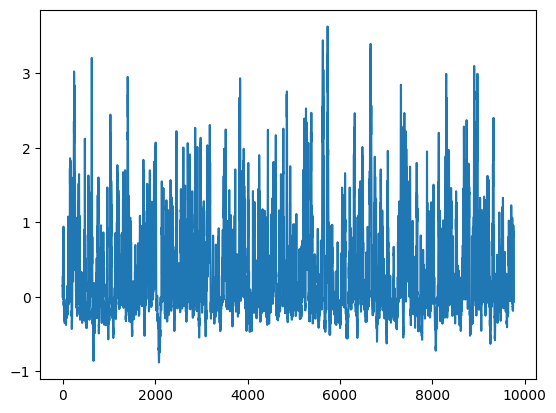

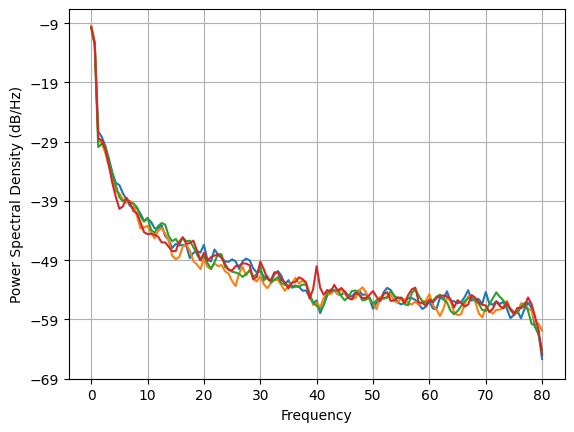

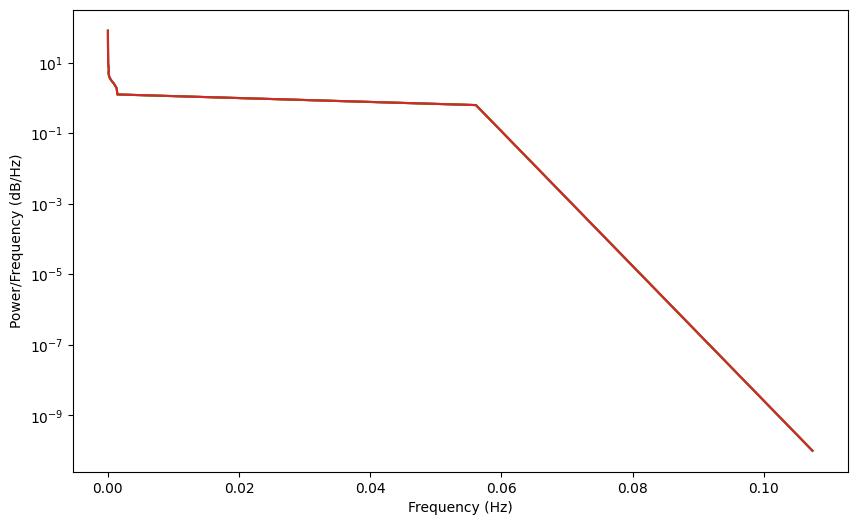

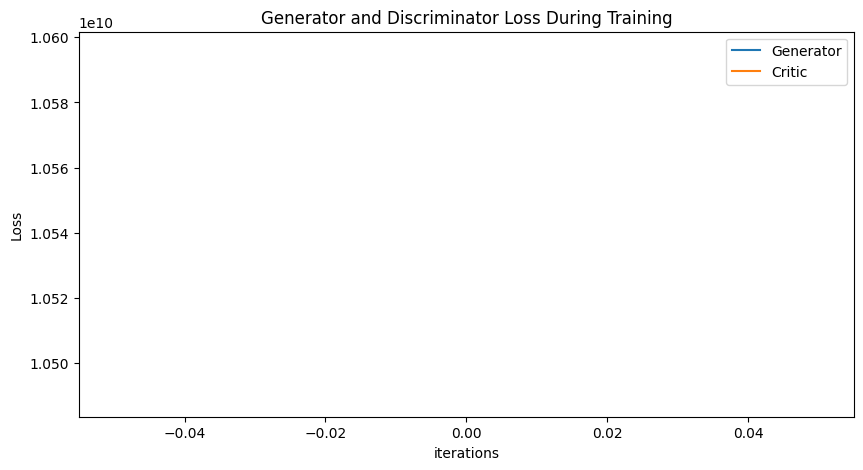

Epoch 10: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124]) Generator err ([10596333683.74835, 10556663779.794565, 8475659184.707619, 6006931756.093, 6885963043.120182, 4420751339.43902, 5693863225.646779, 3374882160.4641023, 2893895620.528967, 2602282939.2944555, 3596494211.7706537])


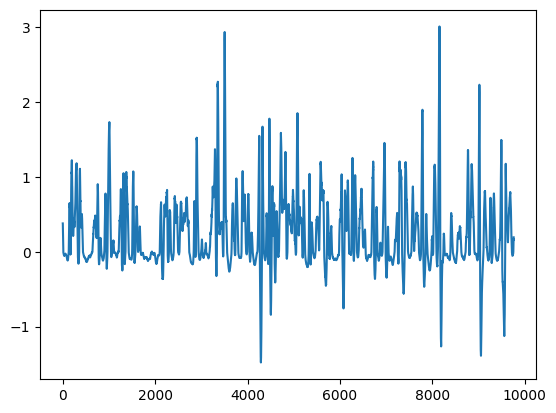

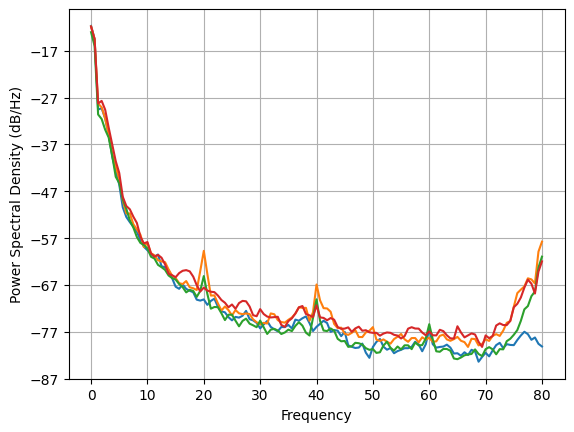

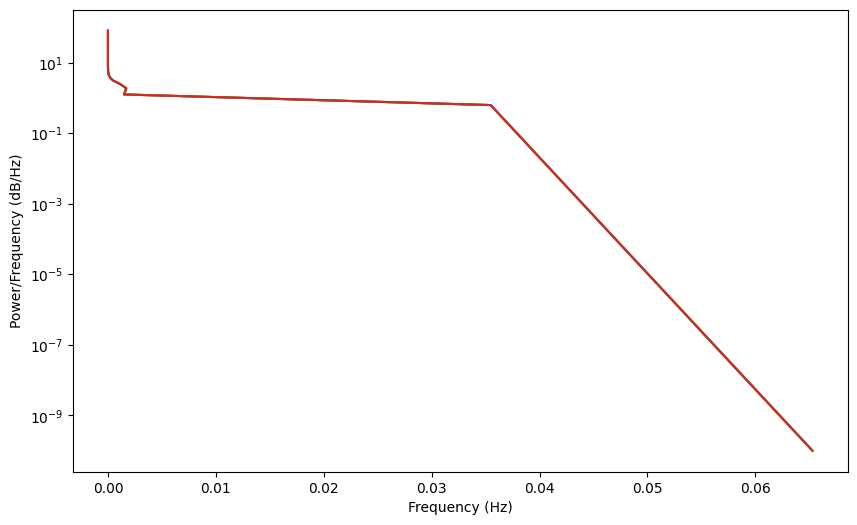

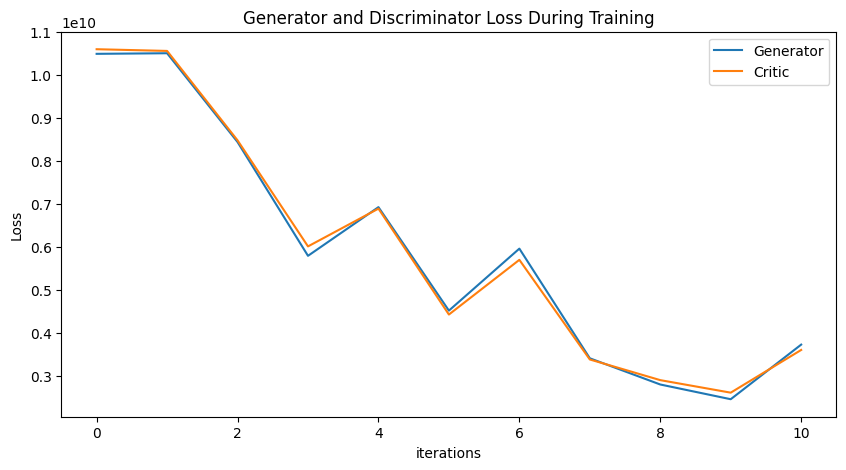

Epoch 20: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474]) Generator err ([10596333683.74835, 10556663779.794565, 8475659184.707619, 6006931756.093, 6885963043.120182, 4420751339.43902, 5693863225.646779, 3374882160.4641023, 2893895620.528967, 2602282939.2944555, 3596494211.7706537, 2956608941.9680185, 2515718907.31802, 2229090734.0624576, 1666020273.8764763, 1547058016.5028105, 1384296458.4703195, 1799568393.709045, 2023907300.8886254, 1684437874.1780205, 1396806109.3394308])


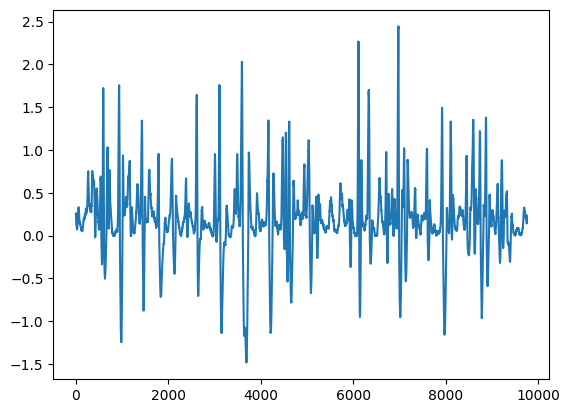

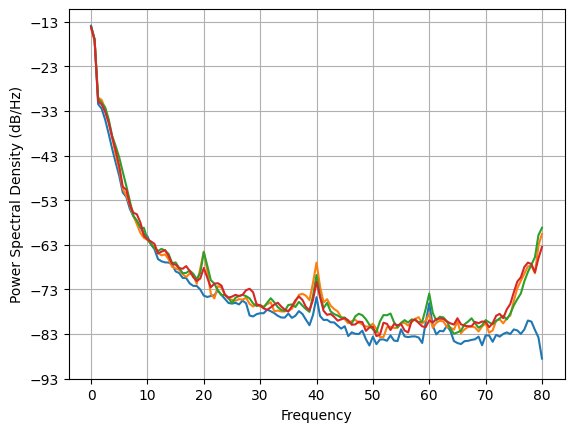

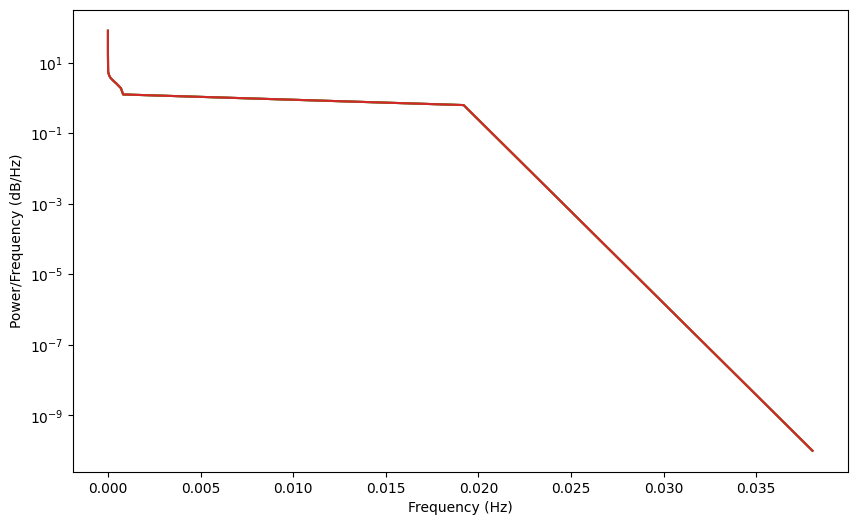

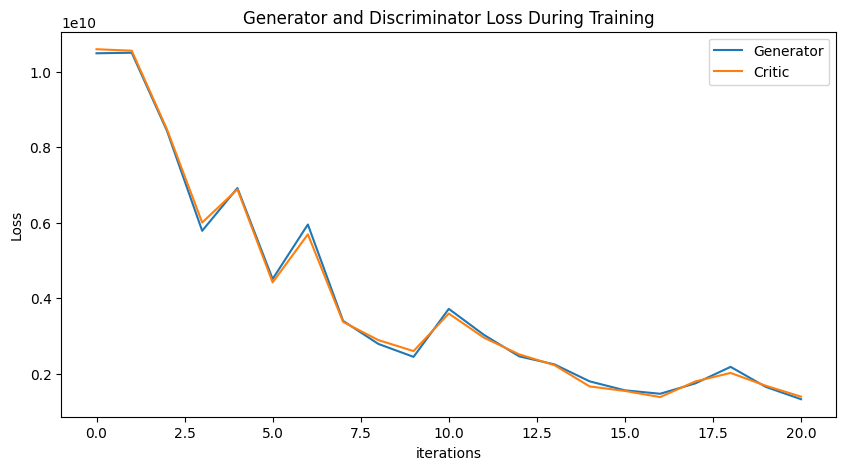

Epoch 30: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349]) Generator err ([10596333683.74835, 10556663779.794565, 8475659184.707619, 6006931756.093, 6885963043.120182, 4420751339.43902, 5693863225.646779, 3374882160.4641023, 2893895620.528967, 2602282939.2944555, 3596494211.7706537, 2956608941.9680185, 2515718907.31802, 2229090734.0624576, 1666020273.8764763, 1547058016.5028105, 1384296458.4703195, 1799568393.709045, 202

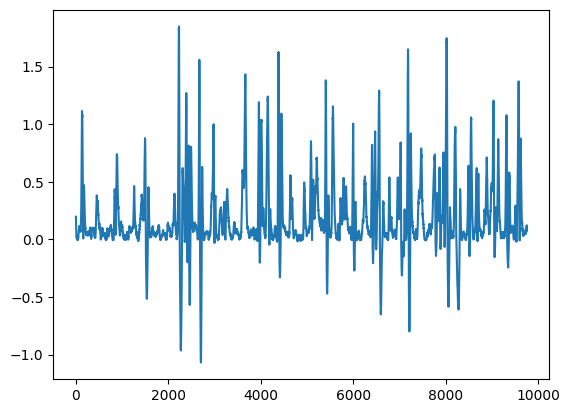

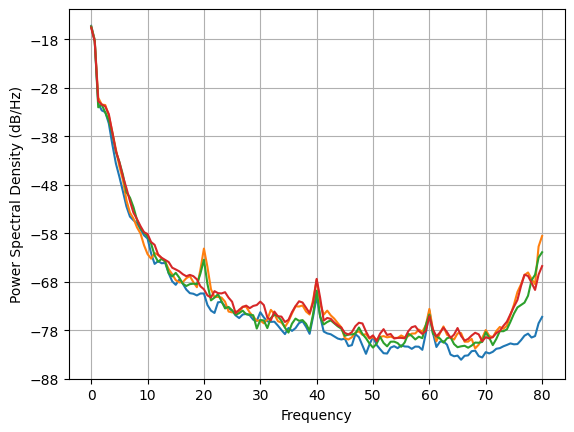

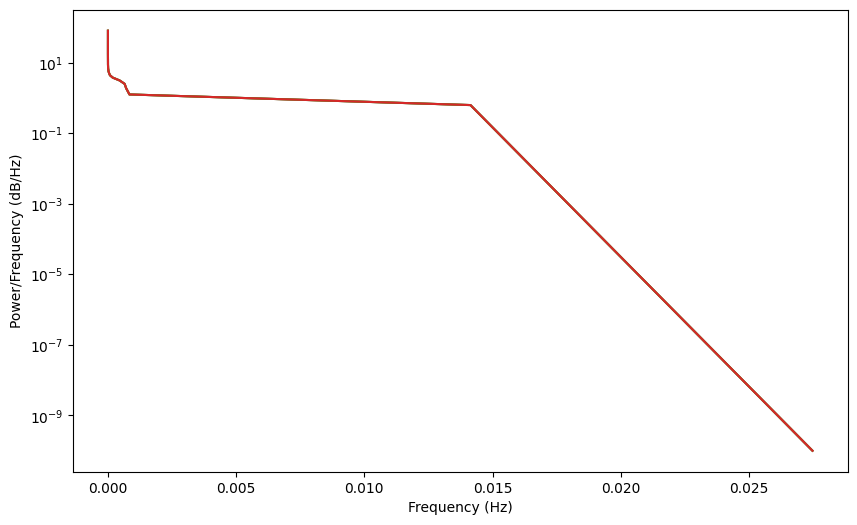

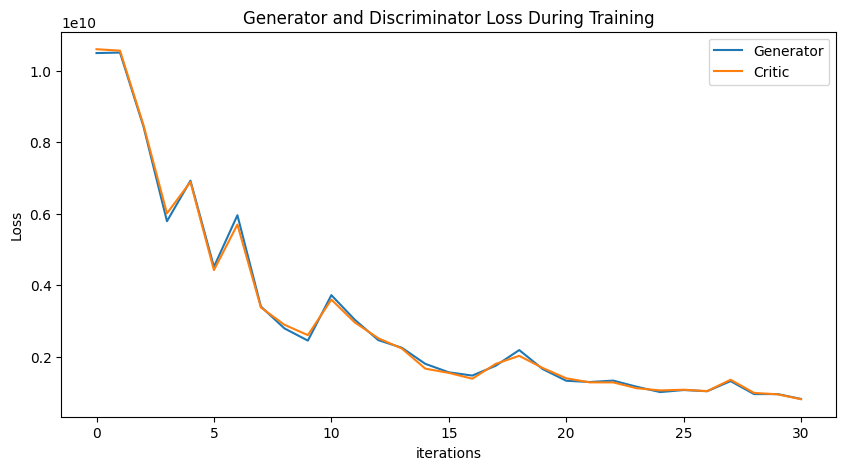

Epoch 40: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605]) Generator err ([10596333683.74835, 10556663779.794565, 8475659184.707619, 6006931756.093, 6885963043.120182, 4420751339.43902, 5693863225.646779, 3374882160.4641023, 289389562

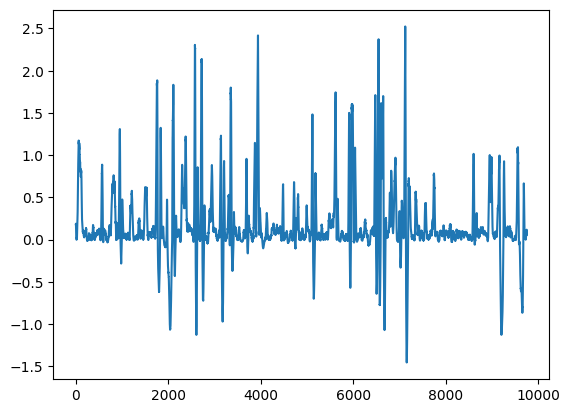

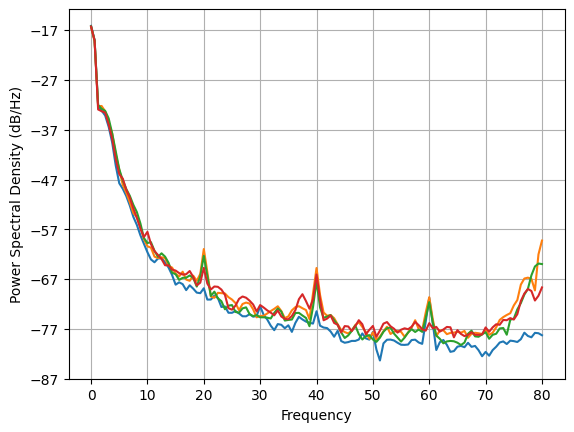

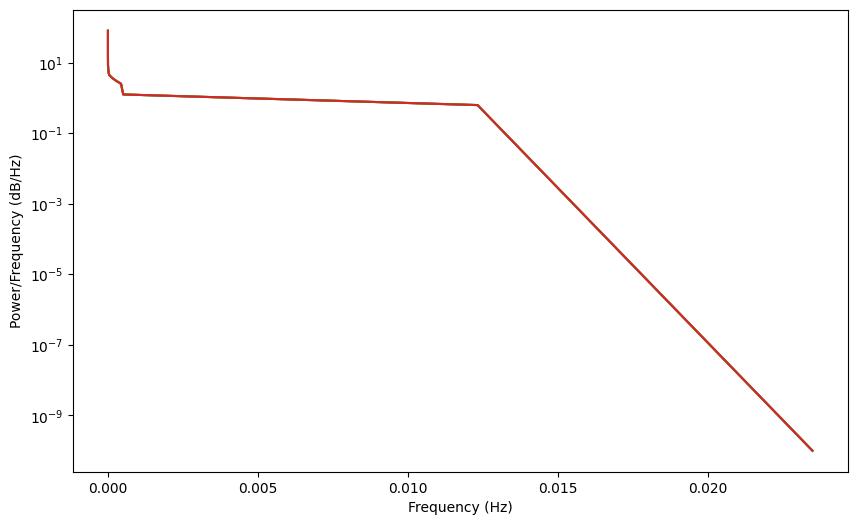

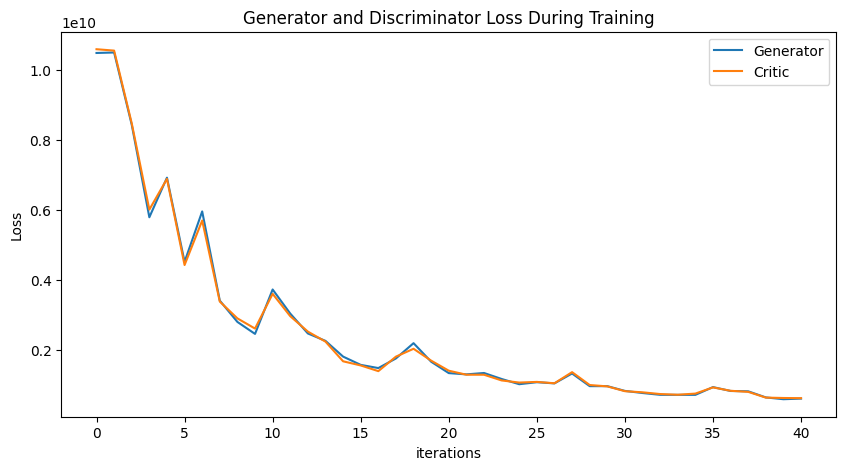

Epoch 50: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 5463

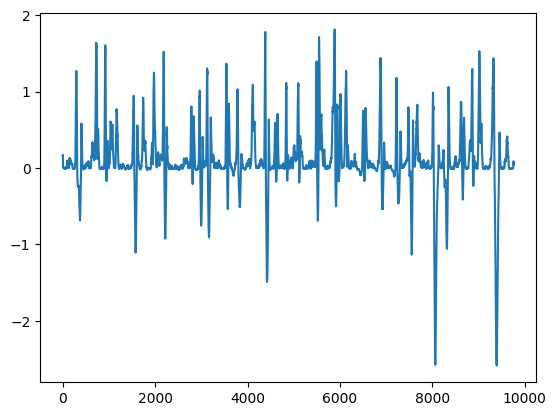

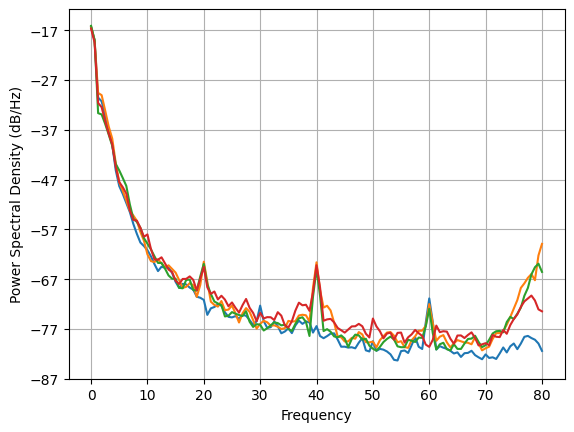

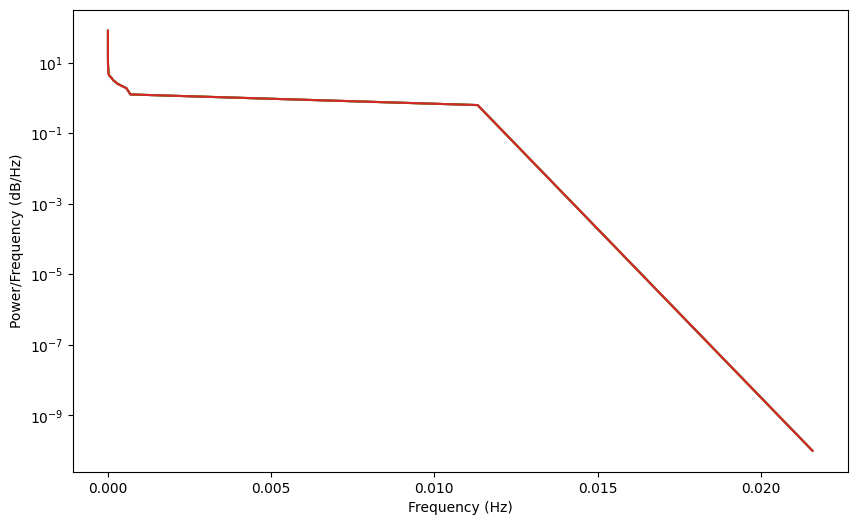

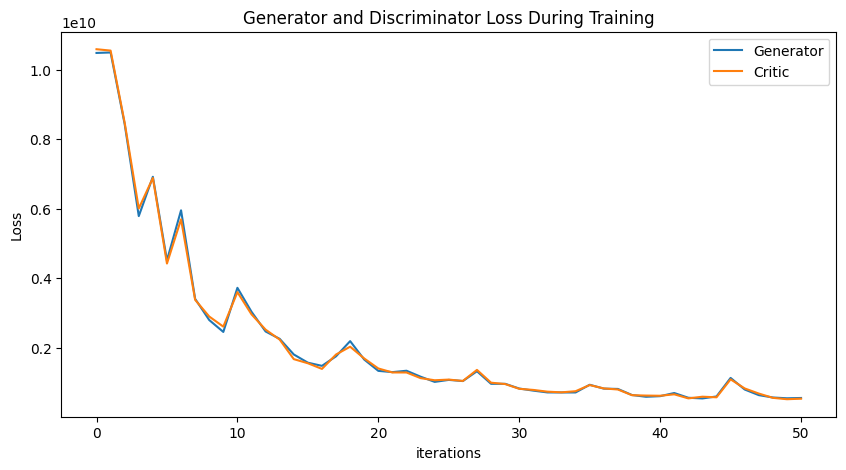

Epoch 60: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 5463

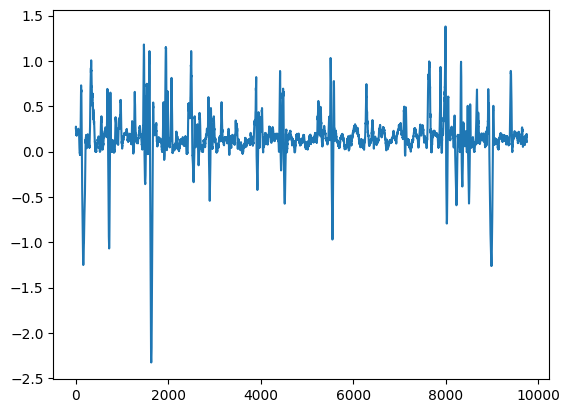

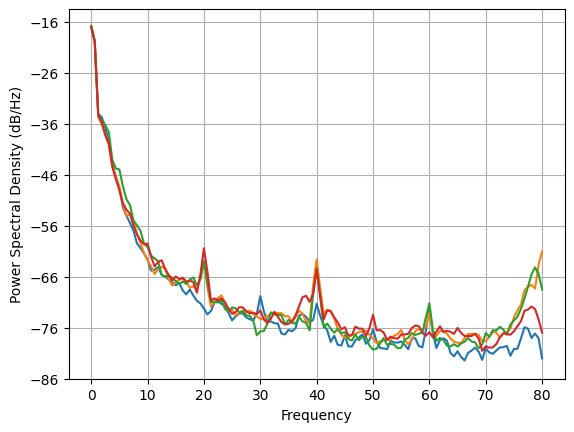

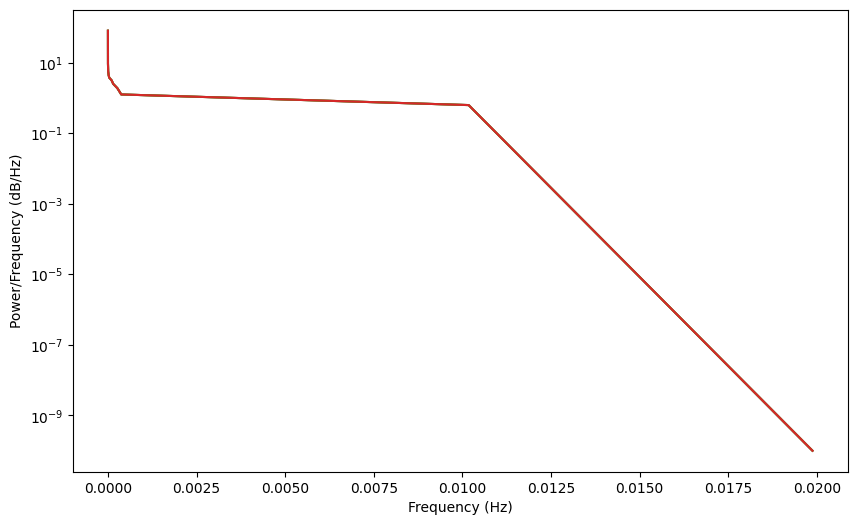

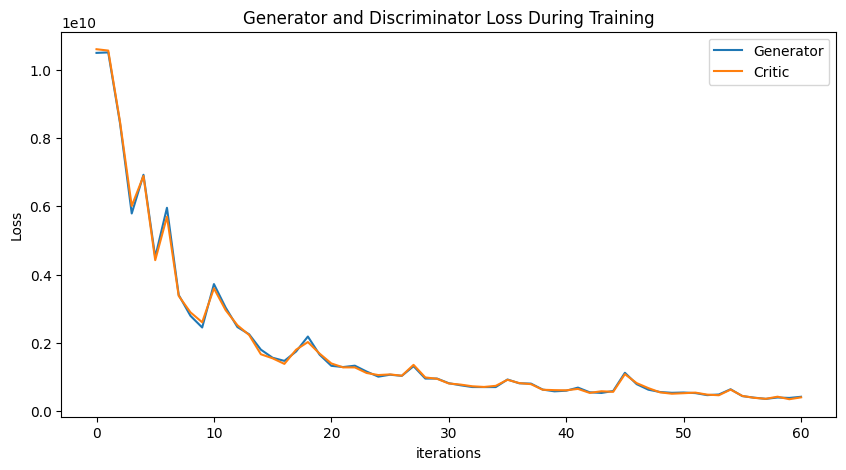

Epoch 70: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 5463

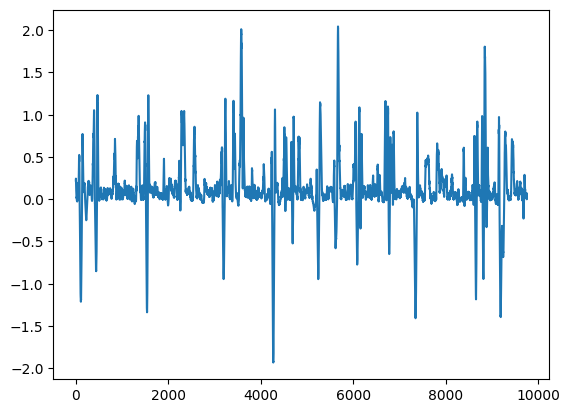

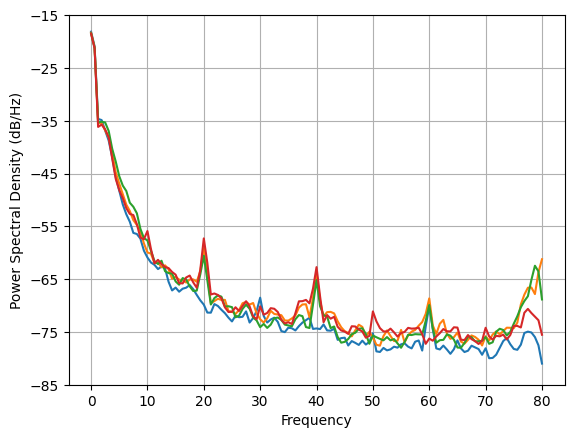

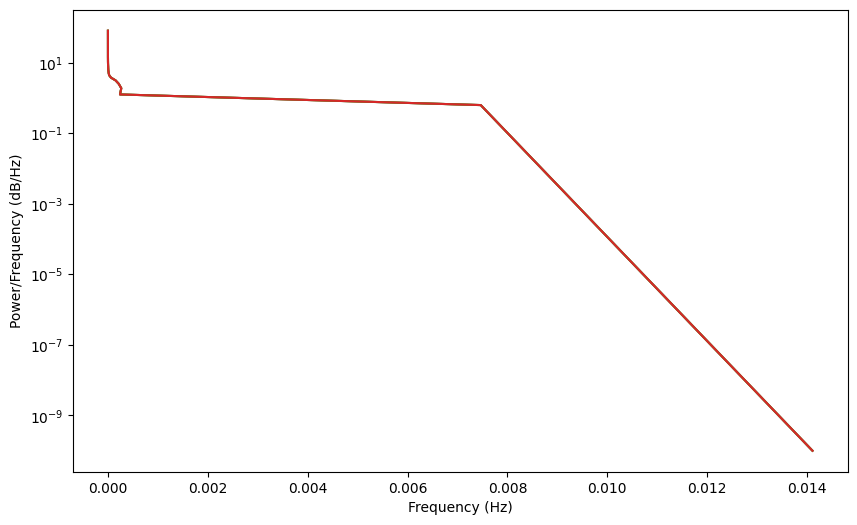

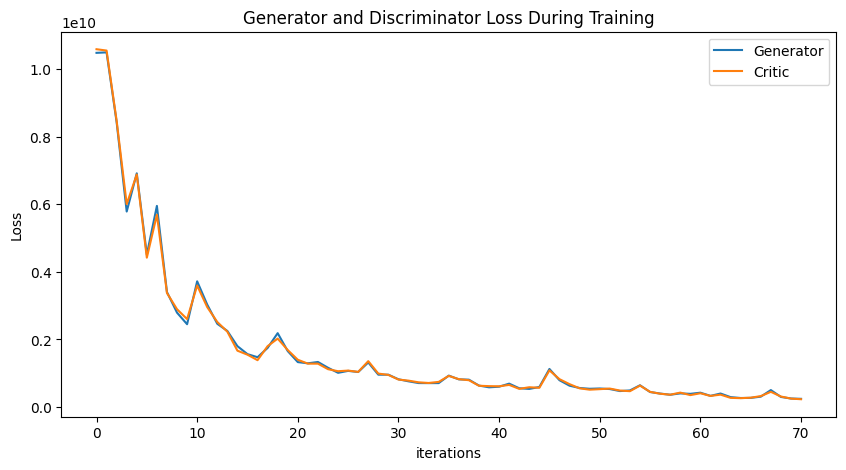

Epoch 80: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 5463

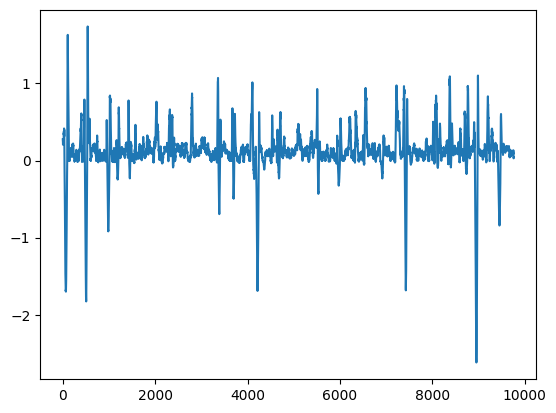

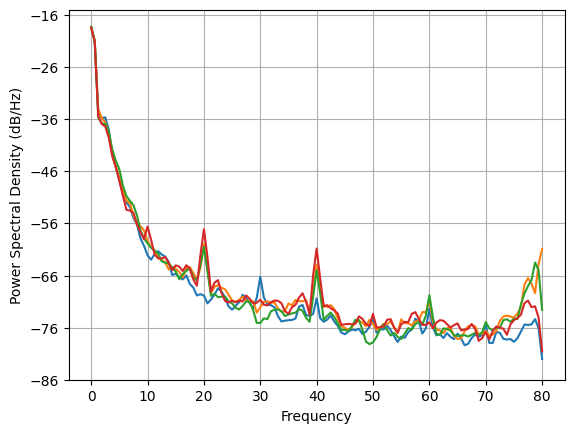

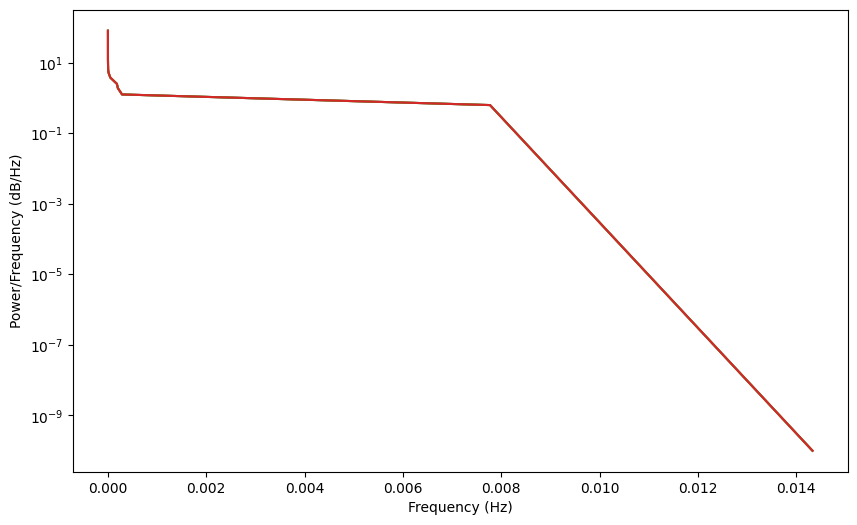

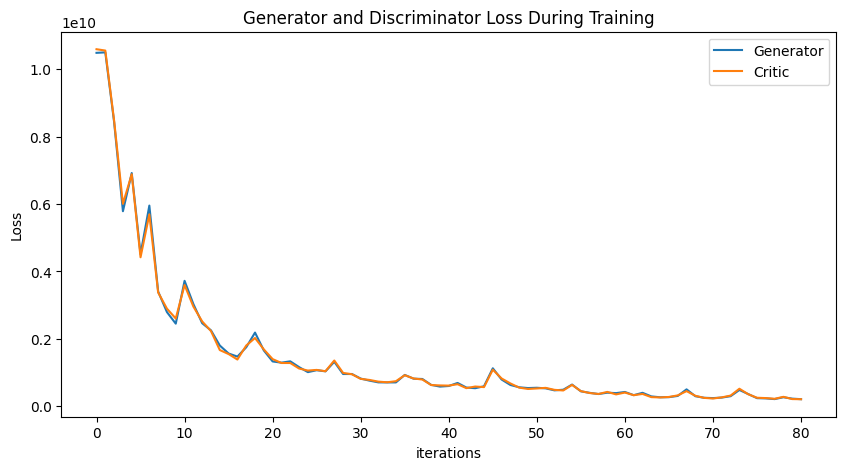

Epoch 90: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 5463

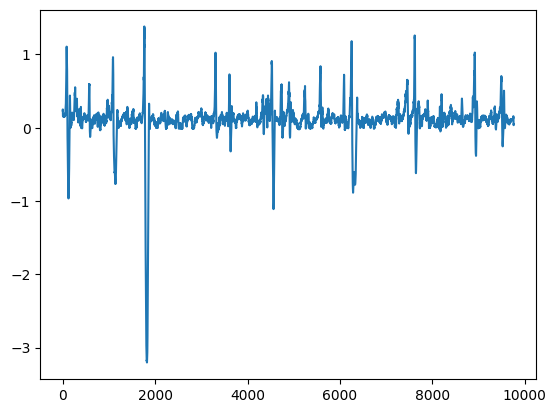

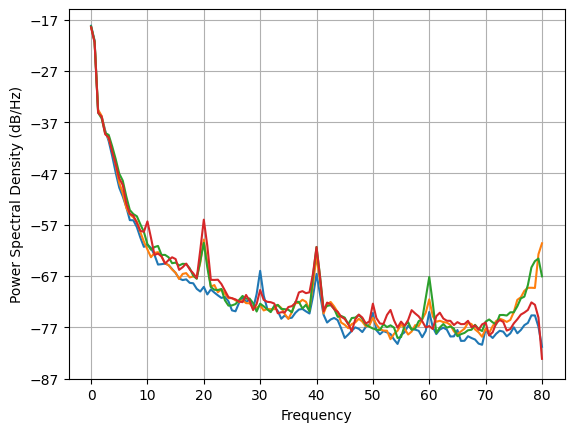

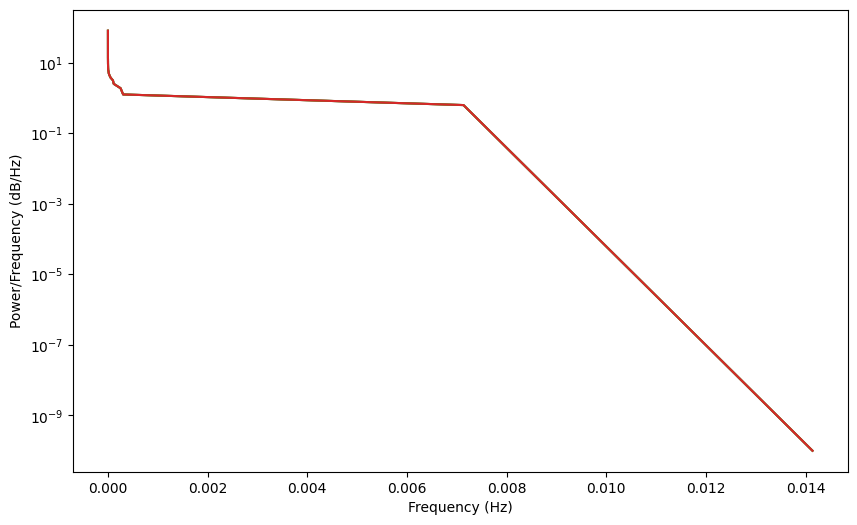

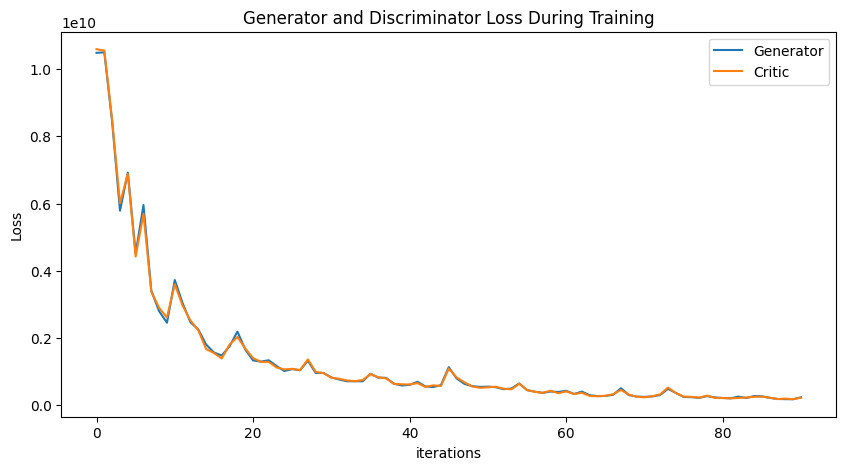

Epoch 100: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

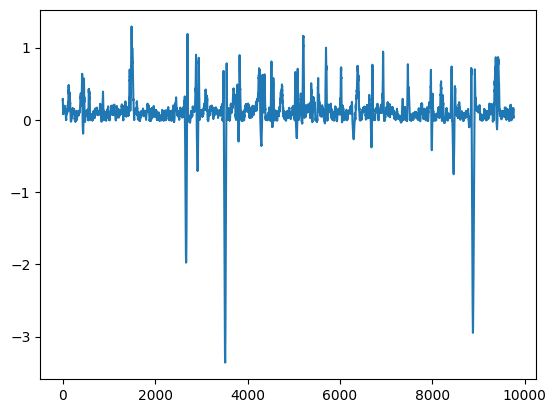

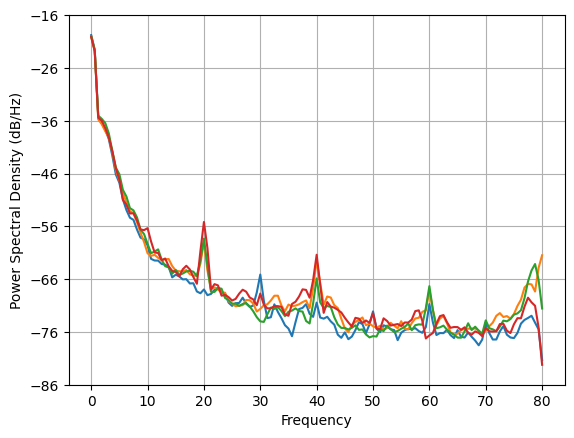

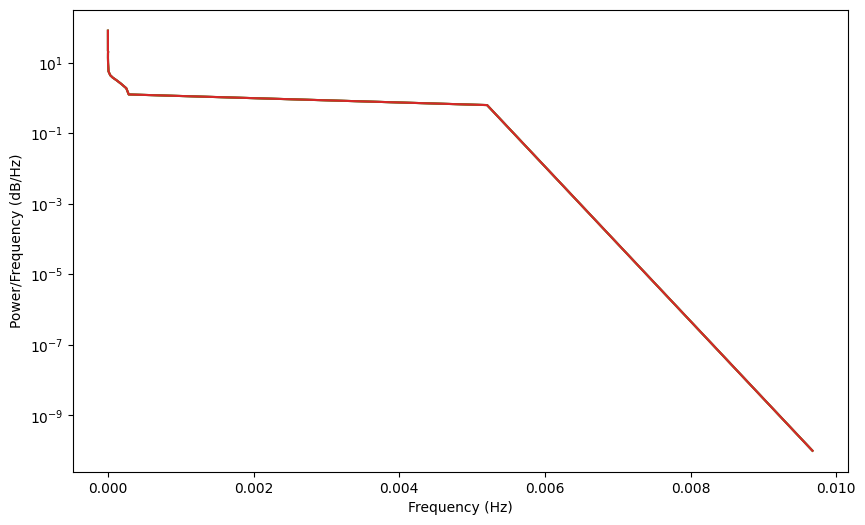

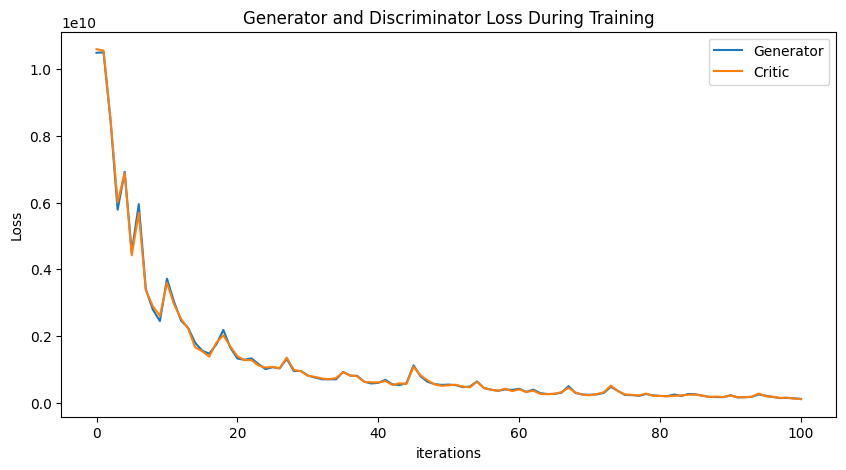

Epoch 110: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

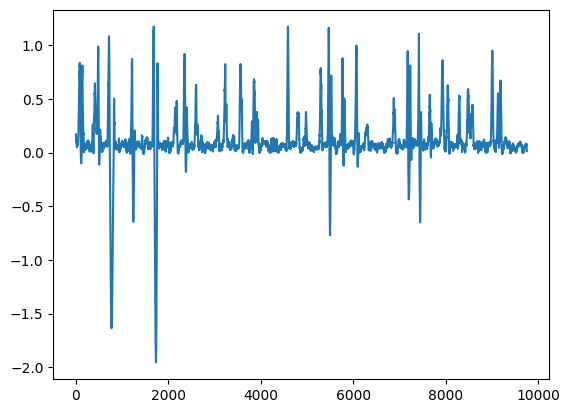

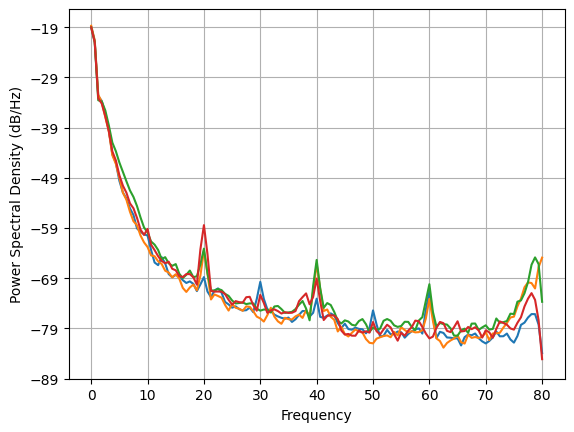

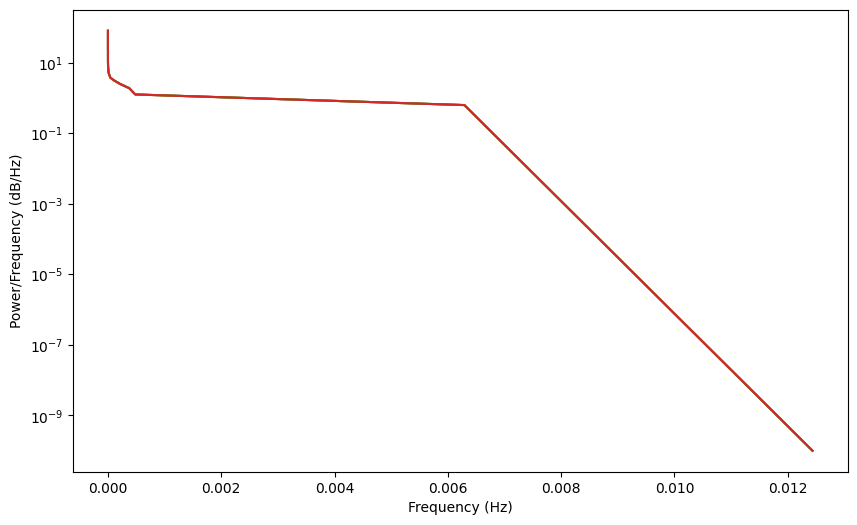

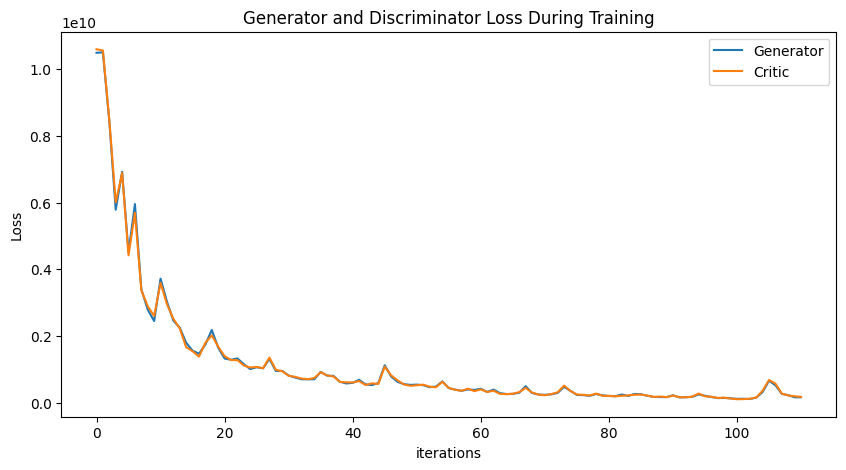

Epoch 120: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

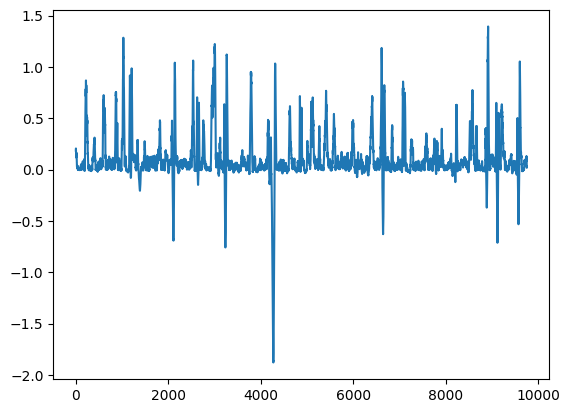

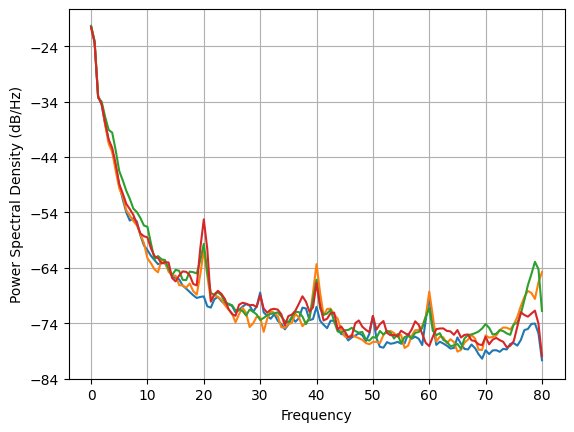

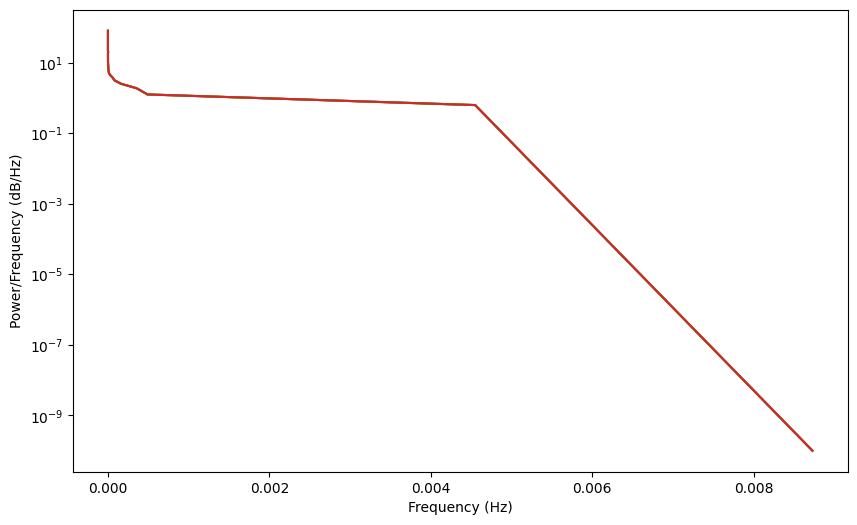

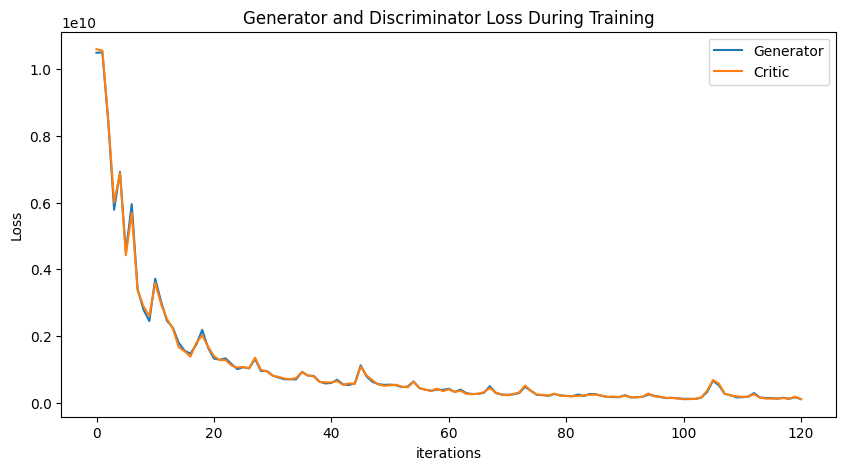

Epoch 130: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

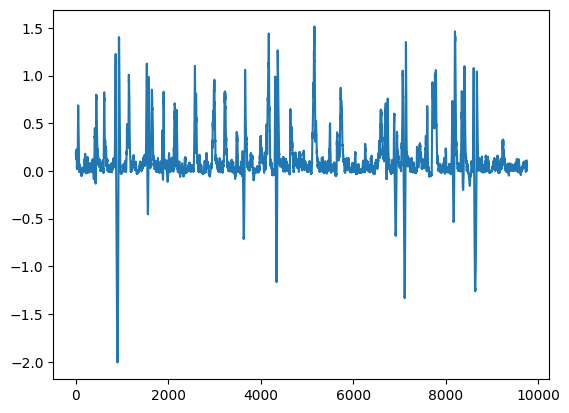

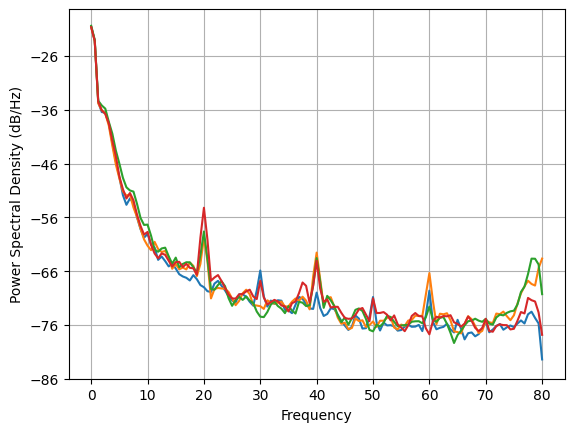

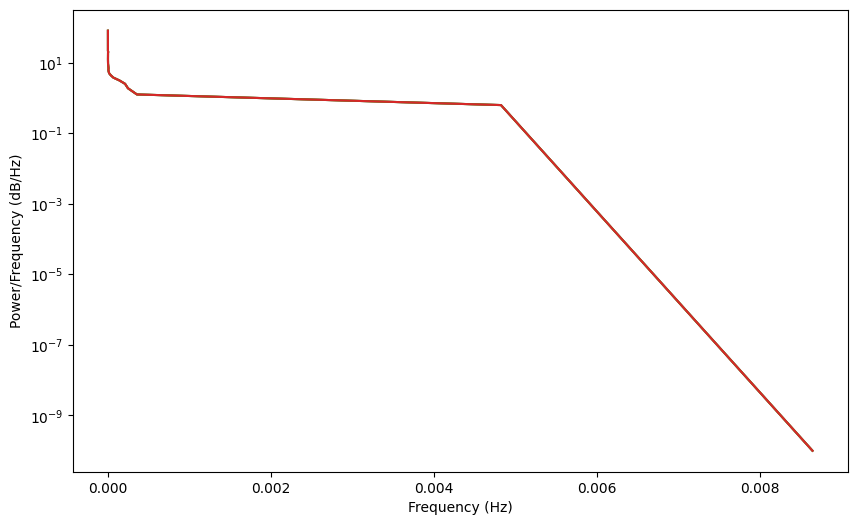

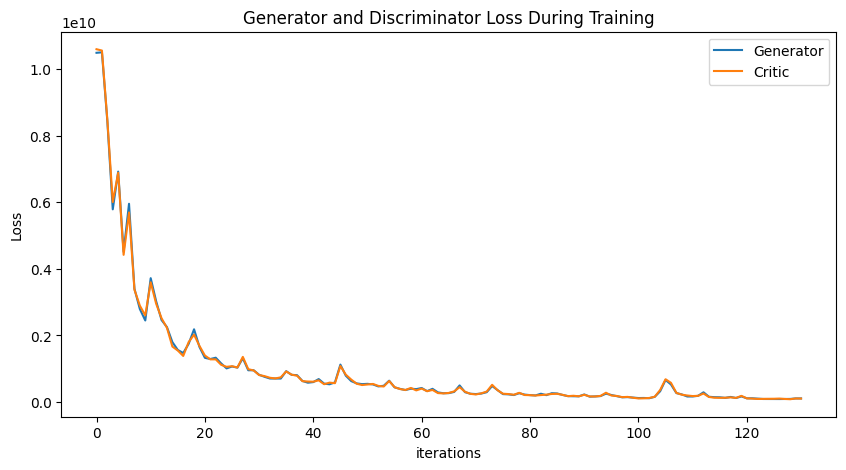

Epoch 140: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

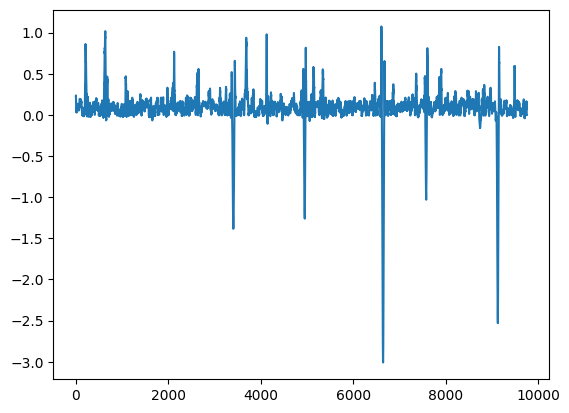

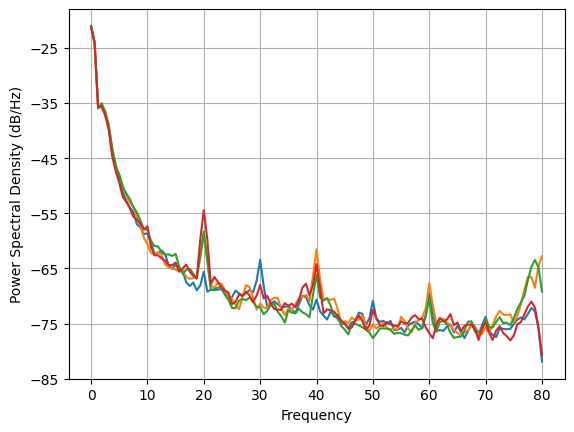

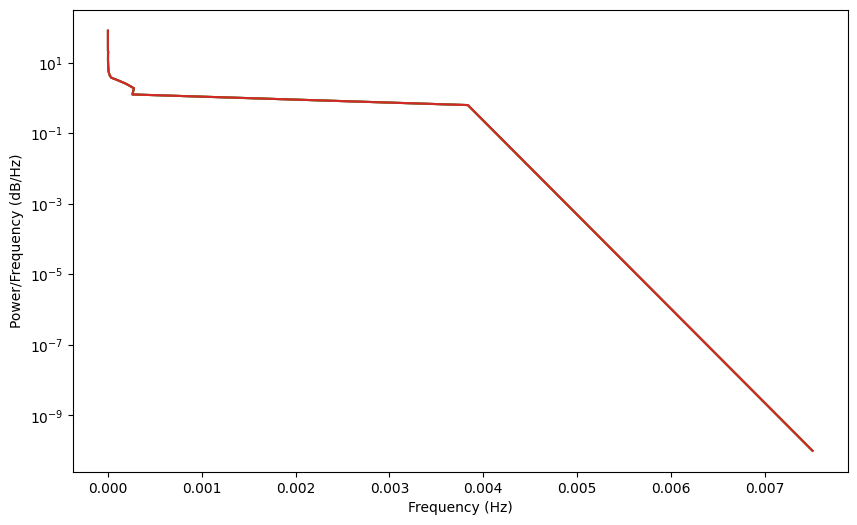

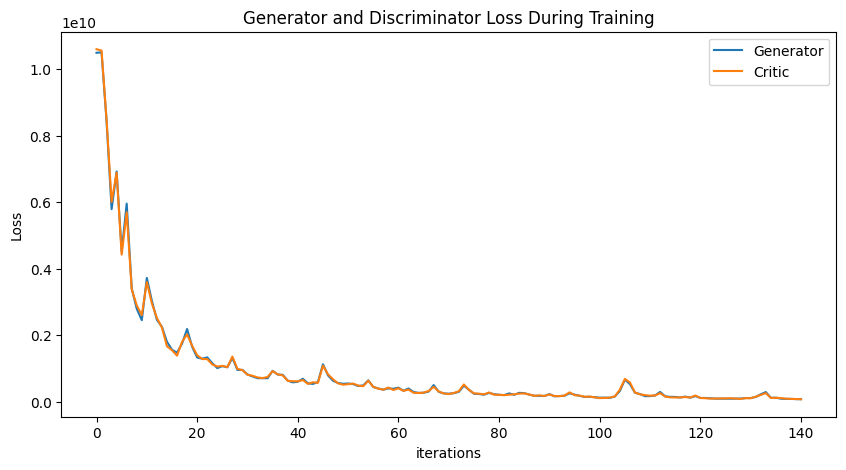

Epoch 150: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

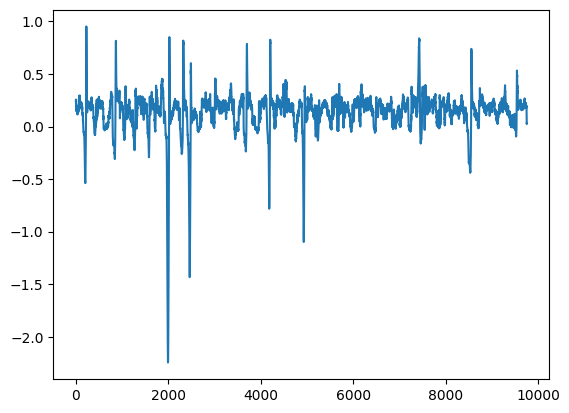

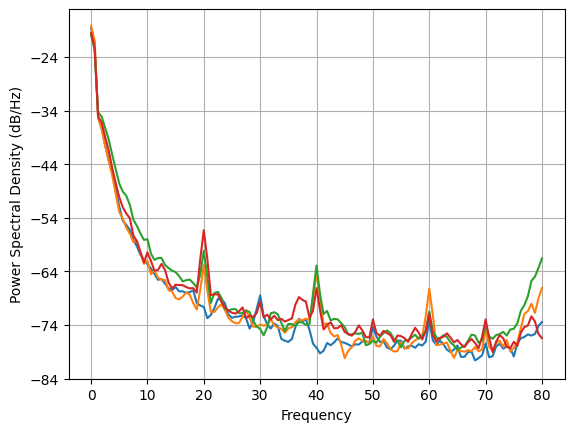

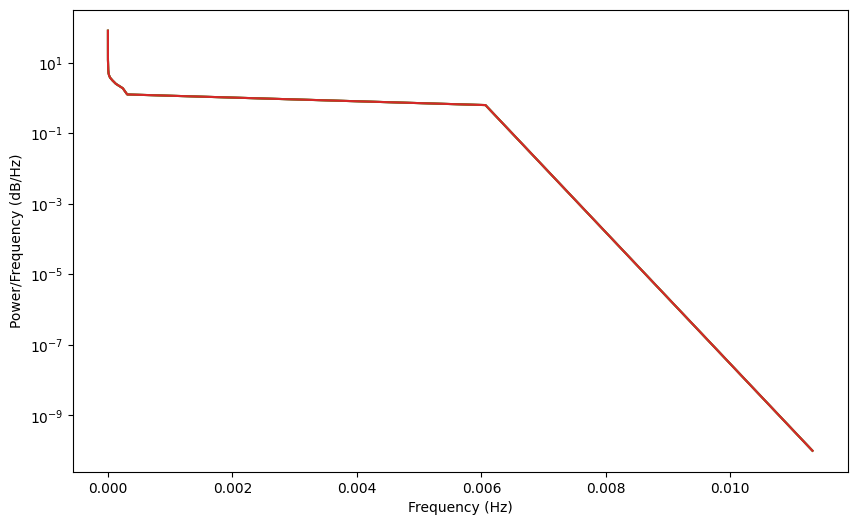

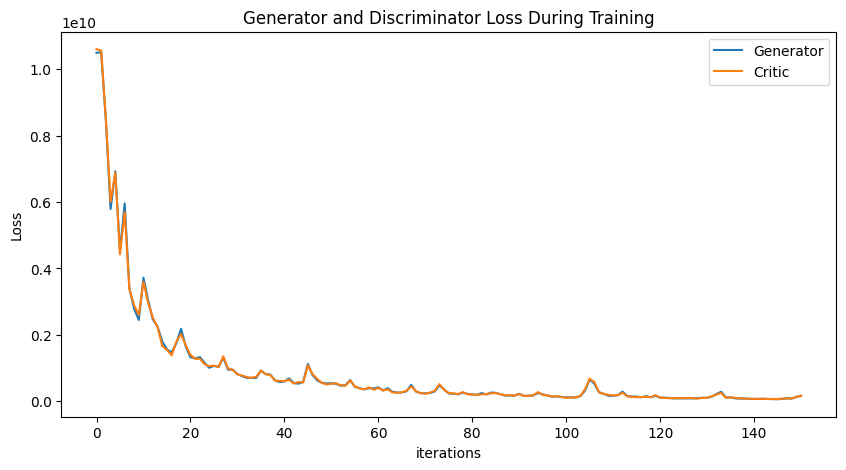

Epoch 160: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

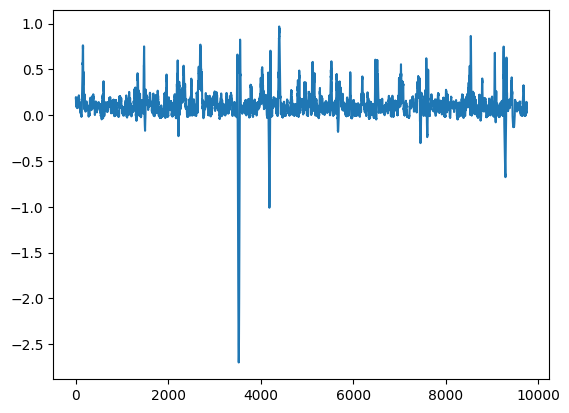

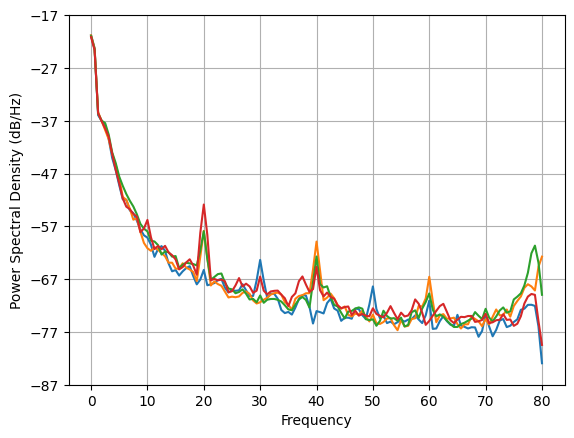

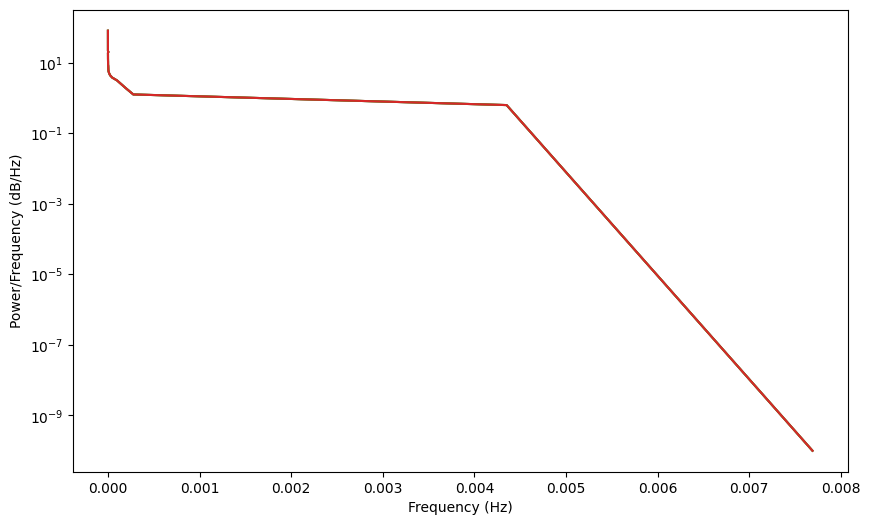

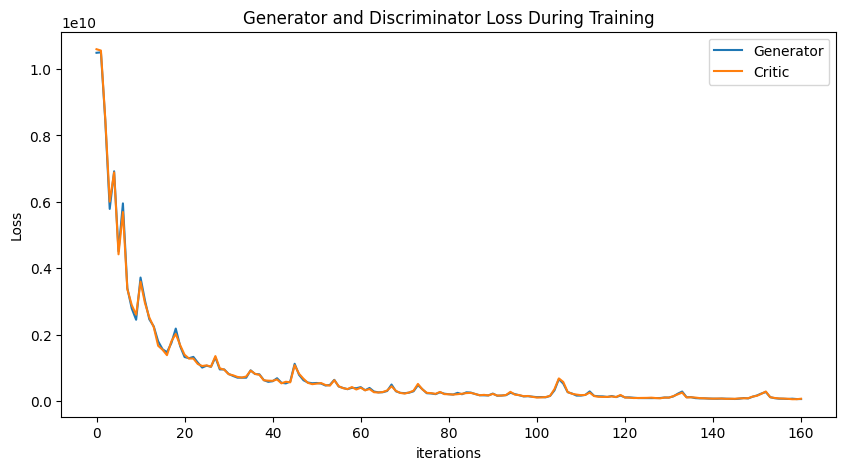

Epoch 170: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

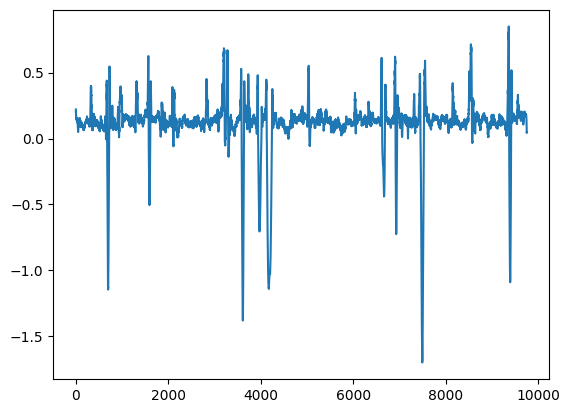

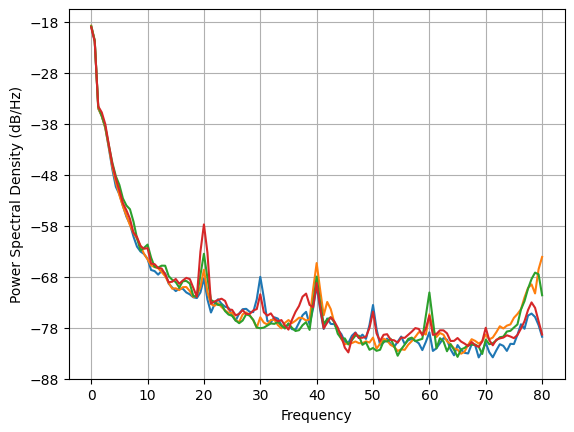

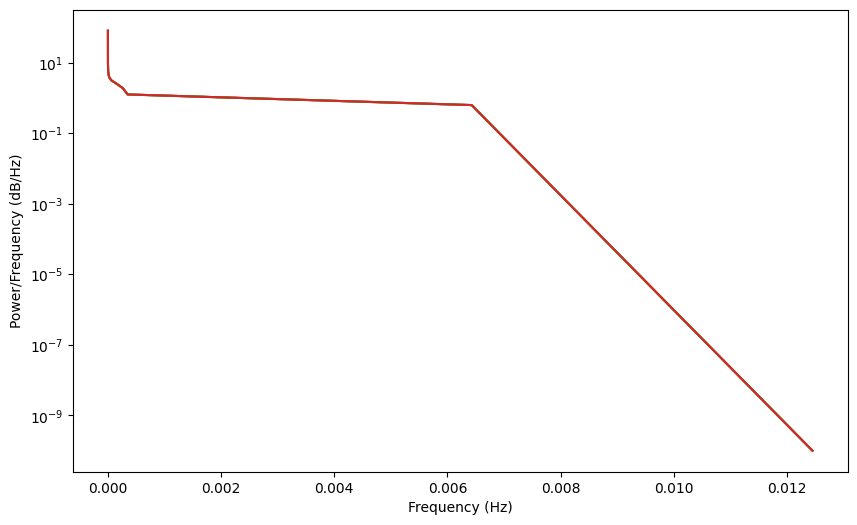

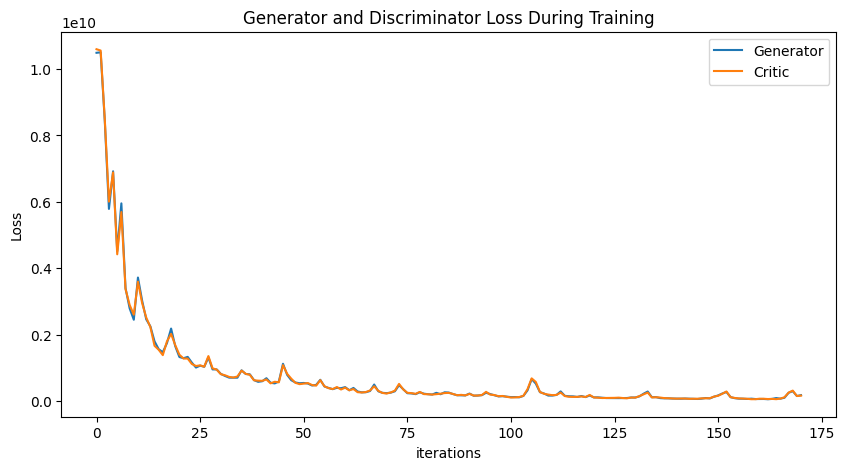

Epoch 180: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

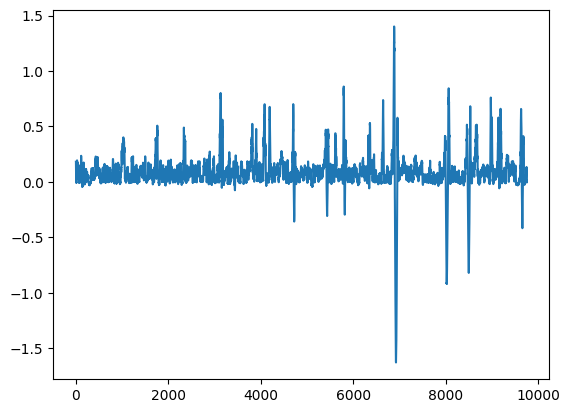

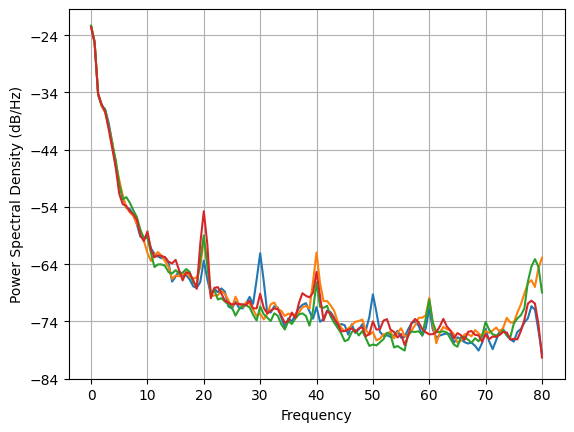

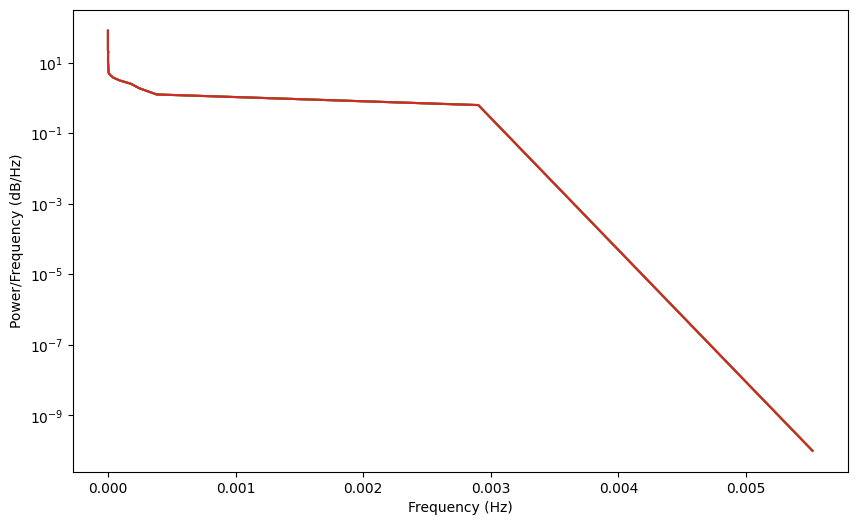

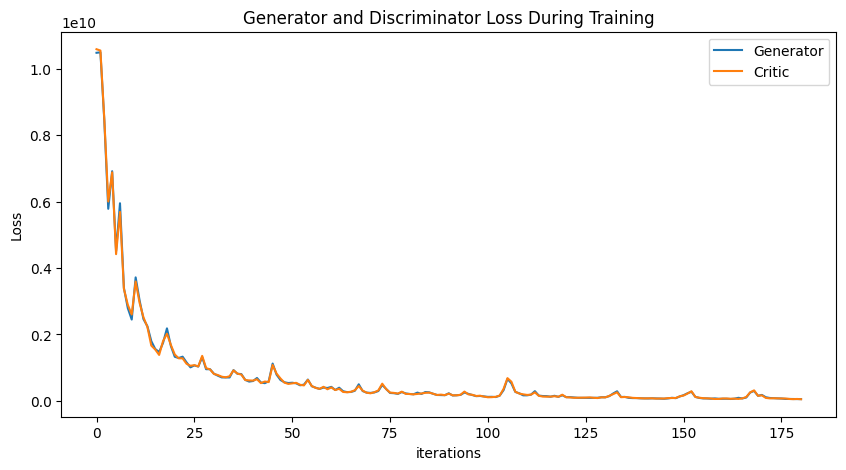

Epoch 190: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

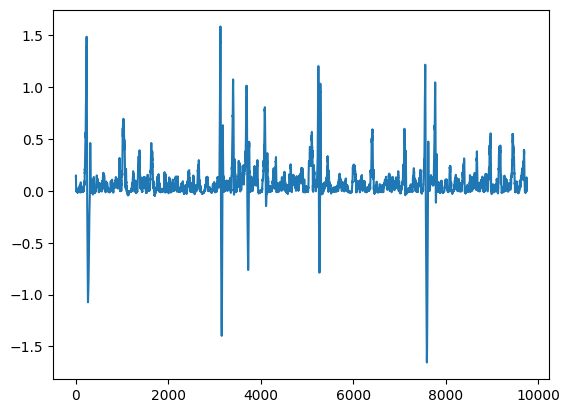

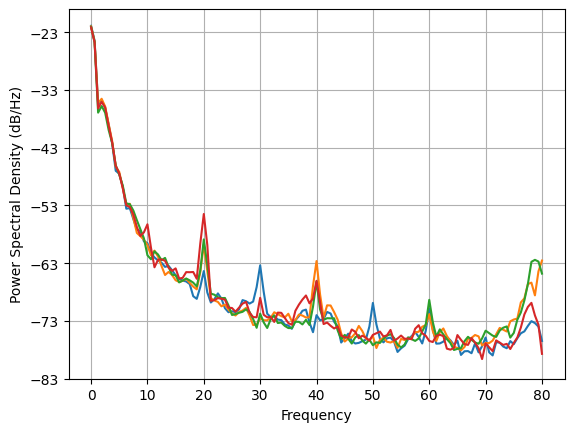

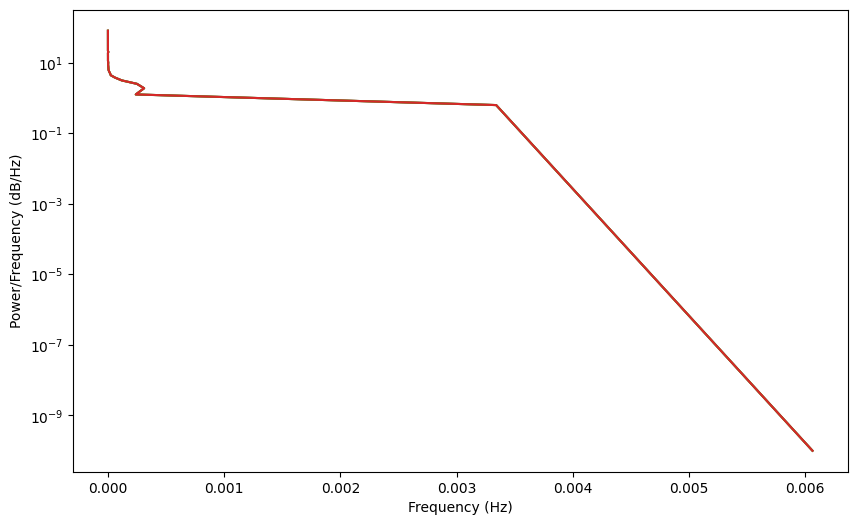

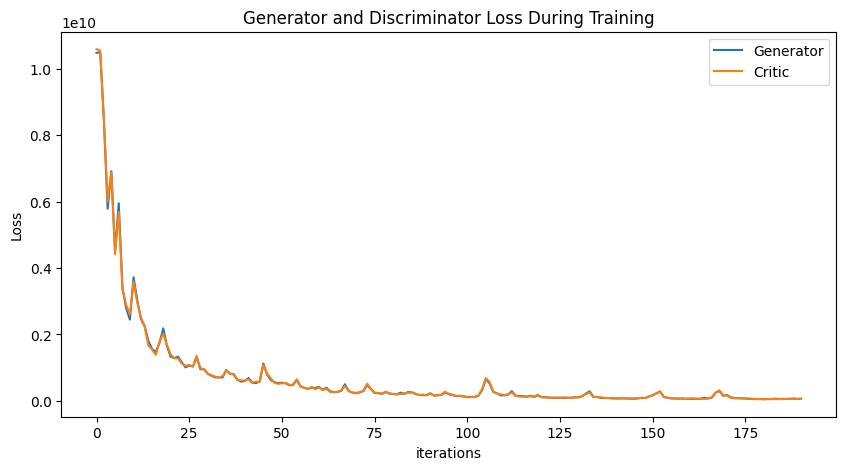

Epoch 200: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

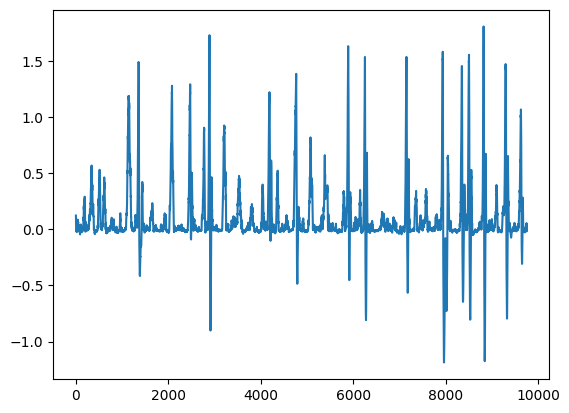

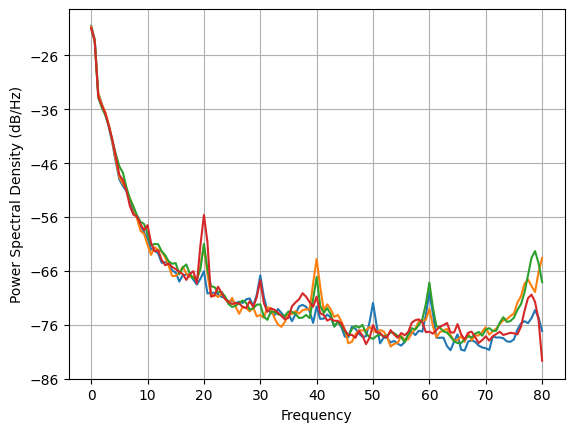

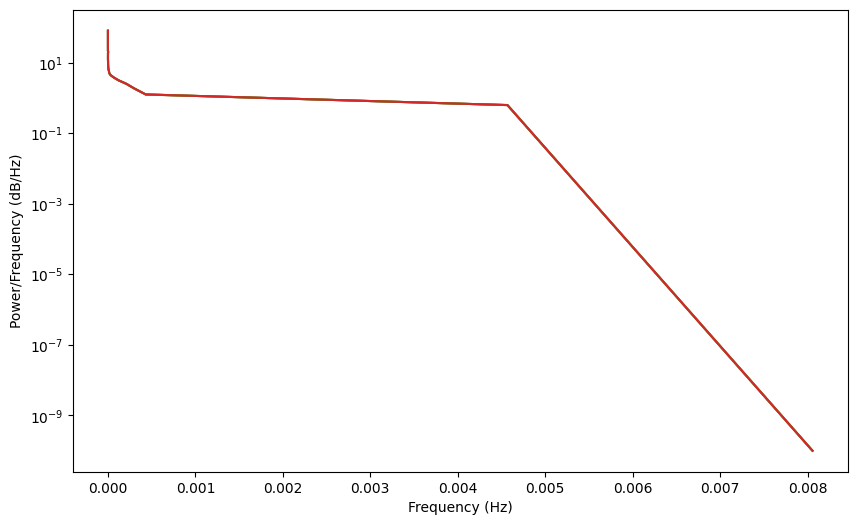

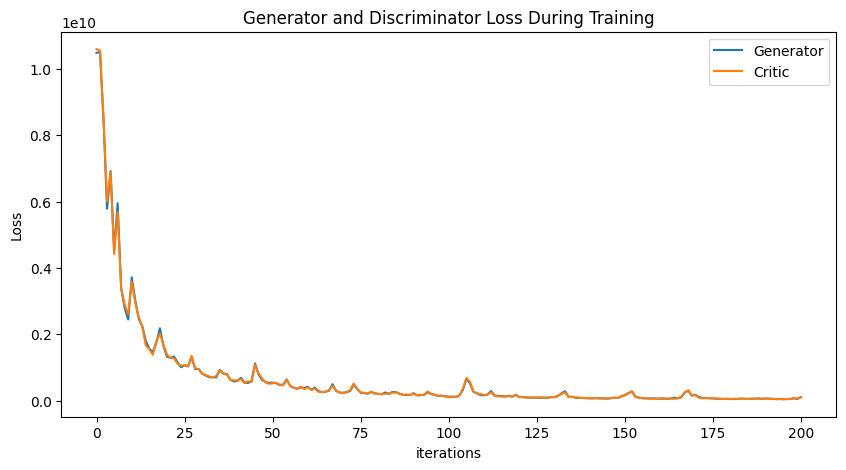

Epoch 210: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

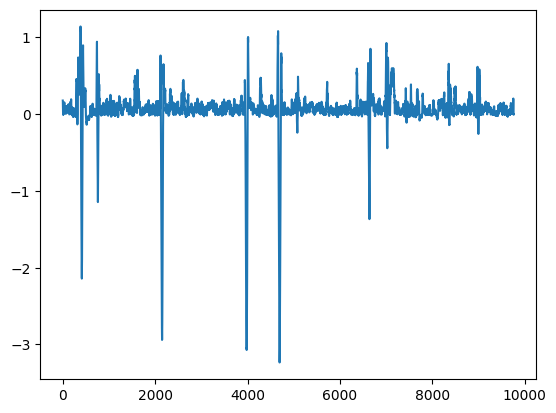

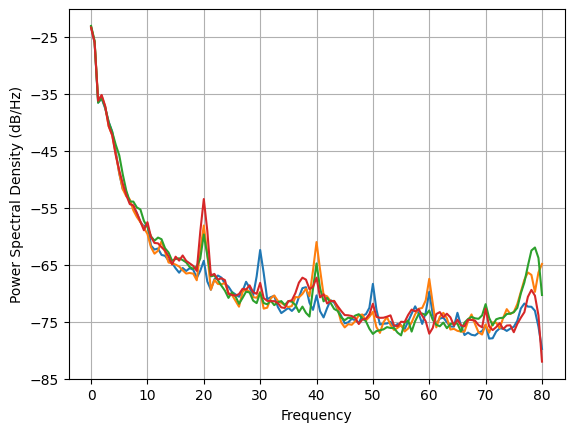

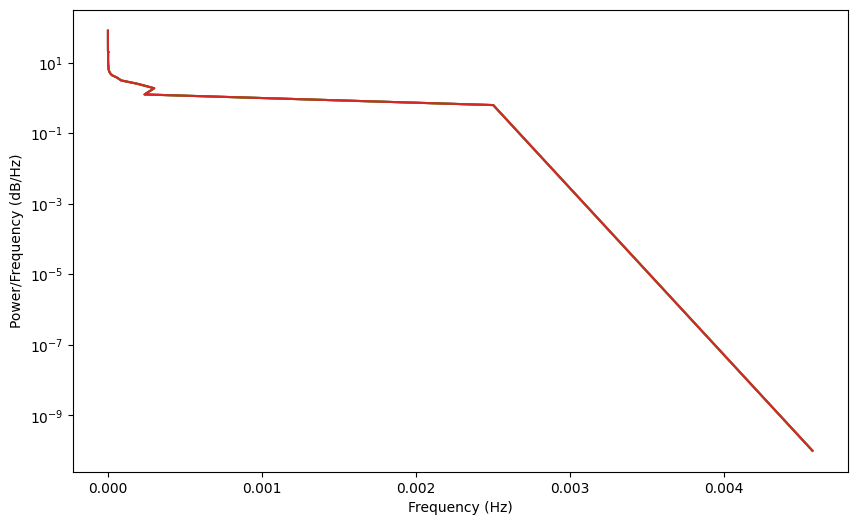

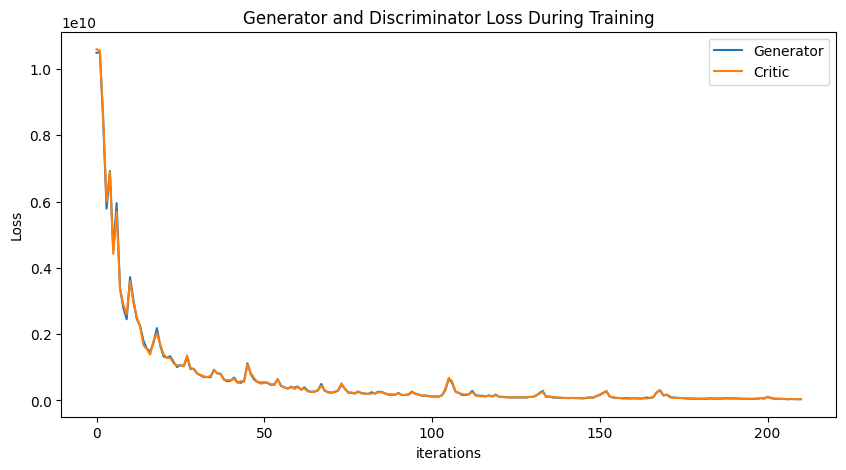

Epoch 220: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

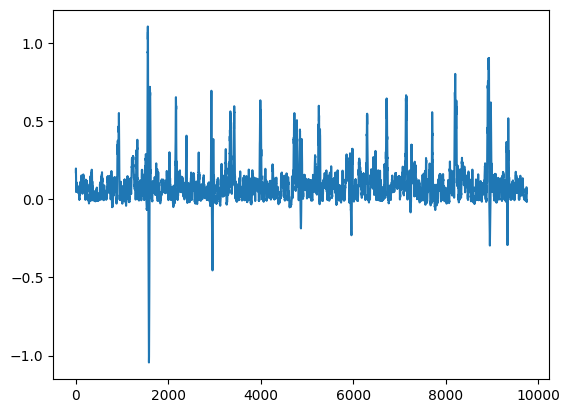

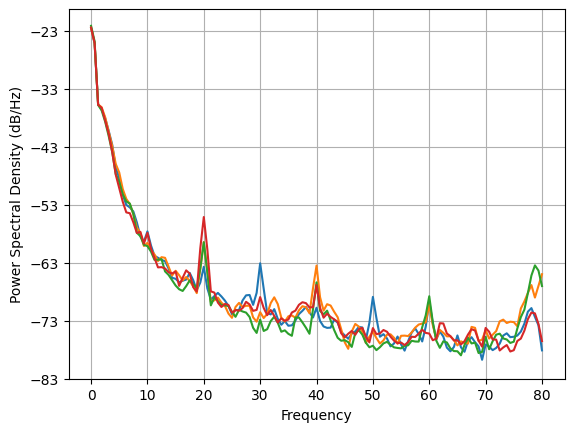

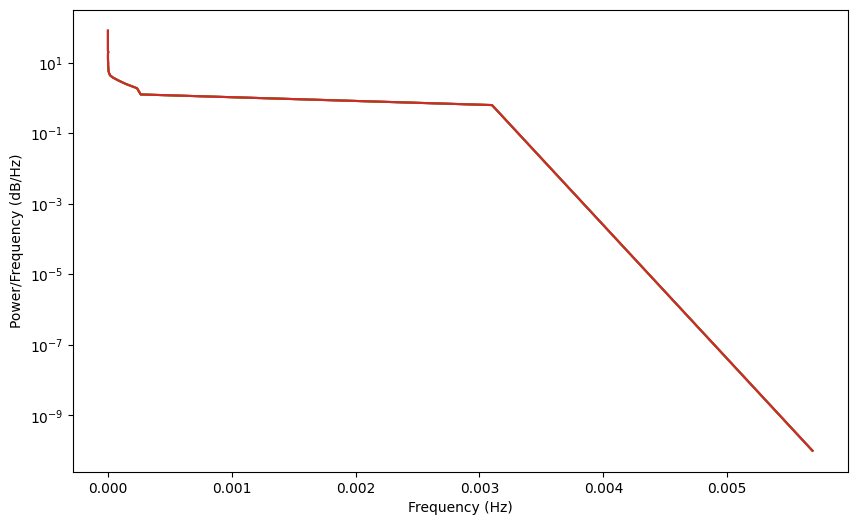

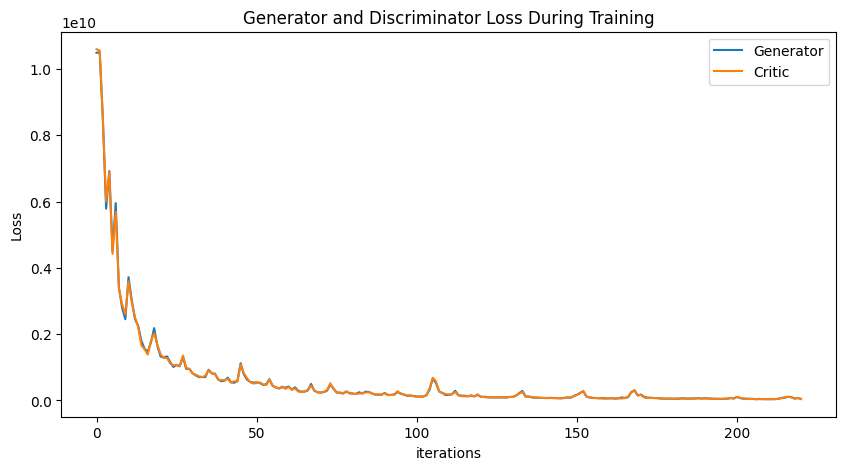

Epoch 230: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

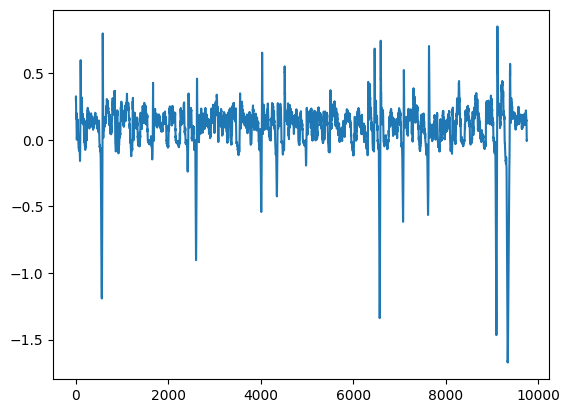

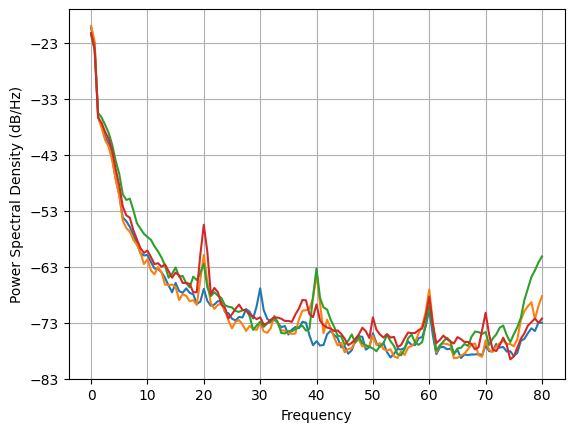

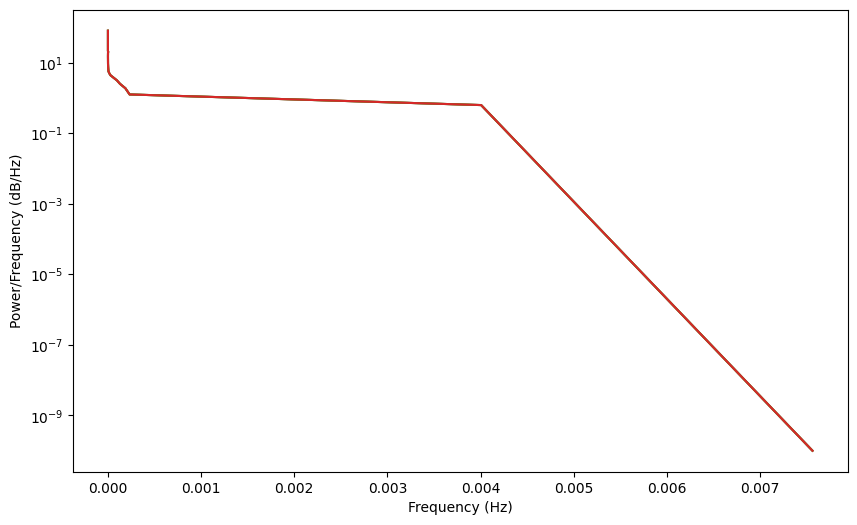

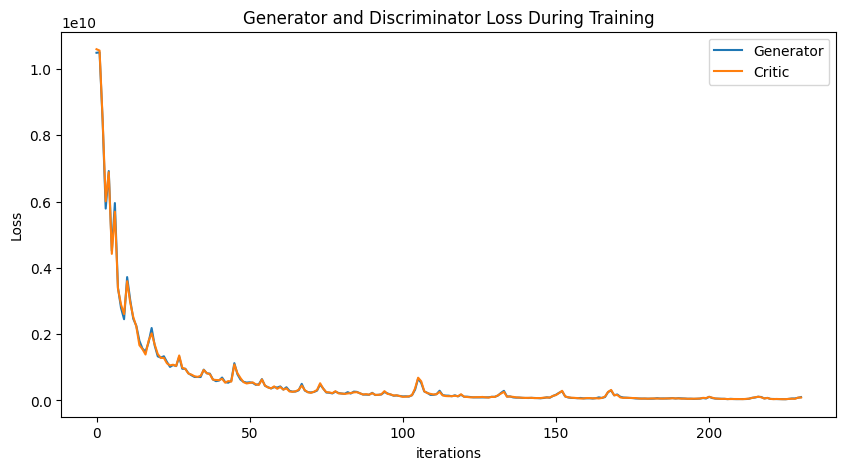

Epoch 240: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

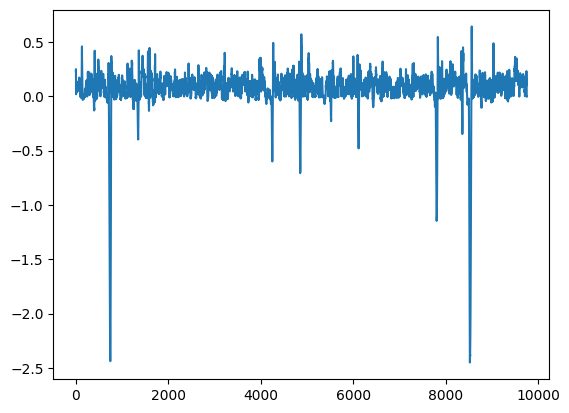

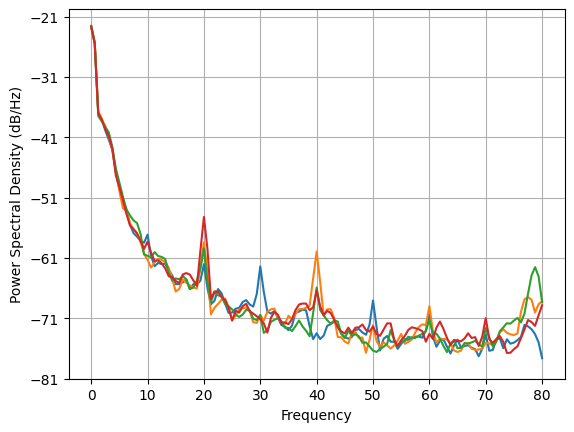

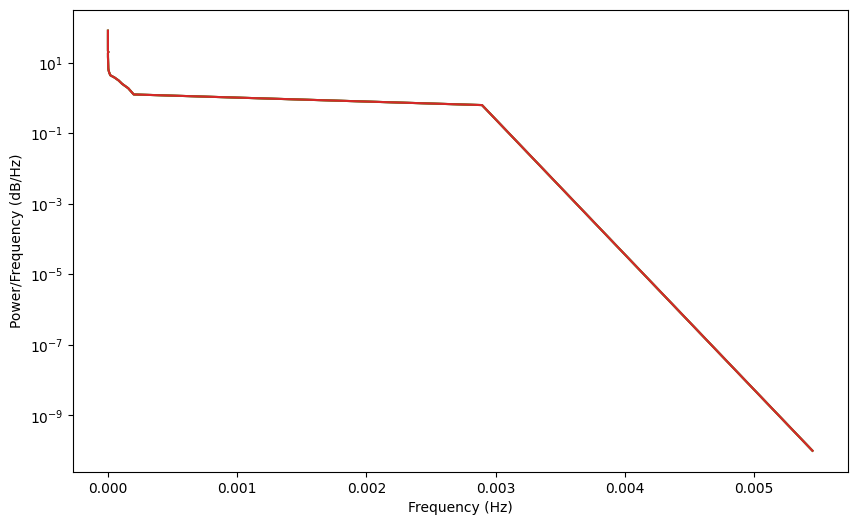

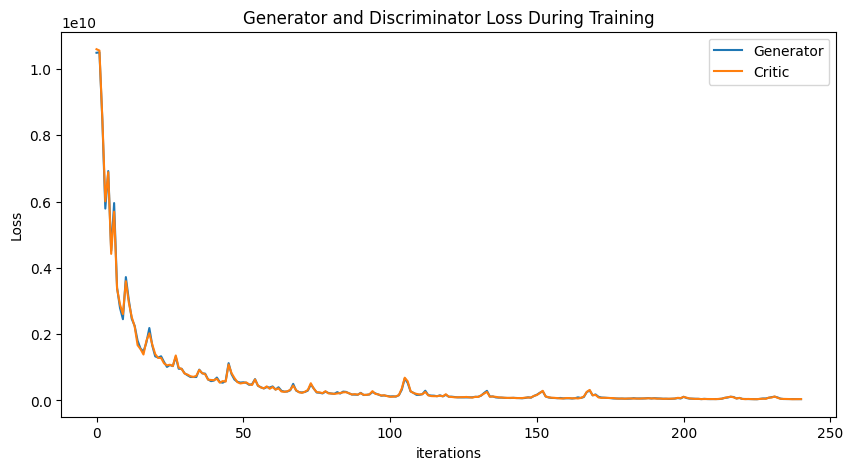

Epoch 250: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

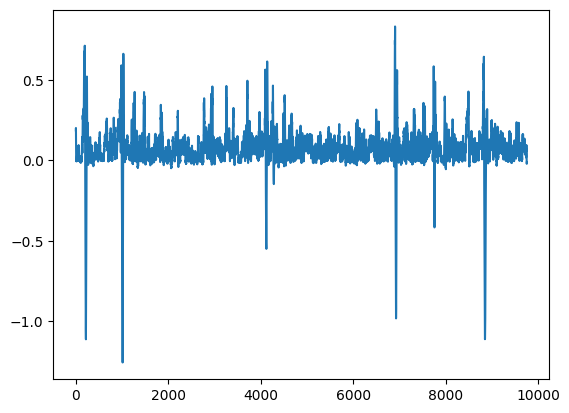

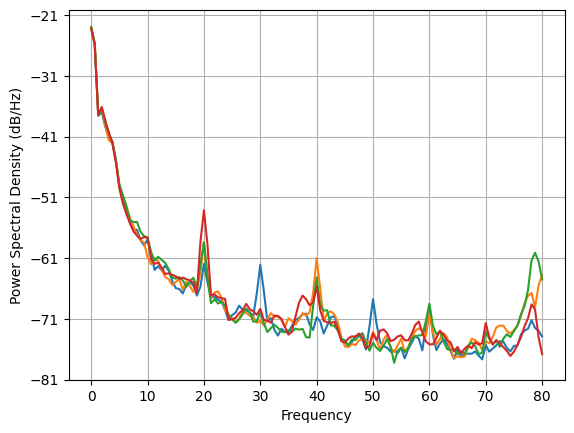

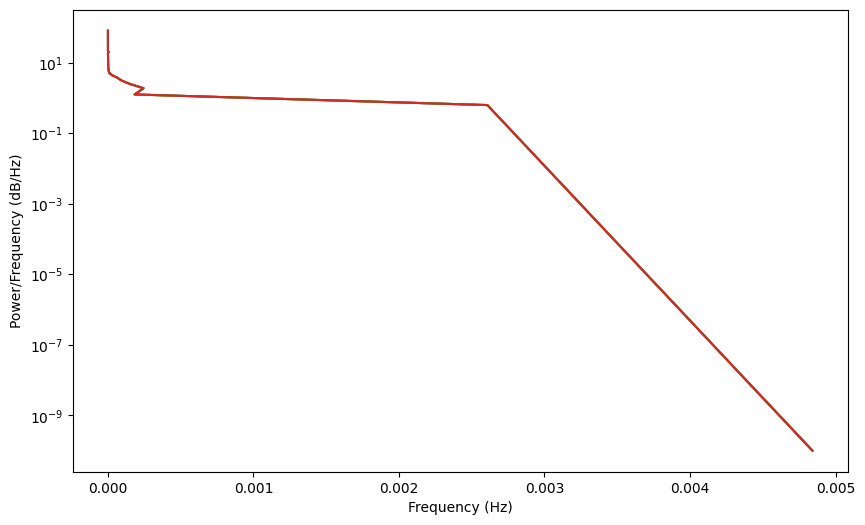

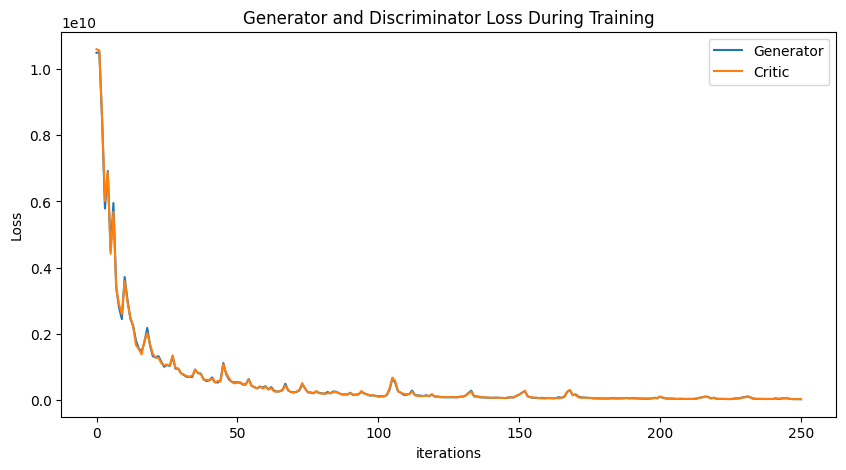

Epoch 260: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

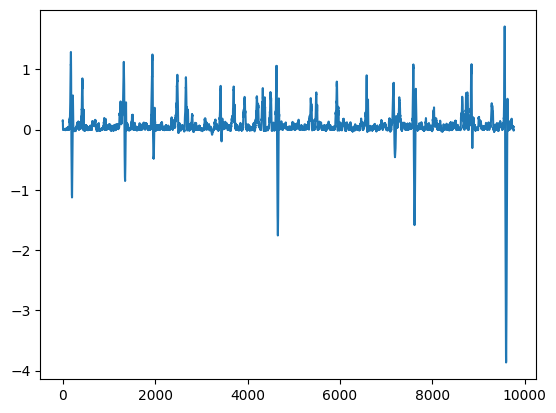

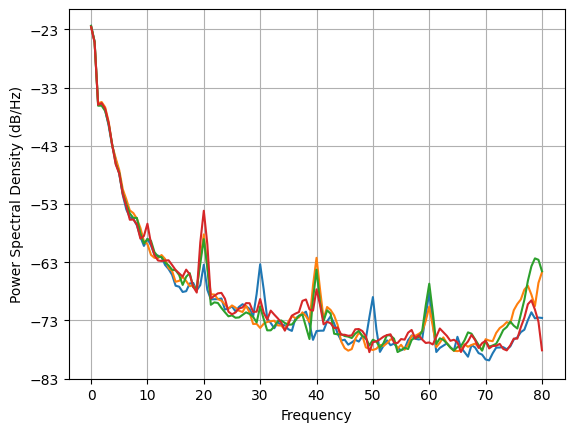

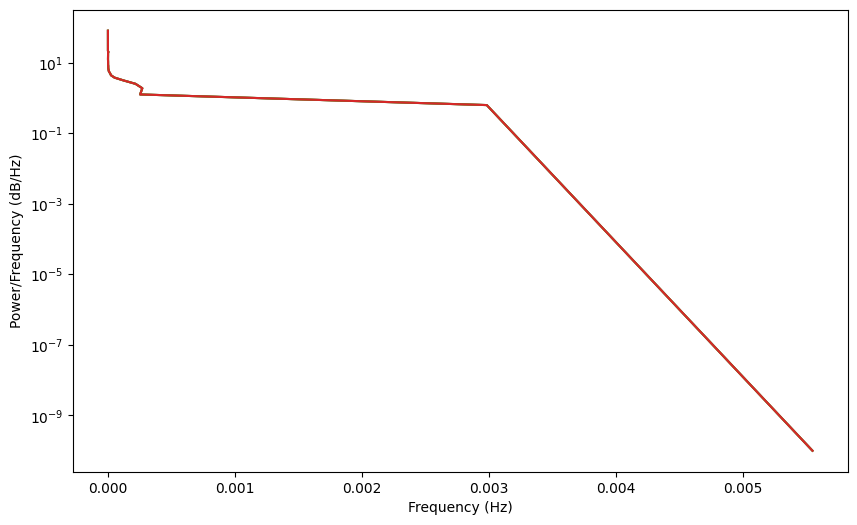

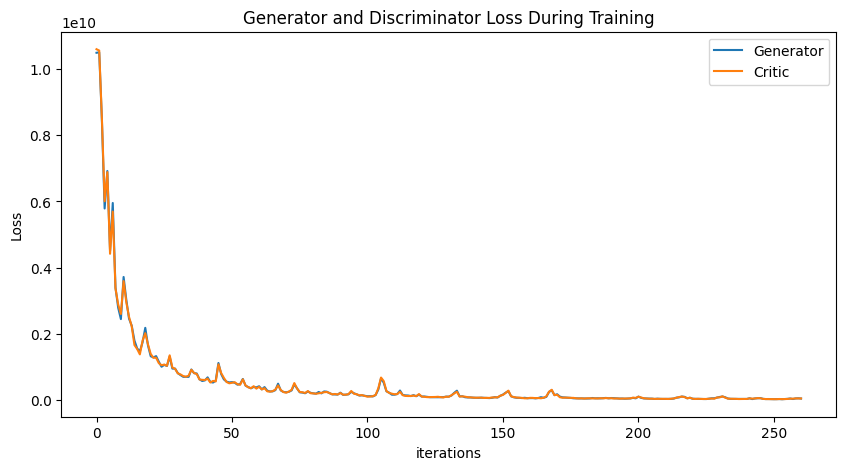

Epoch 270: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

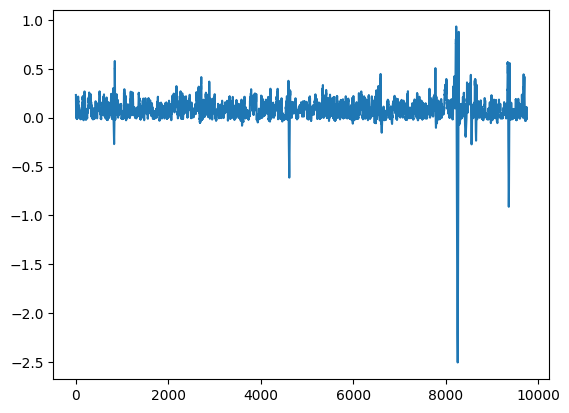

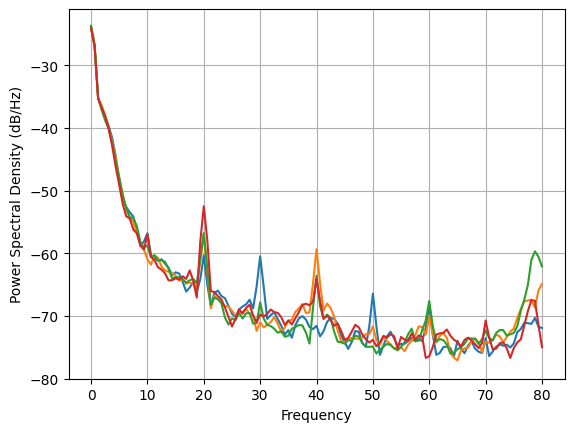

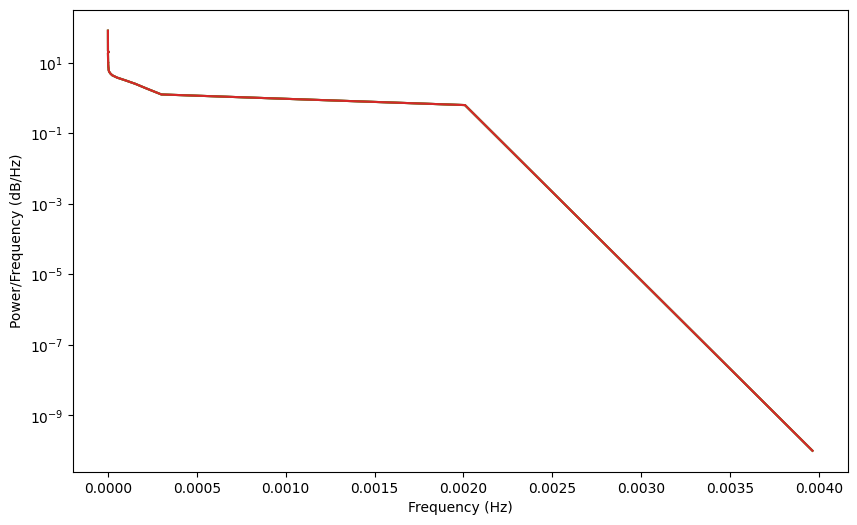

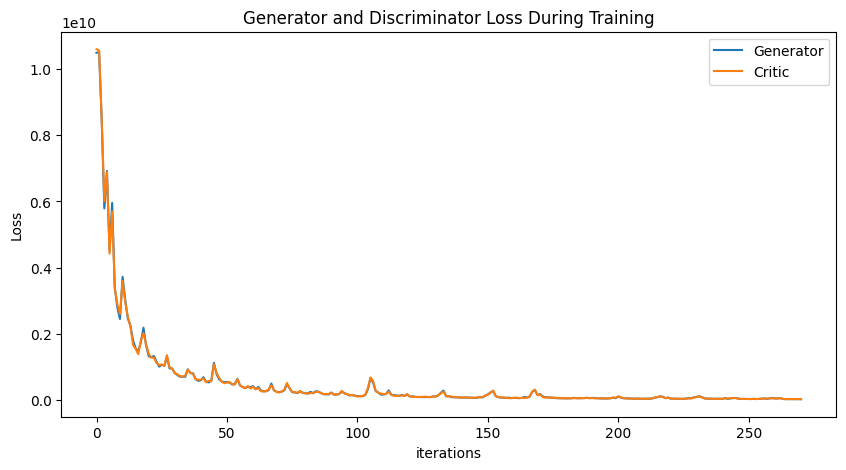

Epoch 280: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

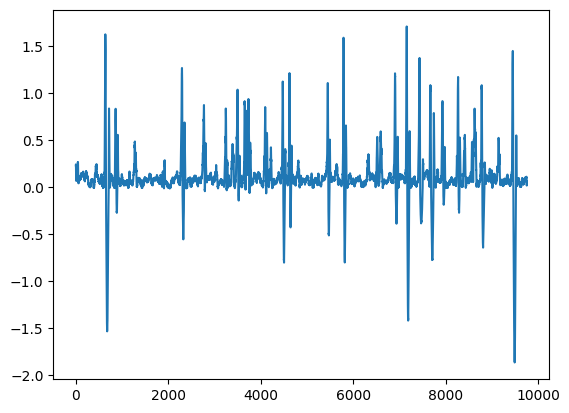

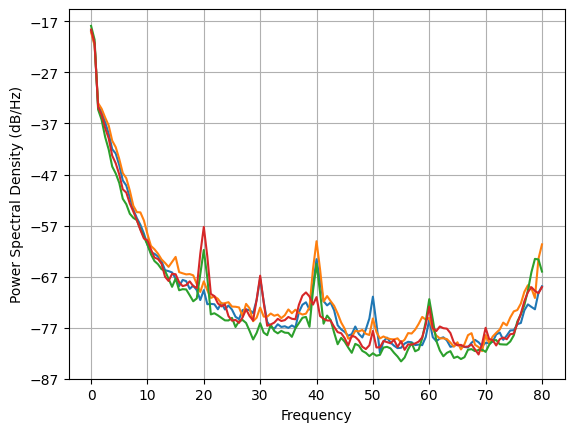

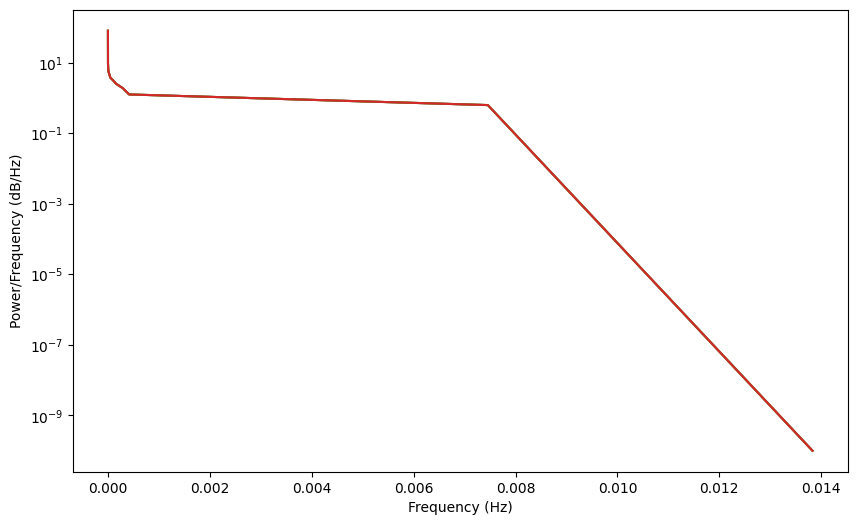

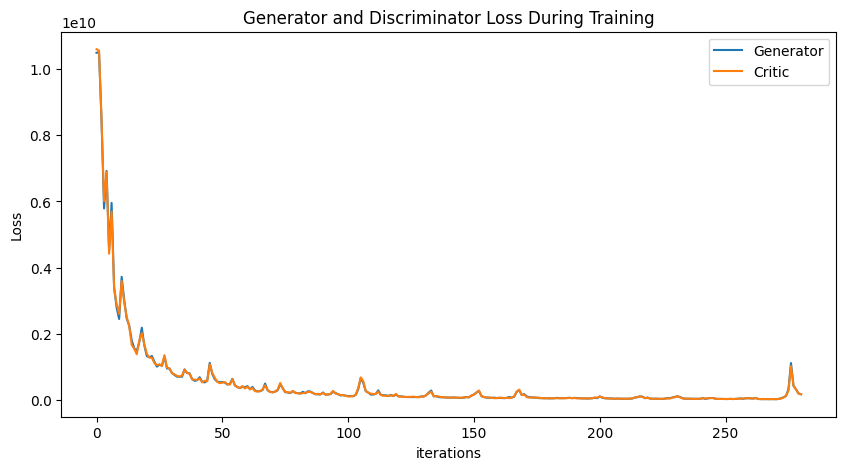

Epoch 290: Critic error ([10488921800.043007, 10502888305.81334, 8436250730.436143, 5787542869.777224, 6920574244.1561985, 4512240493.725961, 5954686840.260783, 3402360587.3544116, 2792390627.8854914, 2449647125.523973, 3720777777.4758124, 3031121483.1450486, 2462755418.6012335, 2250125675.209958, 1800264701.2885084, 1563459460.3384368, 1472089809.9157832, 1747629409.0274003, 2184773649.4893956, 1653647597.8156095, 1327728552.1072474, 1291535028.2554264, 1331413320.9310234, 1160023783.722005, 1010165918.1024162, 1067682788.5698392, 1033963818.8510451, 1316848838.3031993, 954484441.8039147, 954716465.1044816, 818634276.1436349, 758054707.1808456, 706565406.9880546, 705149788.6307559, 705464319.4229968, 927478175.1242188, 816303007.1100839, 806977453.8485761, 632034829.3842927, 580643669.1964554, 598882898.3647605, 689536338.1201915, 552687555.1090765, 533304955.49747527, 590372271.2239377, 1124400422.999157, 790700705.3163013, 628582132.4522765, 560497981.2401237, 537582457.7861193, 546

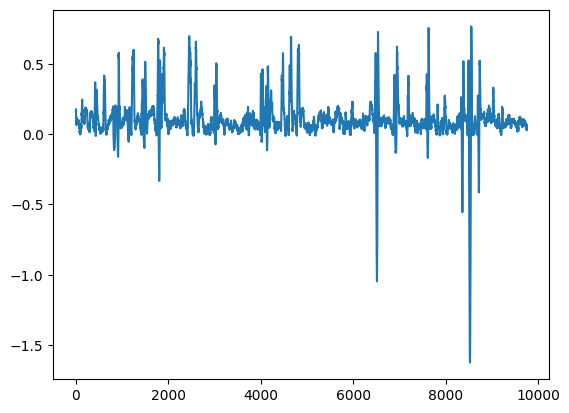

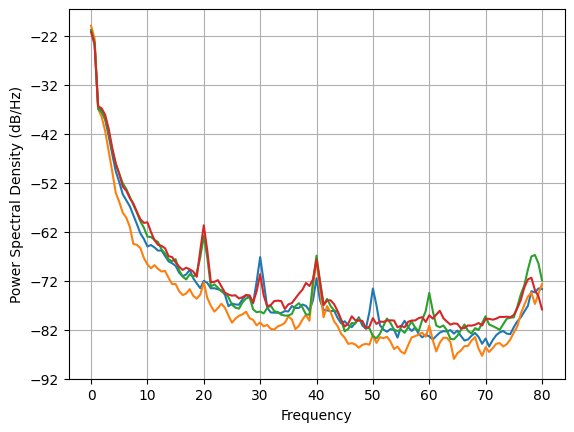

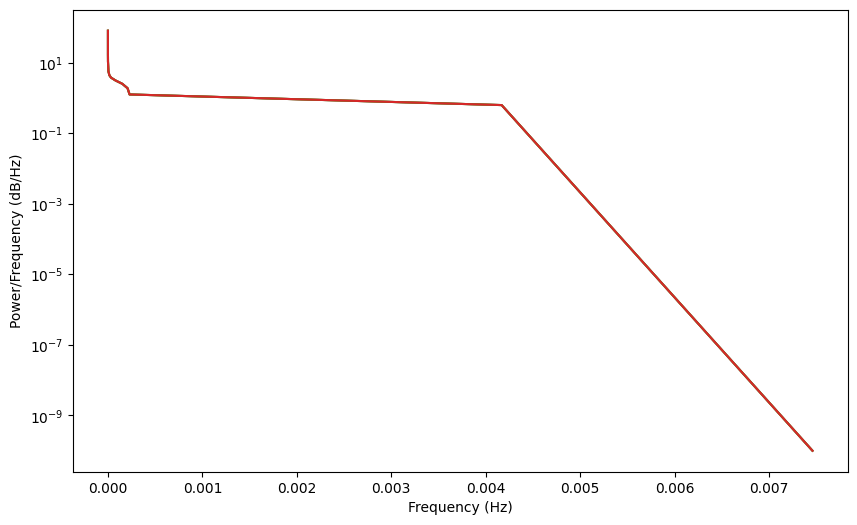

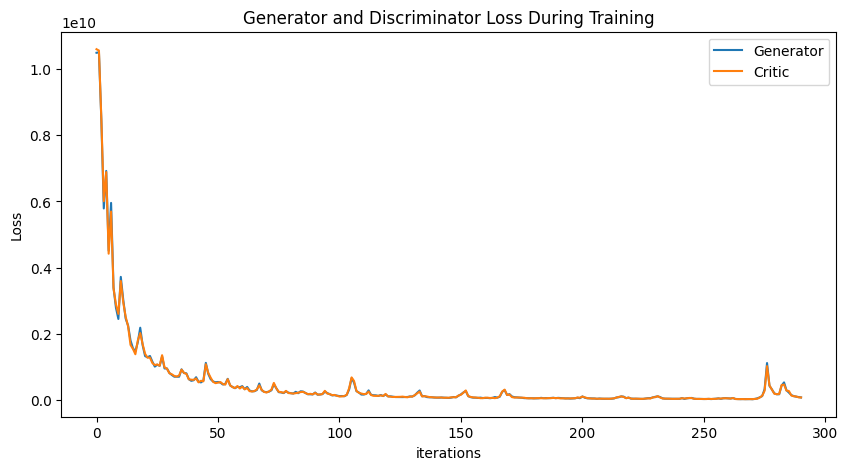

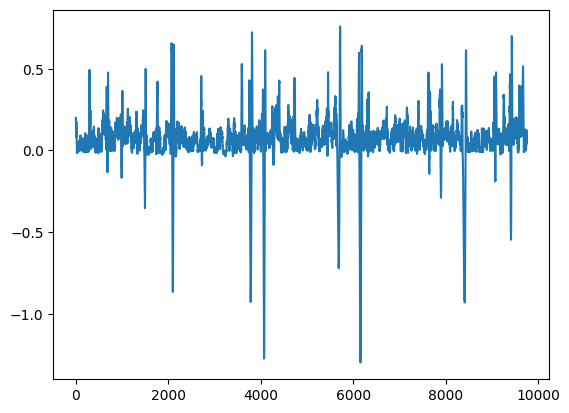

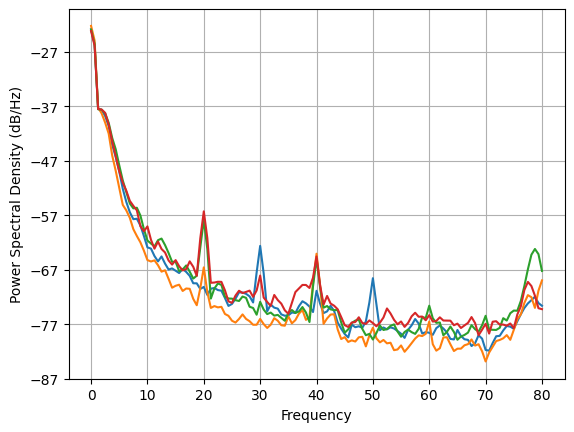

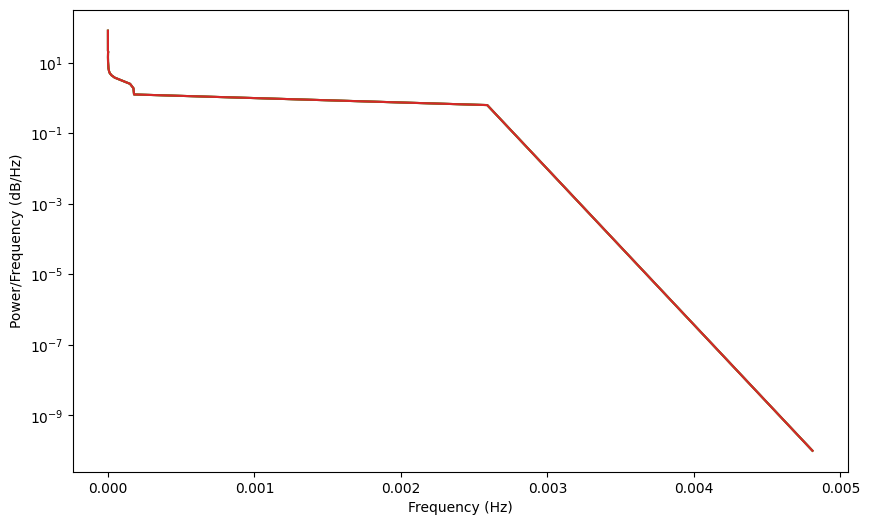

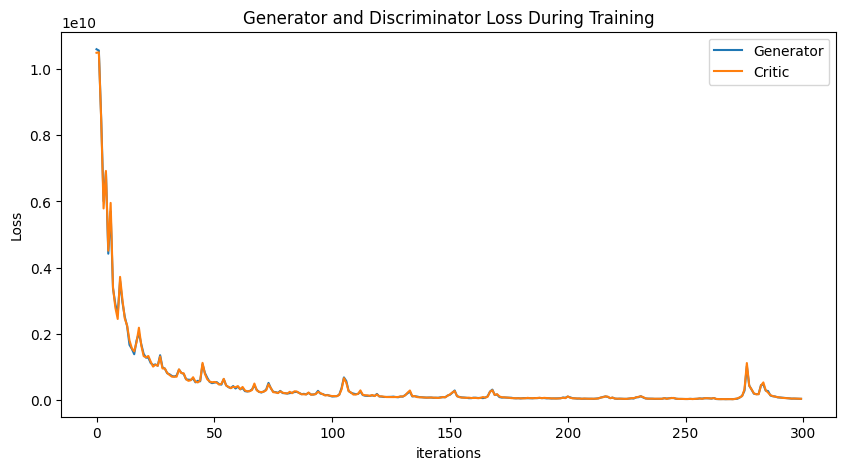

In [19]:
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)

def power_spectrum(x):
    fft_result = torch.fft.fft(x)
    return torch.abs(fft_result)**2

def train():
    critic_err, gen_err, generated_data = [], [], None
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        for _ in range(5):
            (real, ) = next(iter(train_loader))

            real.requires_grad=True
            noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
            fake = G(noise)

            psd_real = power_spectrum(real.detach()) # Detach so that these are not connected to generator's computation graph
            psd_fake = power_spectrum(fake.detach()) 

            # Calculate PSD Loss
            psd_loss = torch.mean((psd_real - psd_fake)**2)

            # Compute GP
            gp = gradient_penalty(D, real, fake.detach()) * LAMBDA_GP # Detach fake

            # Add GP to PSD Loss to form the critic's loss
            loss_critic = psd_loss + gp

            D.zero_grad()
            loss_critic.backward()
            critic_optimizer.step()

        # Generate new batch of fake data
        G.zero_grad()
        noise = sample_normal_distribution(BATCH_SIZE, 200, 305)
        fake = G(noise)

        # Calculate generator loss based on PSD of generated data compared to real data
        psd_real = power_spectrum(real) # Here we want to allow gradient flow to the generator
        psd_fake = power_spectrum(fake)
        loss_gen = torch.mean((psd_real - psd_fake)**2)
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated_data_closed, disc, gen = train()

torch.save(gen, 'generator-v11-6.pt')
torch.save(disc, 'discriminator-v11-6.pt')
np.save('closed-v11-6.npy', generated_data_closed.detach())
plot_everything(generated_data_closed, gen_err, critic_err)
generated_data_closed = None

# Using PSD loss in conjunction with wasstesterian loss, spectral_factor = 10,000

Epoch 0: Critic error ([7.150988175364745]) Generator err ([2.6795095983141692])
Epoch 0: Critic PSD error ([2.7388148044063687]) Generator PSD err ([2.7049210923904212])


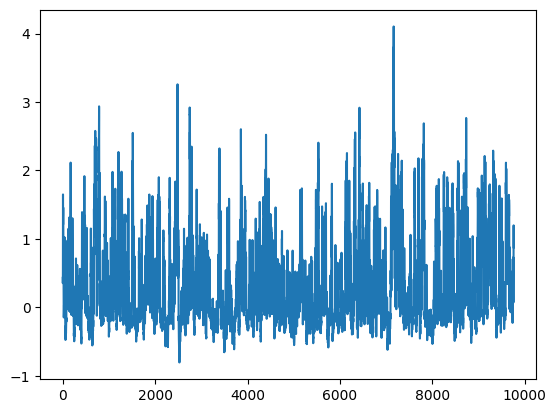

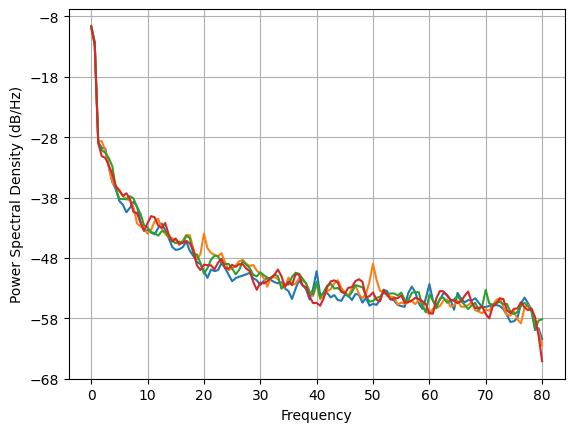

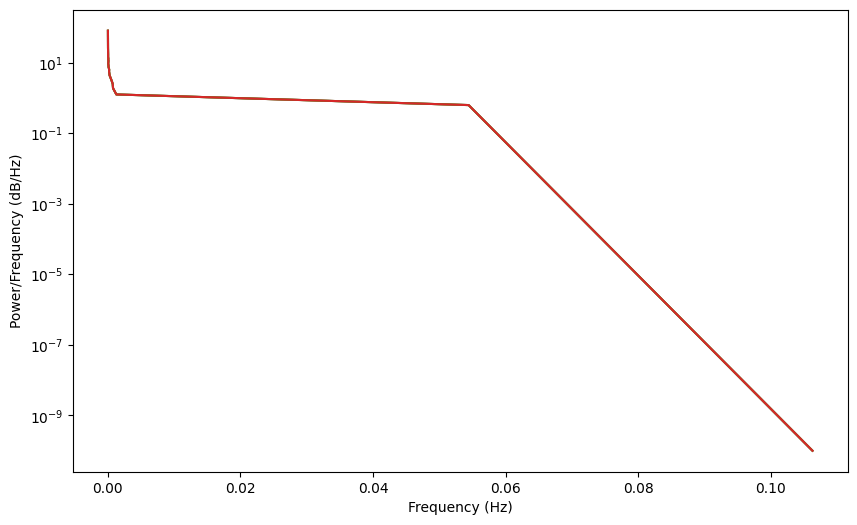

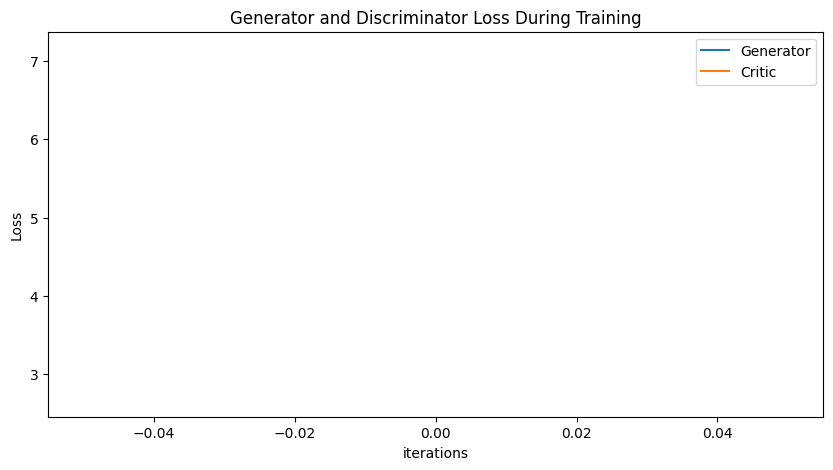

Epoch 10: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677]) Generator err ([2.6795095983141692, 5.35378087277354, 7.934534647420655, 12.321012574821449, 16.55404214576574, 31.556112763499918, 94.13677394965805, 75.78266816015179, 59.46386304557861, 44.093621843294564, 55.54541355293525])
Epoch 10: Critic PSD error ([2.7388148044063687, 5.448072056057754, 7.952326714360191, 9.600482270726161, 8.33582292452453, 5.376800837521629, 4.494204840491887, 1.4681559986309733, 0.7687021867245893, 0.8106839008485154, 0.297542567067218]) Generator PSD err ([2.7049210923904212, 5.466658144842994, 8.014190518215905, 9.5117896381912, 7.981395051039178, 5.471367356395427, 4.605829125439299, 1.4487829672806887, 0.7872196739965791, 0.8223701648277645, 0.28411823433173616])


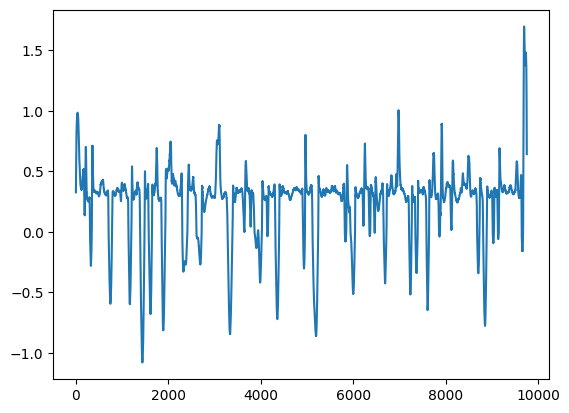

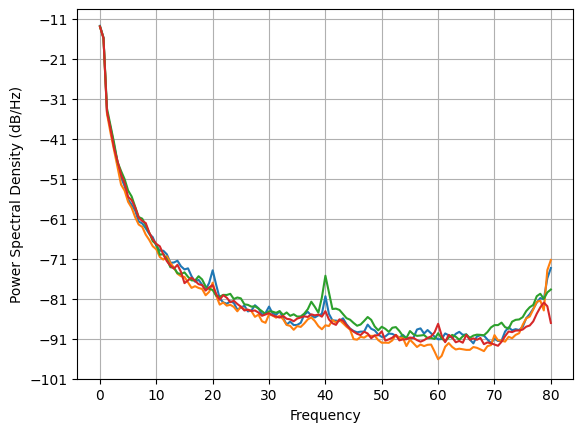

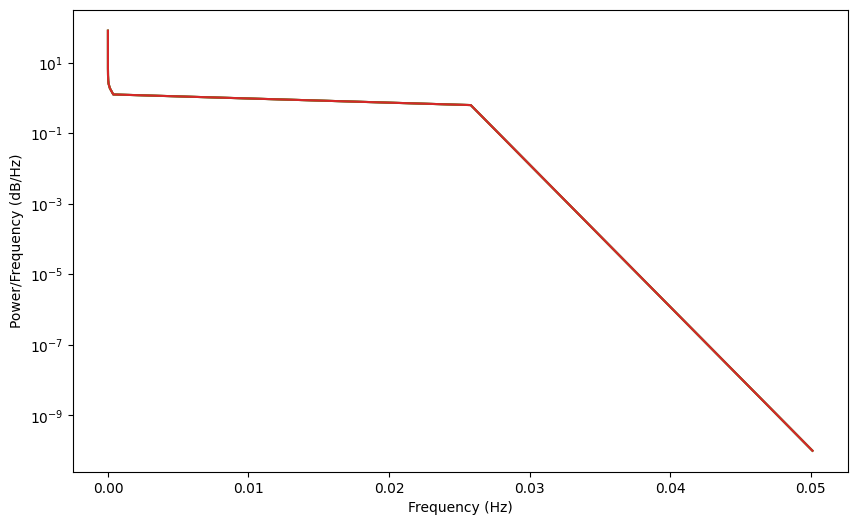

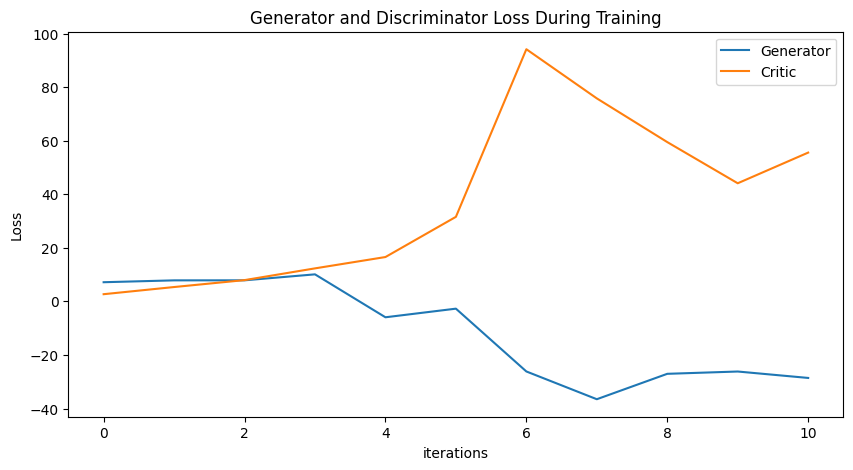

Epoch 20: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125]) Generator err ([2.6795095983141692, 5.35378087277354, 7.934534647420655, 12.321012574821449, 16.55404214576574, 31.556112763499918, 94.13677394965805, 75.78266816015179, 59.46386304557861, 44.093621843294564, 55.54541355293525, 43.06912054774262, 44.50182301879626, 44.18874573894466, 61.61647849102257, 38.88894510336404, 50.20399850140254, 65.29496270440791, 54.49994353390116, 40.765012442910766, 44.63536513212681])
Epoch 20: Critic PSD error ([2.7388148044063687, 5.448072056057754, 7.952326714360191, 9.600482270726161, 8.33582292452453, 5.

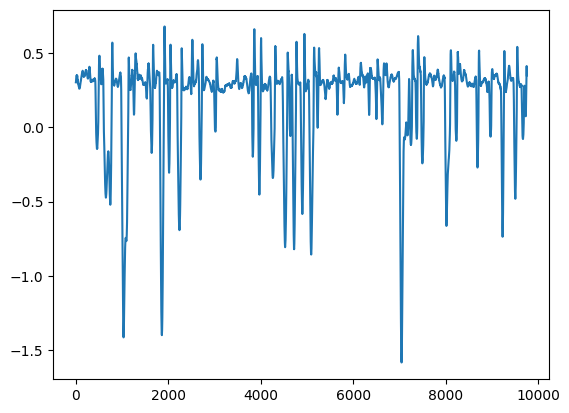

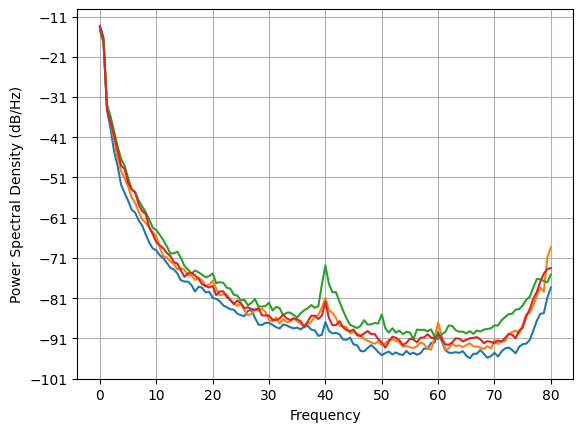

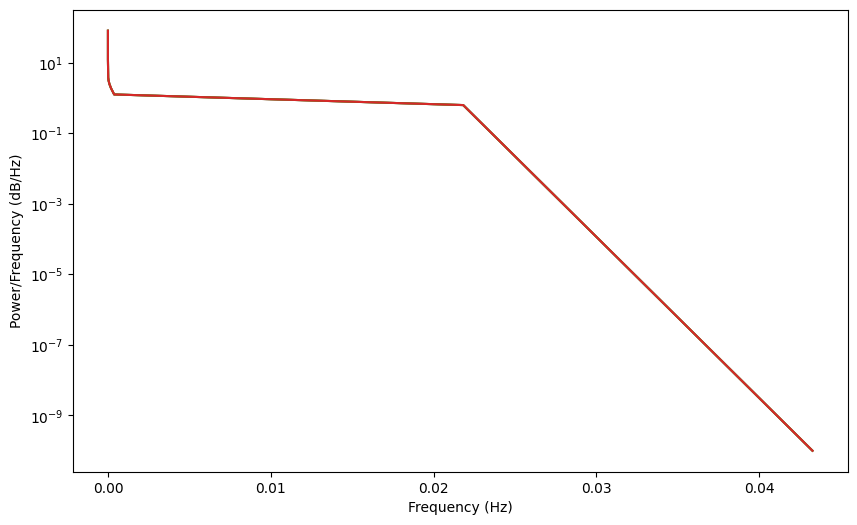

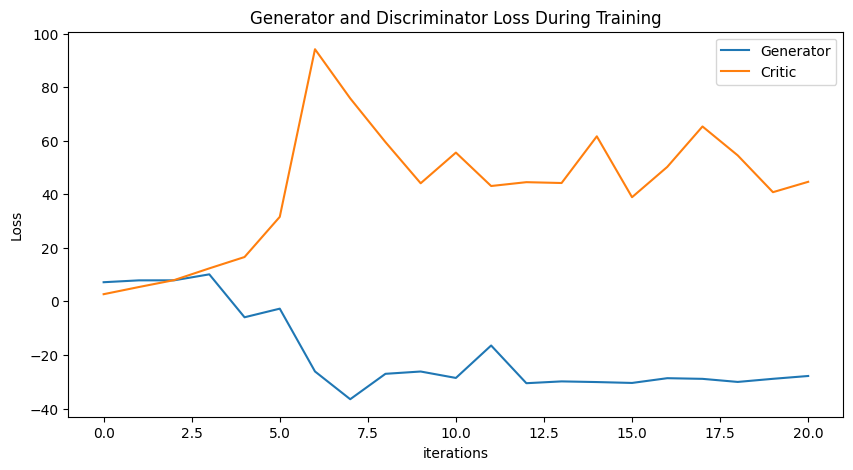

Epoch 30: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474]) Generator err ([2.6795095983141692, 5.35378087277354, 7.934534647420655, 12.321012574821449, 16.55404214576574, 31.556112763499918, 94.13677394965805, 75.78266816015179, 59.46386304557861, 44.093621843294564, 55.54541355293525, 43.06912054774262, 44.50182301879626, 44.18874573894466, 61.61647849102257, 38.88894510336404, 50.2039985014025

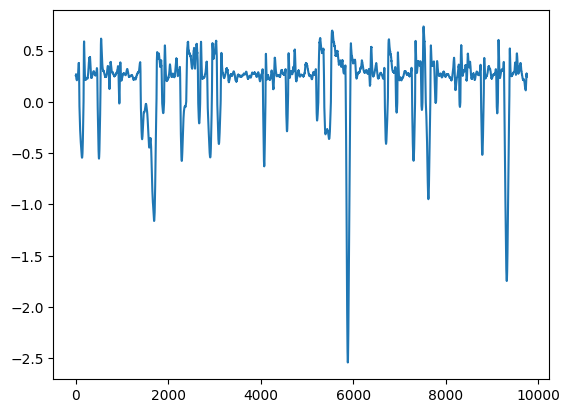

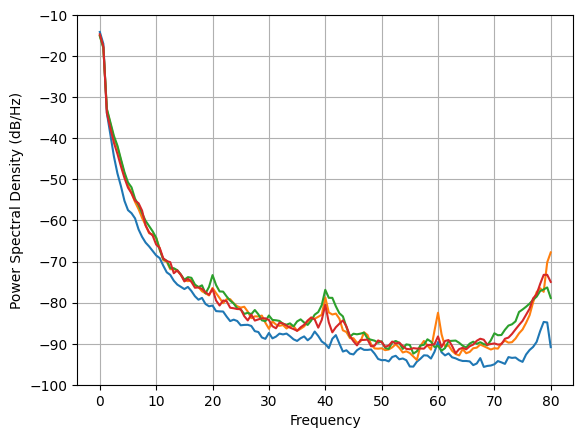

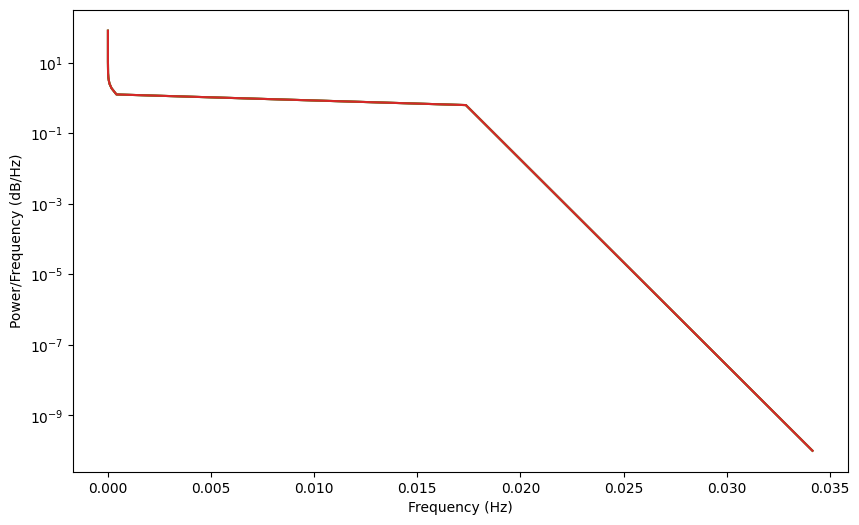

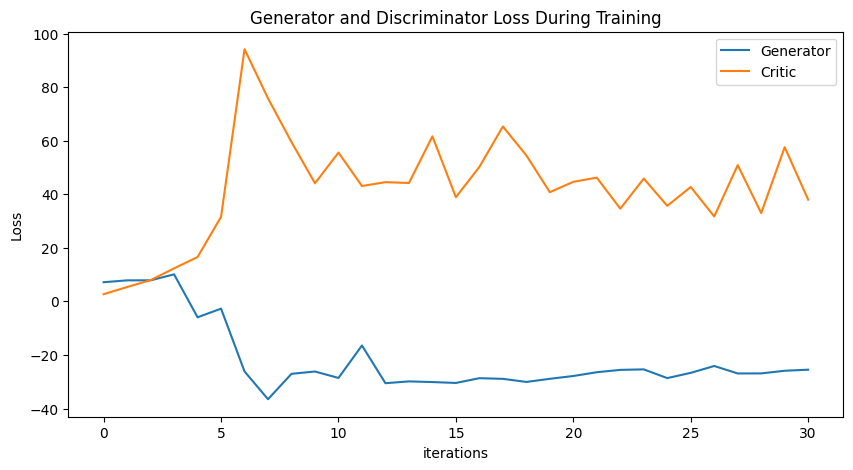

Epoch 40: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474, -23.160517212913305, -24.34100738024724, -22.67257180103816, -26.799833195957643, -24.714187719272857, -23.042875663309943, -21.5180934279341, -23.68906874564953, -26.800123215528295, -24.534852600200775]) Generator err ([2.6795095983141692, 5.35378087277354, 7.934534647420655, 12.321012574821449, 16.55404214576574, 31.556112763499918, 94

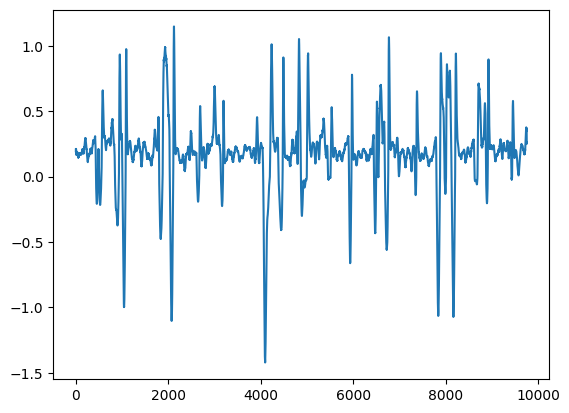

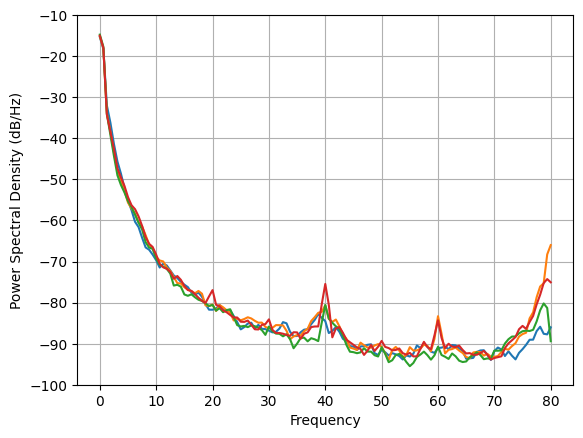

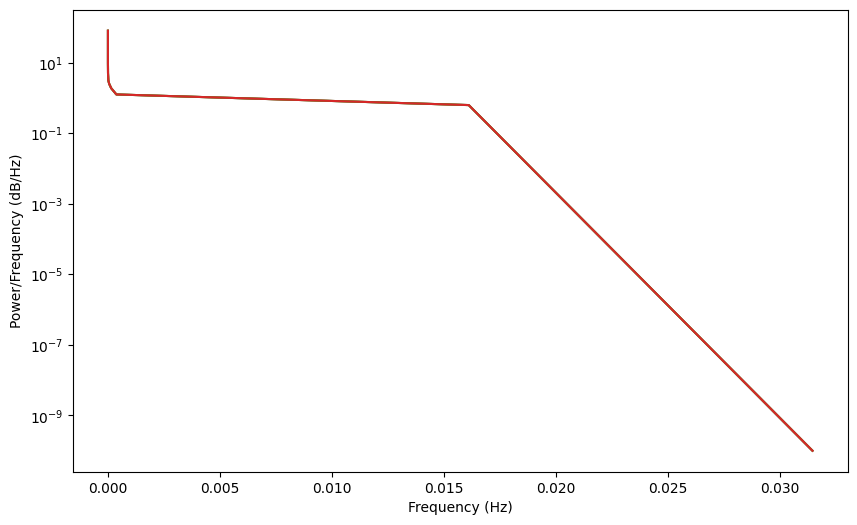

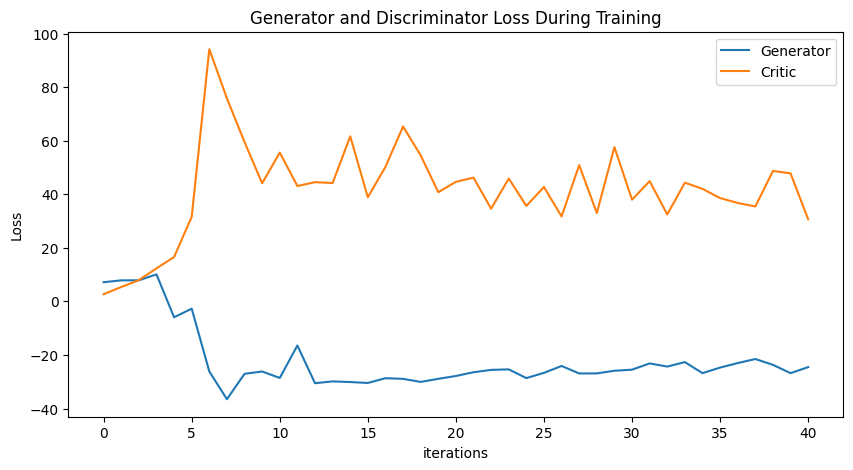

Epoch 50: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474, -23.160517212913305, -24.34100738024724, -22.67257180103816, -26.799833195957643, -24.714187719272857, -23.042875663309943, -21.5180934279341, -23.68906874564953, -26.800123215528295, -24.534852600200775, -23.183366524854797, -22.52058201085045, -21.09730899573666, -22.372050697332302, -21.56748684949493, -21.509331113861442, -20.51820303

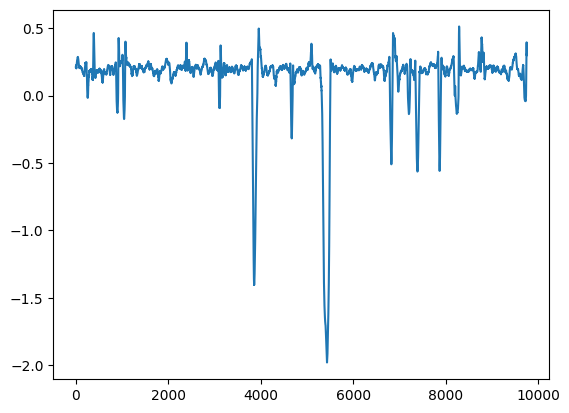

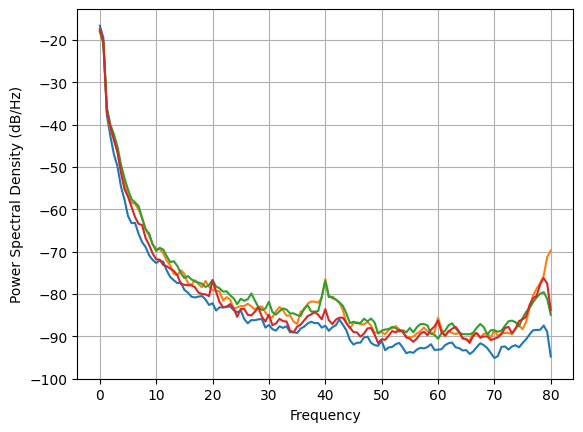

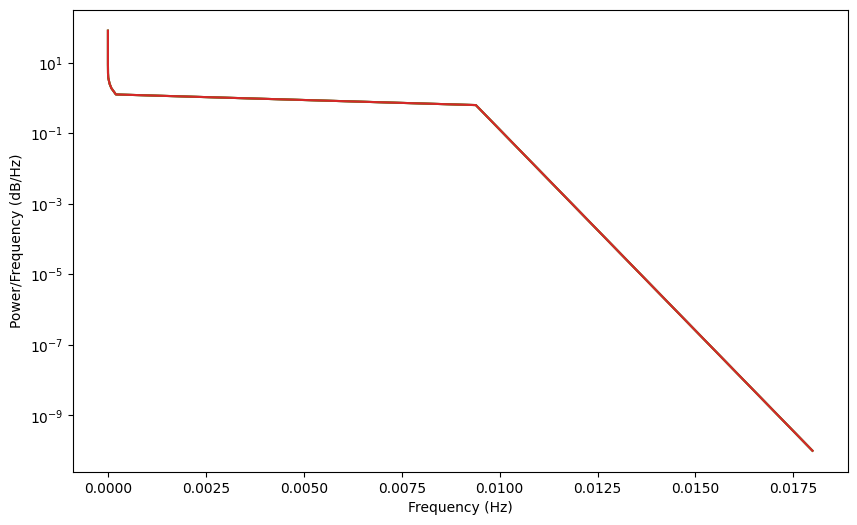

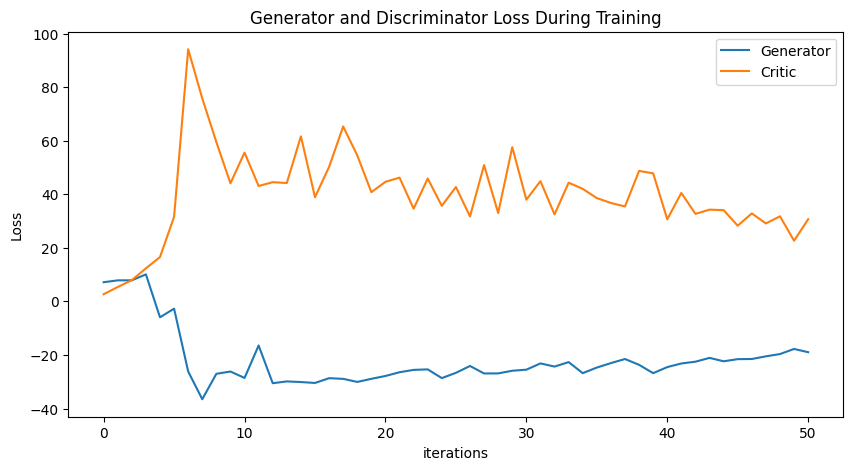

Epoch 60: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474, -23.160517212913305, -24.34100738024724, -22.67257180103816, -26.799833195957643, -24.714187719272857, -23.042875663309943, -21.5180934279341, -23.68906874564953, -26.800123215528295, -24.534852600200775, -23.183366524854797, -22.52058201085045, -21.09730899573666, -22.372050697332302, -21.56748684949493, -21.509331113861442, -20.51820303

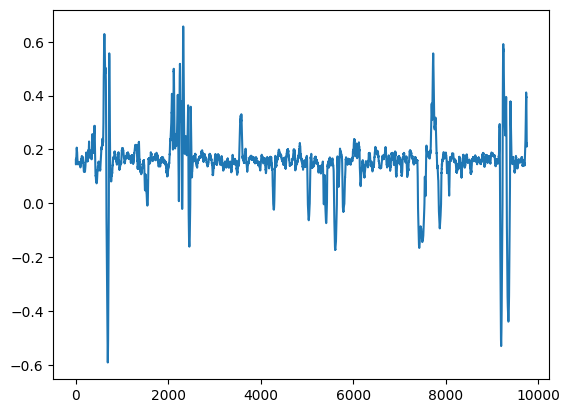

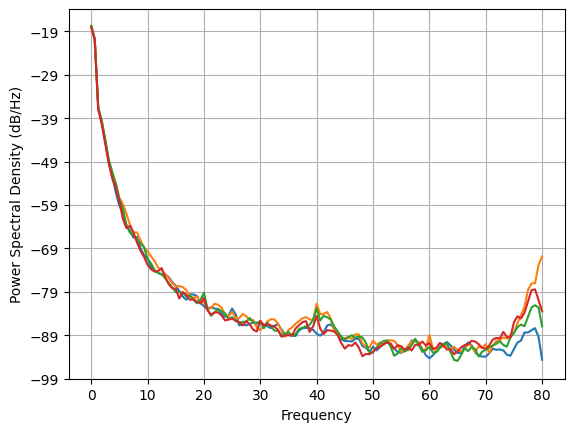

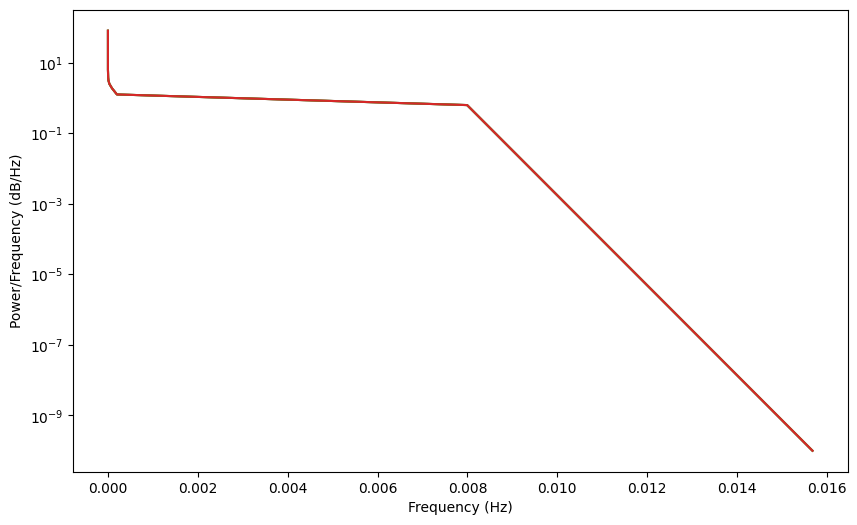

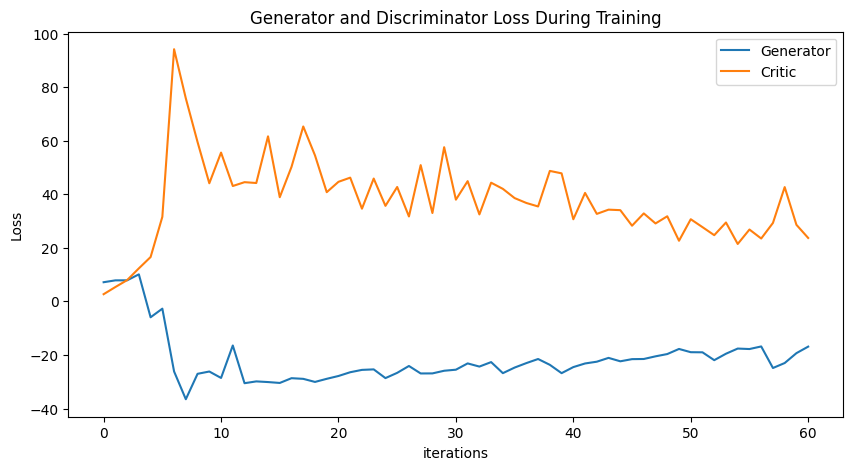

Epoch 70: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474, -23.160517212913305, -24.34100738024724, -22.67257180103816, -26.799833195957643, -24.714187719272857, -23.042875663309943, -21.5180934279341, -23.68906874564953, -26.800123215528295, -24.534852600200775, -23.183366524854797, -22.52058201085045, -21.09730899573666, -22.372050697332302, -21.56748684949493, -21.509331113861442, -20.51820303

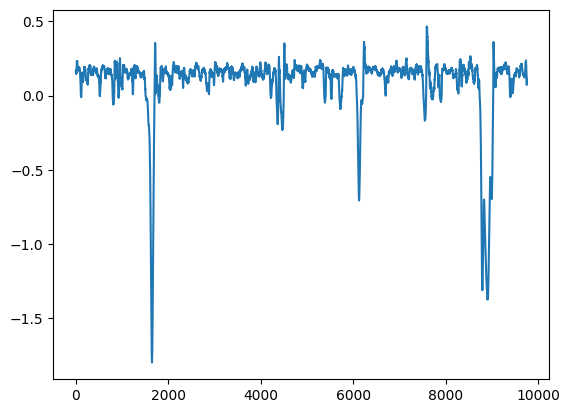

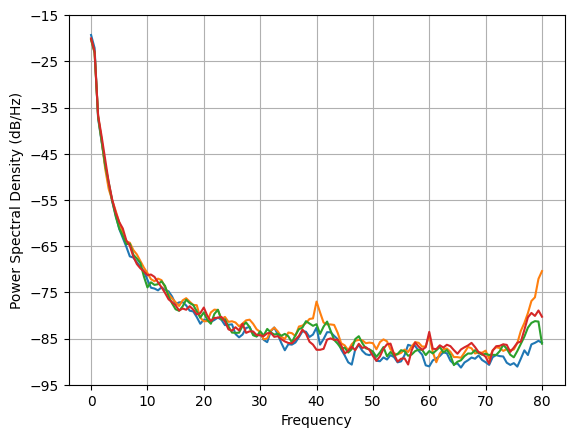

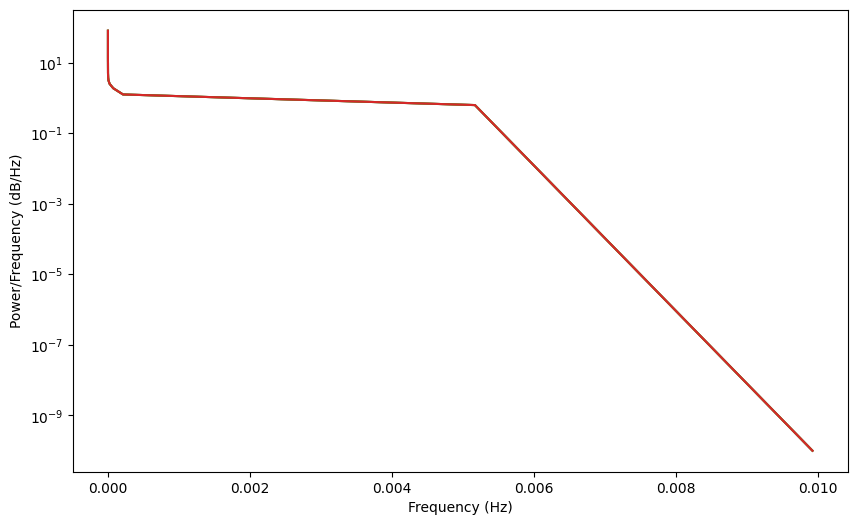

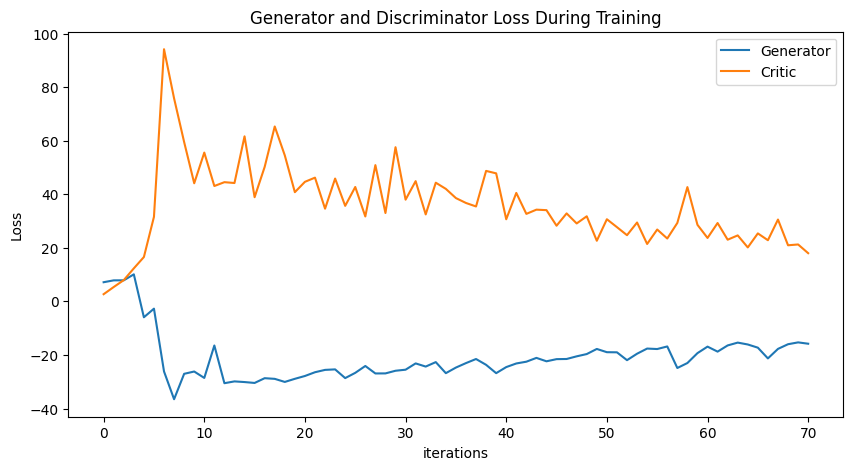

Epoch 80: Critic error ([7.150988175364745, 7.845015196137845, 7.859113661840739, 10.089246960205488, -5.9371913652006665, -2.720338831021185, -26.167580844956063, -36.53018805518069, -27.045975650718404, -26.186407078993568, -28.586309940211677, -16.472354652575977, -30.55010508704282, -29.875100879985872, -30.122957861229057, -30.45414177322418, -28.67826991315093, -28.92454663359648, -30.074270704805095, -28.910740686024678, -27.856529598373125, -26.452558745776084, -25.57791346549734, -25.390068918999187, -28.645048029902696, -26.683654032728583, -24.12058818428634, -26.910516975782876, -26.89116261560421, -25.900268119495024, -25.506070590317474, -23.160517212913305, -24.34100738024724, -22.67257180103816, -26.799833195957643, -24.714187719272857, -23.042875663309943, -21.5180934279341, -23.68906874564953, -26.800123215528295, -24.534852600200775, -23.183366524854797, -22.52058201085045, -21.09730899573666, -22.372050697332302, -21.56748684949493, -21.509331113861442, -20.51820303

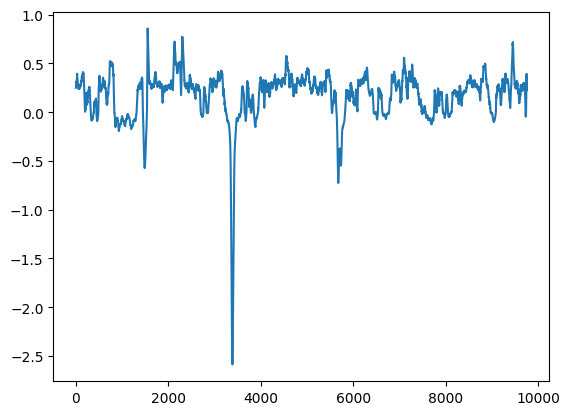

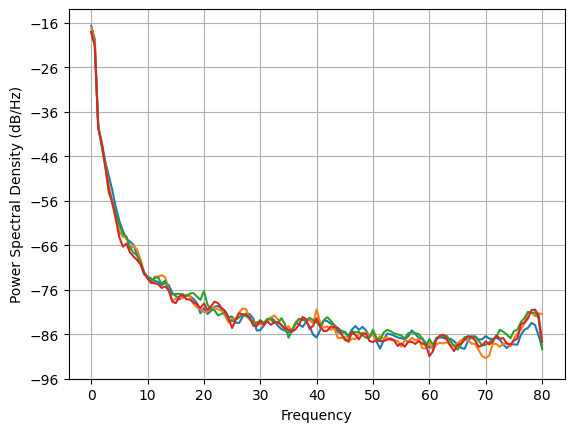

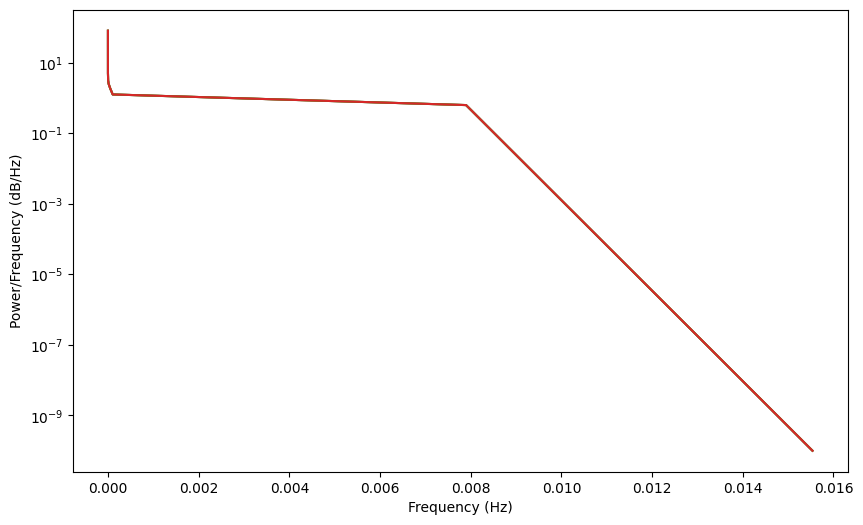

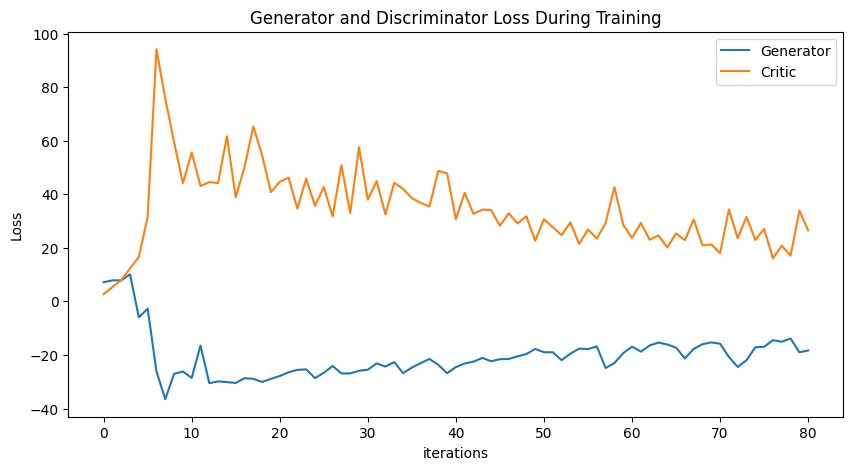

KeyboardInterrupt: 

In [3]:
SPECTRAL_FACTOR = 10000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=nperseg, noverlap=noverlap)
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-7.pt')
torch.save(disc, 'discriminator-v11-7.pt')
np.save('closed-v11-7.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# incorporate PSD loss only to generator, spectral_factor = 10,000

In [ ]:
SPECTRAL_FACTOR = 10000
NUM_EPOCHS = 200
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=nperseg, noverlap=noverlap)
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP)
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-8.pt')
torch.save(disc, 'discriminator-v11-8.pt')
np.save('closed-v11-8.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# incorporate PSD loss to both G and D, spectral_factor = 1,000

In [ ]:
SPECTRAL_FACTOR = 1000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=nperseg, noverlap=noverlap)
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-9.pt')
torch.save(disc, 'discriminator-v11-9.pt')
np.save('closed-v11-9.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# incorporate PSD loss to both G and D, spectral_factor = 1,000,000

Epoch 0: Critic error ([286.6660539953674]) Generator err ([399.7809977349929])
Epoch 0: Critic PSD error ([291.76595163488395]) Generator PSD err ([294.7048487481765])


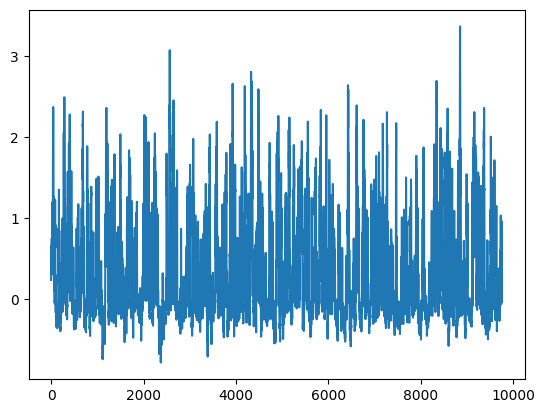

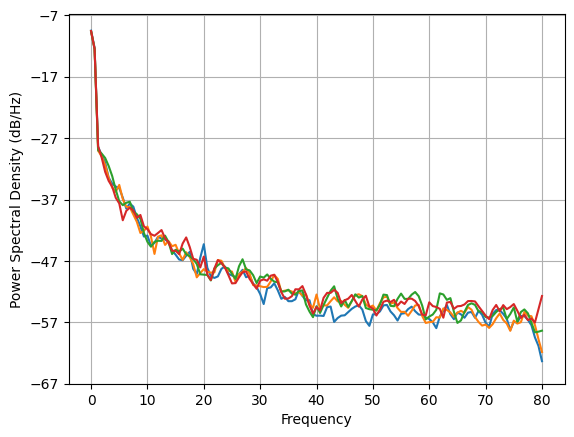

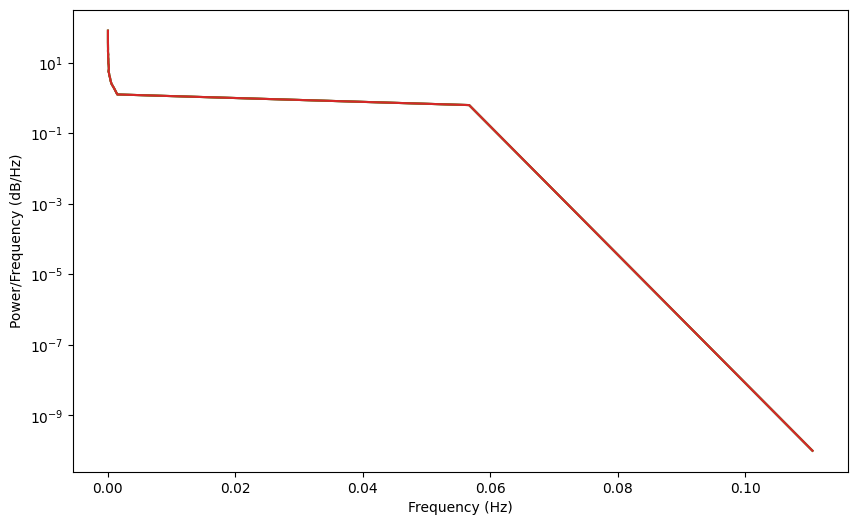

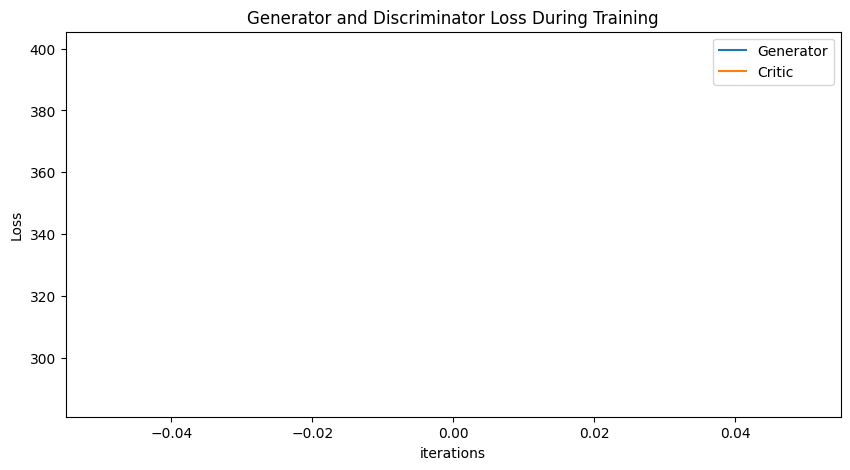

Epoch 10: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634]) Generator err ([399.7809977349929, 377.39092331262464, 228.84371321758164, 226.7685231249546, 223.66546996597577, 209.16167925251943, 384.4353461274054, 280.6334856432113, 195.59804886619975, 138.26235079272732, 117.24155445525017])
Epoch 10: Critic PSD error ([291.76595163488395, 360.34935747846924, 205.22696307247972, 197.13235703239994, 182.60740066347716, 180.38037866129557, 272.82571221580395, 162.8649919846113, 82.91507270599804, 17.51925921781394, 35.095455900253086]) Generator PSD err ([294.7048487481765, 367.27972393365735, 201.32934516033066, 207.31259241511574, 188.08731444839765, 164.00365160359365, 263.87167883004213, 165.331895677391, 87.78644913475445, 17.440855736574964, 35.30925770232049])


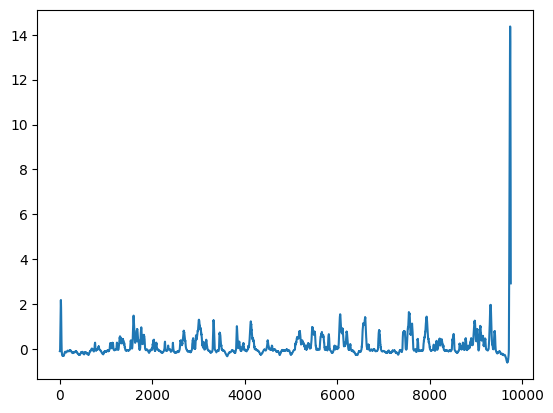

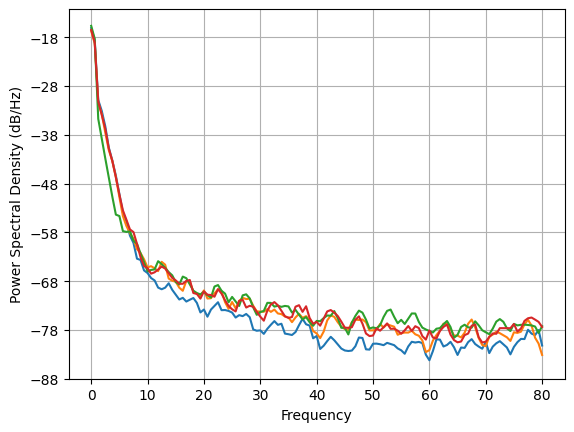

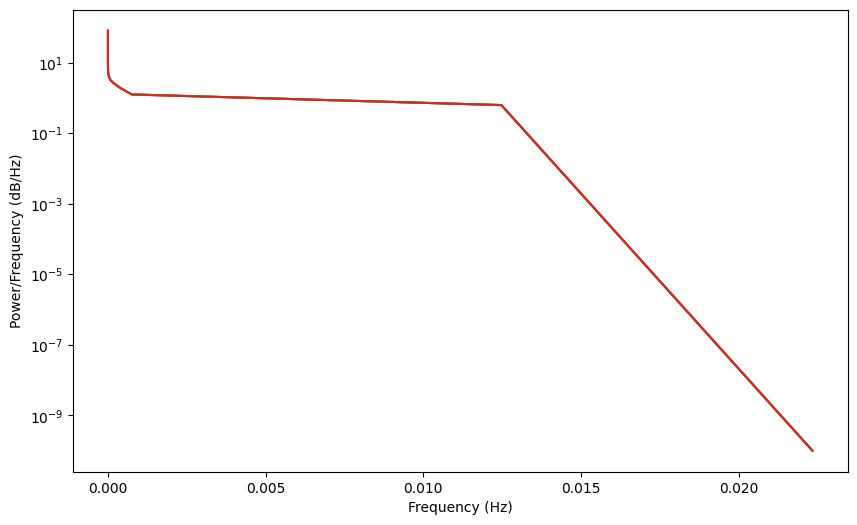

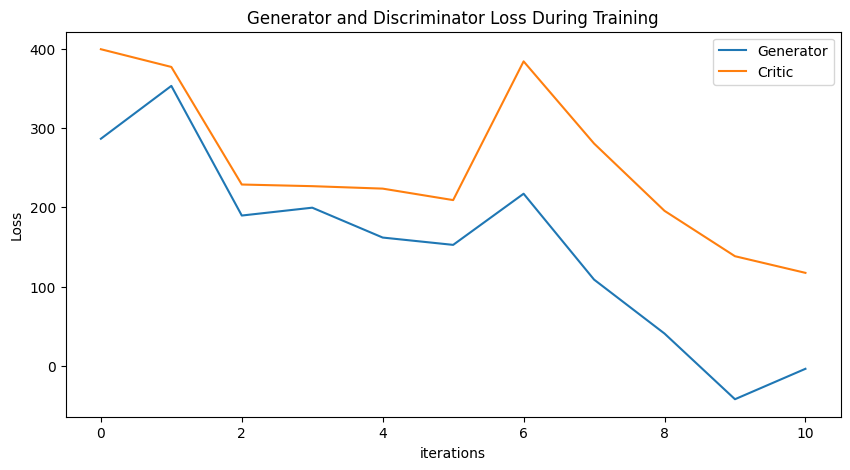

Epoch 20: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634, -78.36623283147271, -53.51010100771506, 12.025537229919378, 17.36519422817394, -14.922645083900612, -15.379641570795515, -14.227163123728197, -14.674974314157263, -14.678859271641745, -16.558601700191836]) Generator err ([399.7809977349929, 377.39092331262464, 228.84371321758164, 226.7685231249546, 223.66546996597577, 209.16167925251943, 384.4353461274054, 280.6334856432113, 195.59804886619975, 138.26235079272732, 117.24155445525017, 151.2445928816499, 102.96085538202979, 28.368183992310627, 121.92787840181994, 42.26492155730701, 29.747366135793186, 25.853484195820123, 26.17789600660853, 24.150916035646688, 28.361169015996015])
Epoch 20: Critic PSD error ([291.76595163488395, 360.34935747846924, 205.22696307247972, 197.13235703239994, 182.607400

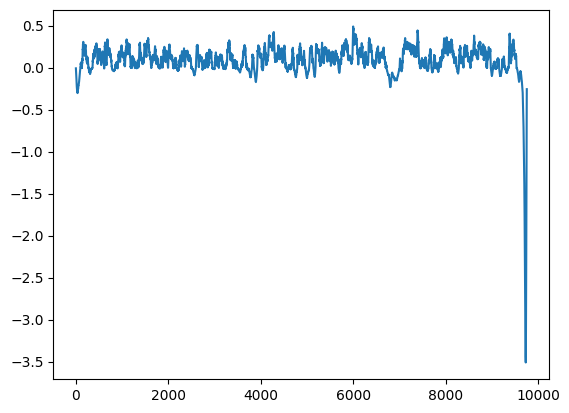

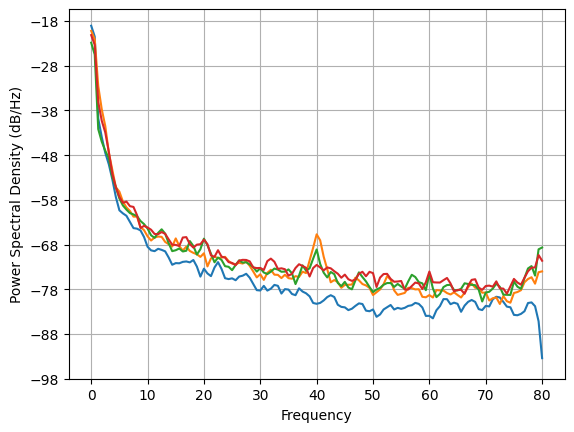

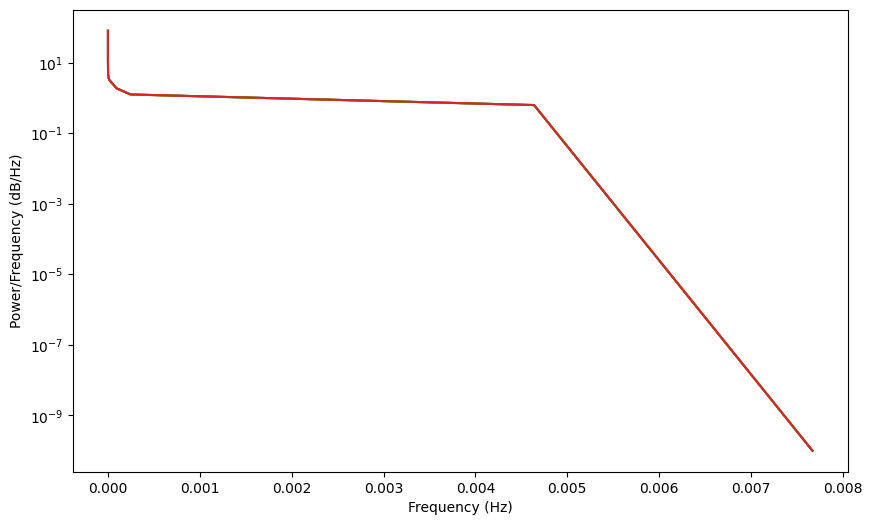

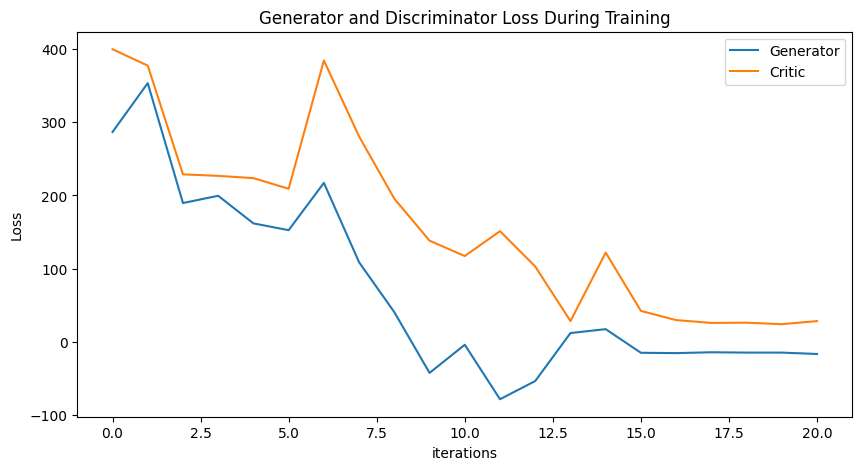

Epoch 30: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634, -78.36623283147271, -53.51010100771506, 12.025537229919378, 17.36519422817394, -14.922645083900612, -15.379641570795515, -14.227163123728197, -14.674974314157263, -14.678859271641745, -16.558601700191836, -15.029621791686397, -14.90983683241924, -14.692384179603206, -14.474072285542782, -14.69074986165871, -14.438973766180258, -16.56839224658558, -15.171658124142793, -14.45318442693249, -14.707525821141092]) Generator err ([399.7809977349929, 377.39092331262464, 228.84371321758164, 226.7685231249546, 223.66546996597577, 209.16167925251943, 384.4353461274054, 280.6334856432113, 195.59804886619975, 138.26235079272732, 117.24155445525017, 151.2445928816499, 102.96085538202979, 28.368183992310627, 121.92787840181994, 42.26492155730701, 29.7473661357

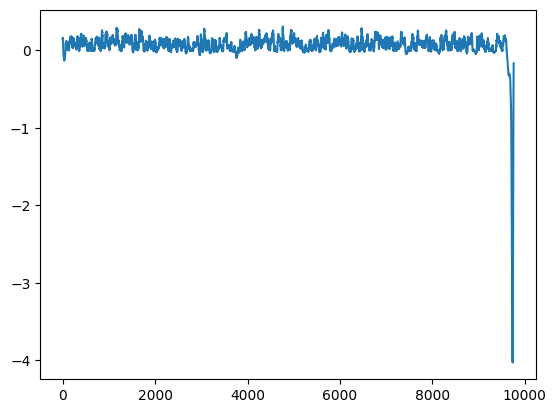

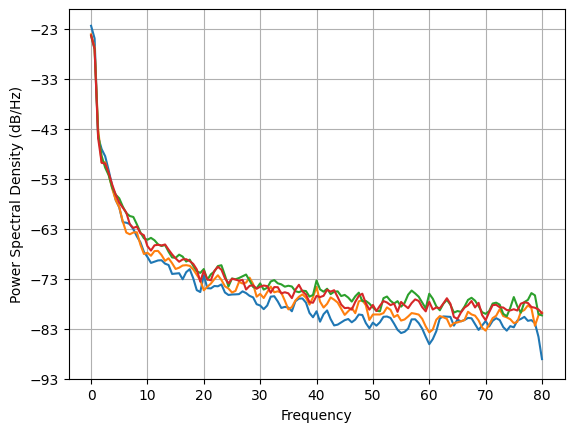

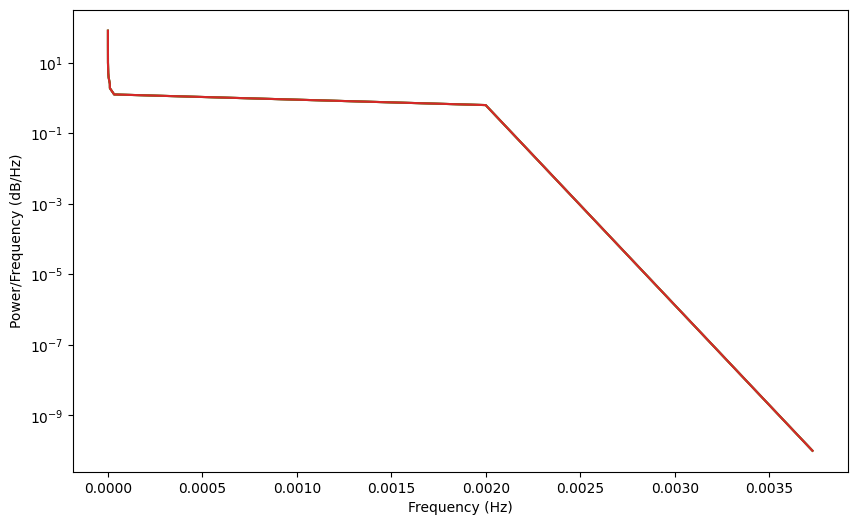

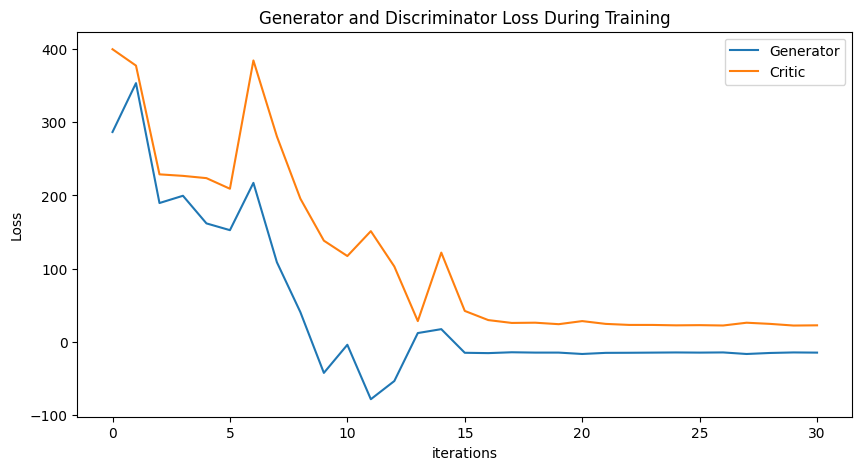

Epoch 40: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634, -78.36623283147271, -53.51010100771506, 12.025537229919378, 17.36519422817394, -14.922645083900612, -15.379641570795515, -14.227163123728197, -14.674974314157263, -14.678859271641745, -16.558601700191836, -15.029621791686397, -14.90983683241924, -14.692384179603206, -14.474072285542782, -14.69074986165871, -14.438973766180258, -16.56839224658558, -15.171658124142793, -14.45318442693249, -14.707525821141092, -14.50771824588397, -14.573966739671206, -14.310932217187457, -14.729971295163763, -14.434326114244161, -14.55022849593539, -14.437408860615488, -14.60534167367407, -14.682297104854246, -14.75946678649431]) Generator err ([399.7809977349929, 377.39092331262464, 228.84371321758164, 226.7685231249546, 223.66546996597577, 209.16167925251943, 384

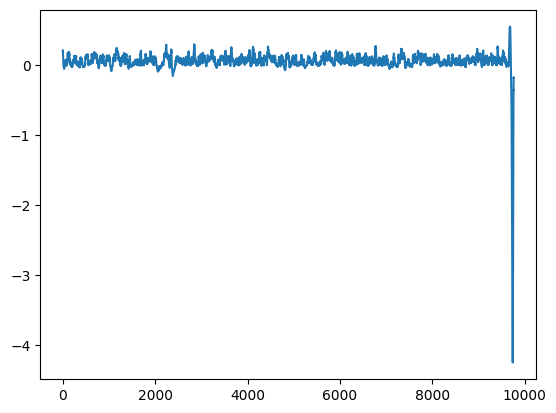

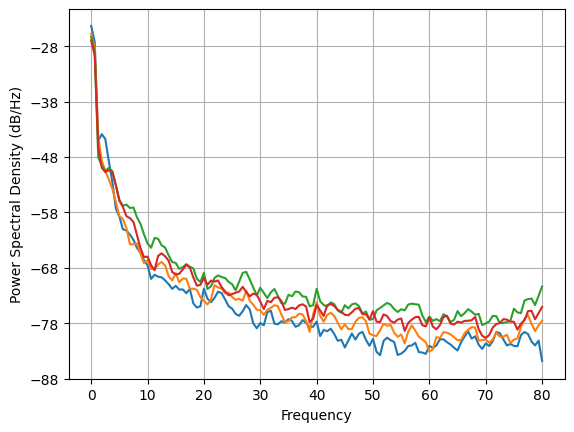

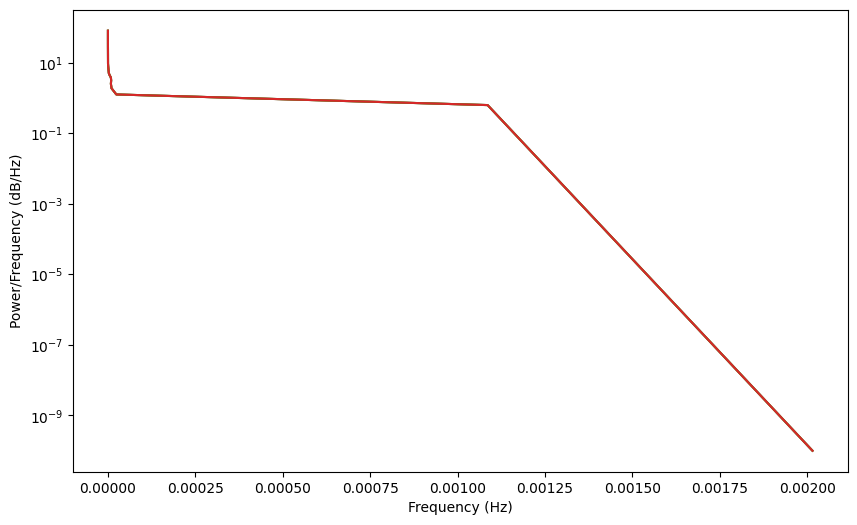

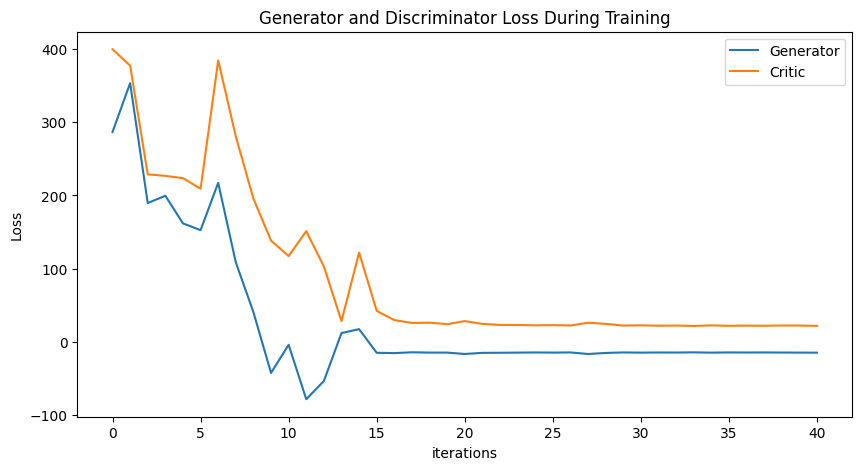

Epoch 50: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634, -78.36623283147271, -53.51010100771506, 12.025537229919378, 17.36519422817394, -14.922645083900612, -15.379641570795515, -14.227163123728197, -14.674974314157263, -14.678859271641745, -16.558601700191836, -15.029621791686397, -14.90983683241924, -14.692384179603206, -14.474072285542782, -14.69074986165871, -14.438973766180258, -16.56839224658558, -15.171658124142793, -14.45318442693249, -14.707525821141092, -14.50771824588397, -14.573966739671206, -14.310932217187457, -14.729971295163763, -14.434326114244161, -14.55022849593539, -14.437408860615488, -14.60534167367407, -14.682297104854246, -14.75946678649431, -15.04020861383586, -14.83498835004547, -14.389461378502075, -14.858553517148222, -14.500276941507101, -14.641754988030408, -14.6233067381

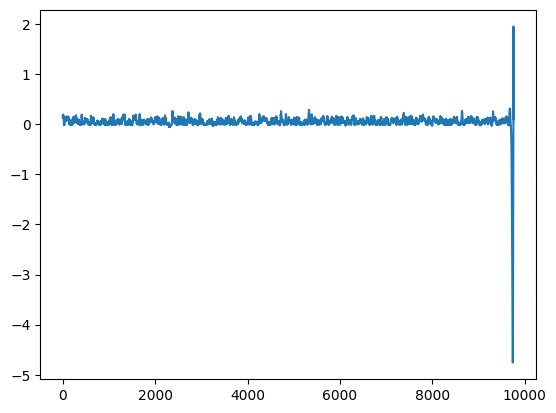

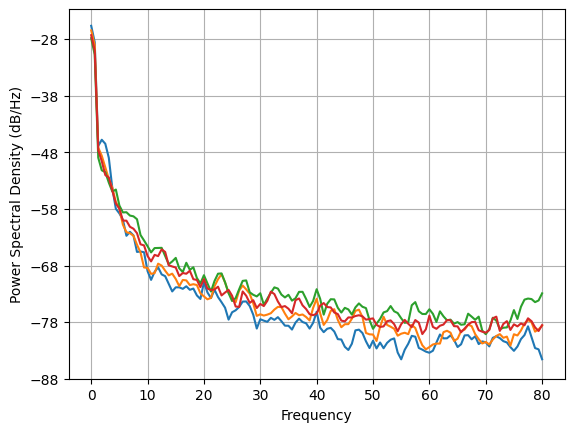

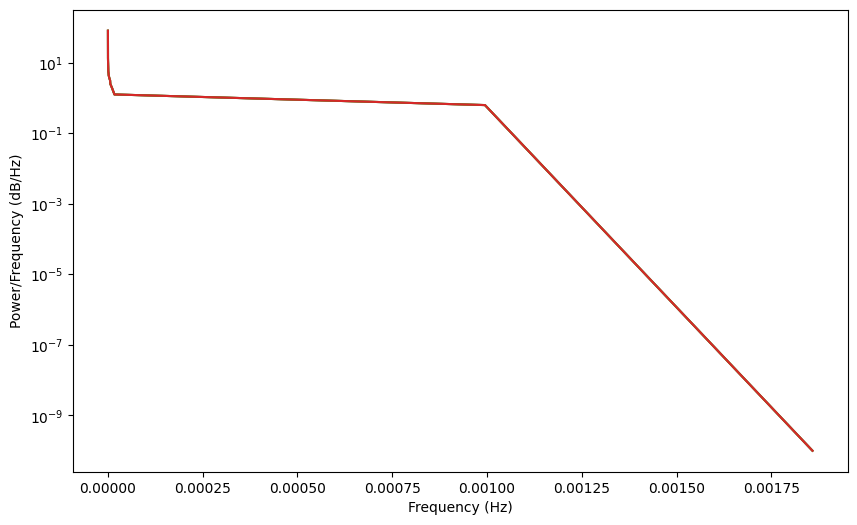

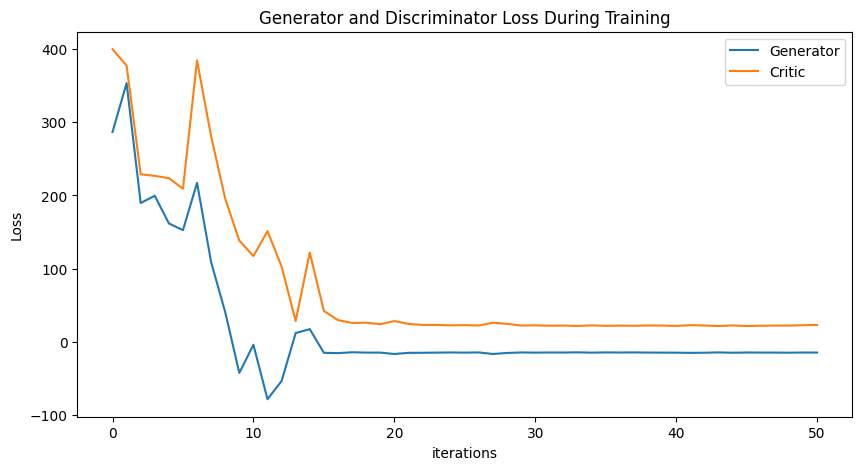

Epoch 60: Critic error ([286.6660539953674, 353.45359775629925, 189.65560596933645, 199.58095245162065, 161.84064321563687, 152.59010140092613, 217.20845419871006, 108.74093760850059, 40.55773306643305, -42.408052735027596, -3.9819118523031634, -78.36623283147271, -53.51010100771506, 12.025537229919378, 17.36519422817394, -14.922645083900612, -15.379641570795515, -14.227163123728197, -14.674974314157263, -14.678859271641745, -16.558601700191836, -15.029621791686397, -14.90983683241924, -14.692384179603206, -14.474072285542782, -14.69074986165871, -14.438973766180258, -16.56839224658558, -15.171658124142793, -14.45318442693249, -14.707525821141092, -14.50771824588397, -14.573966739671206, -14.310932217187457, -14.729971295163763, -14.434326114244161, -14.55022849593539, -14.437408860615488, -14.60534167367407, -14.682297104854246, -14.75946678649431, -15.04020861383586, -14.83498835004547, -14.389461378502075, -14.858553517148222, -14.500276941507101, -14.641754988030408, -14.6233067381

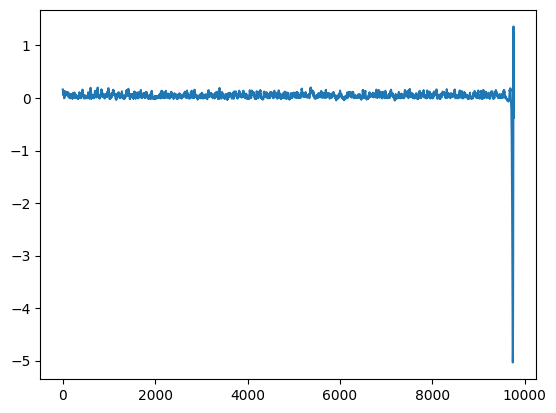

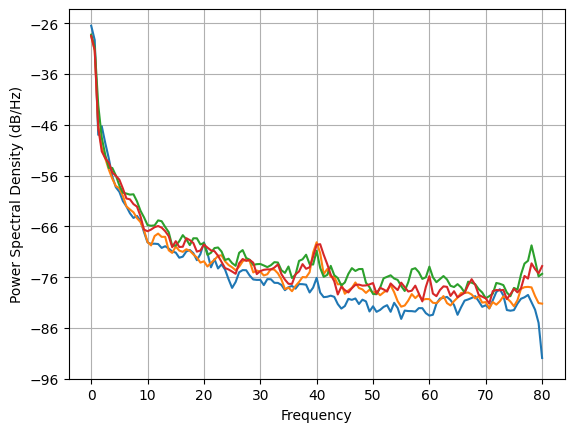

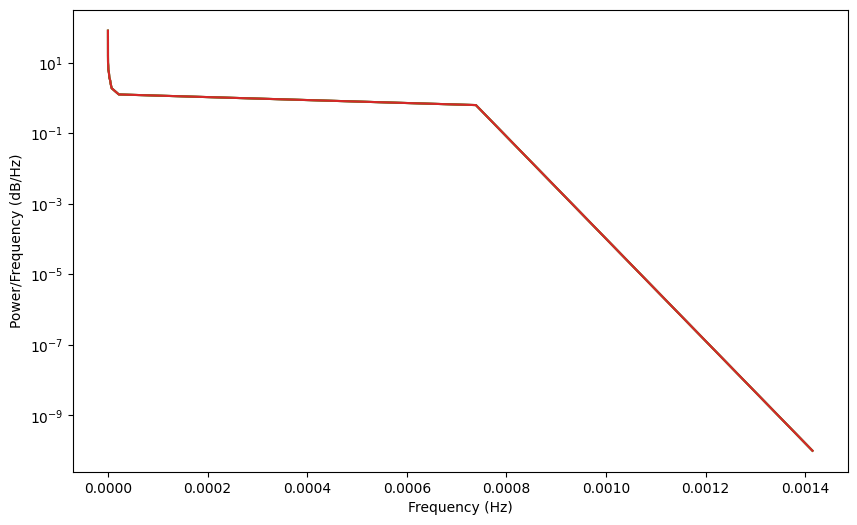

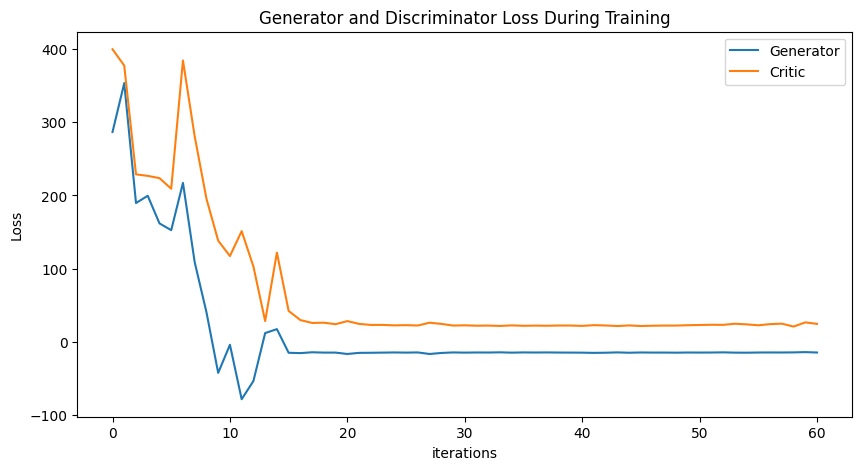

KeyboardInterrupt: 

In [4]:
SPECTRAL_FACTOR = 1000000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=nperseg, noverlap=noverlap)
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-10.pt')
torch.save(disc, 'discriminator-v11-10.pt')
np.save('closed-v11-10.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# incorporate PSD loss only to generator, spectral_factor = 100,000

Epoch 0: Critic error ([0.012012032363126035]) Generator err ([25.56433717534529])
Epoch 0: Generator PSD err ([24.27234761044966])


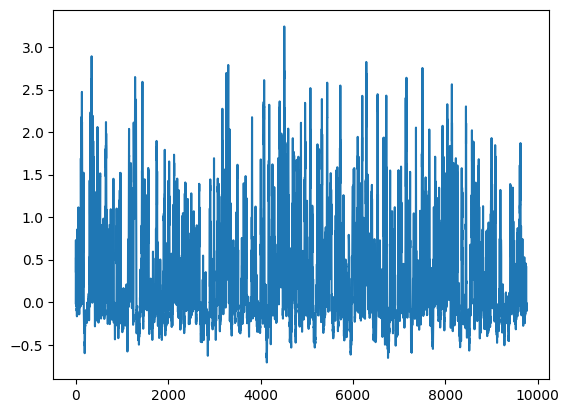

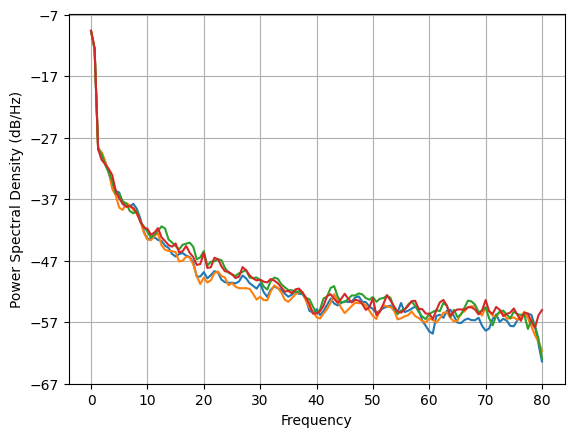

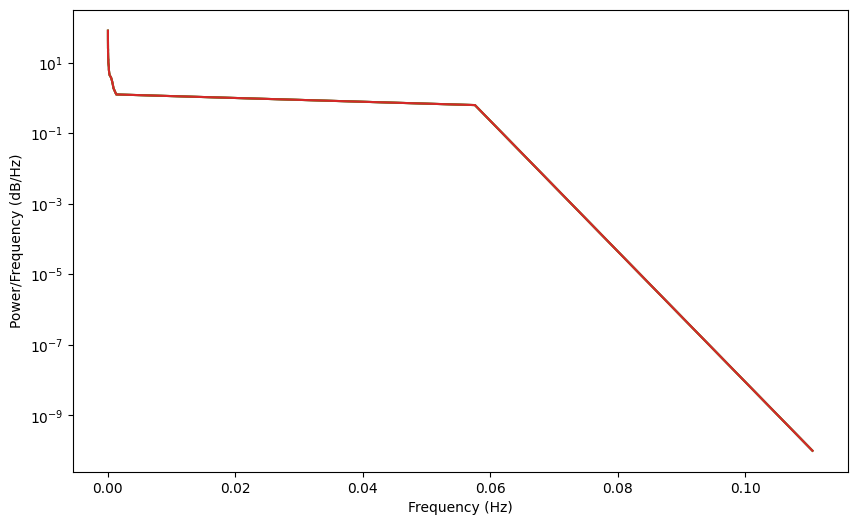

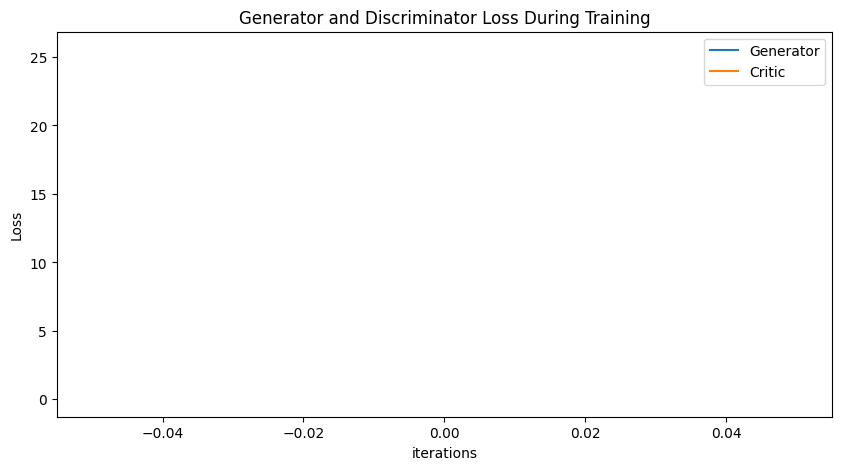

Epoch 10: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084]) Generator err ([25.56433717534529, 50.715415423482256, 53.40506603670262, 33.67814452758826, 98.00273495554327, 68.39790614128471, 99.2557193164845, 140.13629095427126, 40.62203866366052, 105.71741958013257, 89.92021689735863])
Epoch 10: Generator PSD err ([24.27234761044966, 41.745192950337724, 42.92873146486424, 25.409438205871954, 15.142833527320617, 18.136919813159707, 12.008465898515754, 29.61380712858768, 8.212717832361692, 4.77977462163647, 5.6671880277297175])


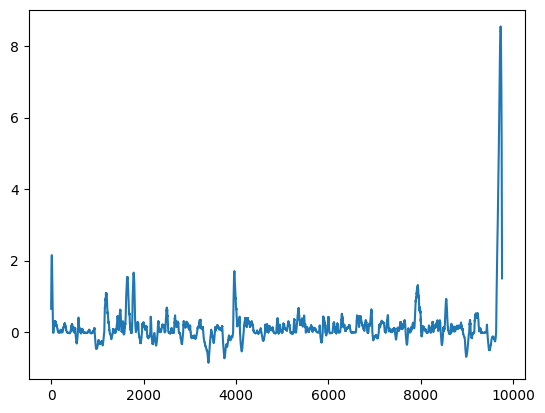

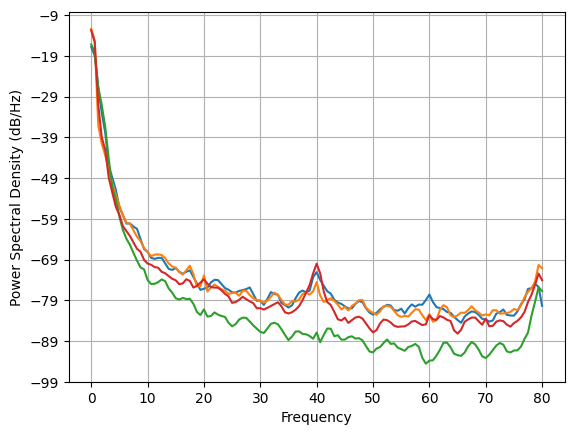

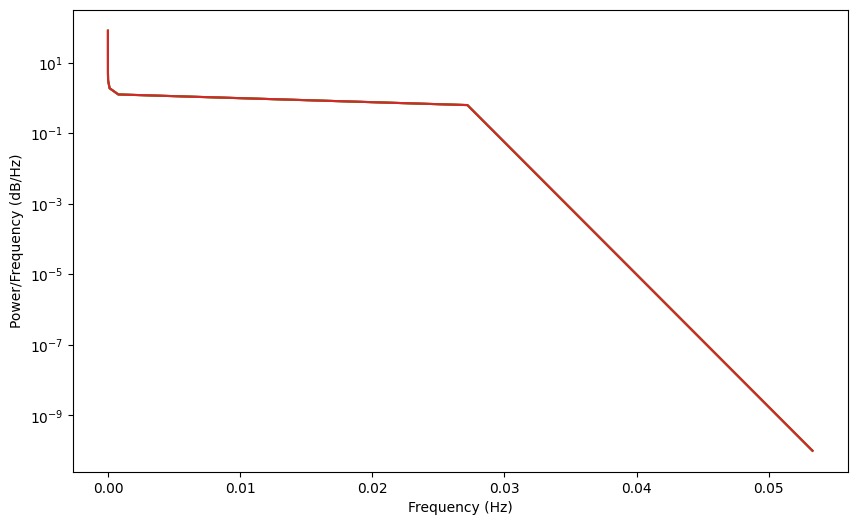

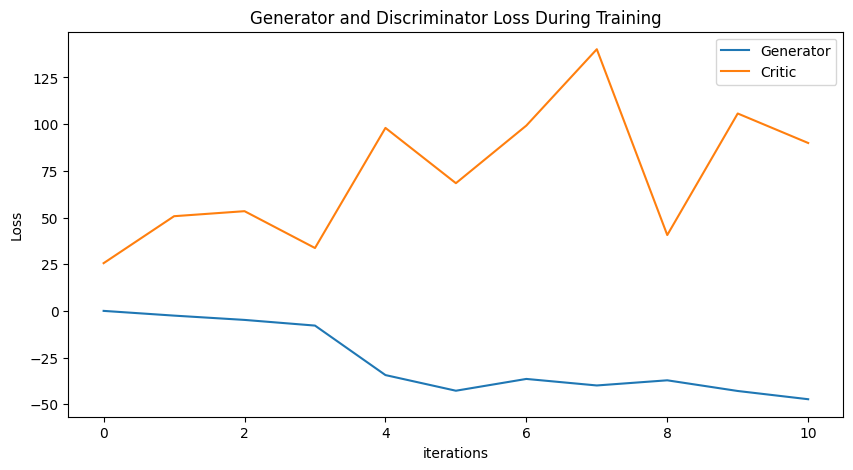

Epoch 20: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665]) Generator err ([25.56433717534529, 50.715415423482256, 53.40506603670262, 33.67814452758826, 98.00273495554327, 68.39790614128471, 99.2557193164845, 140.13629095427126, 40.62203866366052, 105.71741958013257, 89.92021689735863, 77.02974441342968, 82.56842208293453, 76.18960104449667, 88.67248576538098, 101.74170699961357, 70.030536628412, 103.5028769554335, 85.24591236976106, 103.81977754227941, 83.61730770723555])
Epoch 20: Generator PSD err ([24.27234761044966, 41.745192950337724, 42.92873146486424, 25.409438205871954, 15.142833527320617, 18.

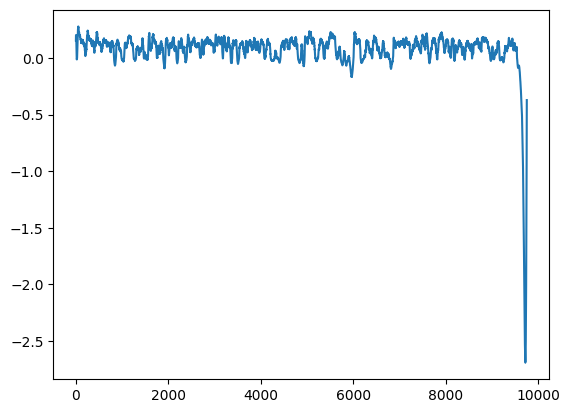

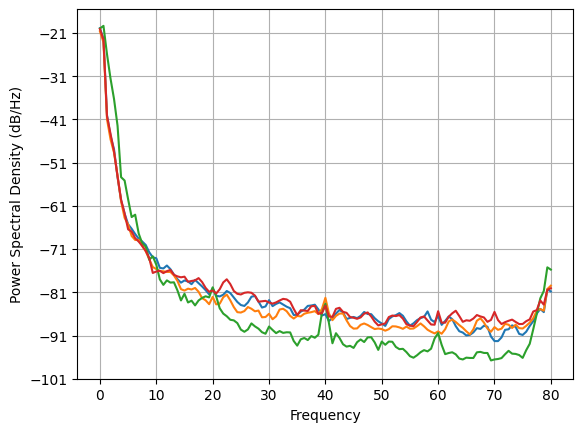

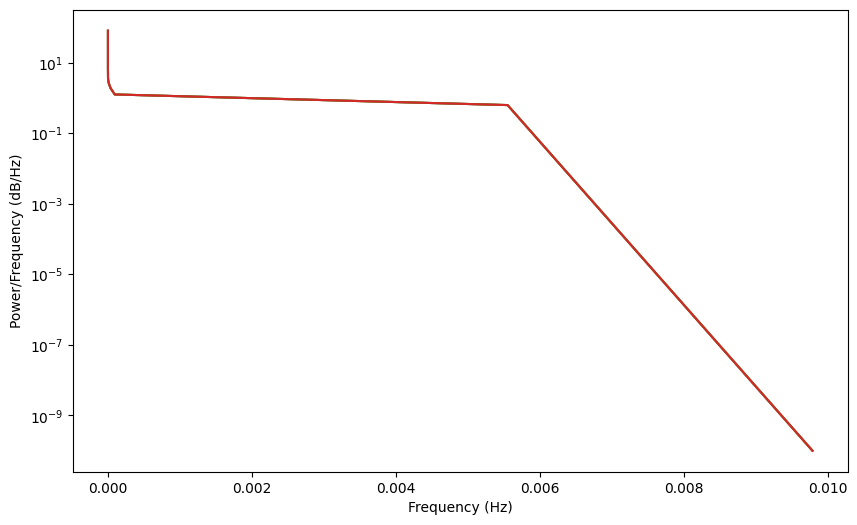

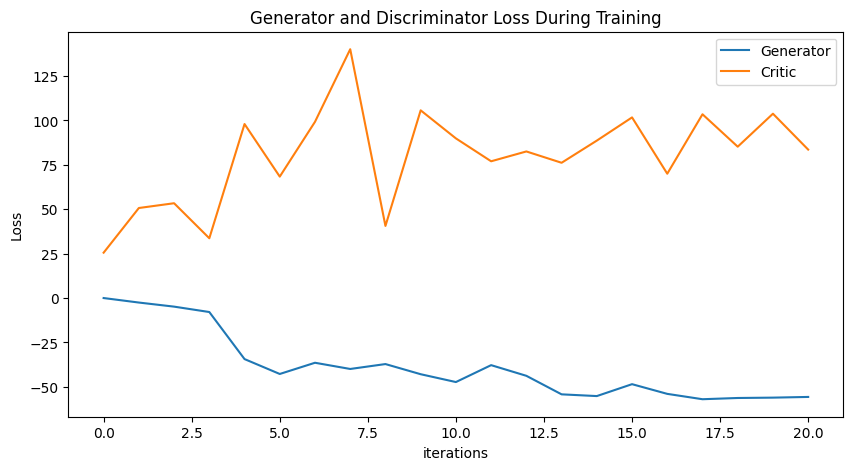

Epoch 30: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566]) Generator err ([25.56433717534529, 50.715415423482256, 53.40506603670262, 33.67814452758826, 98.00273495554327, 68.39790614128471, 99.2557193164845, 140.13629095427126, 40.62203866366052, 105.71741958013257, 89.92021689735863, 77.02974441342968, 82.56842208293453, 76.18960104449667, 88.67248576538098, 101.74170699961357, 70.030536628412, 103

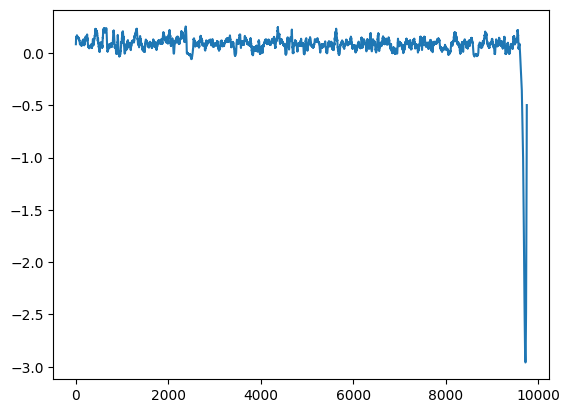

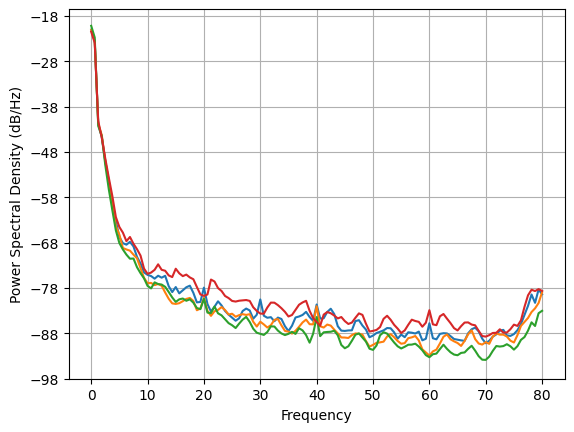

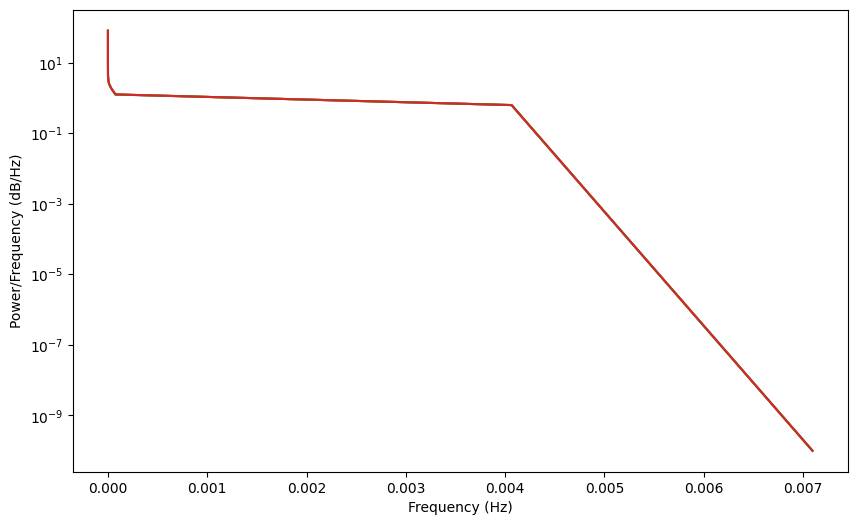

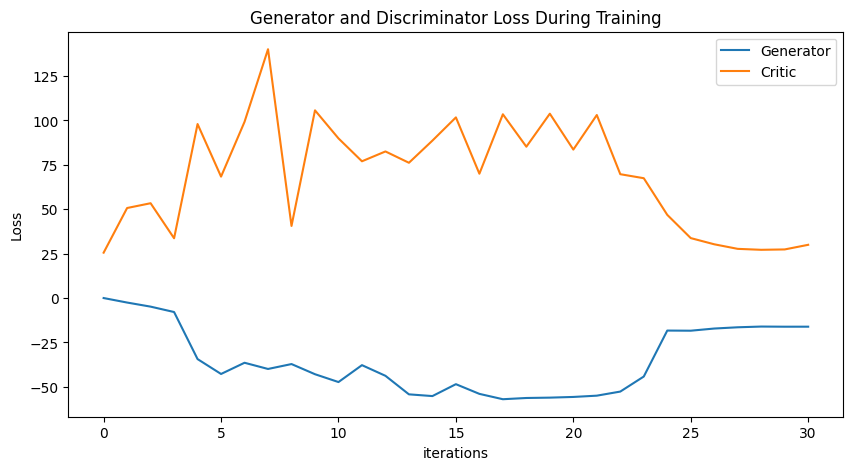

Epoch 40: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701]) Generator err ([25.56433717534529, 50.715415423482256, 53.40506603670262, 33.67814452758826, 98.00273495554327, 68.39790614128471, 99.2557

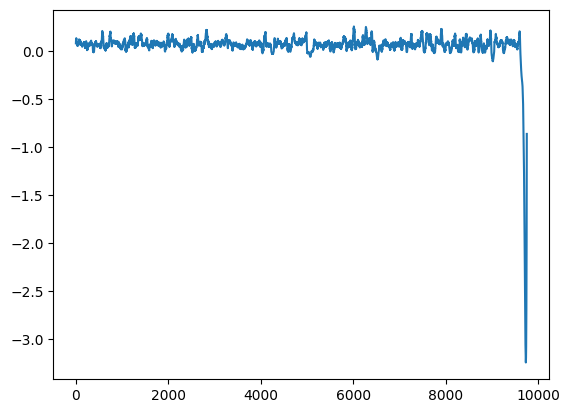

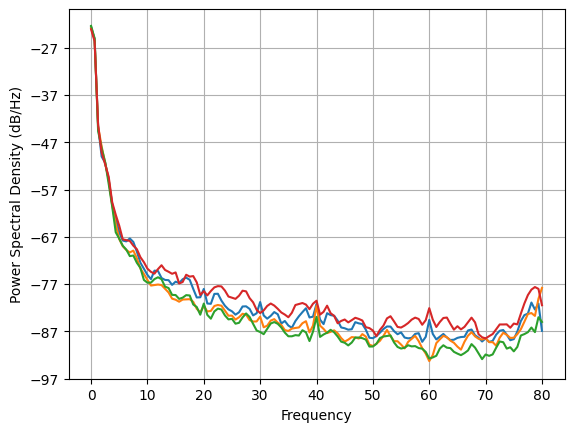

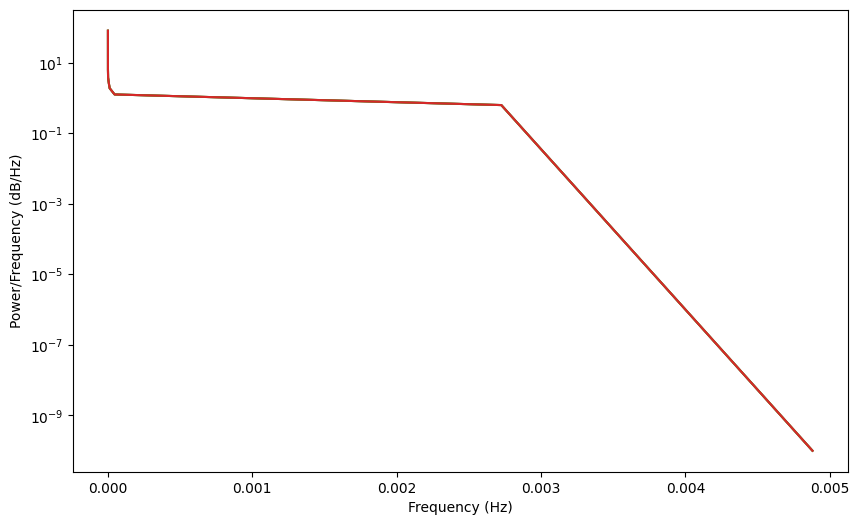

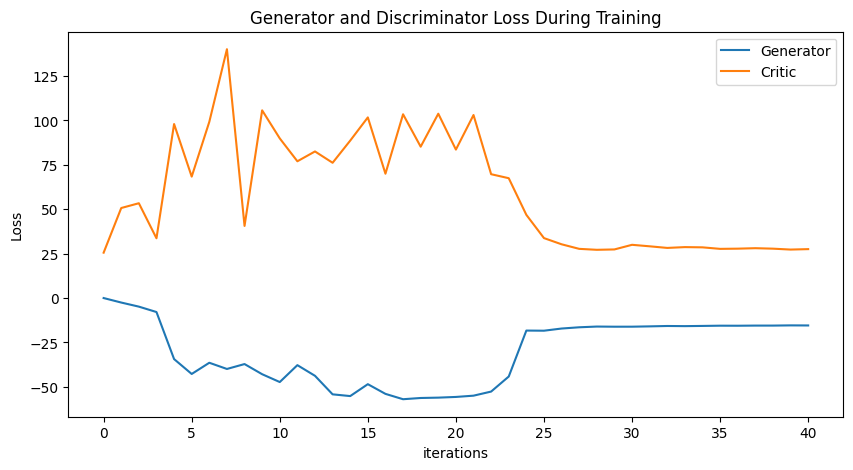

Epoch 50: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.0870197819

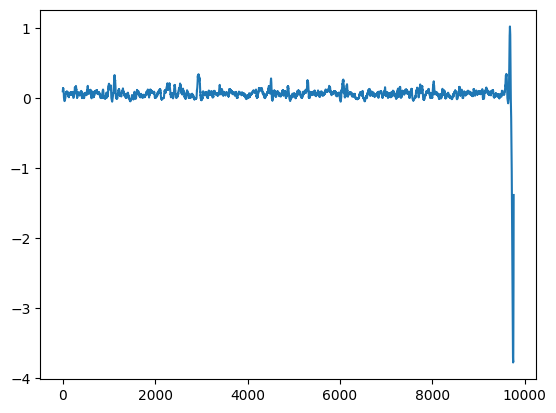

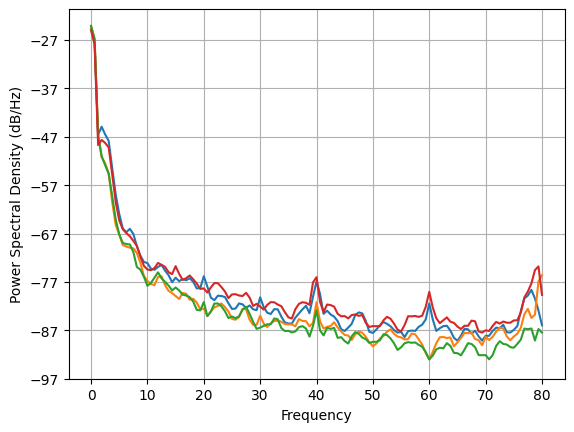

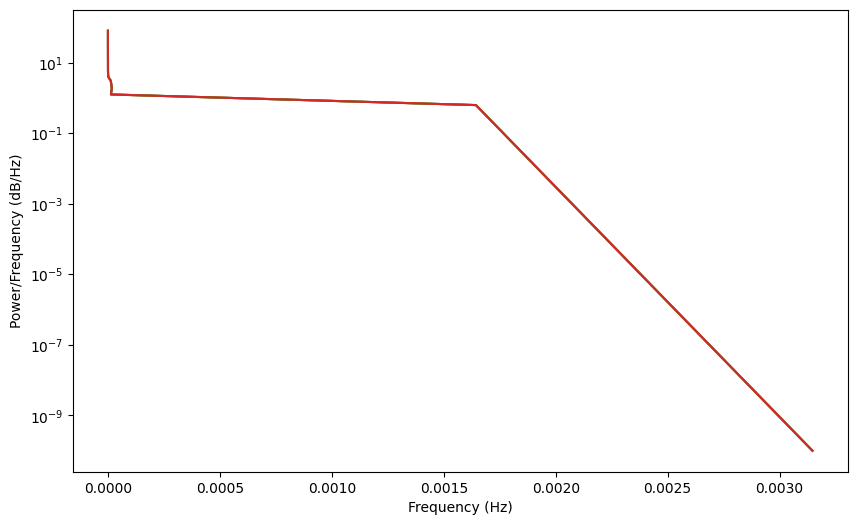

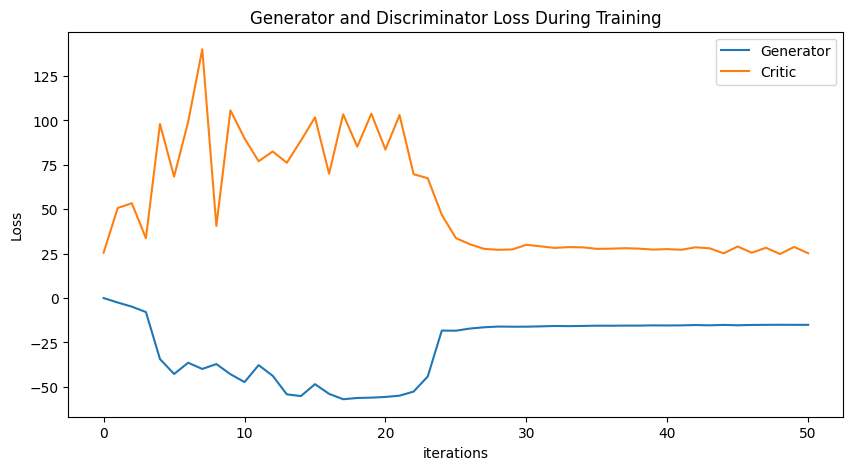

Epoch 60: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.0870197819

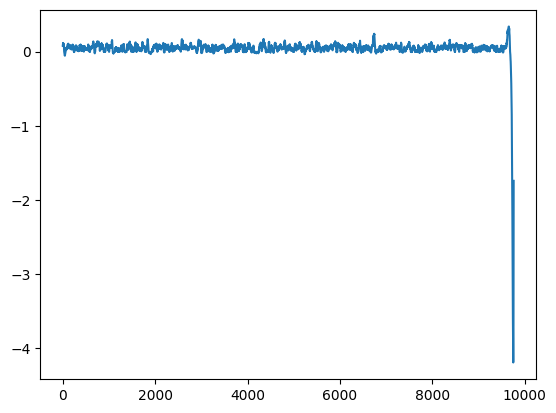

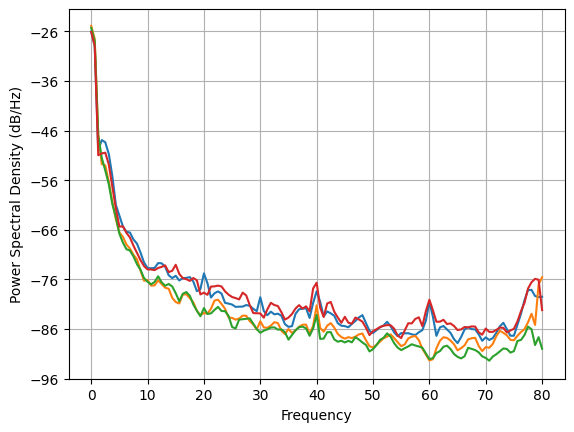

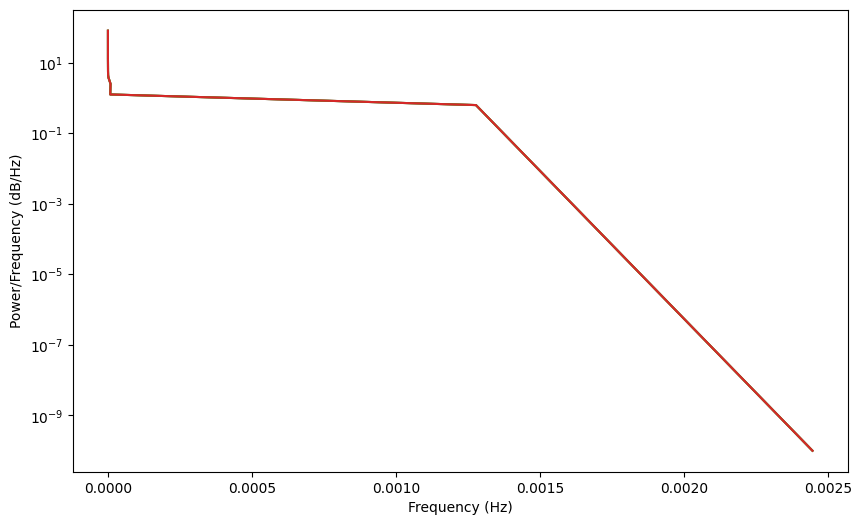

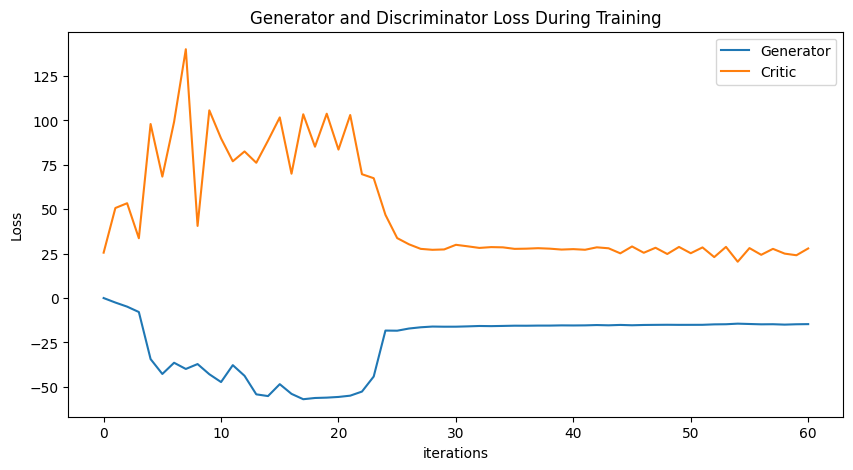

Epoch 70: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.0870197819

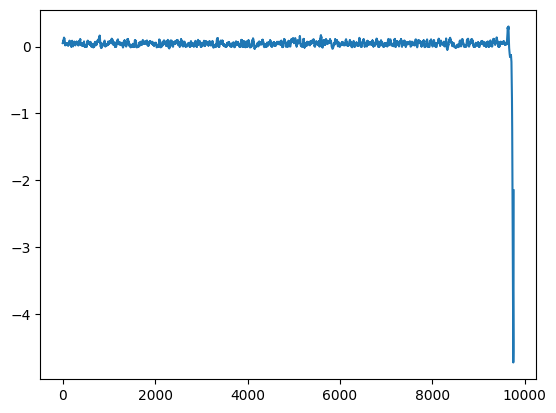

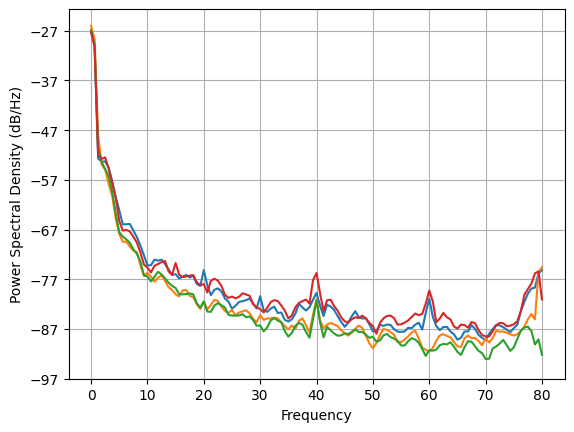

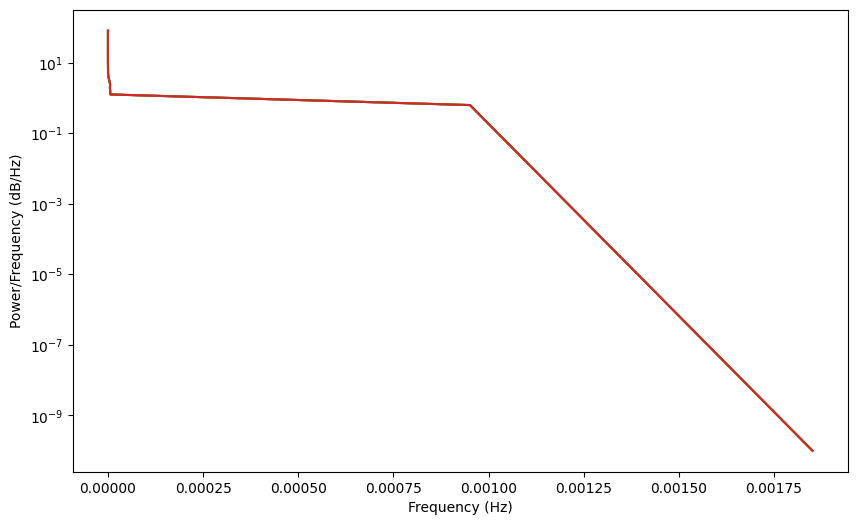

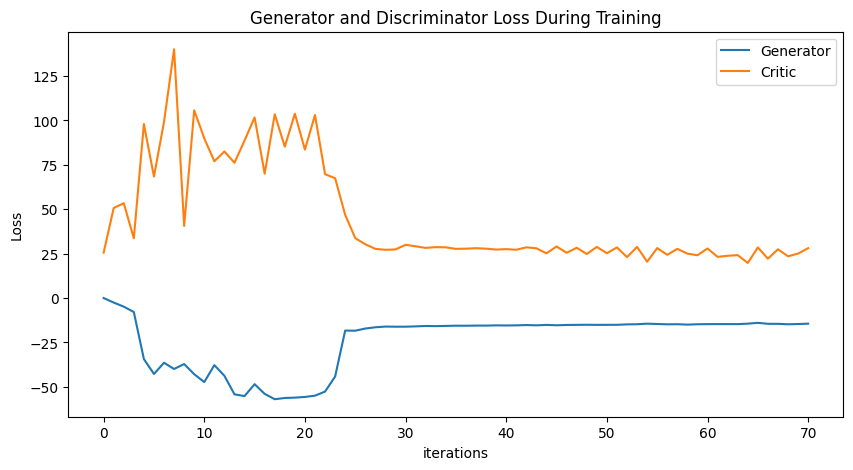

Epoch 80: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.0870197819

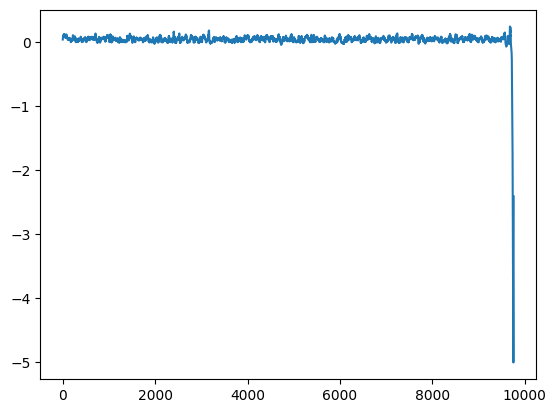

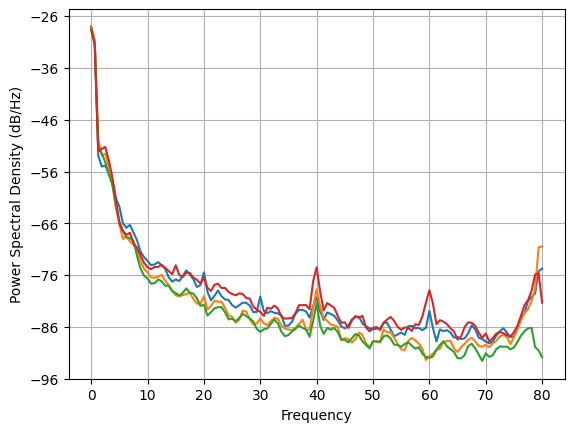

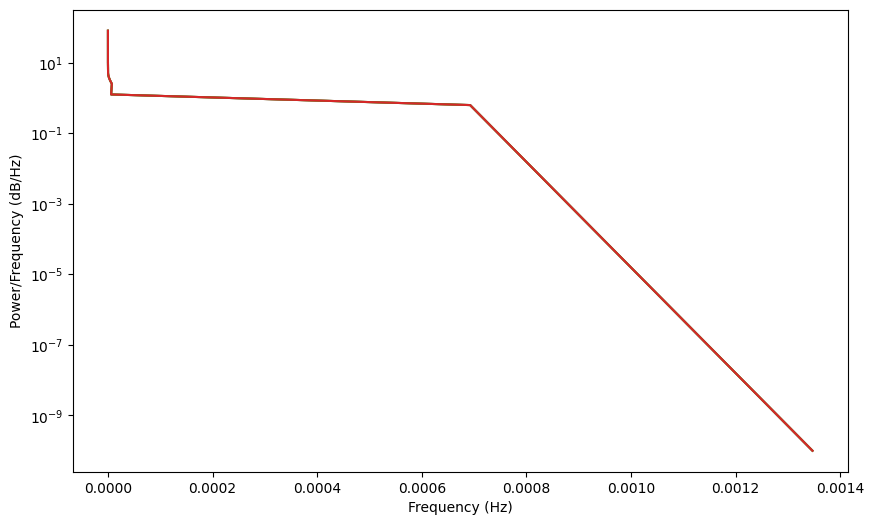

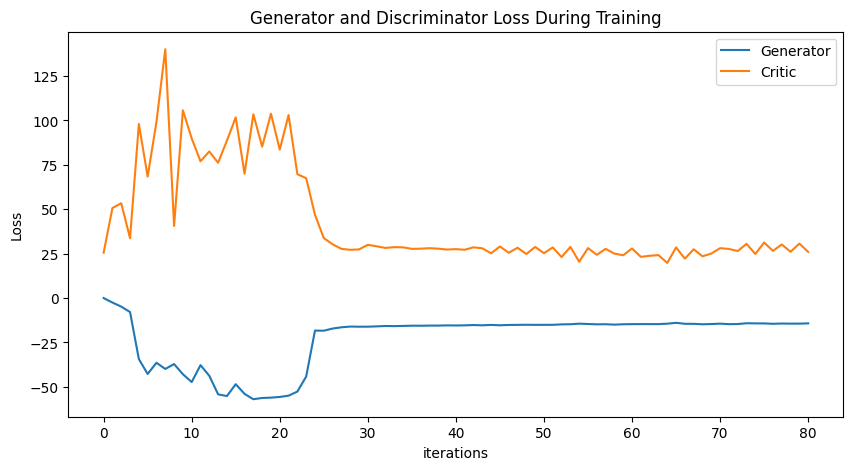

Epoch 90: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.0870197819

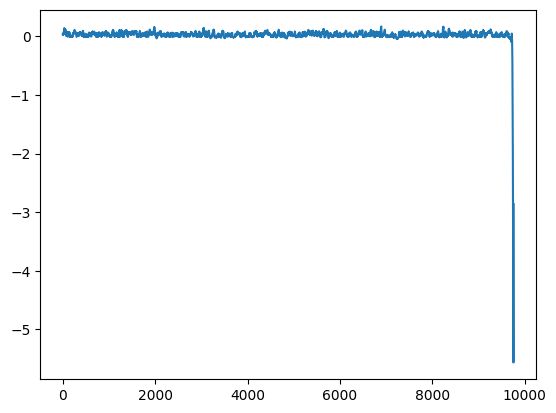

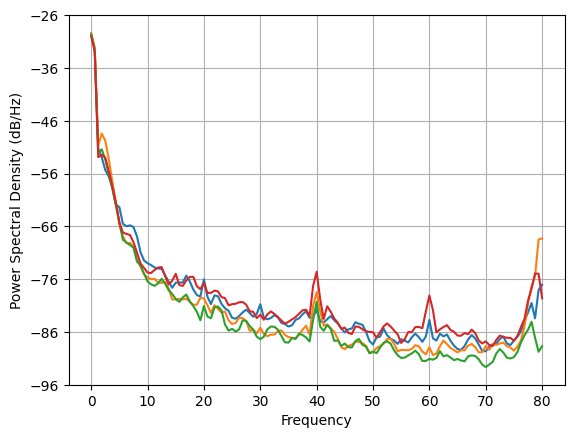

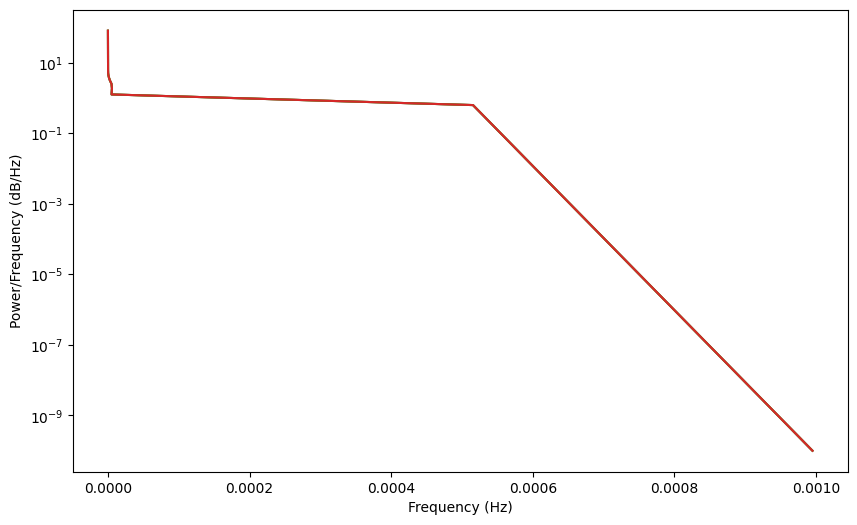

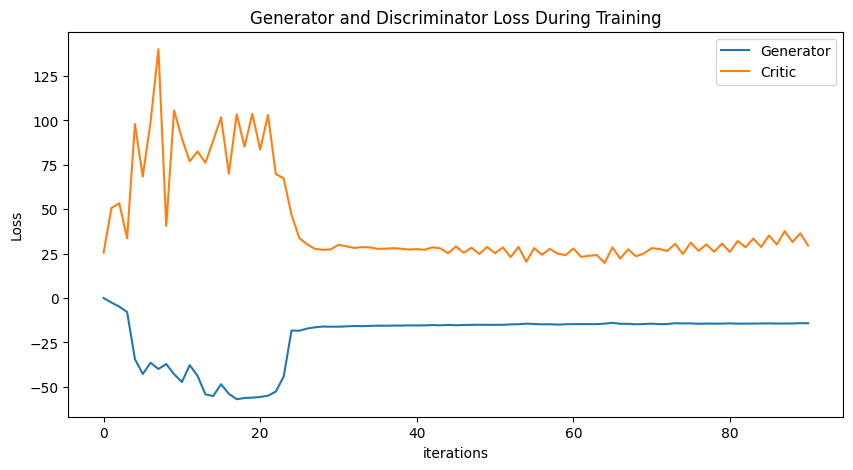

Epoch 100: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

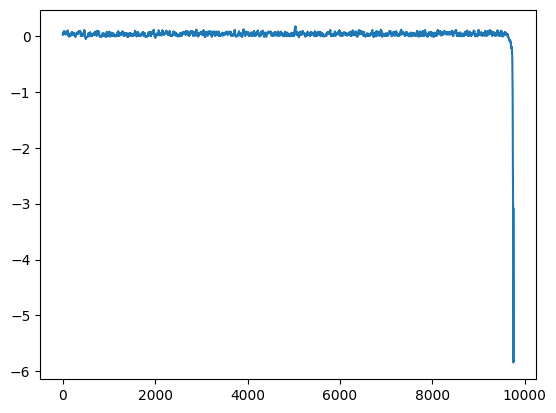

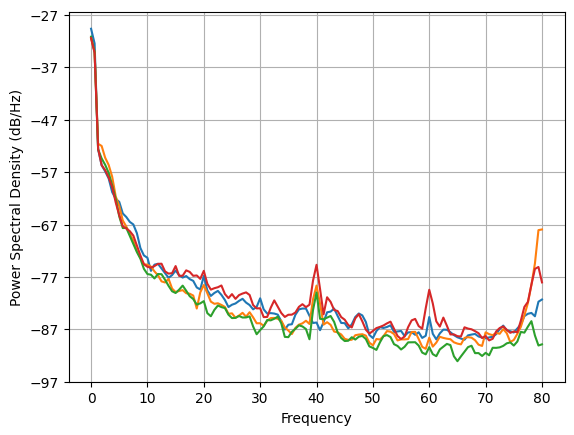

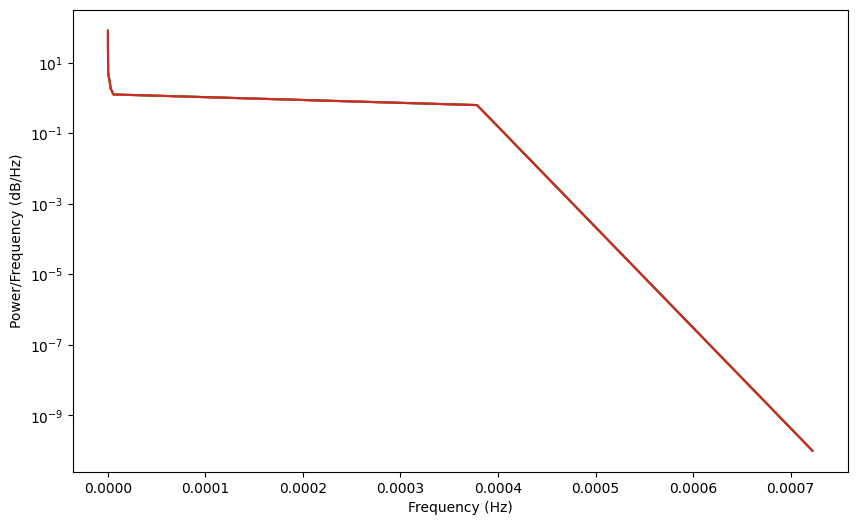

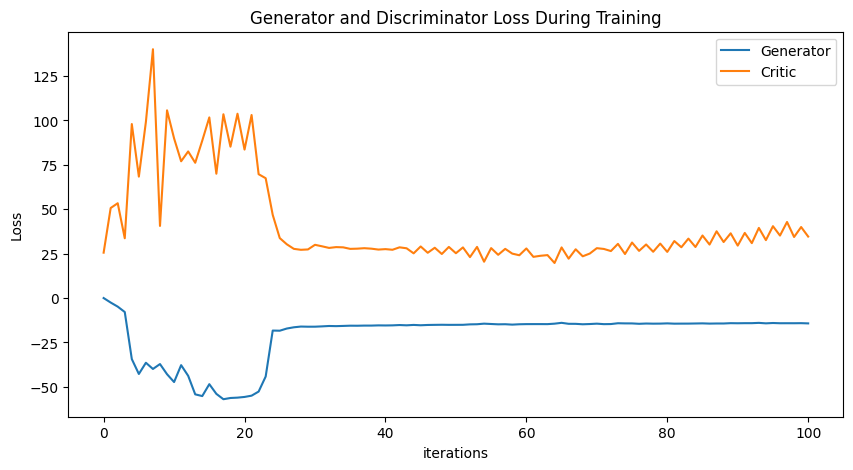

Epoch 110: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

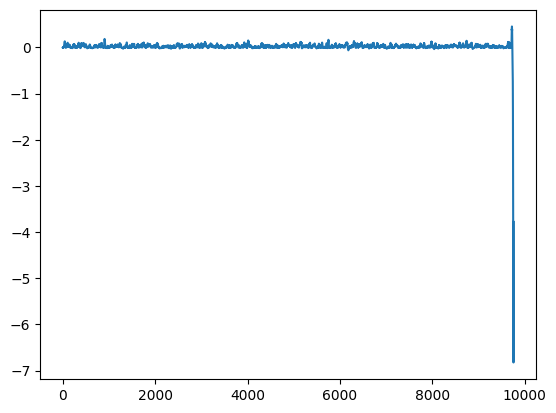

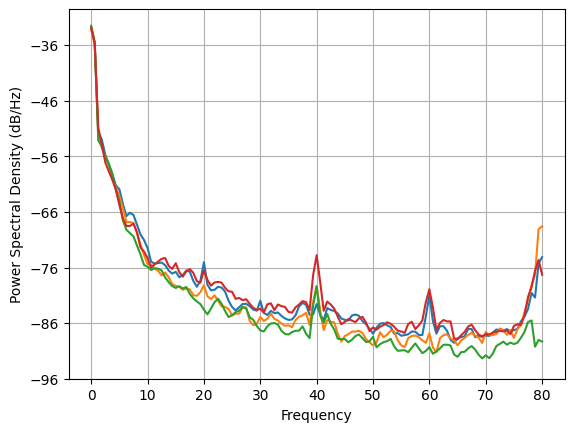

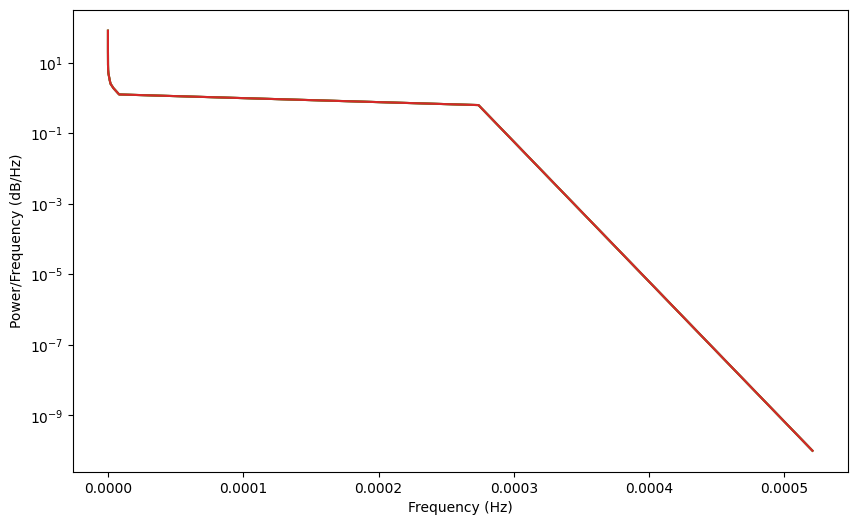

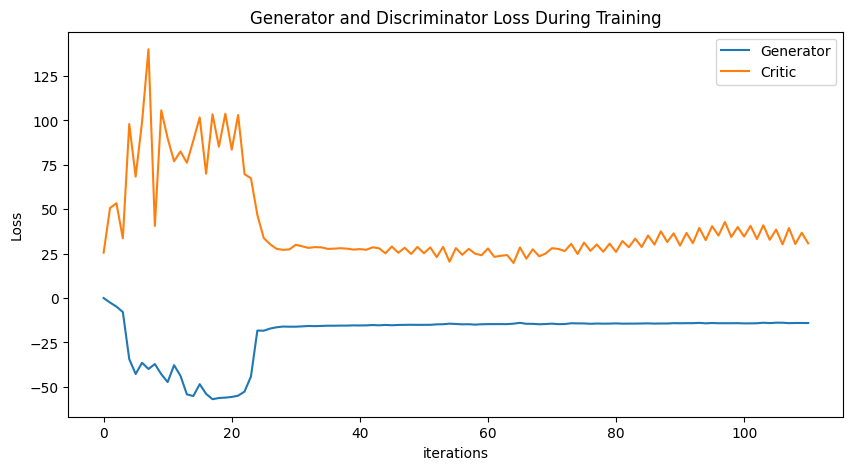

Epoch 120: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

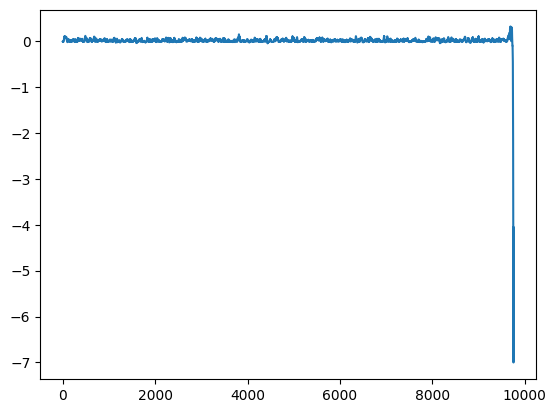

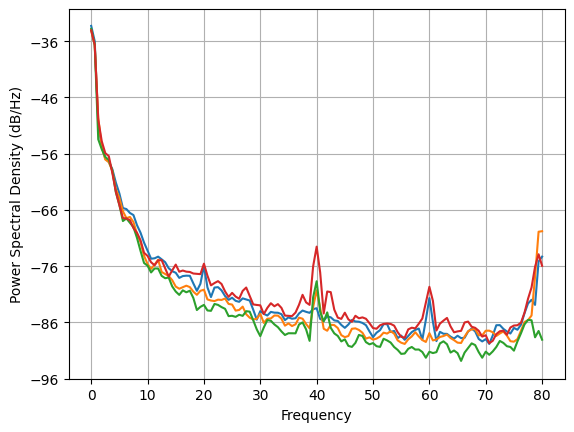

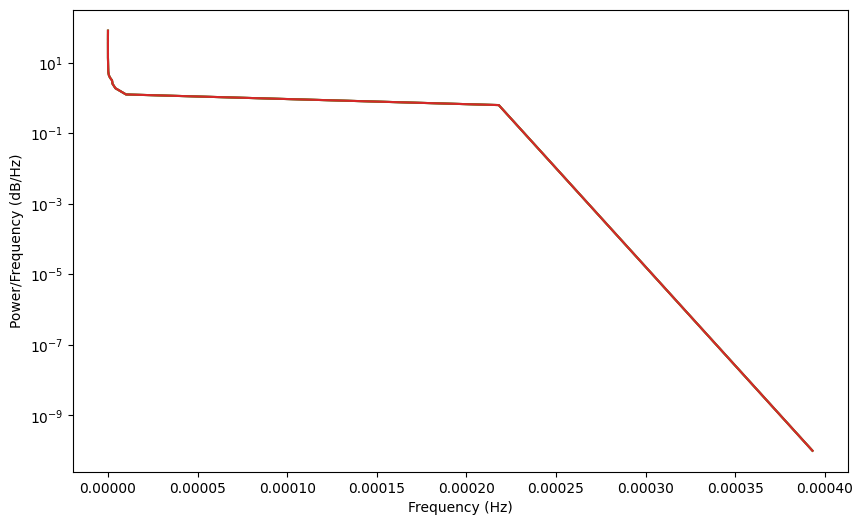

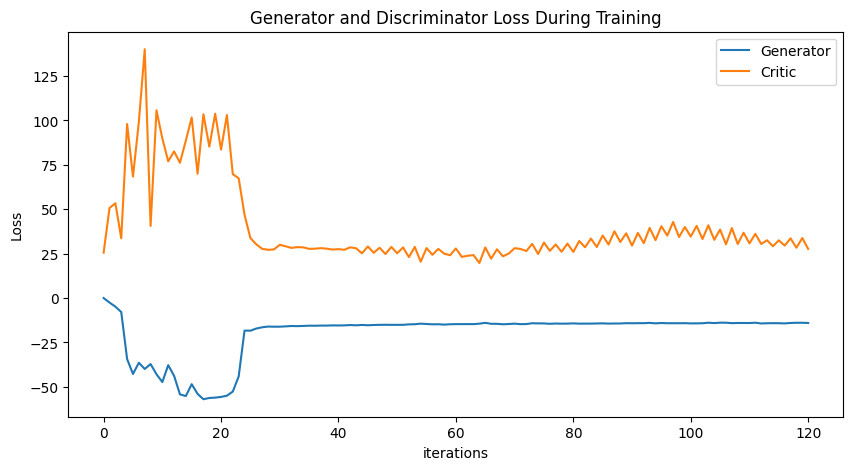

Epoch 130: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

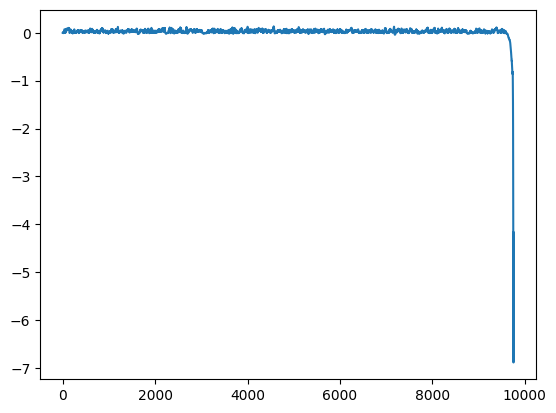

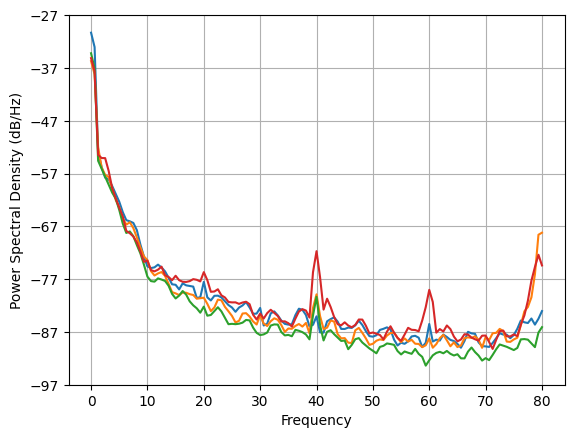

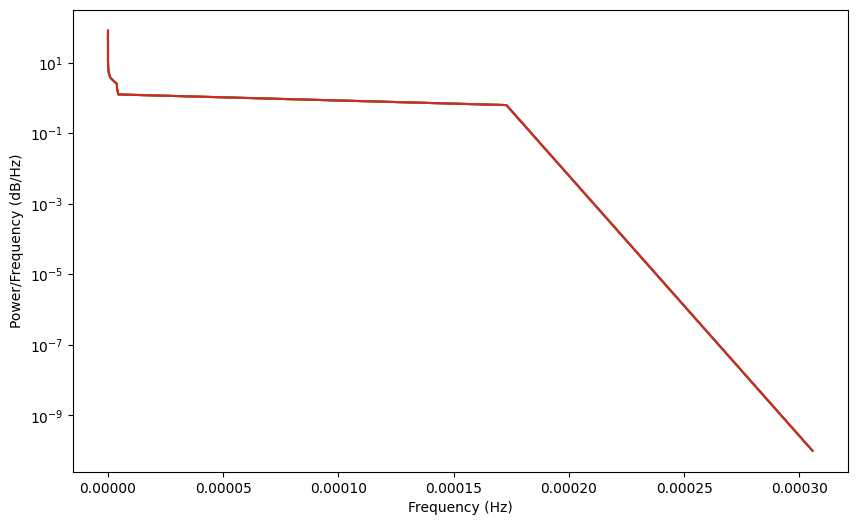

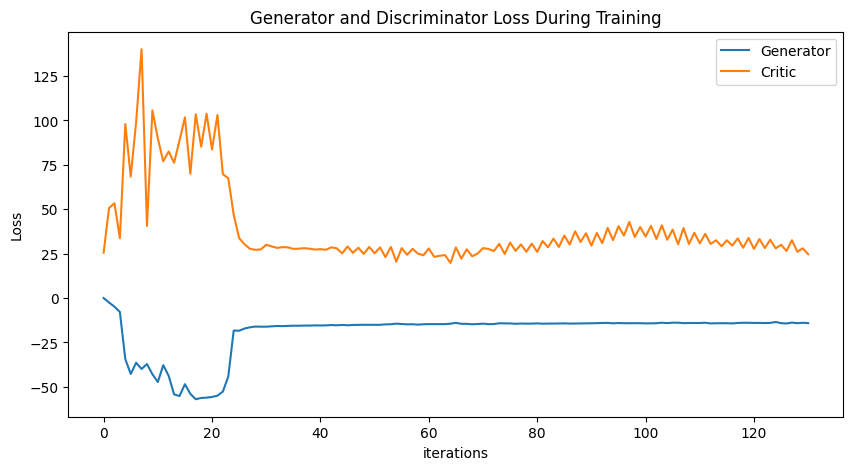

Epoch 140: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

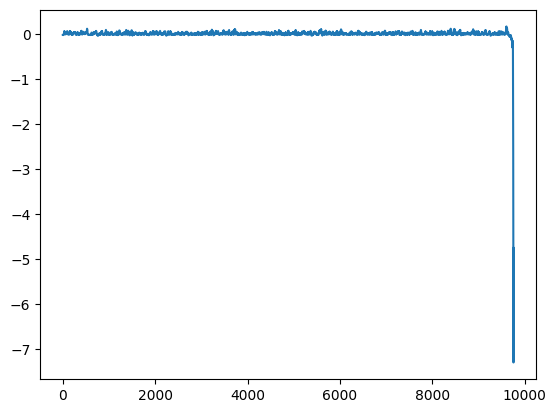

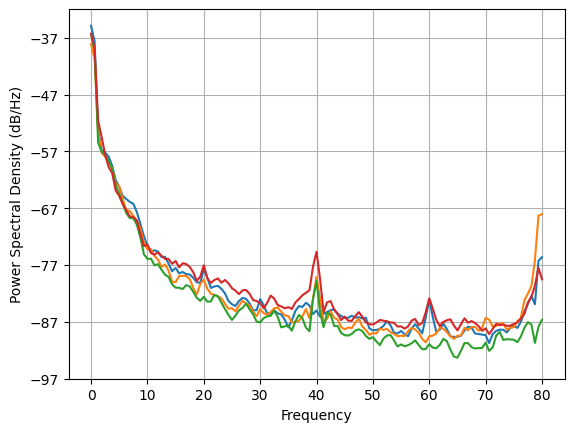

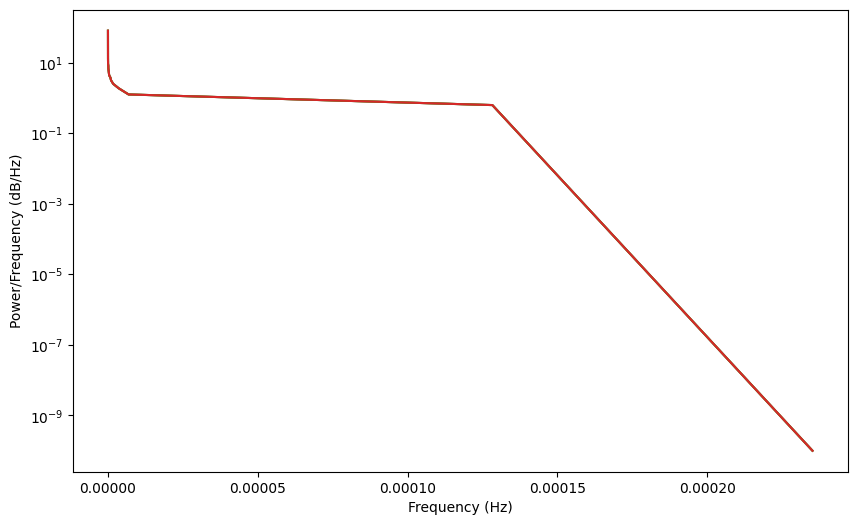

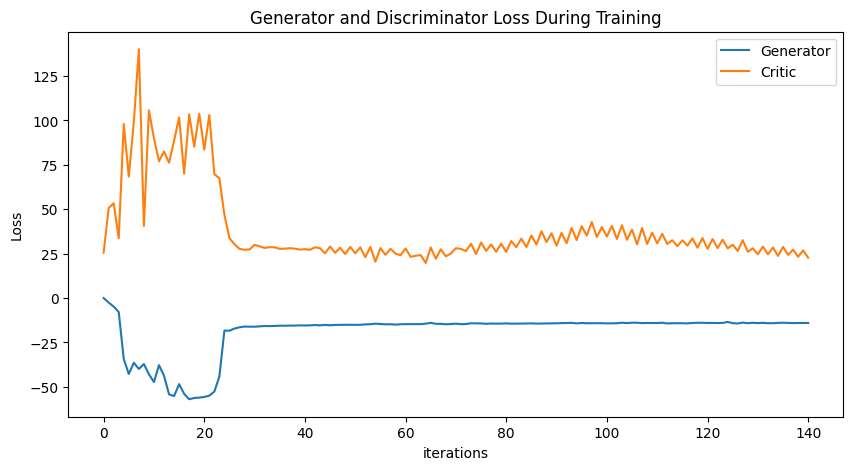

Epoch 150: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

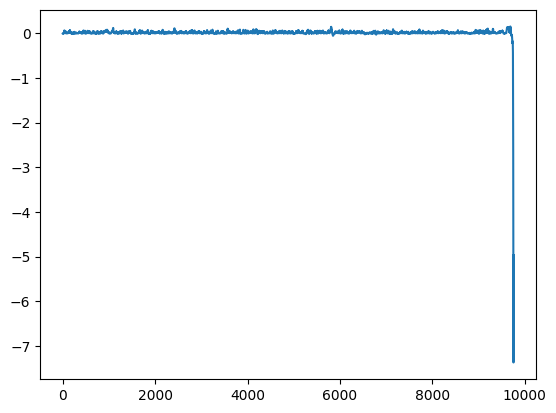

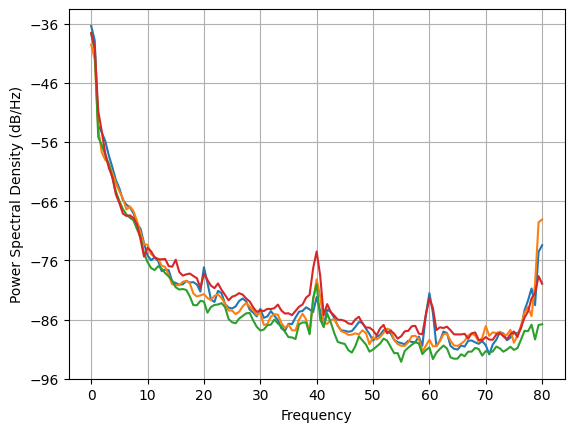

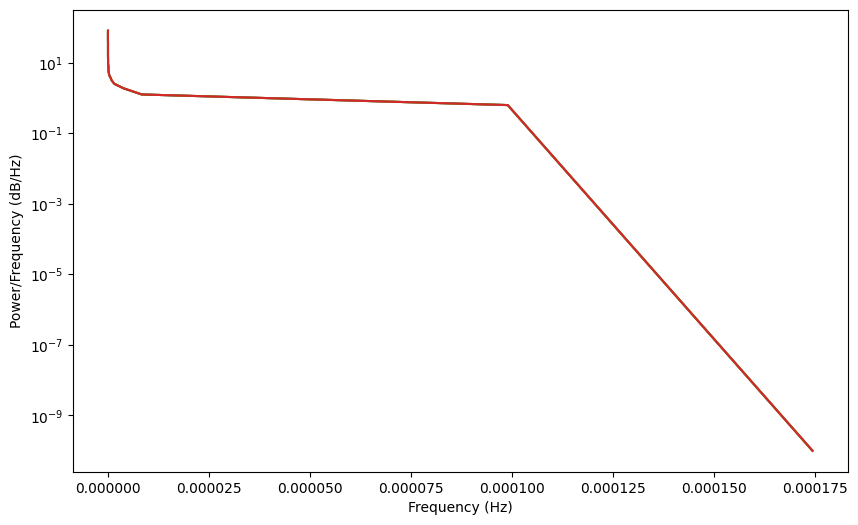

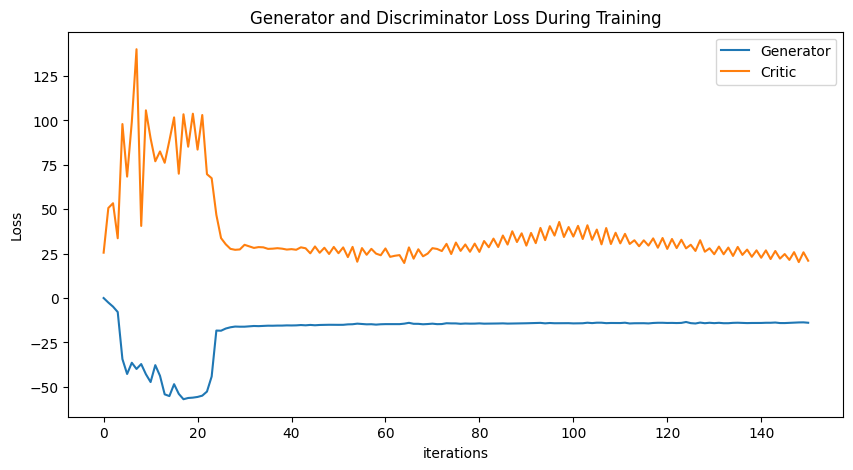

Epoch 160: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

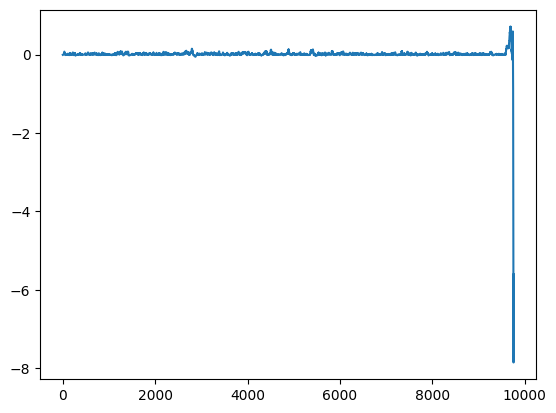

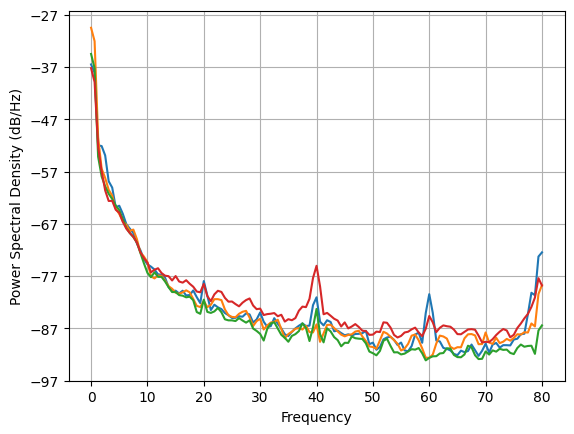

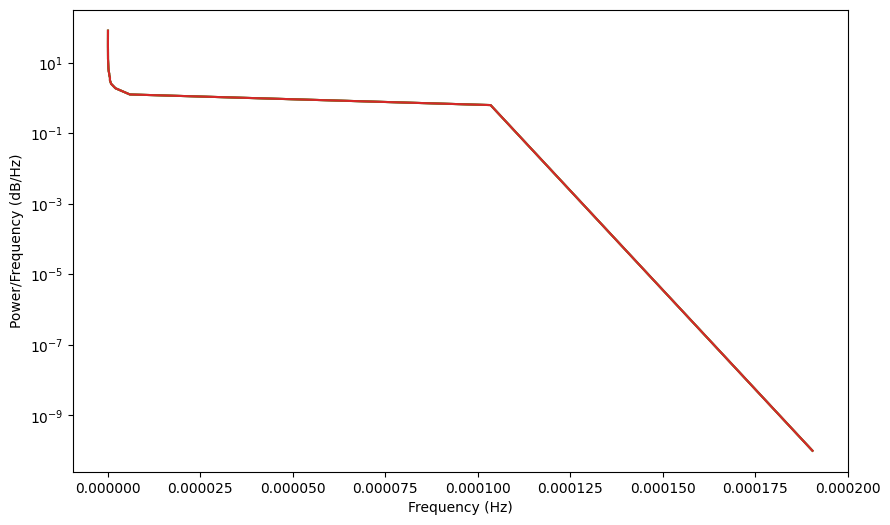

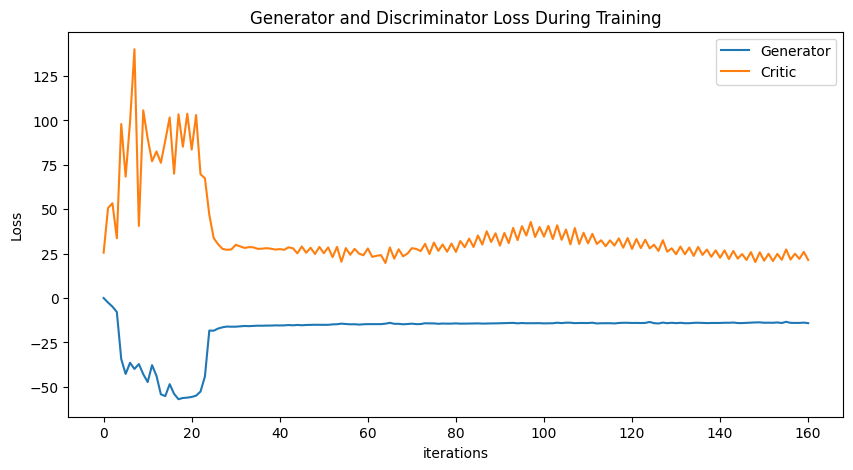

Epoch 170: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

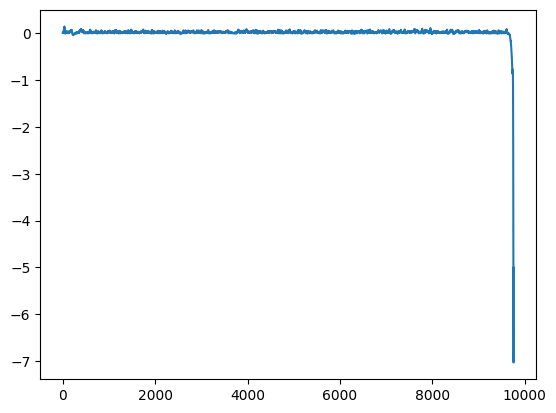

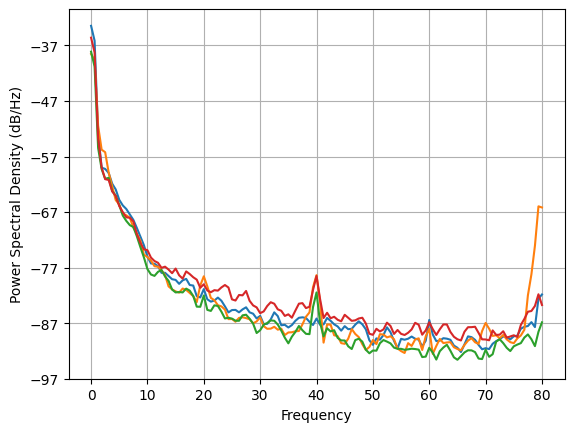

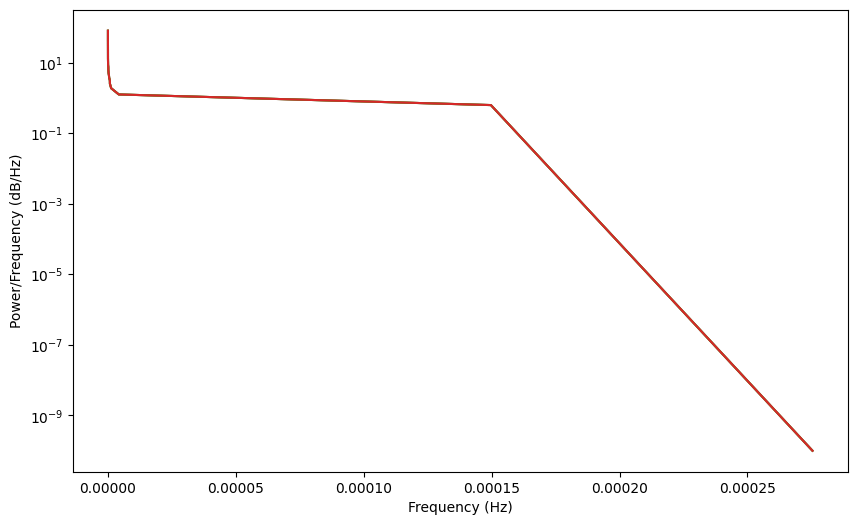

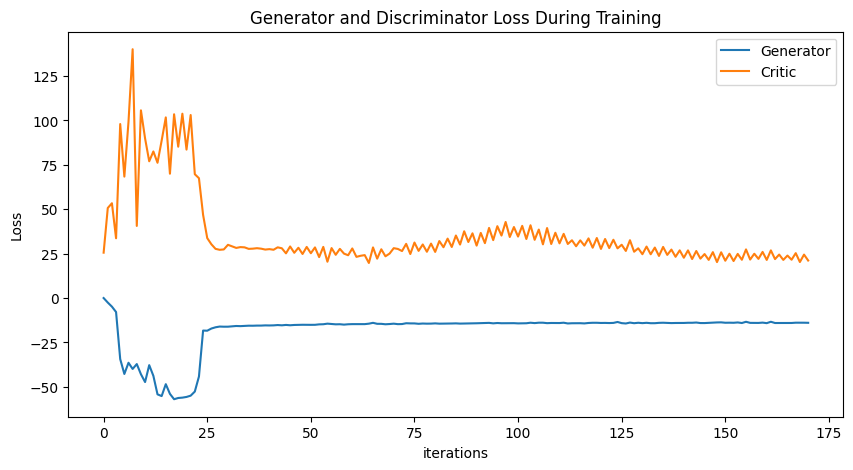

Epoch 180: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

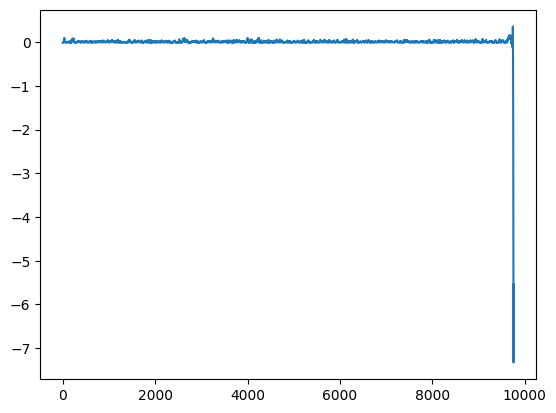

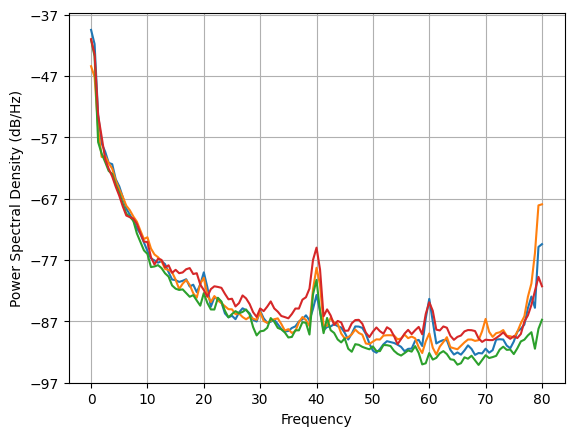

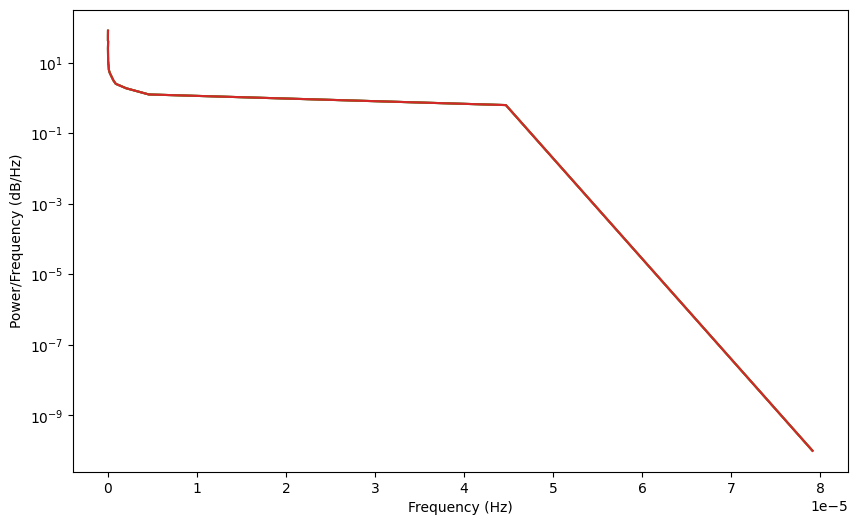

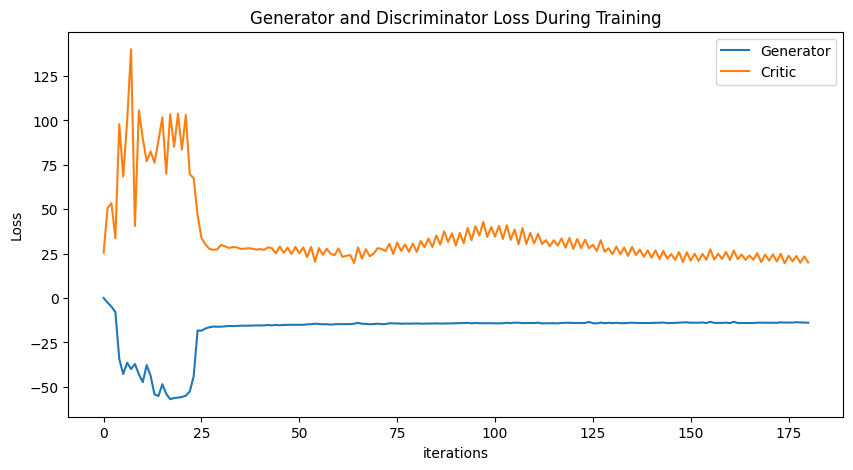

Epoch 190: Critic error ([0.012012032363126035, -2.5238182814765935, -4.82537057950713, -7.862254613418401, -34.36410522460476, -42.74622723496253, -36.4314690783814, -39.926121456431076, -37.16592669348862, -42.88453588335588, -47.29549532228084, -37.77704873271242, -43.78259498920286, -54.218427722272914, -55.19374227335452, -48.49156407120697, -53.950873283509914, -56.96594425220717, -56.26937857920804, -56.07201602062139, -55.681707697646665, -54.96431825357065, -52.65651748842786, -44.184884861180166, -18.301801788685104, -18.379868773125573, -17.157614226156184, -16.45446543369497, -16.044316863248373, -16.128278092579436, -16.11644956062566, -15.93994341399334, -15.724774470210612, -15.805115245783972, -15.69105294964677, -15.556734518971478, -15.5809937995815, -15.498354591701151, -15.499973869740948, -15.38347193914446, -15.427036939848701, -15.373197461385958, -15.190813355448114, -15.346569446002569, -15.12609249834761, -15.316621091781782, -15.148812499458153, -15.087019781

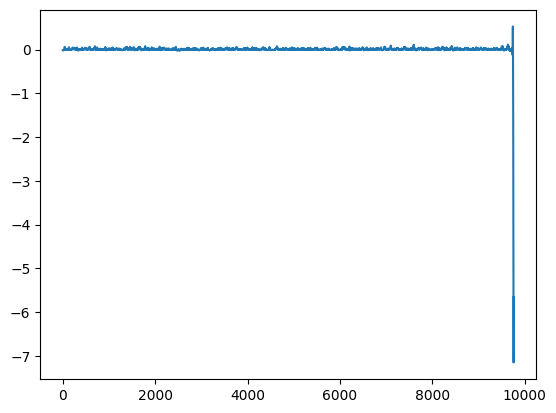

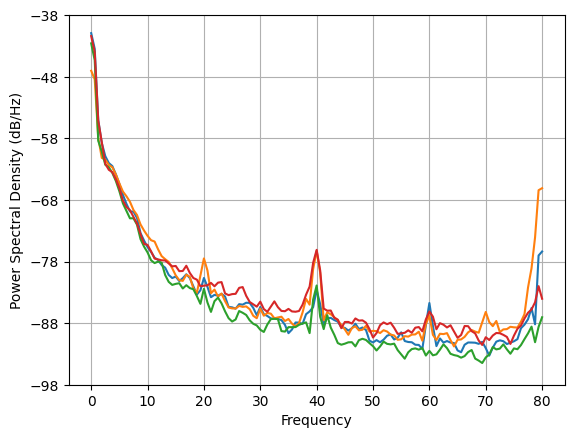

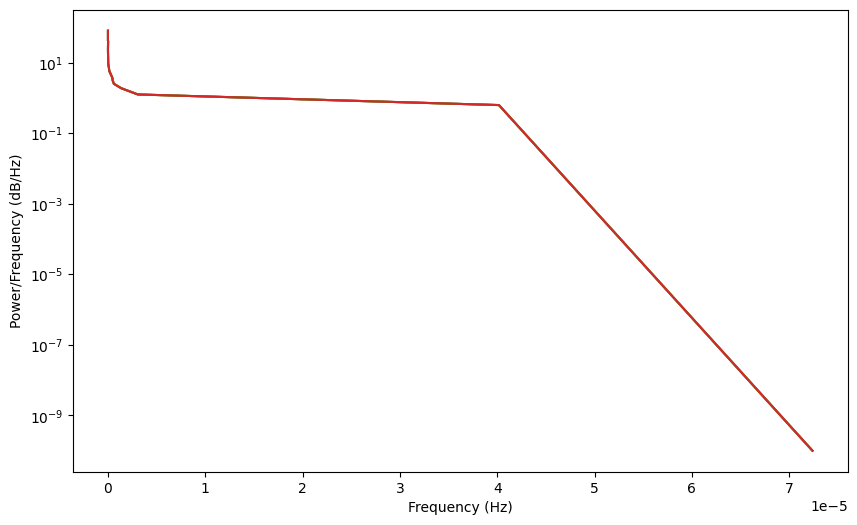

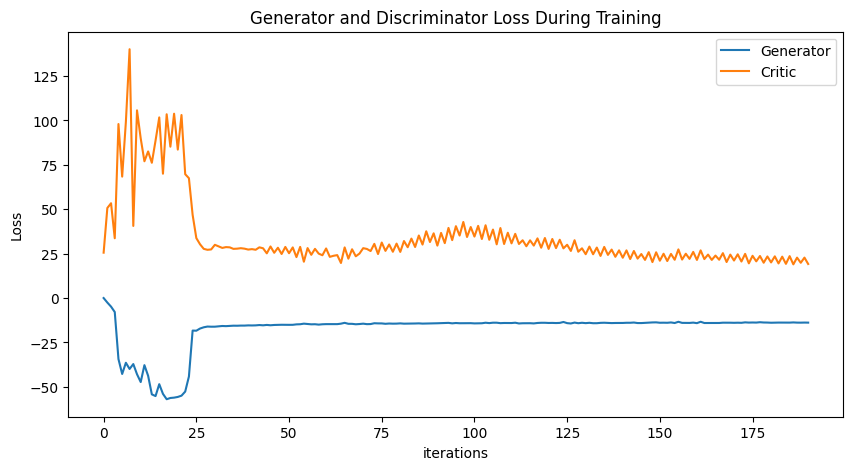

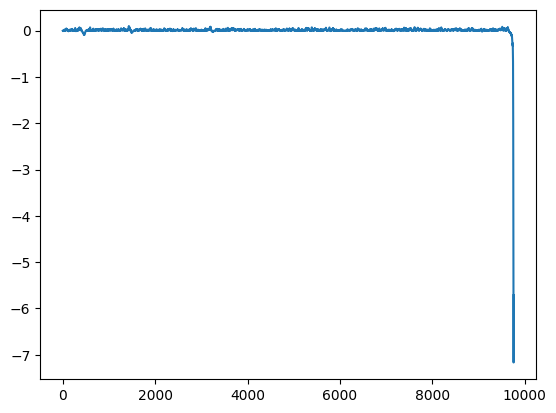

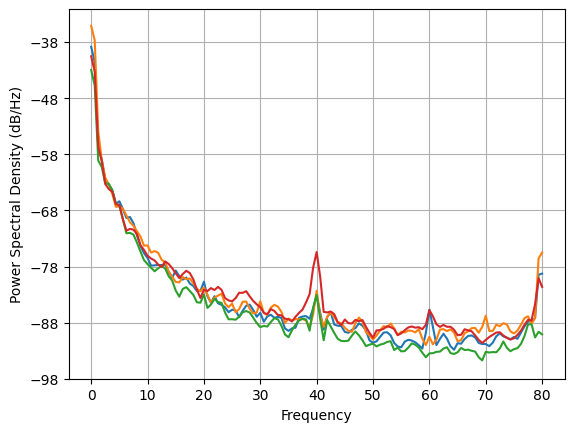

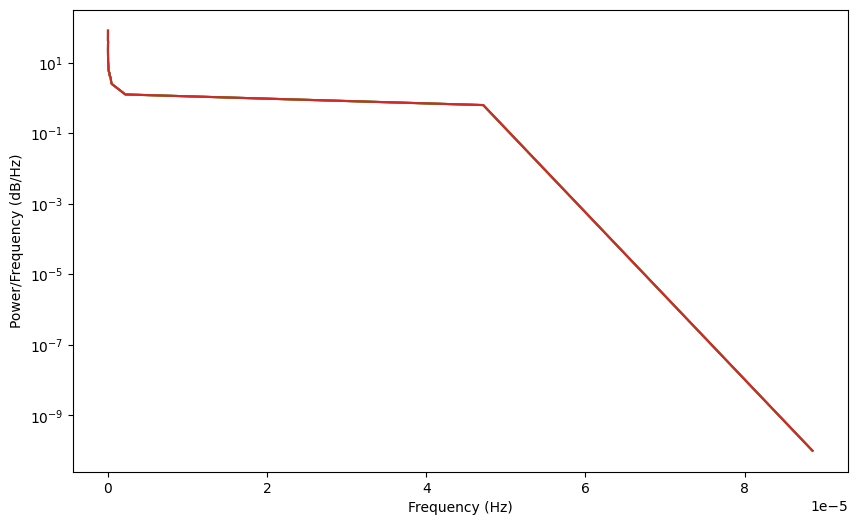

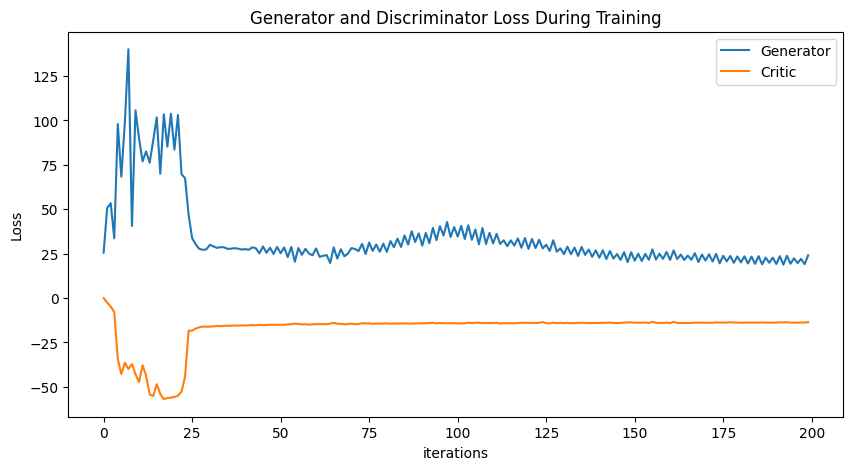

In [9]:
SPECTRAL_FACTOR = 100000
NUM_EPOCHS = 200
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=256, noverlap=128, window='hann', scaling='spectrum')
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP)
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Generator PSD err (%s)" % (epoch, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-11.pt')
torch.save(disc, 'discriminator-v11-11.pt')
np.save('closed-v11-11.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# incorporate PSD loss, spectral_factor = 100,000

Epoch 0: Critic error ([27.00848113706456]) Generator err ([25.299558626267583])
Epoch 0: Critic PSD error ([24.255756588872263]) Generator PSD err ([24.383702443692357])


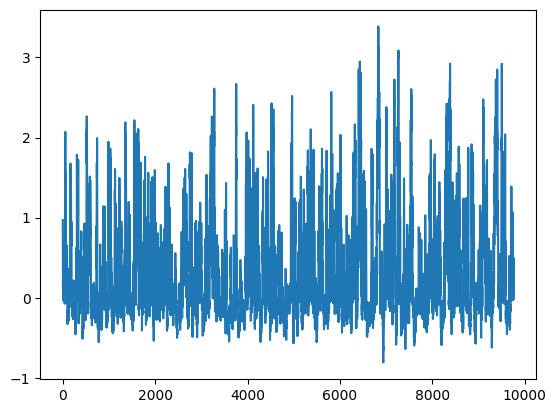

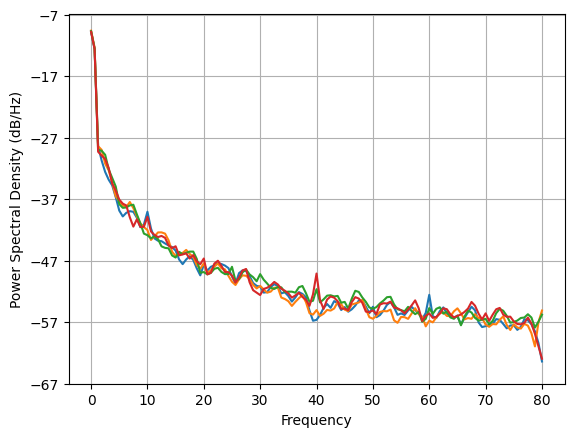

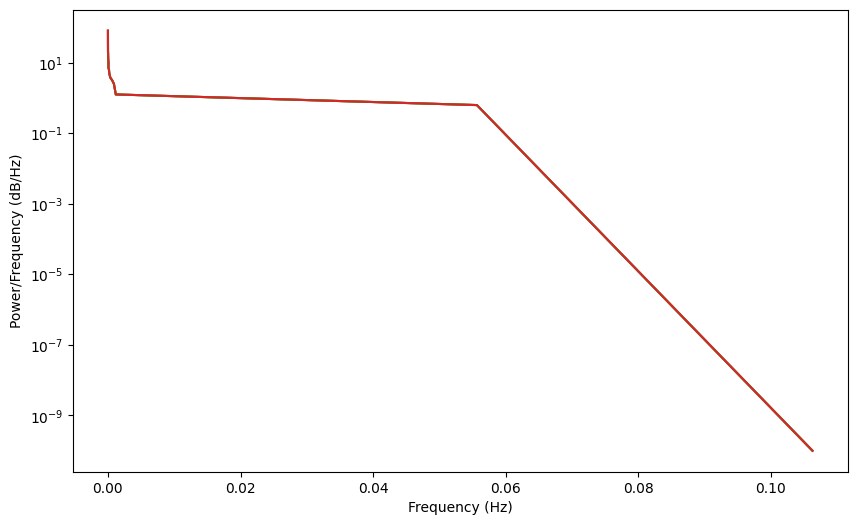

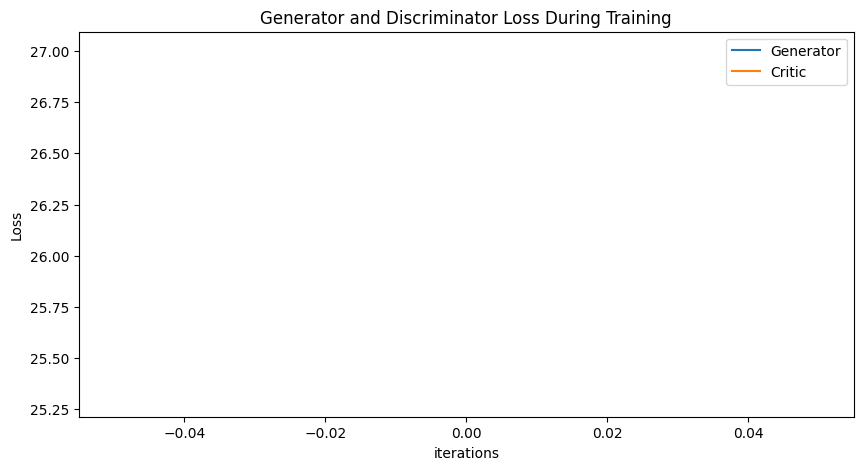

Epoch 10: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995]) Generator err ([25.299558626267583, 47.72714046611822, 67.62985105637188, 59.52876417207543, 96.28090404948703, 50.54381165378376, 58.595265235781795, 47.75741051502627, 48.37628347889809, 40.62333051320039, 40.92706601051361])
Epoch 10: Critic PSD error ([24.255756588872263, 41.91903431604971, 41.11477600392392, 36.9392822754004, 27.86939728890159, 7.586189973384816, 2.5837520653196107, 2.2582955304509267, 2.172519057846731, 2.2193047227670983, 1.3789940136426628]) Generator PSD err ([24.383702443692357, 42.53428367748297, 40.66958112839336, 36.73158018159691, 28.47716259440891, 7.968097542455636, 2.6614845656157833, 2.3225846178094733, 2.101369691056293, 2.318486610612505, 1.257338685074159])


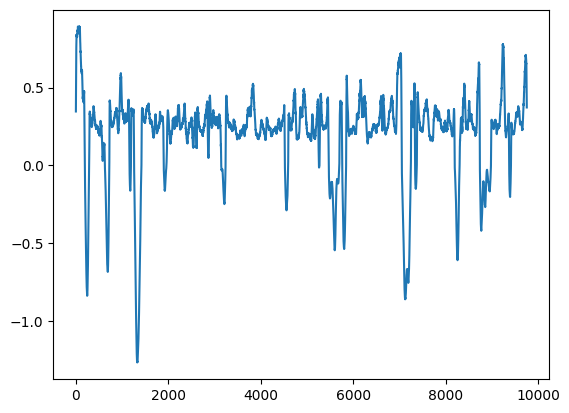

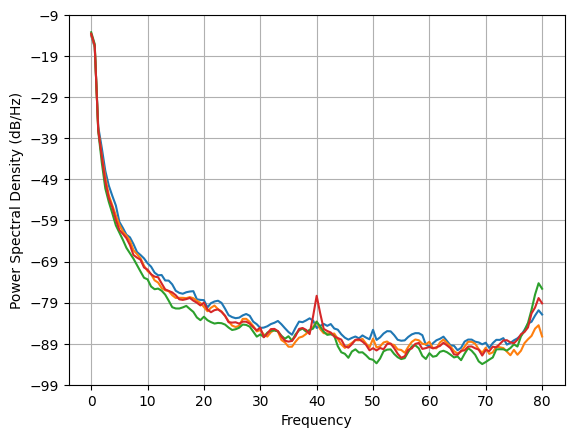

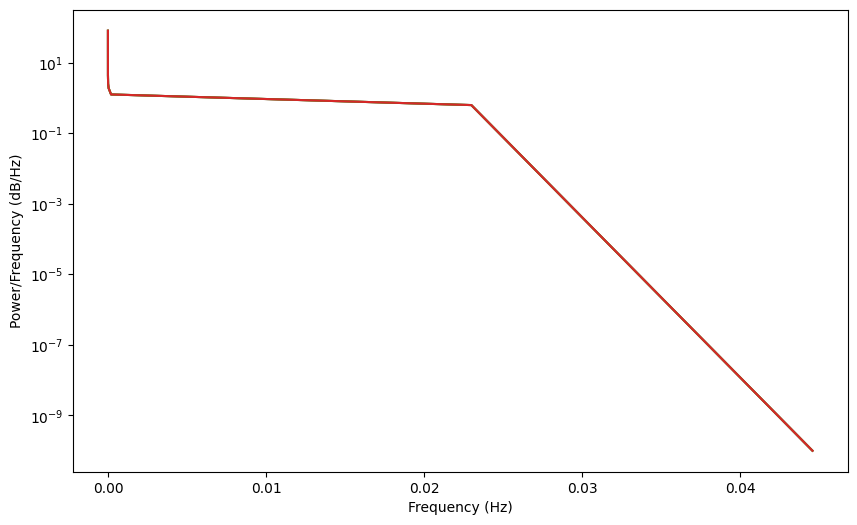

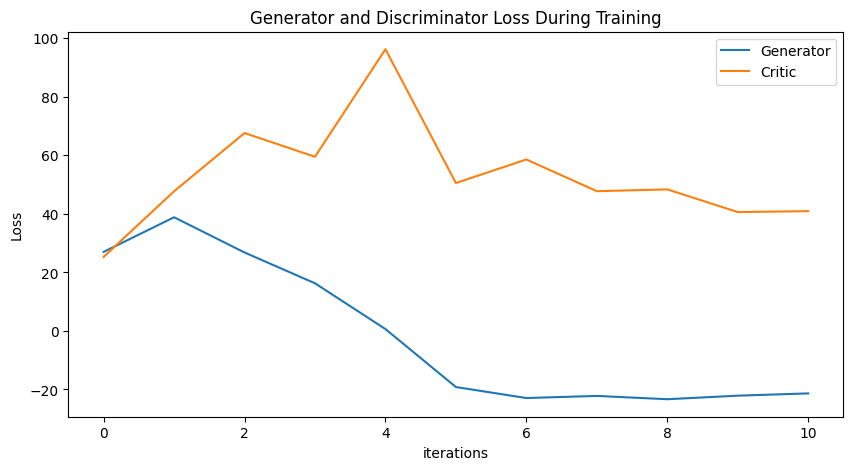

Epoch 20: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597]) Generator err ([25.299558626267583, 47.72714046611822, 67.62985105637188, 59.52876417207543, 96.28090404948703, 50.54381165378376, 58.595265235781795, 47.75741051502627, 48.37628347889809, 40.62333051320039, 40.92706601051361, 97.37343154766013, 57.38396755788743, 50.82227548389854, 72.33666872528607, 54.62587583135235, 59.993572051732045, 68.0677700288177, 48.29607014709131, 57.99871905475767, 43.403493355977886])
Epoch 20: Critic PSD error ([24.255756588872263, 41.91903431604971, 41.11477600392392, 36.9392822754004, 27.86939728890159, 7.

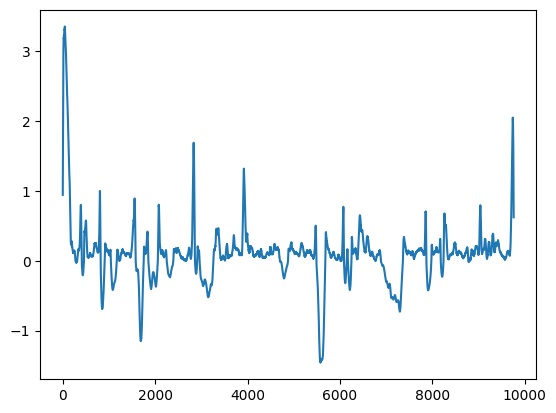

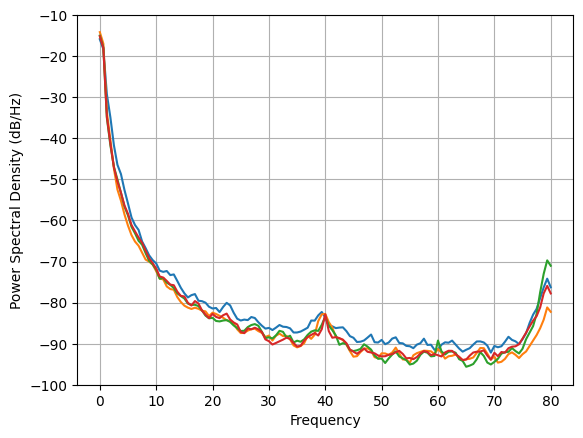

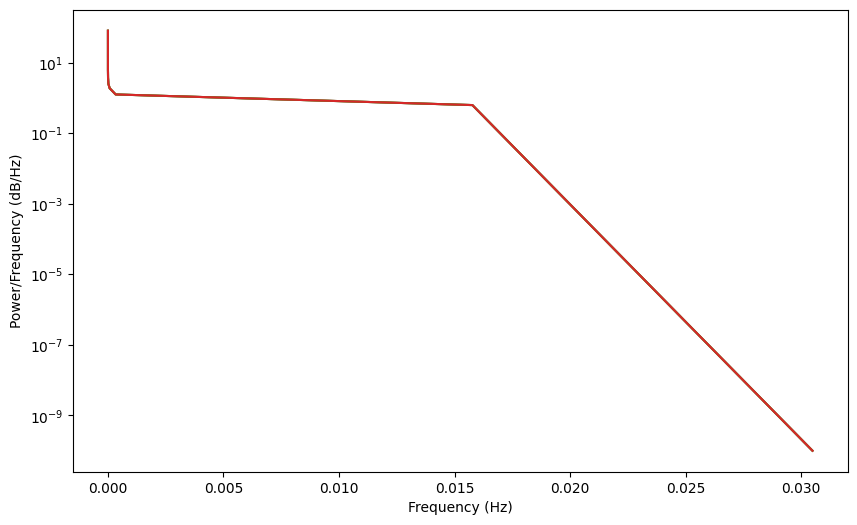

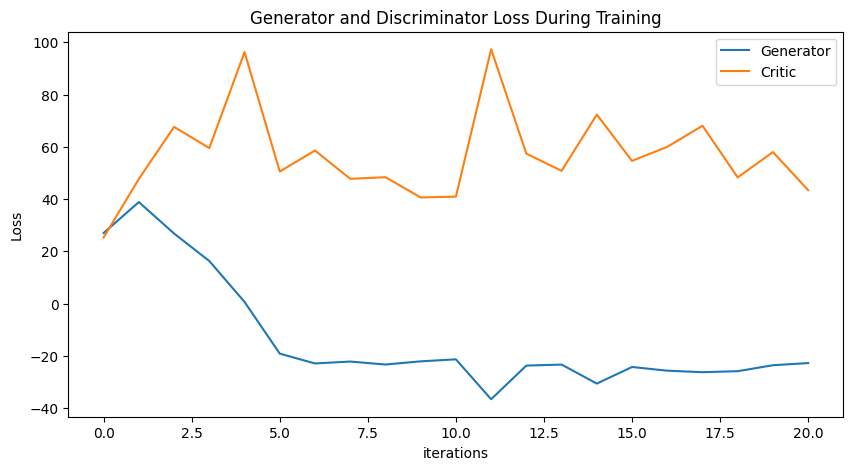

Epoch 30: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066]) Generator err ([25.299558626267583, 47.72714046611822, 67.62985105637188, 59.52876417207543, 96.28090404948703, 50.54381165378376, 58.595265235781795, 47.75741051502627, 48.37628347889809, 40.62333051320039, 40.92706601051361, 97.37343154766013, 57.38396755788743, 50.82227548389854, 72.33666872528607, 54.62587583135235, 59.993572051732045,

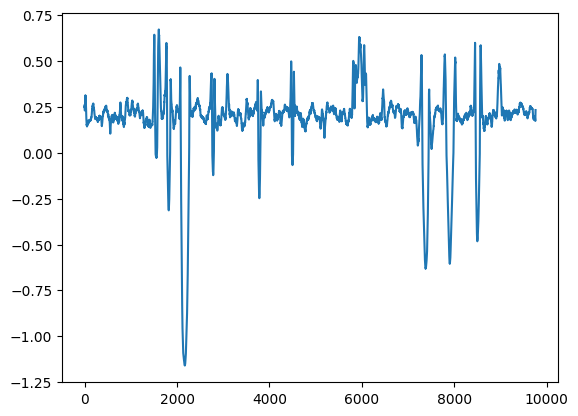

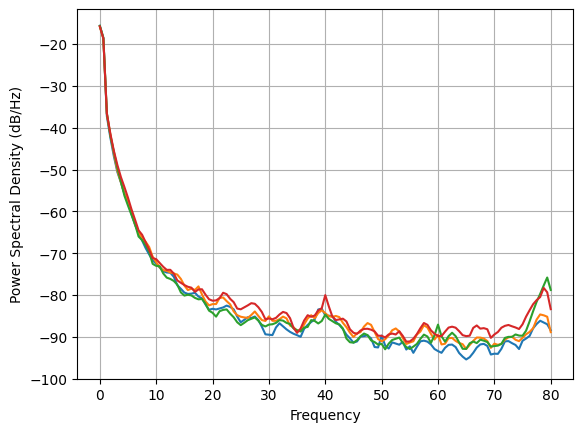

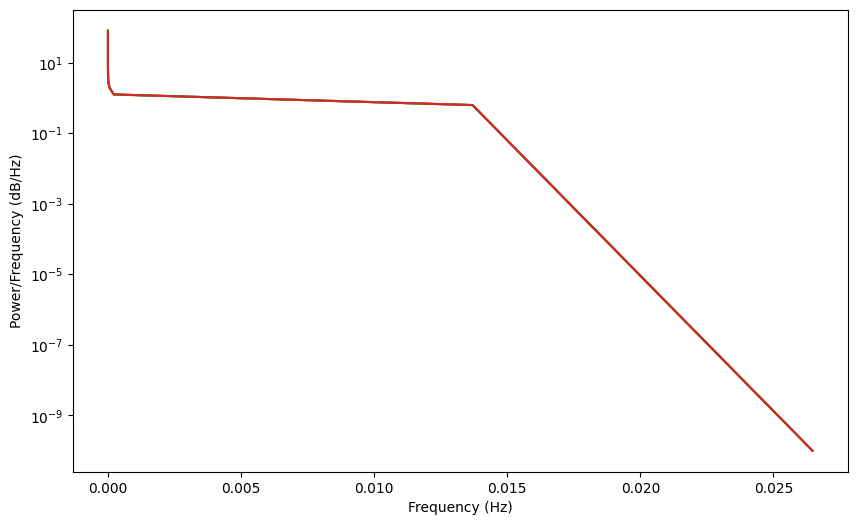

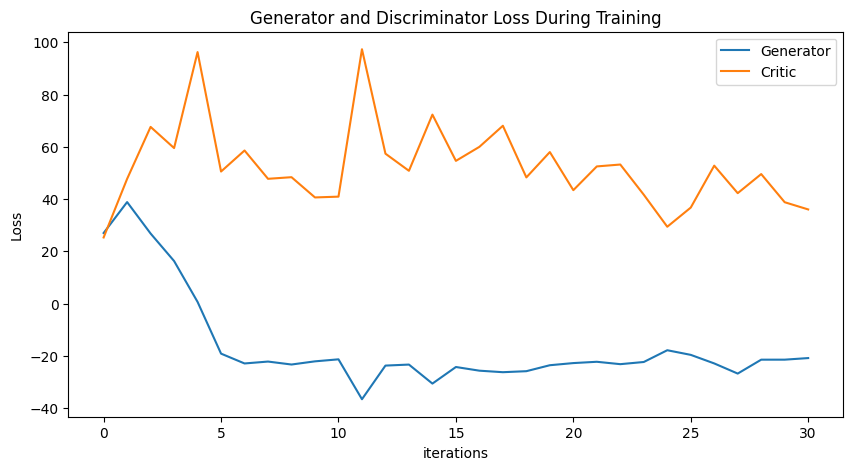

Epoch 40: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247]) Generator err ([25.299558626267583, 47.72714046611822, 67.62985105637188, 59.52876417207543, 96.28090404948703, 50.54381165378376, 58.

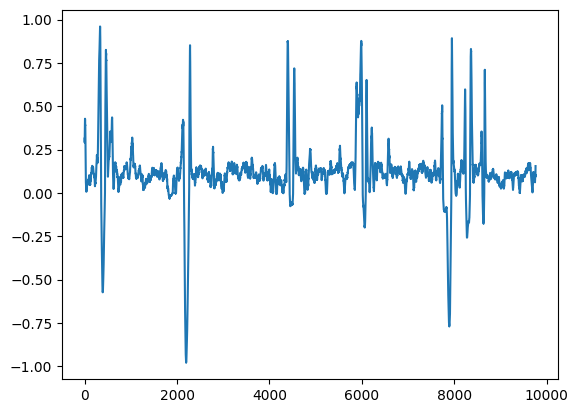

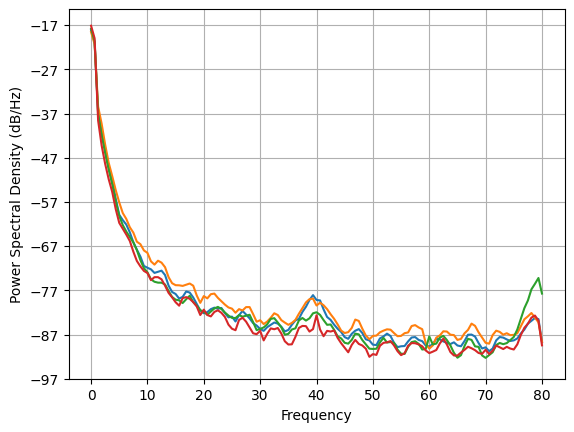

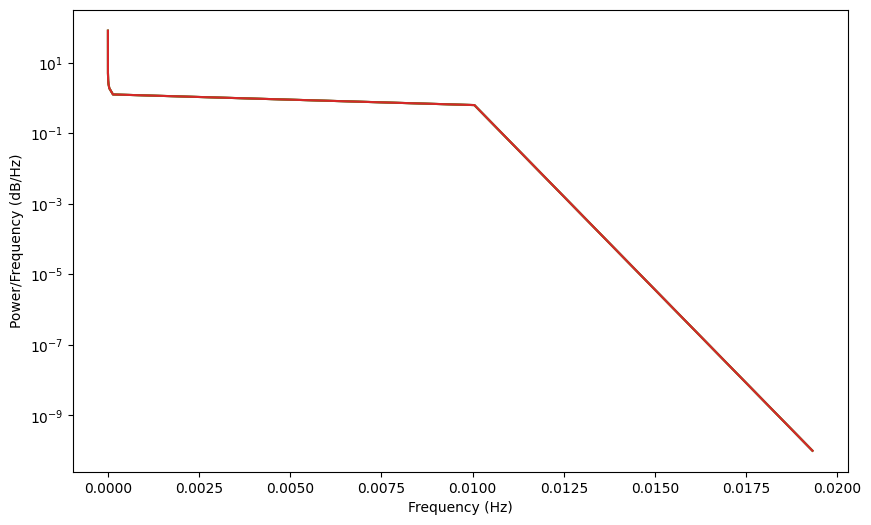

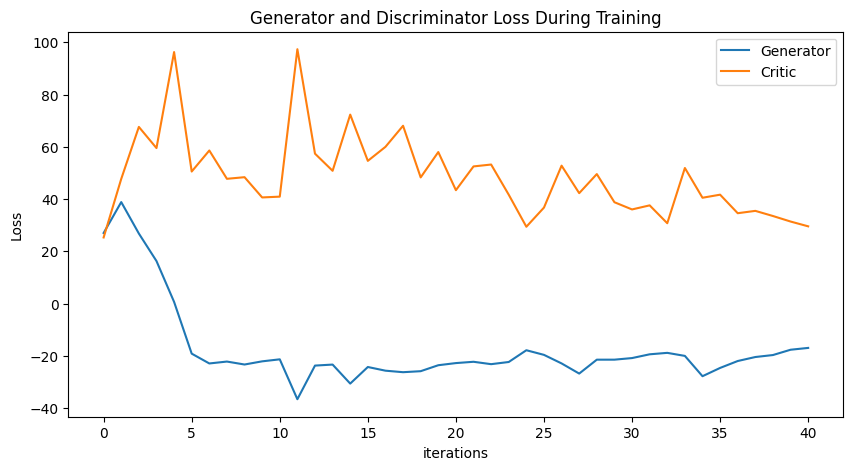

Epoch 50: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.6228165

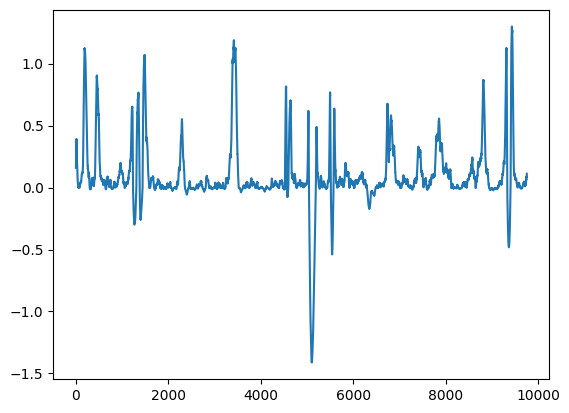

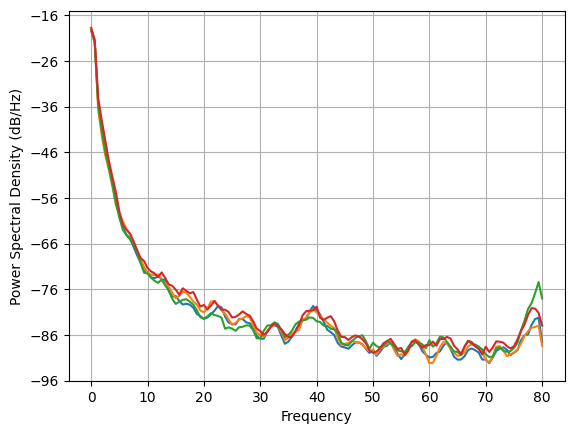

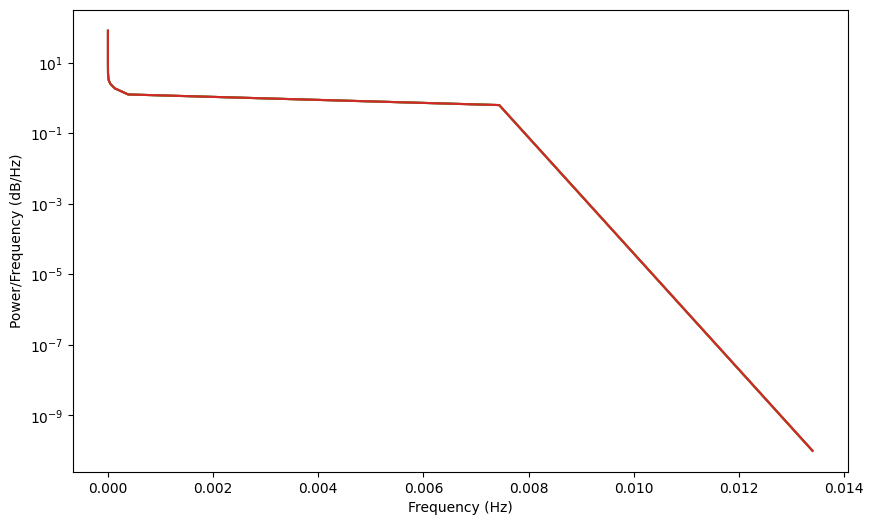

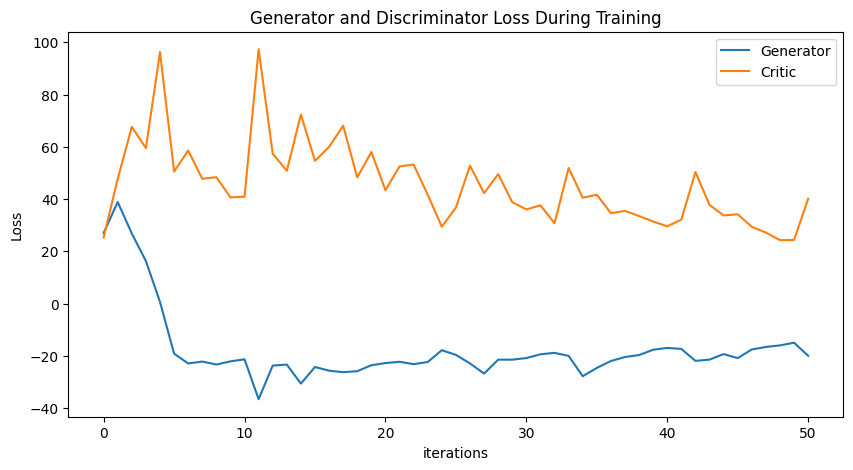

Epoch 60: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.6228165

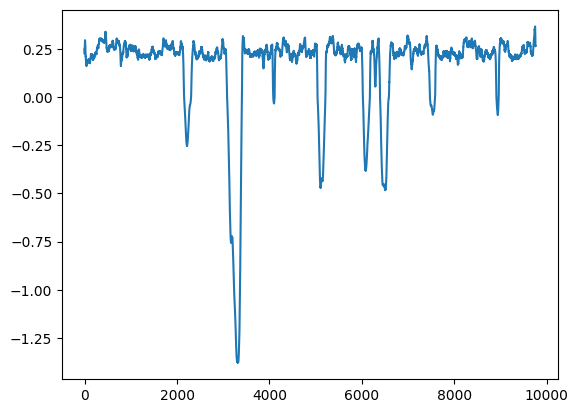

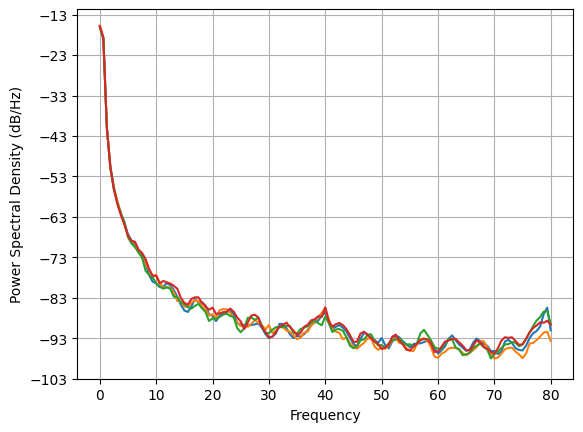

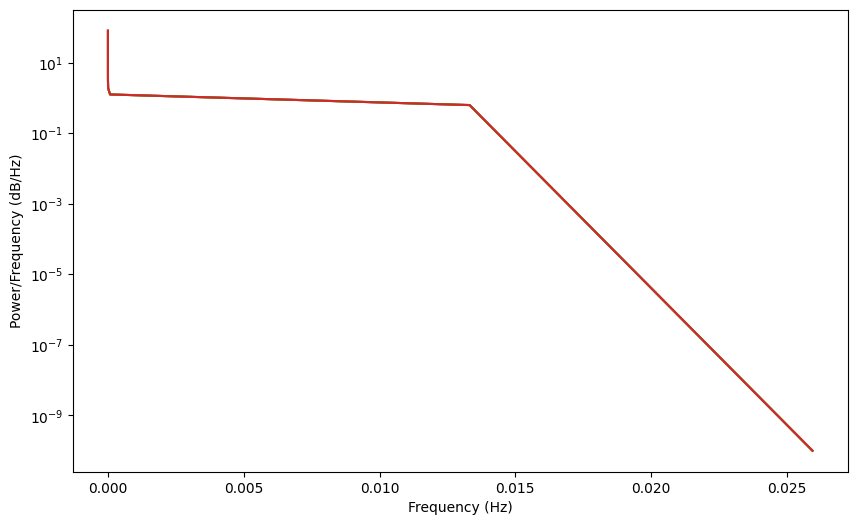

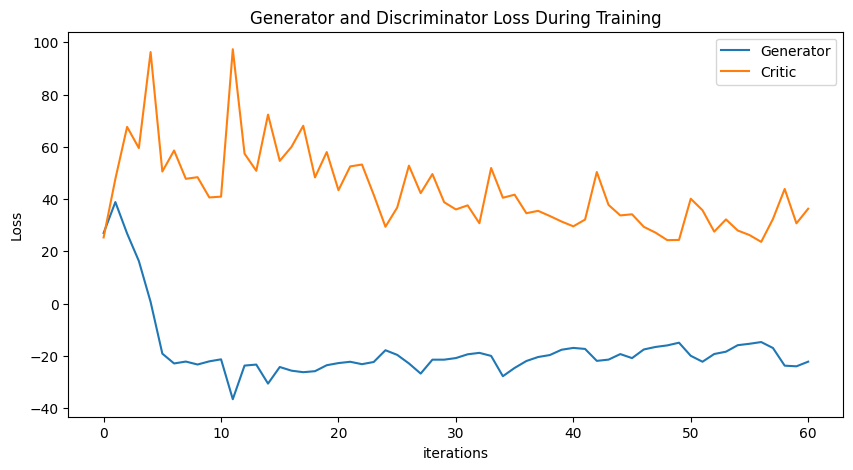

Epoch 70: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.6228165

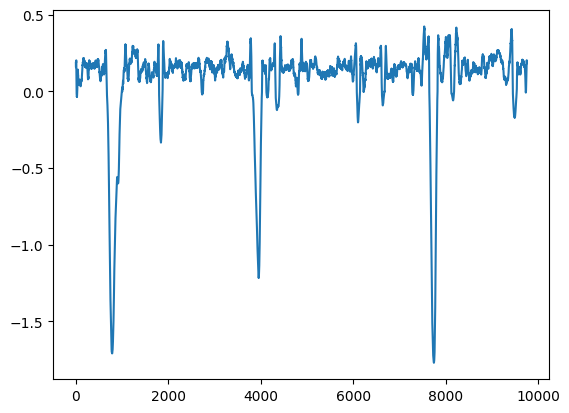

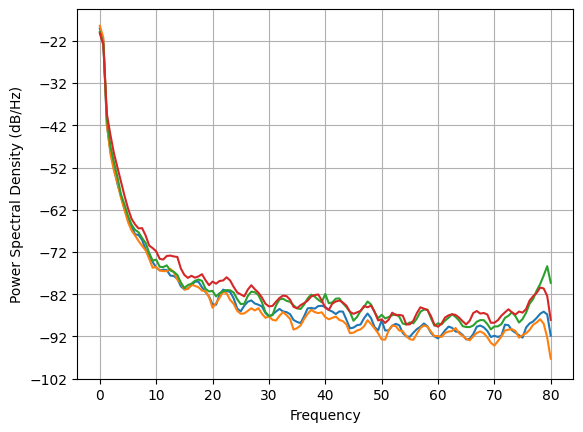

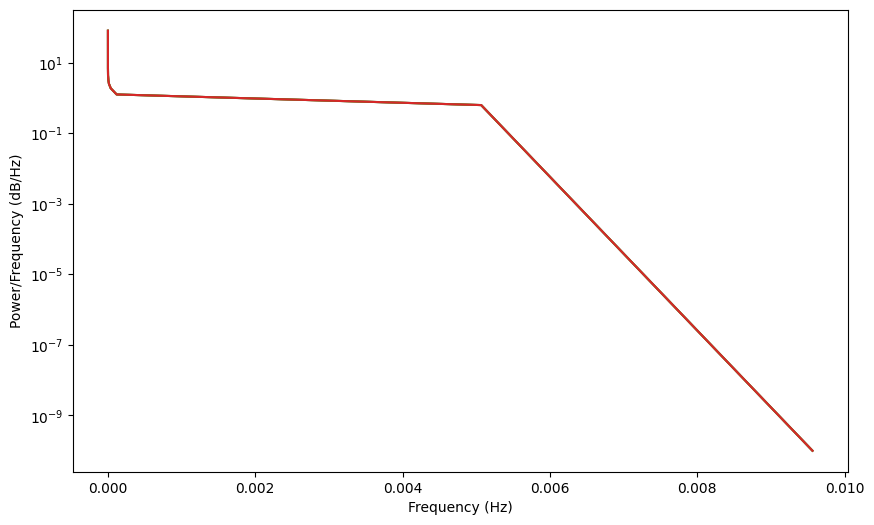

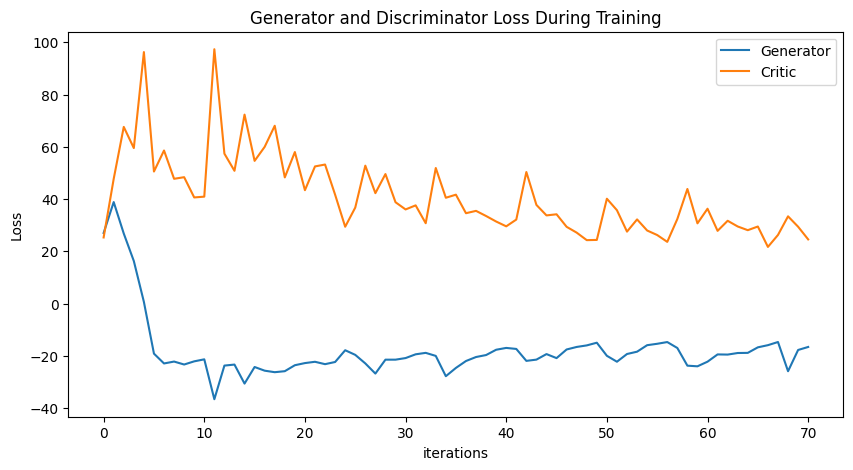

Epoch 80: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.6228165

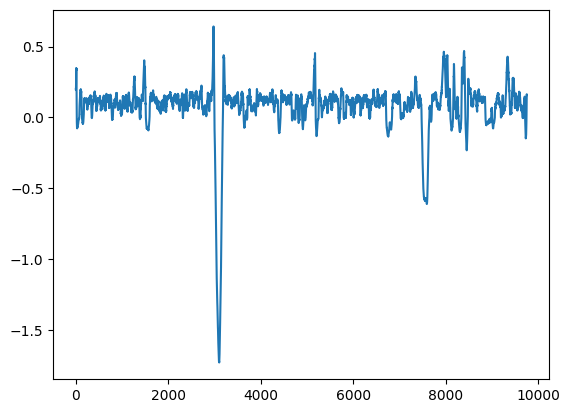

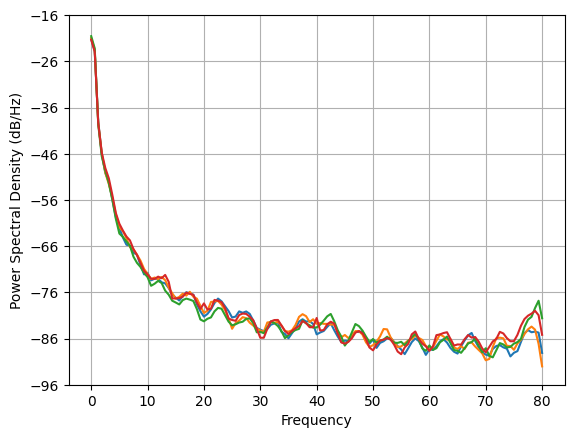

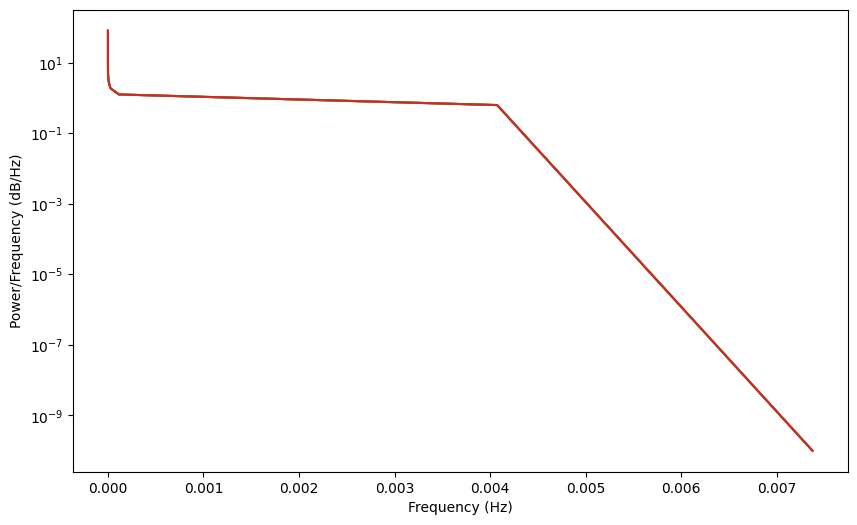

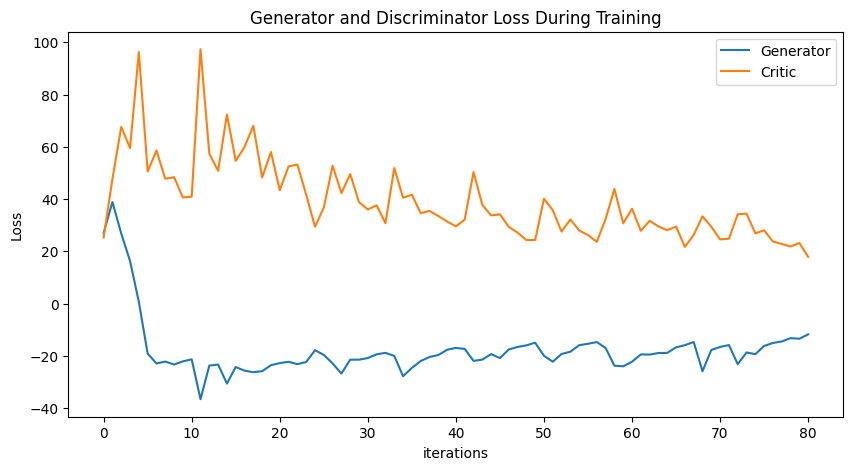

Epoch 90: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.6228165

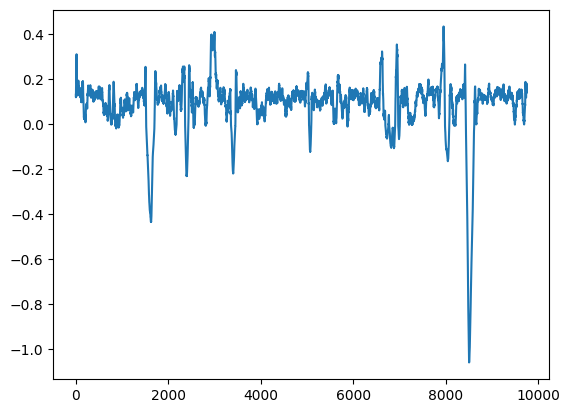

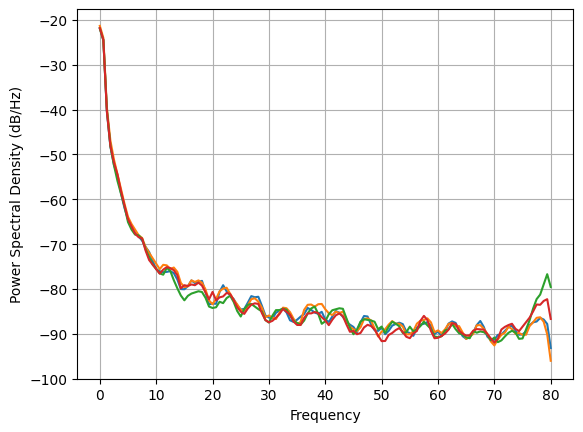

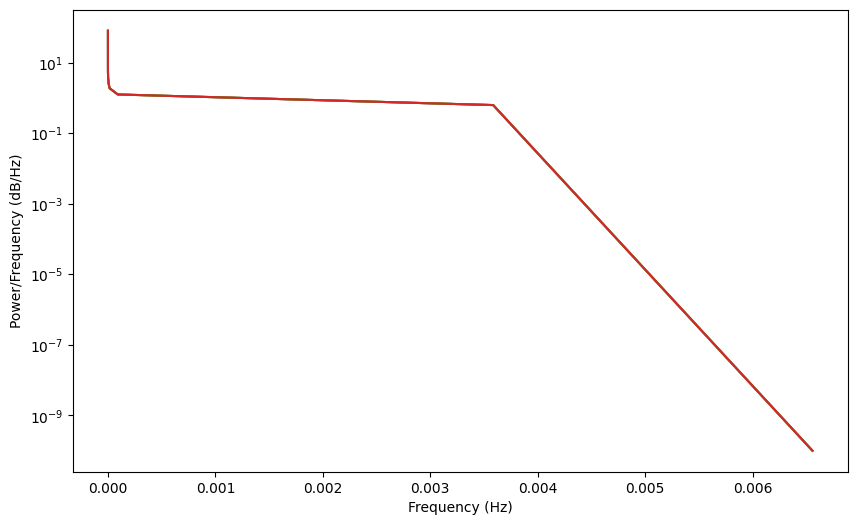

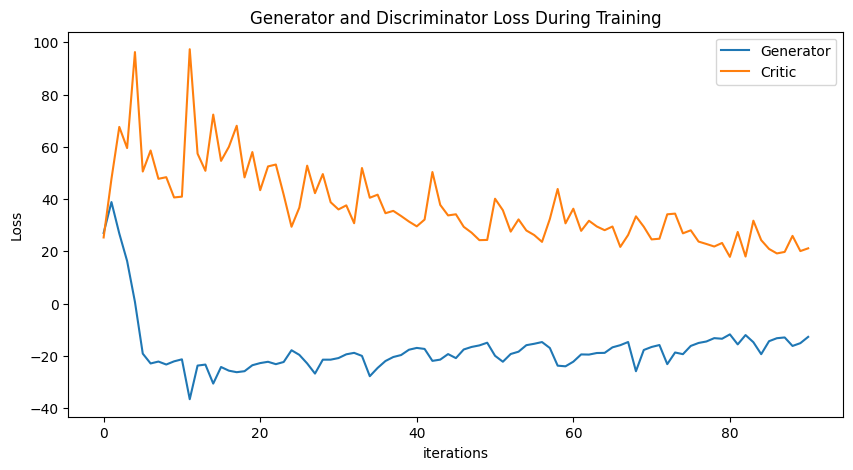

Epoch 100: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.622816

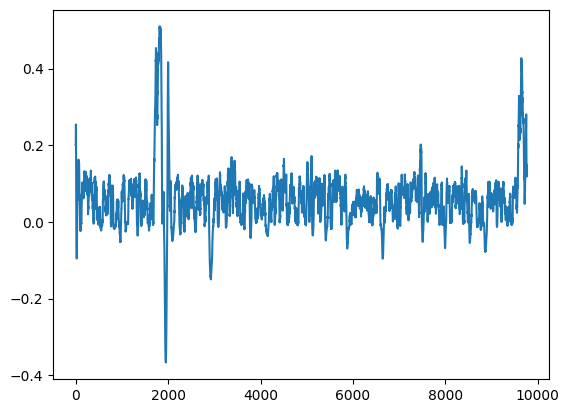

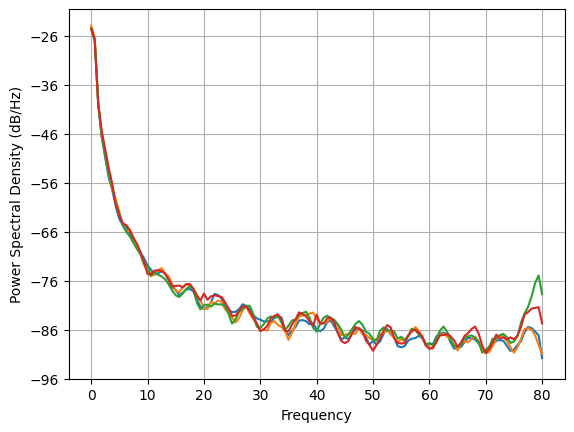

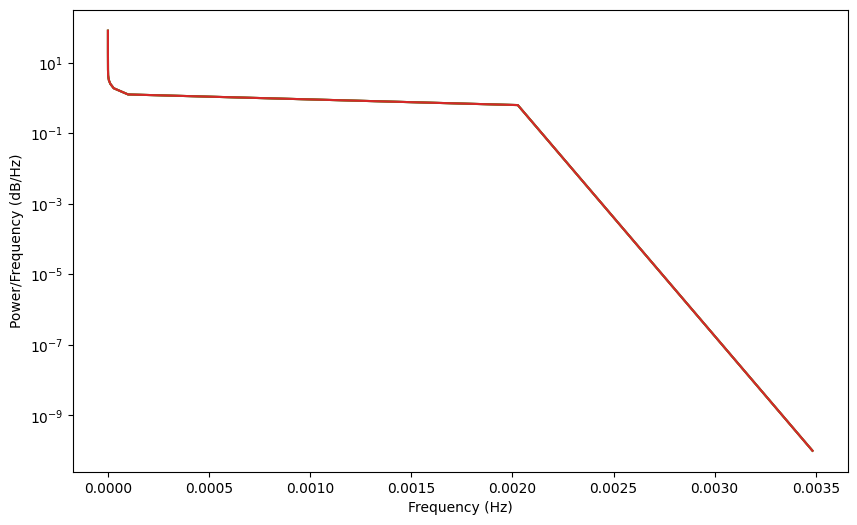

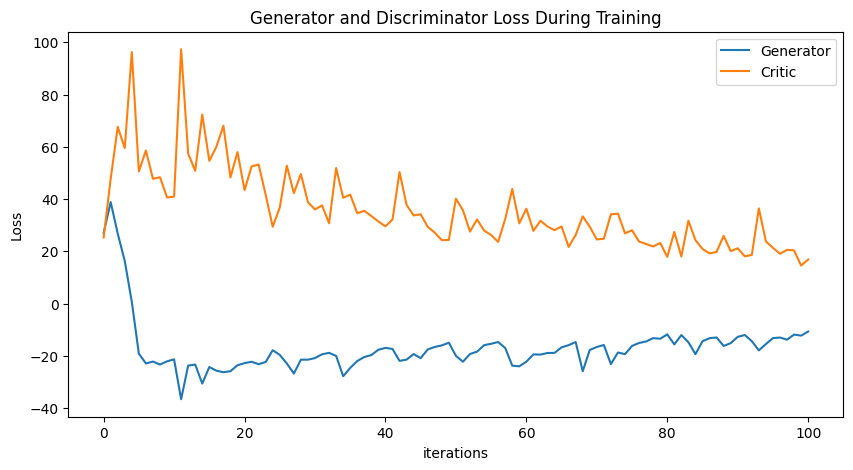

Epoch 110: Critic error ([27.00848113706456, 38.84807279738801, 26.805512364348523, 16.27692979828145, 0.6271722264837081, -19.182044012618423, -22.943190185215364, -22.216059328004565, -23.34806302681948, -22.13314306740214, -21.361663572866995, -36.635922890739245, -23.75719681475621, -23.370844235049784, -30.649844273566252, -24.299326040606708, -25.70742321647186, -26.287997613159963, -25.902986362337348, -23.618707131178265, -22.799000357238597, -22.30039094116038, -23.214455559112757, -22.381337069419047, -17.879362048657086, -19.65221890705442, -22.93167419761925, -26.81623372111585, -21.493488699503065, -21.49003316641109, -20.87924474332066, -19.43919791742245, -18.88353871330987, -20.049335271518252, -27.823674822096198, -24.65495797414898, -22.008721612753185, -20.477230310350087, -19.720316889272766, -17.690105475459898, -16.990592984546247, -17.380029933277605, -21.952568697870745, -21.47094600555662, -19.353178549569336, -20.89692368353637, -17.590004180959163, -16.622816

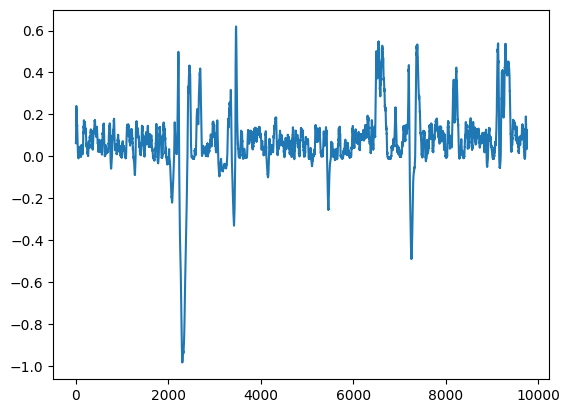

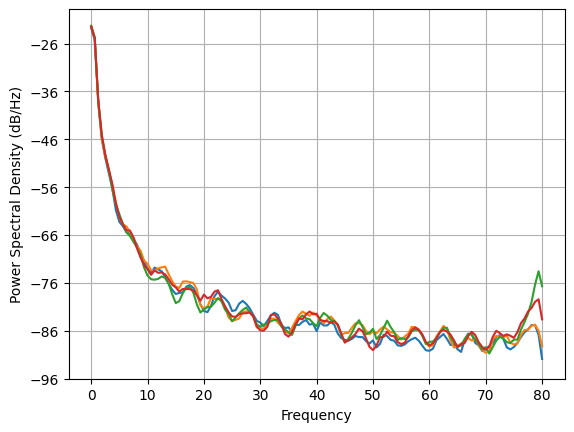

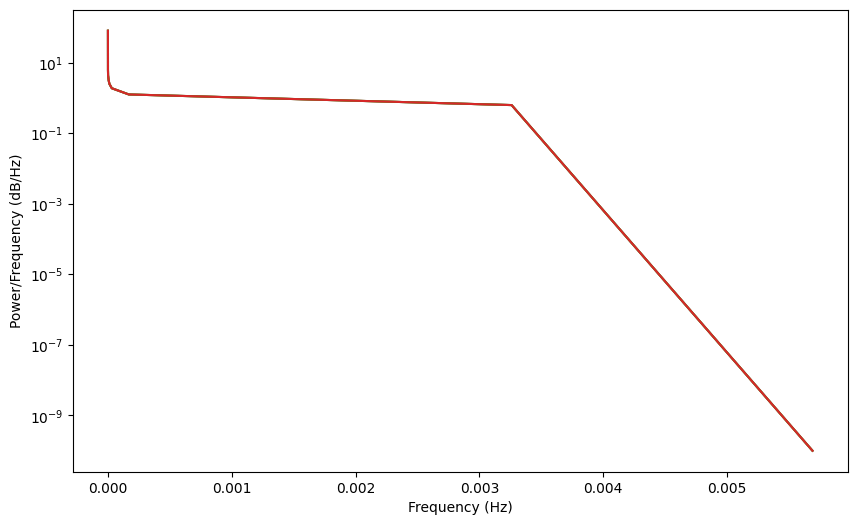

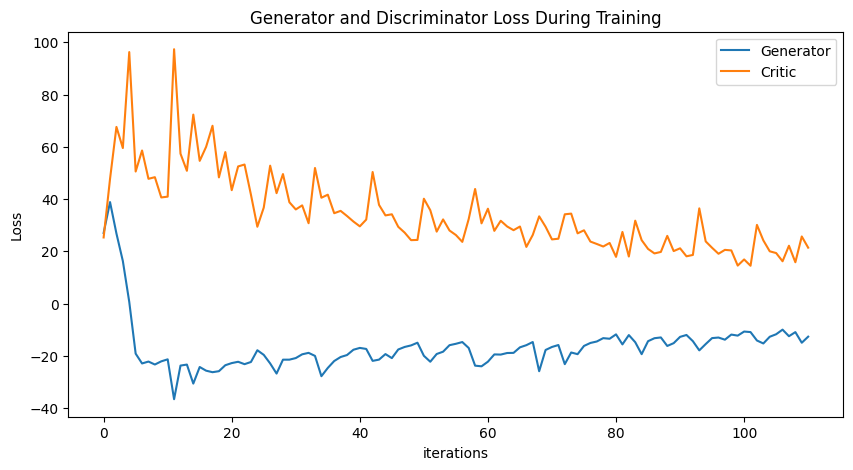

KeyboardInterrupt: 

In [10]:
SPECTRAL_FACTOR = 100000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=256, noverlap=128, window='hann', scaling='spectrum')
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = -torch.mean(gen_fake) + loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-12.pt')
torch.save(disc, 'discriminator-v11-12.pt')
np.save('closed-v11-12.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# PSD loss only

Epoch 0: Critic error ([4.398430040644571]) Generator err ([0.26580573898635446])


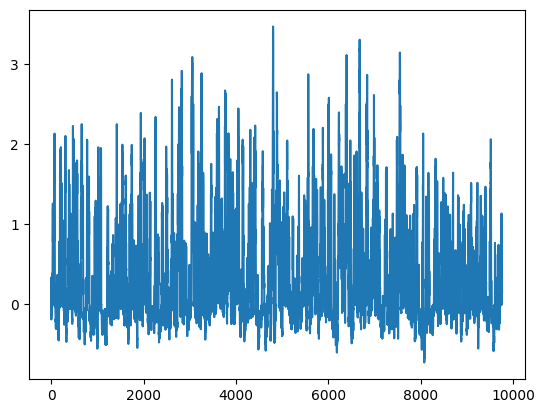

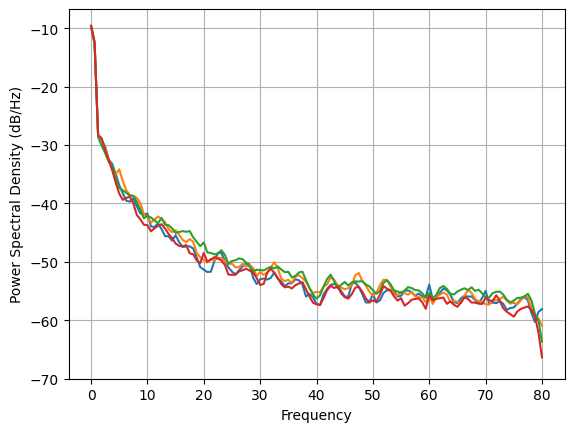

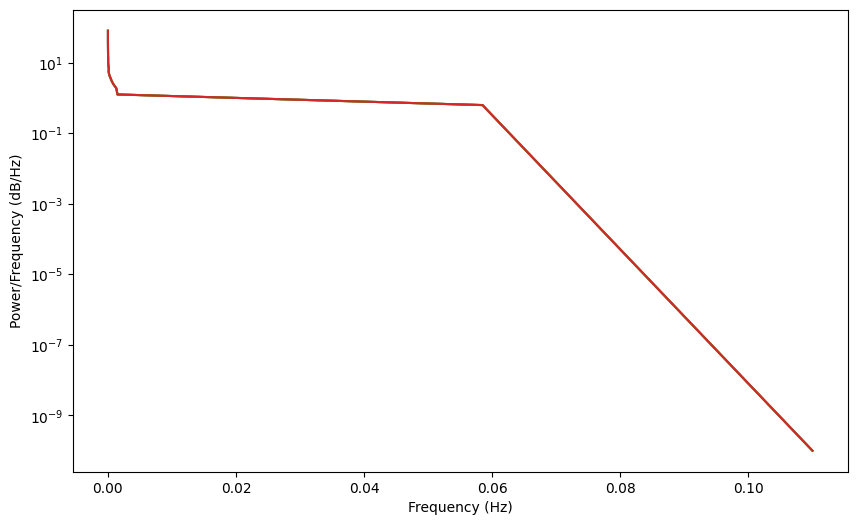

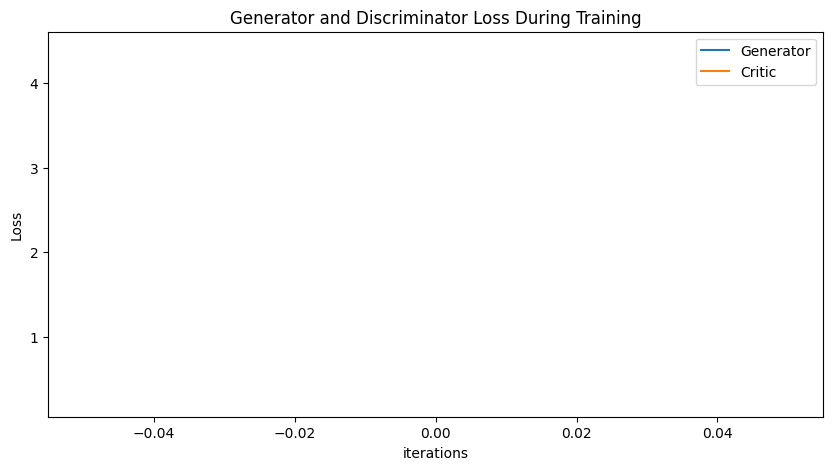

KeyboardInterrupt: 

In [11]:
SPECTRAL_FACTOR = 1000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)


def compute_psd_only(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        f, Pxx = welch(data[ch_idx], fs=fs, nperseg=256, noverlap=128, window='hann', scaling='spectrum')
        psd[ch_idx] = Pxx + 1e-10

    return f, psd

def compute_psd_loss(real, fake):
    real = real.detach().numpy()
    fake = fake.detach().numpy()
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        _, psd_real = compute_psd_only(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        _, psd_fake = compute_psd_only(fake[btch], fs)
        fakes.append(psd_fake)

    reals, fakes = np.asarray(reals), np.asarray(fakes)
    psd_loss = ((reals - fakes)**2).mean()
    return torch.tensor(psd_loss, requires_grad=True)

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=2e-4)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=2e-4)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            D.zero_grad()
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        G.zero_grad()
        loss_gen_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
        loss_gen = loss_gen_psd        
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-13.pt')
torch.save(disc, 'discriminator-v11-13.pt')
np.save('closed-v11-13.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

# Fourier transformation only D only

In [25]:
SPECTRAL_FACTOR = 100000
NUM_EPOCHS = 300
PRINT_INTERVAL = 10
BATCH_SIZE = np.shape(training_data_closed)[0]
train_loader = DataLoader(TensorDataset(torch.tensor(training_data_closed).detach()), batch_size=BATCH_SIZE, shuffle=True)



def compute_psd_torch(data, fs, nperseg=256, noverlap=None):
    n_channels, n_samples = data.shape
    psd = np.zeros((n_channels, nperseg // 2 + 1))

    for ch_idx in range(n_channels):
        fft_result = torch.fft.fft(data[ch_idx], n=nperseg // 2 + 1)
        Pxx = torch.abs(fft_result)**2
        psd[ch_idx] = torch.from_numpy(Pxx.detach().numpy() + 1e-10)

    return psd


def compute_psd_loss(real, fake):
    reals, fakes = [], []
    
    for btch in range(np.shape(real)[0]):
        psd_real = compute_psd_torch(real[btch], fs)
        reals.append(psd_real)

    for btch in range(np.shape(fake)[0]):
        psd_fake = compute_psd_torch(fake[btch], fs)
        fakes.append(psd_fake)
    reals, fakes = np.asarray(reals), np.asarray(fakes)

    # Normalize each sample independently
    psd_real = F.normalize(reals, p=2, dim=1)
    psd_fake = F.normalize(fakes, p=2, dim=1)

    psd_loss = ((psd_real - psd_fake)**2).mean()  # Check calculated PSD
    return psd_loss

def train():
    critic_err, gen_err, critic_psd_err, gen_psd_err = [], [], [], []
    G, D = Generator(), Discriminator()
    weights_init(G)
    weights_init(D)
    critic_optimizer = optim.RMSprop(D.parameters(), lr=1e-5)
    gen_optimizer = optim.RMSprop(G.parameters(), lr=1e-5)

    for epoch in range(NUM_EPOCHS):
        (real, ) = next(iter(train_loader))
        real.requires_grad = True

        for _ in range(5):
            fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
            critic_real = D(real).reshape(-1)
            critic_fake = D(fake).reshape(-1)
            D.zero_grad()            
            loss_critic_psd = compute_psd_loss(real, fake) * SPECTRAL_FACTOR
            loss_critic = -torch.mean(critic_real) + torch.mean(critic_fake) + (gradient_penalty(D, real, fake) * LAMBDA_GP) + loss_critic_psd
            loss_critic.backward()
            critic_optimizer.step()  

        fake = G(sample_normal_distribution(BATCH_SIZE, 200, 305))
        gen_fake = D(fake).reshape(-1)
        G.zero_grad()
        loss_gen = -torch.mean(gen_fake)
        loss_gen.backward()
        gen_optimizer.step()
        
        critic_err.append(loss_critic.item())
        gen_err.append(loss_gen.item())
        critic_psd_err.append(loss_critic_psd.item())
        gen_psd_err.append(loss_gen_psd.item())

        if epoch % PRINT_INTERVAL == 0:
            print("Epoch %s: Critic error (%s) Generator err (%s)" % (epoch, critic_err, gen_err))
            print("Epoch %s: Critic PSD error (%s) Generator PSD err (%s)" % (epoch, critic_psd_err, gen_psd_err))
            plot_everything(fake, critic_err, gen_err)

    return critic_err, gen_err, fake, D, G

critic_err, gen_err, generated, disc, gen = train()

torch.save(gen, 'generator-v11-14.pt')
torch.save(disc, 'discriminator-v11-14.pt')
np.save('closed-v11-14.npy', generated.detach())
plot_everything(generated, gen_err, critic_err)
generated_data_closed = None

RuntimeError: [enforce fail at ..\c10\core\impl\alloc_cpu.cpp:72] data. DefaultCPUAllocator: not enough memory: you tried to allocate 617144320 bytes.